In [1]:
import math
import os
import random
import shutil
import pickle
import matplotlib.colors
import matplotlib.gridspec as gridspec
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import warnings
import tensorflow as tf
import shap
import sys
import copy

from matplotlib.pyplot import cm
from matplotlib.colors import ListedColormap
from scipy.stats import ttest_ind
from scipy.special import softmax
from scipy.stats import rankdata
from scipy.stats import kendalltau
from sklearn.metrics import accuracy_score
from tensorflow import keras
from tensorflow.keras.utils import plot_model
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.text import Tokenizer
from alibi.explainers import IntegratedGradients
from alibi.explainers import AnchorText

SEED_VALUE = 3435
os.environ['PYTHONHASHSEED']=str(SEED_VALUE)
random.seed(SEED_VALUE)
np.random.seed(SEED_VALUE)
tf.random.set_seed(SEED_VALUE)
warnings.filterwarnings('ignore')
os.chdir(os.getcwd())

from analysis.distributions import *
from analysis.plots import *
from analysis.metrics.consistency import *

In [2]:
# dataset = "SENTIMENT140"
# configurations = [
#                   "CNN-WORD2VEC-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-GLOVE-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-ELMO-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-BERT-STATIC-SENTIMENT140-EARLY_STOPPING-2",
#                   "CNN-sentiBERT-STATIC-SENTIMENT140-EARLY_STOPPING",
    
#                   "CNN-WORD2VEC-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-GLOVE-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-ELMO-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-BERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "CNN-sentiBERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
                  
#                   "CNN-WORD2VEC-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION", 
#                   "CNN-GLOVE-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-ELMO-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-BERT-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-sentiBERT-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
    
#                   "CNN-WORD2VEC-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-GLOVE-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-ELMO-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-BERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "CNN-sentiBERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
                    
#                   "LSTM-WORD2VEC-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-GLOVE-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-ELMO-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-BERT-STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-sentiBERT-STATIC-SENTIMENT140-EARLY_STOPPING",
    
#                   "LSTM-WORD2VEC-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-GLOVE-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-ELMO-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-BERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
#                   "LSTM-sentiBERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING",
                  
#                   "LSTM-WORD2VEC-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION", 
#                   "LSTM-GLOVE-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-ELMO-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-BERT-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-sentiBERT-STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
    
#                   "LSTM-WORD2VEC-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-GLOVE-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-ELMO-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-BERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION",
#                   "LSTM-sentiBERT-NON_STATIC-SENTIMENT140-EARLY_STOPPING-DISTILLATION"
#                  ]

dataset = "SST2"
configurations = [
                  "CNN-WORD2VEC-STATIC-NESTED_CV",
                  "CNN-GLOVE-STATIC-NESTED_CV",
                  "CNN-ELMO-STATIC-SST2-NESTED_CV",
                  "CNN-BERT-STATIC-SST2-NESTED_CV",
                  "CNN-WORD2VEC-NON_STATIC-NESTED_CV",
                  "CNN-GLOVE-NON_STATIC-NESTED_CV",
                  "CNN-ELMO-NON_STATIC-SST2-NESTED_CV",
                  "CNN-BERT-NON_STATIC-SST2-NESTED_CV",
                  
                  "CNN-WORD2VEC-STATIC-NESTED_CV-DISTILLATION", 
                  "CNN-GLOVE-STATIC-NESTED_CV-DISTILLATION",
                  "CNN-ELMO-STATIC-SST2-NESTED_CV-DISTILLATION",
                  "CNN-BERT-STATIC-SST2-NESTED_CV-DISTILLATION", 
                  "CNN-WORD2VEC-NON_STATIC-NESTED_CV-DISTILLATION",
                  "CNN-GLOVE-NON_STATIC-NESTED_CV-DISTILLATION",
                  "CNN-ELMO-NON_STATIC-SST2-NESTED_CV-DISTILLATION",
                  "CNN-BERT-NON_STATIC-SST2-NESTED_CV-DISTILLATION",
                    
                  "LSTM-WORD2VEC-STATIC-SST2-NESTED_CV",
                  "LSTM-GLOVE-STATIC-SST2-NESTED_CV",
                  "LSTM-ELMO-STATIC-SST2-NESTED_CV-2",
                  "LSTM-BERT-STATIC-SST2-NESTED_CV",
                  "LSTM-WORD2VEC-NON_STATIC-SST2-NESTED_CV",
                  "LSTM-GLOVE-NON_STATIC-SST2-NESTED_CV",
                  "LSTM-ELMO-NON_STATIC-SST2-NESTED_CV",
                  "LSTM-BERT-NON_STATIC-SST2-NESTED_CV",
                  
                  "LSTM-WORD2VEC-STATIC-SST2-NESTED_CV-DISTILLATION", 
                  "LSTM-GLOVE-STATIC-SST2-NESTED_CV-DISTILLATION",
                  "LSTM-ELMO-STATIC-SST2-NESTED_CV-DISTILLATION-2",
                  "LSTM-BERT-STATIC-SST2-NESTED_CV-DISTILLATION", 
                  "LSTM-WORD2VEC-NON_STATIC-SST2-NESTED_CV-DISTILLATION",
                  "LSTM-GLOVE-NON_STATIC-SST2-NESTED_CV-DISTILLATION",
                  "LSTM-ELMO-NON_STATIC-SST2-NESTED_CV-DISTILLATION-2",
                  "LSTM-BERT-NON_STATIC-SST2-NESTED_CV-DISTILLATION"
                ]

In [3]:
distributions = {}
for config in configurations:
    try:
        base_model = config.split("-")[0]
        if base_model not in list(distributions.keys()):
            distributions[base_model] = {}

        word_vectors = config.split("-")[1]
        if word_vectors not in list(distributions[base_model].keys()):
            distributions[base_model][word_vectors] = {}

        fine_tuning = config.split("-")[2]
        if fine_tuning not in list(distributions[base_model][word_vectors].keys()):
            distributions[base_model][word_vectors][fine_tuning] = {}

        dataset = config.split("-")[3]
        if dataset not in list(distributions[base_model][word_vectors][fine_tuning].keys()):
            distributions[base_model][word_vectors][fine_tuning][dataset] = {}

        validation_method = config.split("-")[4]
        if validation_method not in list(distributions[base_model][word_vectors][fine_tuning][dataset].keys()):
            distributions[base_model][word_vectors][fine_tuning][dataset][validation_method] = {}

        if "DISTILLATION" in config.split("-"):
            distillation = config.split("-")[5]
            if distillation not in list(distributions[base_model][word_vectors][fine_tuning][dataset][validation_method].keys()):
                distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation] = {}
    except:
        base_model = config.split("-")[0]
        if base_model not in list(distributions.keys()):
            distributions[base_model] = {}

        word_vectors = config.split("-")[1]
        if word_vectors not in list(distributions[base_model].keys()):
            distributions[base_model][word_vectors] = {}

        fine_tuning = config.split("-")[2]
        if fine_tuning not in list(distributions[base_model][word_vectors].keys()):
            distributions[base_model][word_vectors][fine_tuning] = {}

        validation_method = config.split("-")[3]
        if validation_method not in list(distributions[base_model][word_vectors][fine_tuning].keys()):
            distributions[base_model][word_vectors][fine_tuning][validation_method] = {}

        if "DISTILLATION" in config.split("-"):
            distillation = config.split("-")[4]
            if distillation not in list(distributions[base_model][word_vectors][fine_tuning][validation_method].keys()):
                distributions[base_model][word_vectors][fine_tuning][validation_method][distillation] = {}

In [4]:
# Calculate all metrics for all configurations in distributions

# #### Performance Acc. ####
# distributions = sent_acc_for_distributions(configurations, distributions)

#### Explanation Acc. ####
distributions = lime_acc_for_distributions(configurations, distributions)
# distributions = shap_acc_for_distributions(configurations, distributions)
# distributions = int_grad_acc_for_distributions(configurations, distributions)



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', "'ve", 'form', 'we', 'all']
B conjunct:  ['greatest', 'makes', 'great', 'world', 'with']
A conjunct explanations:  [0.015363296229041245, 0.0072601467996466044, 0.005540966625345452, 0.00496579759760515, 0.0026673857842848384]
B conjunct explanations:  [0.031407191106226924, 0.026695726382216057, 0.022231665013872526, 0.018135195937999473, 0.017705519492835897]
A conjunct score:  0.007159518607184659
B conjunct score:  0.023235059586630177
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features



sentence:  it 's often faintly amusing , but the problems of the characters never become important to us , and the story never takes hold
sentiment:  0
A conjunct:  ['faintly', 'often', ',', 'amusing', 'it']
B conjunct:  ['never', 'never', 'problems', 'to', 'story']
A conjunct explanations:  [0.0819636371177006, 0.06681871841322351, 0.05040249863826285, 0.04579880786842914, 0.009396450662440619]
B conjunct explanations:  [0.32355510532627035, 0.32355510532627035, 0.1680552995282778, 0.11482288626816282, 0.07788863536569184]
A conjunct score:  0.05087602254001135
B conjunct score:  0.20157540636293464
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.009396450662440619, 0.007709423404588621, 0.06681871841322351, 0.0819636371177006, 0.04579880786842914, 0.05040249863826285, 0.003591075528956385, 


sentence:  highbrow self appointed guardians of culture need not apply , but those who loved cool as ice have at last found a worthy follow up
sentiment:  1
A conjunct:  [',', 'culture', 'of', 'guardians', 'self']
B conjunct:  ['worthy', 'cool', 'loved', 'at', 'follow']
A conjunct explanations:  [0.05378333732695539, 0.036712600761658006, 0.034273066413682184, 0.021277196108605043, 0.010591667863825543]
B conjunct explanations:  [0.1968832280097977, 0.18955200488685245, 0.16570000459491552, 0.035416853728196, 0.028528223058910705]
A conjunct score:  0.03132757369494523
B conjunct score:  0.12321606285573447
features:  ['highbrow', 'self', 'appointed', 'guardians', 'of', 'culture', 'need', 'not', 'apply', ',', 'but', 'those', 'who', 'loved', 'cool', 'as', 'ice', 'have', 'at', 'last', 'found', 'a', 'worthy', 'follow', 'up']
no of features:  25
Scores:  [0.0034123872057546536, 0.010591667863825543, 1.7383550970509598e-06, 0.021277196108605043, 0.034273066413682184, 0.036712600761658006, 



sentence:  well made but uninvolving , bloodwork is n't a terrible movie , just a stultifyingly obvious one an unrewarding collar for a murder mystery
sentiment:  0
A conjunct:  ['made', 'well']
B conjunct:  ['uninvolving', 'unrewarding', 'terrible', 'obvious', "n't"]
A conjunct explanations:  [0.005674909045946771, 0.004904538906914666]
B conjunct explanations:  [0.013798900854774645, 0.013654915192242642, 0.012868493266579371, 0.011950089164847246, 0.011849446971433052]
A conjunct score:  0.005289723976430719
B conjunct score:  0.01282436908997539
features:  ['well', 'made', 'but', 'uninvolving', ',', 'bloodwork', 'is', "n't", 'a', 'terrible', 'movie', ',', 'just', 'a', 'stultifyingly', 'obvious', 'one', 'an', 'unrewarding', 'collar', 'for', 'a', 'murder', 'mystery']
no of features:  24
Scores:  [0.004904538906914666, 0.005674909045946771, 0.0019198048443033215, 0.013798900854774645, 1.5696406358532587e-11, 4.250651488643994e-12, 0.0012423434904498738, 0.011849446971433052, 0.00161


sentence:  not a cozy or ingratiating work , but it 's challenging , sometimes clever , and always interesting , and those are reasons enough to see it
sentiment:  1
A conjunct:  [',', 'work', 'cozy', 'ingratiating', 'not']
B conjunct:  ['challenging', 'interesting', 'clever', 'and', 'and']
A conjunct explanations:  [0.03695993185020931, 0.019758735436043236, 0.011326422717435053, 0.009221399076693393, 1.6198850629749177e-06]
B conjunct explanations:  [0.07144273196045633, 0.05998547292457825, 0.048431006296233814, 0.04460670921645887, 0.04460670921645887]
A conjunct score:  0.015453621793088793
B conjunct score:  0.05381452592283723
features:  ['not', 'a', 'cozy', 'or', 'ingratiating', 'work', ',', 'but', 'it', "'s", 'challenging', ',', 'sometimes', 'clever', ',', 'and', 'always', 'interesting', ',', 'and', 'those', 'are', 'reasons', 'enough', 'to', 'see', 'it']
no of features:  27
Scores:  [1.6198850629749177e-06, 2.5611446618006923e-07, 0.011326422717435053, 2.349206873525032e-07, 


sentence:  in auteil 's less dramatic but equally incisive performance , he 's a charismatic charmer likely to seduce and conquer
sentiment:  1
A conjunct:  ["'s", 'dramatic', 'auteil', 'in', 'less']
B conjunct:  ['charismatic', 'charmer', 'incisive', 'conquer', 'performance']
A conjunct explanations:  [0.010518690960448681, 0.007846735019201256, 0.004179707835850748, 1.9953426623659746e-07, 1.676470719555659e-07]
B conjunct explanations:  [0.04030747591685335, 0.03658091919788113, 0.03623698983566414, 0.016985374778367545, 0.011957062295721679]
A conjunct score:  0.004509100199367775
B conjunct score:  0.02841356440489757
features:  ['in', 'auteil', "'s", 'less', 'dramatic', 'but', 'equally', 'incisive', 'performance', ',', 'he', "'s", 'a', 'charismatic', 'charmer', 'likely', 'to', 'seduce', 'and', 'conquer']
no of features:  20
Scores:  [1.9953426623659746e-07, 0.004179707835850748, 0.010518690960448681, 1.676470719555659e-07, 0.007846735019201256, 4.004814538226814e-07, 0.007765141



sentence:  the movie 's seams may show but pellington gives `` mothman '' an irresistibly uncanny ambience that goes a long way toward keeping the picture compelling
sentiment:  1
A conjunct:  ['show', 'seams', "'s", 'may', 'the']
B conjunct:  ['uncanny', 'compelling', 'gives', 'ambience', 'irresistibly']
A conjunct explanations:  [0.006551199659795731, 0.00475771315965287, 0.003645207715993326, 0.002647187000993163, 5.780078757770285e-10]
B conjunct explanations:  [0.015516254658327618, 0.015465702678127606, 0.013856963458828449, 0.013702121845233556, 0.013571733230197319]
A conjunct score:  0.003520261622888593
B conjunct score:  0.014422555174142909
features:  ['the', 'movie', "'s", 'seams', 'may', 'show', 'but', 'pellington', 'gives', '``', 'mothman', "''", 'an', 'irresistibly', 'uncanny', 'ambience', 'that', 'goes', 'a', 'long', 'way', 'toward', 'keeping', 'the', 'picture', 'compelling']
no of features:  26
Scores:  [5.780078757770285e-10, 1.3328972437172192e-11, 0.0036452077159

features:  ['cox', 'offers', 'plenty', 'of', 'glimpses', 'at', 'existing', 'photos', ',', 'but', 'there', 'are', 'no', 'movies', 'of', 'nijinsky', ',', 'so', 'instead', 'the', 'director', 'treats', 'us', 'to', 'an', 'aimless', 'hodgepodge']
no of features:  27
Scores:  [0.00017541467066499585, 0.00037427168438233945, 5.8995589442432425e-05, 0.00012288378425905677, 0.00015520127056088725, 4.065121958223112e-05, 0.00010006150049134371, 8.919620963846744e-06, 7.13604143218783e-05, 8.264800431199787e-05, 4.536873122700982e-06, 4.6586105831981116e-05, 0.07438931761489435, 0.0026494240052894035, 0.00012288378425905677, 0.008457307573046632, 7.13604143218783e-05, 0.03571138844362443, 0.04934843284708427, 9.418572411057882e-05, 2.6994018219641547e-07, 8.569968704698664e-05, 0.00017800739293330633, 4.6880657004894924e-06, 5.878423144103567e-05, 0.3568161504036883, 0.2739085316812513]
no of scores:  27




sentence:  this movie may not have the highest production values you 've ever seen , but i

features:  ['this', 'is', 'a', 'great', 'subject', 'for', 'a', 'movie', ',', 'but', 'hollywood', 'has', 'squandered', 'the', 'opportunity', ',', 'using', 'it', 'as', 'a', 'prop', 'for', 'warmed', 'over', 'melodrama', 'and', 'the', 'kind', 'of', 'choreographed', 'mayhem', 'that', 'director', 'john', 'woo', 'has', 'built', 'his', 'career', 'on']
no of features:  40
Scores:  [4.431755281022944e-07, 1.8798358961987192e-06, 1.4774590756717057e-06, 3.000911392352496e-06, 4.92795904795862e-07, 0.014114088222047154, 1.4774590756717057e-06, 0.015226476651844015, 4.7419041636645304e-07, 3.093709624118386e-08, 2.408924535647895e-07, 0.001023510705265632, 0.16025560782422738, 6.583893345873049e-07, 0.0036513389149778735, 4.7419041636645304e-07, 3.6721558913671627e-07, 0.019685353048757803, 4.98393185851409e-07, 1.4774590756717057e-06, 0.053820560011258095, 0.014114088222047154, 9.648766907953222e-07, 0.05574902837166334, 0.036710932053880284, 0.013332351693203176, 6.583893345873049e-07, 0.01058039

sentence:  laugh out loud lines , adorably ditsy but heartfelt performances , and sparkling , bittersweet dialogue that cuts to the chase of the modern girl 's dilemma
sentiment:  1
A conjunct:  [',', 'adorably', 'loud', 'ditsy', 'lines']
B conjunct:  ['bittersweet', 'sparkling', 'heartfelt', ',', ',']
A conjunct explanations:  [0.048160992335093585, 0.004327545636714571, 0.003712288892584528, 2.2744940018004284e-05, 1.1163235954379765e-05]
B conjunct explanations:  [0.12312748217330509, 0.10426580544241808, 0.07724621462404341, 0.048160992335093585, 0.048160992335093585]
A conjunct score:  0.011246947008073015
B conjunct score:  0.08019229738199074
features:  ['laugh', 'out', 'loud', 'lines', ',', 'adorably', 'ditsy', 'but', 'heartfelt', 'performances', ',', 'and', 'sparkling', ',', 'bittersweet', 'dialogue', 'that', 'cuts', 'to', 'the', 'chase', 'of', 'the', 'modern', 'girl', "'s", 'dilemma']
no of features:  27
Scores:  [4.746015575375745e-06, 8.239425378817838e-06, 0.00371228889258


sentence:  the film 's strength is n't in its details , but in the larger picture it paints of a culture in conflict with itself , with the thin veneer of nationalism that covers our deepest , media soaked fears
sentiment:  1
A conjunct:  [',', 'in', 'its', "n't", 'strength']
B conjunct:  ['paints', ',', ',', 'our', 'of']
A conjunct explanations:  [0.16788640472188754, 0.08738907860450452, 0.07480236899572648, 0.06971845016670547, 0.04588748606965624]
B conjunct explanations:  [0.2137030550816651, 0.16788640472188754, 0.16788640472188754, 0.14296977539290012, 0.13170213152014804]
A conjunct score:  0.08913675771169605
B conjunct score:  0.1648295542876977
features:  ['the', 'film', "'s", 'strength', 'is', "n't", 'in', 'its', 'details', ',', 'but', 'in', 'the', 'larger', 'picture', 'it', 'paints', 'of', 'a', 'culture', 'in', 'conflict', 'with', 'itself', ',', 'with', 'the', 'thin', 'veneer', 'of', 'nationalism', 'that', 'covers', 'our', 'deepest', ',', 'media', 'soaked', 'fears']
no of

features:  ['contains', 'a', 'few', 'big', 'laughs', 'but', 'many', 'more', 'that', 'graze', 'the', 'funny', 'bone', 'or', 'miss', 'it', 'altogether', ',', 'in', 'part', 'because', 'the', 'consciously', 'dumbed', 'down', 'approach', 'wears', 'thin']
no of features:  28
Scores:  [0.000972976370342212, 0.000660180958170656, 0.05750341157436725, 5.226890139365422e-06, 0.004909074502481273, 0.00745708976389933, 0.020429864778343708, 0.022636290556636355, 0.003008669115125422, 3.585813157269702e-05, 2.1887284662291425e-05, 9.089287521697994e-05, 0.02037293949243523, 0.06853123628824229, 2.159831023713863e-05, 5.621882018288278e-06, 0.051845696599851596, 2.3946738465238887e-05, 0.0035663550007018494, 1.634779019478688e-06, 0.008648378851134831, 2.1887284662291425e-05, 2.7790734728020252e-05, 0.08401987561065244, 0.0643276718217674, 2.6504846131945358e-05, 0.03163110205977251, 0.14667961704592558]
no of scores:  28




sentence:  lisa rinzler 's cinematography may be lovely , but love liza 's

A conjunct score:  0.01364312982283179
B conjunct score:  0.20292862363436512
features:  ['the', 'acting', 'is', 'fine', 'but', 'the', 'script', 'is', 'about', 'as', 'interesting', 'as', 'a', 'recording', 'of', 'conversations', 'at', 'the', 'wal', 'mart', 'checkout', 'line']
no of features:  22
Scores:  [0.0001937559374875181, 0.052437054883872035, 0.0010935389685232451, 0.0008481695014443578, 0.04755756557817281, 0.0001937559374875181, 0.21591333274087113, 0.0010935389685232451, 0.08548274000188356, 0.30023054340397437, 0.0017688553625878243, 0.30023054340397437, 0.07155461999804032, 0.04708595444025966, 0.00018835367353531722, 0.0005635016196244233, 0.01434831052101549, 0.0001937559374875181, 0.08193355357208314, 0.09589964420598451, 0.10236905441702135, 0.01634353899432418]
no of scores:  22




sentence:  contains all the substance of a twinkie easy to swallow , but scarcely nourishing
sentiment:  0
A conjunct:  ['twinkie', 'swallow', 'substance', 'to', 'easy']
B conjunct:  ['nouri



sentence:  cassavetes thinks he 's making dog day afternoon with a cause , but all he 's done is to reduce everything he touches to a shrill , didactic cartoon
sentiment:  0
A conjunct:  ['he', 'afternoon', 'a', 'cause', 'cassavetes']
B conjunct:  ['shrill', 'reduce', 'to', 'to', 'done']
A conjunct explanations:  [0.03456041429402995, 0.019789477186958875, 0.013856845838002358, 0.012289455007816773, 0.011326887317892399]
B conjunct explanations:  [0.10786743100696308, 0.08729589507284594, 0.06206031607213225, 0.06206031607213225, 0.043706809056291214]
A conjunct score:  0.01836461592894007
B conjunct score:  0.07259815345607294
features:  ['cassavetes', 'thinks', 'he', "'s", 'making', 'dog', 'day', 'afternoon', 'with', 'a', 'cause', ',', 'but', 'all', 'he', "'s", 'done', 'is', 'to', 'reduce', 'everything', 'he', 'touches', 'to', 'a', 'shrill', ',', 'didactic', 'cartoon']
no of features:  29
Scores:  [0.011326887317892399, 0.008211351488293932, 0.03456041429402995, 1.0620791532816435e

B conjunct explanations:  [0.022610382532824273, 0.013602217785752834, 0.013602217785752834, 0.013190541989467128, 0.013060020784960368]
A conjunct score:  0.006600505114406871
B conjunct score:  0.015213076175751489
features:  ['this', 'movie', 'may', 'not', 'have', 'the', 'highest', 'production', 'values', 'you', "'ve", 'ever', 'seen', ',', 'but', 'it', "'s", 'the', 'work', 'of', 'an', 'artist', ',', 'one', 'whose', 'view', 'of', 'america', ',', 'history', 'and', 'the', 'awkwardness', 'of', 'human', 'life', 'is', 'generous', 'and', 'deep']
no of features:  40
Scores:  [2.0950545782685053e-09, 1.6004933201502282e-09, 1.792811044021922e-09, 1.9882711314238015e-10, 1.4268871484243873e-09, 0.0019998549830892694, 0.010209670869121428, 0.0028128797366523237, 0.00396777080490231, 0.009086070275283714, 2.4171206211890468e-09, 3.7237590449100425e-10, 0.0008479942439439404, 0.006926133886074578, 2.430823388075868e-10, 0.00026033649059100354, 0.013190541989467128, 0.0019998549830892694, 0.00422



sentence:  often messy and frustrating , but very pleasing at its best moments , it 's very much like life itself
sentiment:  1
A conjunct:  [',', 'and', 'messy', 'often', 'frustrating']
B conjunct:  ['pleasing', 'best', ',', 'very', 'very']
A conjunct explanations:  [0.07154778042065006, 0.019836635892032262, 1.536219137230897e-06, 1.2579593101188138e-06, 1.0321350284052085e-06]
B conjunct explanations:  [0.16274054332754628, 0.09023958811381737, 0.07154778042065006, 0.04289669614667375, 0.04289669614667375]
A conjunct score:  0.018277648525231616
B conjunct score:  0.08206426083107224
features:  ['often', 'messy', 'and', 'frustrating', ',', 'but', 'very', 'pleasing', 'at', 'its', 'best', 'moments', ',', 'it', "'s", 'very', 'much', 'like', 'life', 'itself']
no of features:  20
Scores:  [1.2579593101188138e-06, 1.536219137230897e-06, 0.019836635892032262, 1.0321350284052085e-06, 0.07154778042065006, 0.002280273035988027, 0.04289669614667375, 0.16274054332754628, 0.013017046630928314,

A conjunct explanations:  [0.010272488706609722, 0.00846727558624037, 0.00830768816980883, 0.006701062760904426, 0.00617619901520625]
B conjunct explanations:  [0.019248266036839098, 0.016293383580475298, 0.012875797926416091, 0.012875797926416091, 0.011279080702789969]
A conjunct score:  0.007984942847753921
B conjunct score:  0.014514465234587309
features:  ['``', 'the', 'dangerous', 'lives', 'of', 'altar', 'boys', "''", 'has', 'flaws', ',', 'but', 'it', 'also', 'has', 'humor', 'and', 'heart', 'and', 'very', 'talented', 'young', 'actors']
no of features:  23
Scores:  [0.0030392695783646607, 0.0, 0.001506655261534279, 0.00830768816980883, 0.00617619901520625, 0.0, 0.0017476432086195122, 0.00846727558624037, 0.006701062760904426, 0.0, 0.010272488706609722, 0.003432544570328113, 0.0, 0.002955071051492433, 0.006701062760904426, 0.011279080702789969, 0.012875797926416091, 0.016293383580475298, 0.012875797926416091, 0.0032112024687480263, 0.019248266036839098, 0.010181750603616315, 0.0]
no

sentiment:  1
A conjunct:  [',', 'flaws', 'there', 'are']
B conjunct:  ['awe', 'and', 'and', ',', ',']
A conjunct explanations:  [0.12029070590041777, 0.0013057295530450065, 0.0005475283356930225, 0.0003031879319208921]
B conjunct explanations:  [0.34459931053047677, 0.24442215157476926, 0.24442215157476926, 0.12029070590041777, 0.12029070590041777]
A conjunct score:  0.030611787930269172
B conjunct score:  0.2148050050961702
features:  ['there', 'are', 'flaws', ',', 'but', 'also', 'stretches', 'of', 'impact', 'and', 'moments', 'of', 'awe', 'we', "'re", 'wrapped', 'up', 'in', 'the', 'characters', ',', 'how', 'they', 'make', 'their', 'choices', ',', 'and', 'why']
no of features:  29
Scores:  [0.0005475283356930225, 0.0003031879319208921, 0.0013057295530450065, 0.12029070590041777, 0.017141287896108883, 0.016297239367152418, 0.0002207852419412707, 0.06377949691798576, 0.05696627333696133, 0.24442215157476926, 0.0009566705407332765, 0.06377949691798576, 0.34459931053047677, 0.094382883301



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'form', 'we', 'all', 'before']
B conjunct:  ['greatest', 'kevin', 'director', 'latest', 'world']
A conjunct explanations:  [0.0062407893499925775, 0.004617017215948771, 0.0044908212695132345, 0.0039719897416476, 0.0015408506507375791]
B conjunct explanations:  [0.010126196377112569, 0.009130107972096544, 0.0071216742314499735, 0.007069123771255353, 0.006990461068594038]
A conjunct score:  0.004172293645567952
B conjunct score:  0.008087512684101695
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of

sentence:  it 's dark but has wonderfully funny moments you care about the characters and the action and special effects are first rate
sentiment:  1
A conjunct:  ["'s", 'it', 'it']
B conjunct:  ['wonderfully', 'funny', 'moments', 'effects', 'you']
A conjunct explanations:  [0.006914503633788904, 0.0, 0.0]
B conjunct explanations:  [0.0632111813002117, 0.0481243684031339, 0.03202090668163993, 0.031608723133573505, 0.020405995081700778]
A conjunct score:  0.002304834544596301
B conjunct score:  0.03907423492005195
features:  ['it', "'s", 'dark', 'but', 'has', 'wonderfully', 'funny', 'moments', 'you', 'care', 'about', 'the', 'characters', 'and', 'the', 'action', 'and', 'special', 'effects', 'are', 'first', 'rate']
no of features:  22
Scores:  [0.0, 0.006914503633788904, 0.0, 0.0, 0.00879232887696248, 0.0632111813002117, 0.0481243684031339, 0.03202090668163993, 0.020405995081700778, 0.0, 0.0, 0.0035117650504219626, 0.0, 0.01778472749347656, 0.0035117650504219626, 0.0, 0.01778472749347656,

no of features:  14
Scores:  [0.02322383730664789, 0.01819877842975031, 0.0033549445579083253, 0.002018573529671778, 1.2579587831678655e-08, 0.04250155514923952, 0.05753254463679151, 0.03965252507509019, 0.018978098730913592, 0.01210759139639832, 0.023423342641718397, 0.02328385090658858, 0.017370555853343184, 1.98702986356963e-07]
no of scores:  14




sentence:  the main story is compelling enough , but it 's difficult to shrug off the annoyance of that chatty fish
sentiment:  0
A conjunct:  ['enough', 'compelling', ',', 'the', 'main']
B conjunct:  ['shrug', 'annoyance', 'off', 'difficult', 'of']
A conjunct explanations:  [0.03332970511203535, 0.011685770022721097, 0.004821548186589769, 0.004006667316205868, 0.0032539106946283536]
B conjunct explanations:  [0.36249256308861094, 0.32370502147770813, 0.14502061190571652, 0.08207660986164031, 0.01386688393136254]
A conjunct score:  0.011419520266436086
B conjunct score:  0.18543233805300768
features:  ['the', 'main', 'story', 'is', 'com


sentence:  a conventional , but well crafted film about a historic legal battle in ireland over a man 's right to raise his own children
sentiment:  1
A conjunct:  [',', 'a', 'conventional']
B conjunct:  ['crafted', 'historic', 'children', 'man', 'film']
A conjunct explanations:  [0.01083206845972231, 0.005304553151726524, 8.083643172966504e-09]
B conjunct explanations:  [0.06477269443824021, 0.046500702663619, 0.03132743992701561, 0.030173697715489695, 0.029585027128846416]
A conjunct score:  0.005378876565030668
B conjunct score:  0.04047191237464219
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [0.005304553151726524, 8.083643172966504e-09, 0.01083206845972231, 7.107760289001318e-09, 0.024094648236591694, 0.06477269443824021, 0.029585027128846416, 0.0032628319730635424, 0.005304553151726524, 0



sentence:  the acting is fine but the script is about as interesting as a recording of conversations at the wal mart checkout line
sentiment:  0
A conjunct:  ['acting', 'the', 'fine', 'is']
B conjunct:  ['wal', 'mart', 'checkout', 'line', 'as']
A conjunct explanations:  [0.004409668887963934, 5.467652336462049e-05, 4.066010808621045e-05, 1.2544435030715748e-05]
B conjunct explanations:  [0.3355045813428085, 0.23142050777603665, 0.1322169135075687, 0.07766210357185133, 0.05677107025439729]
A conjunct score:  0.0011293874886113705
B conjunct score:  0.1667150352905325
features:  ['the', 'acting', 'is', 'fine', 'but', 'the', 'script', 'is', 'about', 'as', 'interesting', 'as', 'a', 'recording', 'of', 'conversations', 'at', 'the', 'wal', 'mart', 'checkout', 'line']
no of features:  22
Scores:  [5.467652336462049e-05, 0.004409668887963934, 1.2544435030715748e-05, 4.066010808621045e-05, 0.04288406387846133, 5.467652336462049e-05, 0.04338312106924138, 1.2544435030715748e-05, 0.04154070128504

Scores:  [0.00487811647930857, 2.7417615792462086e-06, 3.2987026419323766e-06, 0.0037355570867726494, 1.3147470859318992e-06, 2.971940224773808e-06, 0.02380325640724657, 0.04899448726262121, 0.009554682597820578, 8.132249007098682e-06, 0.029627668583297843, 0.02338538108250689, 0.1382817731616443, 0.08920076633964834, 0.0057530157928810804, 1.0053592164776323e-08, 0.027935212912292454, 1.819391533217945e-06, 0.04048486459205839, 1.3147470859318992e-06, 0.06241498222354797, 0.04646011101309275, 7.364822351732486e-07, 3.5509583439614876e-06]
no of scores:  24




sentence:  gondry 's direction is adequate but what gives human nature its unique feel is kaufman 's script
sentiment:  1
A conjunct:  ['is', 'adequate', "'s", 'direction', 'gondry']
B conjunct:  ['unique', 'gives', 'human', 'nature', 'kaufman']
A conjunct explanations:  [0.027890942345919184, 0.02716917176162593, 0.01891214629574281, 0.0075369031808017435, 0.006294419005264796]
B conjunct explanations:  [0.2642074627564739, 0.2

A conjunct explanations:  [0.08766411890842783, 0.0429991258024681, 0.04261125208072722, 0.03802490715601033, 0.024302623355183316]
B conjunct explanations:  [0.13862185778747171, 0.13862185778747171, 0.13862185778747171, 0.08766411890842783, 0.06460387527638703]
A conjunct score:  0.04712040546056336
B conjunct score:  0.113626713509446
features:  ['this', 'is', 'a', 'very', 'ambitious', 'project', 'for', 'a', 'fairly', 'inexperienced', 'filmmaker', ',', 'but', 'good', 'actors', ',', 'good', 'poetry', 'and', 'good', 'music', 'help', 'sustain', 'it']
no of features:  24
Scores:  [0.0024378809600044413, 0.024302623355183316, 0.005896994865901815, 0.0429991258024681, 0.04261125208072722, 0.009672642643916117, 0.03802490715601033, 0.005896994865901815, 1.496907058232277e-07, 9.381531387037617e-06, 1.481514359948747e-06, 0.08766411890842783, 0.01923779287968341, 0.13862185778747171, 9.480015462361913e-07, 0.08766411890842783, 0.13862185778747171, 1.697961055884884e-07, 0.05708743321744096,

no of scores:  16




sentence:  i never thought i 'd say this , but i 'd much rather watch teens poking their genitals into fruit pies !
sentiment:  0
A conjunct:  ["'d", 'i', 'i', 'this', 'never']
B conjunct:  ['poking', 'pies', 'into', 'genitals', "'d"]
A conjunct explanations:  [0.09251587924267293, 0.061915907667691276, 0.061915907667691276, 0.039091814125642034, 0.017859804304832926]
B conjunct explanations:  [0.2241015964255255, 0.21835416670007454, 0.1464506604539454, 0.1231757214528008, 0.09251587924267293]
A conjunct score:  0.05465986260170609
B conjunct score:  0.1609196048550038
features:  ['i', 'never', 'thought', 'i', "'d", 'say', 'this', ',', 'but', 'i', "'d", 'much', 'rather', 'watch', 'teens', 'poking', 'their', 'genitals', 'into', 'fruit', 'pies', '!']
no of features:  22
Scores:  [0.061915907667691276, 0.017859804304832926, 0.013987938645991299, 0.061915907667691276, 0.09251587924267293, 0.011126614338014953, 0.039091814125642034, 0.002022481125041017, 0.01122394565

B conjunct score:  0.10191307560078708
features:  ['it', "'s", 'hard', 'to', 'imagine', 'anyone', 'managing', 'to', 'steal', 'a', 'movie', 'not', 'only', 'from', 'charismatic', 'rising', 'star', 'jake', 'gyllenhaal', 'but', 'also', 'from', 'accomplished', 'oscar', 'winners', 'susan', 'sarandon', ',', 'dustin', 'hoffman', 'and', 'holly', 'hunter', ',', 'yet', 'newcomer', 'ellen', 'pompeo', 'pulls', 'off', 'the', 'feat', 'with', 'aplomb']
no of features:  44
Scores:  [0.01818520715983108, 0.0004215520397388246, 0.0013192979502706019, 0.0009545800964599286, 0.0037333843656945642, 0.008553454445237666, 0.012983184143652043, 0.0009545800964599286, 0.00709711464804115, 0.0031136462080420682, 0.002207017779301838, 0.0032190518704086003, 0.00020101078577409382, 0.03807643110616798, 0.05188623066084703, 0.047880400370994475, 0.031215896592027864, 0.0011462905090313627, 0.04346521778307501, 0.0037427061722170277, 0.001912763980832557, 0.03807643110616798, 0.0016449874234840465, 0.020840528583567


sentence:  if s m seems like a strange route to true love , maybe it is , but it 's to this film 's lrb and its makers ' rrb credit that we believe that that 's exactly what these two people need to find each other and themselves
sentiment:  1
A conjunct:  ['love', 'seems', ',', ',', 'like']
B conjunct:  ['its', 'and', 'and', 'this', 'people']
A conjunct explanations:  [0.08662093500675547, 0.05233312493683723, 0.03799046116828399, 0.03799046116828399, 0.0234725274884052]
B conjunct explanations:  [0.14084761475244775, 0.1371731497970391, 0.1371731497970391, 0.11352413723148246, 0.05310098042008176]
A conjunct score:  0.04768150195371317
B conjunct score:  0.11636380639961803
features:  ['if', 's', 'm', 'seems', 'like', 'a', 'strange', 'route', 'to', 'true', 'love', ',', 'maybe', 'it', 'is', ',', 'but', 'it', "'s", 'to', 'this', 'film', "'s", 'lrb', 'and', 'its', 'makers', "'", 'rrb', 'credit', 'that', 'we', 'believe', 'that', 'that', "'s", 'exactly', 'what', 'these', 'two', 'people',

features:  ['a', 'tough', 'go', ',', 'but', 'leigh', "'s", 'depth', 'and', 'rigor', ',', 'and', 'his', 'skill', 'at', 'inspiring', 'accomplished', 'portrayals', 'that', 'are', 'all', 'the', 'more', 'impressive', 'for', 'their', 'lack', 'of', 'showiness', ',', 'offsets', 'to', 'a', 'notable', 'degree', 'the', 'film', "'s", 'often', 'mined', 'and', 'despairing', 'milieu']
no of features:  43
Scores:  [0.020093582040429034, 0.03063067988766006, 0.00035157087445324245, 0.04093039943616538, 0.008245713065842548, 0.04507480190132581, 0.02205815256765621, 0.011141303727309313, 0.0022837880351338283, 0.003946365046946786, 0.04093039943616538, 0.0022837880351338283, 0.02276515948922805, 0.016230965544778233, 0.03777863549638378, 0.2546062092782264, 0.09120425536733186, 0.1558576719521192, 0.015070918990516807, 0.0038964926522214818, 0.00956333008582817, 0.00546630860785384, 0.0008295702105709, 0.14489873829328165, 0.06738569798385292, 0.061662072554011134, 0.12673654663528194, 0.028733104544420

B conjunct score:  0.13286902738438183
features:  ['contains', 'a', 'few', 'big', 'laughs', 'but', 'many', 'more', 'that', 'graze', 'the', 'funny', 'bone', 'or', 'miss', 'it', 'altogether', ',', 'in', 'part', 'because', 'the', 'consciously', 'dumbed', 'down', 'approach', 'wears', 'thin']
no of features:  28
Scores:  [0.030392200397308403, 2.9826688560572763e-06, 0.02057796021064162, 0.014155257022732003, 2.0484669114781707e-06, 0.02455213010570357, 0.01661069770634722, 0.003672816099332161, 1.897768947570844e-06, 2.5452116117146785e-05, 1.4418699109194883e-05, 4.311593408481809e-05, 3.036267553849381e-05, 0.12102903077983786, 3.1730511688489034e-05, 0.012161565311583987, 0.09427821944521396, 1.7797951292622264e-05, 0.01627735802383165, 0.022187755744624702, 0.02202346330827586, 1.4418699109194883e-05, 4.024885009497209e-05, 0.13608491878038387, 0.16129738586222786, 0.015334849193498945, 0.08261093481525075, 0.15165558205424554]
no of scores:  28




sentence:  lisa rinzler 's cinematog



sentence:  the film meant well in its horse tale about freedom , but was n't able to reach the heart because it was too overbearing
sentiment:  0
A conjunct:  ['meant', 'freedom', 'tale', ',', 'well']
B conjunct:  ['overbearing', 'too', "n't", 'was', 'was']
A conjunct explanations:  [0.05764641311115375, 0.011002255429578856, 0.00856543538100305, 0.006091198018180769, 0.0034571475870984435]
B conjunct explanations:  [0.37704498749236853, 0.26599433163379343, 0.19839046543701727, 0.19209873110321227, 0.19209873110321227]
A conjunct score:  0.017352489905402974
B conjunct score:  0.24512544935392078
features:  ['the', 'film', 'meant', 'well', 'in', 'its', 'horse', 'tale', 'about', 'freedom', ',', 'but', 'was', "n't", 'able', 'to', 'reach', 'the', 'heart', 'because', 'it', 'was', 'too', 'overbearing']
no of features:  24
Scores:  [3.5004927945409916e-06, 0.0026261729210618236, 0.05764641311115375, 0.0034571475870984435, 0.0017670131155520742, 0.002867564730275867, 0.0029307336333513176,



sentence:  time literally stops on a dime in the tries so hard to be cool `` clockstoppers , '' but that does n't mean it still wo n't feel like the longest 90 minutes of your movie going life
sentiment:  0
A conjunct:  ['tries', 'dime', 'stops', 'literally', 'be']
B conjunct:  ['minutes', "n't", "n't", 'wo', 'does']
A conjunct explanations:  [0.0412886562112981, 0.03675562016421545, 0.025139668346168913, 0.014281461659406821, 0.009642433897964993]
B conjunct explanations:  [0.08945570752209925, 0.06501010865739437, 0.06501010865739437, 0.055352045312436975, 0.04632564989158433]
A conjunct score:  0.025421568055810854
B conjunct score:  0.06423072400818186
features:  ['time', 'literally', 'stops', 'on', 'a', 'dime', 'in', 'the', 'tries', 'so', 'hard', 'to', 'be', 'cool', '``', 'clockstoppers', ',', "''", 'but', 'that', 'does', "n't", 'mean', 'it', 'still', 'wo', "n't", 'feel', 'like', 'the', 'longest', '90', 'minutes', 'of', 'your', 'movie', 'going', 'life']
no of features:  38
Score


sentence:  we 've liked klein 's other work but rollerball left us cold
sentiment:  0
A conjunct:  ['work', 'klein', 'other', 'liked', "'s"]
B conjunct:  ['cold', 'left', 'rollerball', 'us']
A conjunct explanations:  [0.04525654557160901, 0.04423567917417707, 0.02033598608013748, 0.019889254441514473, 0.016194063488431918]
B conjunct explanations:  [0.20394921697768317, 0.14535506410942992, 0.12042247023814867, 0.09735297719829357]
A conjunct score:  0.029182305751173993
B conjunct score:  0.14176993213088884
features:  ['we', "'ve", 'liked', 'klein', "'s", 'other', 'work', 'but', 'rollerball', 'left', 'us', 'cold']
no of features:  12
Scores:  [0.005082284849750569, 0.002442293601021644, 0.019889254441514473, 0.04423567917417707, 0.016194063488431918, 0.02033598608013748, 0.04525654557160901, 0.027912544887488563, 0.12042247023814867, 0.14535506410942992, 0.09735297719829357, 0.20394921697768317]
no of scores:  12




sentence:  begins like a docu drama but builds its multi character

B conjunct explanations:  [0.013291097461147094, 0.01315522427127227, 0.011262166949910857, 0.010891047250174037, 0.010508205294157346]
A conjunct score:  0.004446962750206375
B conjunct score:  0.01182154824533232
features:  ['we', 'can', 'see', 'the', 'wheels', 'turning', ',', 'and', 'we', 'might', 'resent', 'it', 'sometimes', ',', 'but', 'this', 'is', 'still', 'a', 'nice', 'little', 'picture', ',', 'made', 'by', 'bright', 'and', 'friendly', 'souls', 'with', 'a', 'lot', 'of', 'good', 'cheer']
no of features:  35
Scores:  [0.0015390489061905665, 7.602116652792986e-10, 6.191443888909278e-10, 0.0013111769128541326, 0.0022747117444901896, 2.932832492725675e-10, 0.0060804574842273276, 0.005608550515440276, 0.0015390489061905665, 8.898820753956931e-10, 1.6573073369489812e-09, 2.1275819623940278e-10, 0.002190636522646756, 0.0060804574842273276, 0.005521029363807997, 0.0029445474017658992, 0.0021321969803765775, 1.1756488294172294e-10, 2.6117271090534066e-10, 0.01315522427127227, 9.975608392

features:  ['each', 'story', 'is', 'built', 'on', 'a', 'potentially', 'interesting', 'idea', ',', 'but', 'the', 'first', 'two', 'are', 'ruined', 'by', 'amateurish', 'writing', 'and', 'acting', ',', 'while', 'the', 'third', 'feels', 'limited', 'by', 'its', 'short', 'running', 'time']
no of features:  32
Scores:  [0.012390893085237147, 5.591302901164835e-11, 6.58780431460787e-11, 2.456505351947952e-12, 0.005529793472720929, 1.5488727598682973e-10, 0.020593717025176615, 1.3341376377959112e-10, 0.006511442481772367, 0.005833289734955322, 0.011795967809803168, 0.011004202092755233, 0.007242826365108535, 0.0017232899432632926, 1.4165802999429356e-10, 0.05208494894461628, 0.0030524192964943688, 0.053033480114921316, 0.0058226944202948855, 1.3956840479239917e-10, 0.009323479269768958, 0.005833289734955322, 3.394925223311231e-11, 0.011004202092755233, 0.011014437628779067, 0.016613450918831943, 0.01754711173803303, 0.0030524192964943688, 1.6912812968256508e-10, 0.015856350527173026, 0.035324811

sentiment:  0
A conjunct:  ['movie', 'was', 'a', 'it', 'in']
B conjunct:  ['weaker', 'weak', 'released', 'released', 'was']
A conjunct explanations:  [0.035195954218975464, 0.02791095537554669, 0.022543404764270022, 0.008888577363484697, 0.008326707616203516]
B conjunct explanations:  [0.10274558159763854, 0.09684570541455782, 0.038363565092449224, 0.038363565092449224, 0.02791095537554669]
A conjunct score:  0.02057311986769608
B conjunct score:  0.060845874514528296
features:  ['it', "'s", 'as', 'if', 'you', "'re", 'watching', 'a', 'movie', 'that', 'was', 'made', 'in', '1978', 'but', 'not', 'released', 'then', 'because', 'it', 'was', 'so', 'weak', ',', 'and', 'it', 'has', 'been', 'unearthed', 'and', 'released', 'now', ',', 'when', 'it', 'has', 'become', 'even', 'weaker']
no of features:  39
Scores:  [0.008888577363484697, 1.208673307437173e-06, 4.3107414708829076e-07, 0.007168867555433149, 1.1975501548538094e-06, 6.874355895301788e-07, 1.1503977048909806e-06, 0.022543404764270022, 0.



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ['seen', 'we', "'ve", 'form', 'or']
B conjunct:  ['great', 'greatest', 'makes', 'world', 'us']
A conjunct explanations:  [0.012266619622214283, 0.006455598060892064, 0.005811407751737667, 0.0018756496977300724, 0.0008182394347374332]
B conjunct explanations:  [0.07545552050851313, 0.07252285098176596, 0.06102386450190316, 0.0364561947886847, 0.03436918373941481]
A conjunct score:  0.005445502913462304
B conjunct score:  0.055965522904056354
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36

Scores:  [0.0007018836173821705, 0.0212899708219904, 0.0006956424673770761, 0.00028356107619251567, 0.001694597273584225, 0.003124249111388694, 0.00014791538707154266, 0.002703601266577487, 0.04987406189792302, 0.006634941677327367, 0.0004050800497539397, 0.049622683705403854, 0.0417449997684956, 0.002721397361556715, 0.0004050800497539397, 0.15814143952837828, 0.029776599874955144, 0.20646830531327087, 0.05275457101824344, 0.006080600900905231, 0.015477223255634128, 0.03997648828034475, 0.03411916307854953, 0.0244714910635109, 0.012503873295235958, 0.0028183760363252723, 0.040176719132927, 0.007856236569543606]
no of scores:  28




sentence:  the film meant well in its horse tale about freedom , but was n't able to reach the heart because it was too overbearing
sentiment:  0
A conjunct:  ['meant', 'horse', 'about', 'freedom', 'well']
B conjunct:  ['overbearing', "n't", 'was', 'was', 'too']
A conjunct explanations:  [0.03095788890843147, 0.024255156599005467, 0.022858408442903745, 0.0

Scores:  [0.00026965225771238464, 0.012955261478981902, 0.00032947057695928753, 0.04147577781271526, 0.00044251818778330836, 0.000492485507583756, 0.0020843126096644483, 0.026605387652605384, 0.04763246502031914, 0.030061981319369522, 7.024226954569465e-05, 0.0008348712220573712, 0.00044251818778330836, 0.0007021910917754142, 0.07936141370454532, 0.07970036645759102, 0.09267295246725439, 0.08223369913665343, 0.00046884478276986574, 0.0006695342586252937, 0.03446808230163325, 0.0006772147763453396, 0.035384455801499036, 0.0016625206835035235]
no of scores:  24




sentence:  may be spoofing an easy target those old ' 50 's giant creature features but it acknowledges and celebrates their cheesiness as the reason why people get a kick out of watching them today
sentiment:  1
A conjunct:  ['features', 'old', 'giant', 'be', "'s"]
B conjunct:  ['celebrates', 'today', 'acknowledges', 'a', 'and']
A conjunct explanations:  [0.06824985340762546, 0.04363158459542386, 0.032596935723244326, 0.02808

A conjunct score:  0.006432937376692994
B conjunct score:  0.0217380132011424
features:  ['starts', 'off', 'with', 'a', 'bang', ',', 'but', 'then', 'fizzles', 'like', 'a', 'wet', 'stick', 'of', 'dynamite', 'at', 'the', 'very', 'end']
no of features:  19
Scores:  [0.013146881149115443, 0.005453145102930174, 3.5465068013822645e-06, 0.005107750146611323, 0.008448162533077959, 8.747951730076089e-06, 0.005920379496391427, 0.004099572962841582, 0.029559405674874393, 0.014310579912664333, 0.005107750146611323, 0.03508368153226462, 0.007818806581897663, 0.0035584831153324882, 0.021790564546354786, 4.886770779548484e-06, 1.265373403160326e-05, 3.3289551110976643e-06, 0.00794583433955385]
no of scores:  19




sentence:  the irwins emerge unscathed , but the fictional footage is unconvincing and criminally badly acted
sentiment:  0
A conjunct:  ['unscathed', ',', 'irwins', 'emerge', 'the']
B conjunct:  ['unconvincing', 'badly', 'criminally', 'fictional', 'acted']
A conjunct explanations:  [0.010



sentence:  much of what we see is horrible but it 's also undeniably exceedingly clever
sentiment:  1
A conjunct:  ['we', 'horrible', 'see', 'much', 'what']
B conjunct:  ['exceedingly', 'clever', 'also', 'undeniably', "'s"]
A conjunct explanations:  [0.021537929063650582, 0.008549238806650747, 0.0025165370476945568, 0.0023368746225225162, 0.001290729734006897]
B conjunct explanations:  [0.1331500665377293, 0.10208449449609781, 0.09834500452435634, 0.09379001201243366, 0.0701427456813687]
A conjunct score:  0.007246261854905059
B conjunct score:  0.09950246465039717
features:  ['much', 'of', 'what', 'we', 'see', 'is', 'horrible', 'but', 'it', "'s", 'also', 'undeniably', 'exceedingly', 'clever']
no of features:  14
Scores:  [0.0023368746225225162, 0.0010103366025808955, 0.001290729734006897, 0.021537929063650582, 0.0025165370476945568, 0.00031511334222353673, 0.008549238806650747, 0.15390332335333978, 0.029201240835060715, 0.0701427456813687, 0.09834500452435634, 0.09379001201243366, 0

A conjunct score:  0.0327275802856777
B conjunct score:  0.07637546984723376
features:  ['i', 'never', 'thought', 'i', "'d", 'say', 'this', ',', 'but', 'i', "'d", 'much', 'rather', 'watch', 'teens', 'poking', 'their', 'genitals', 'into', 'fruit', 'pies', '!']
no of features:  22
Scores:  [0.02400925001584388, 0.016396355113414272, 0.02233064833306268, 0.02400925001584388, 0.05715646604498616, 0.0329592233622751, 0.0255037119894395, 0.0022721236627475357, 0.02355060153193365, 0.02400925001584388, 0.05715646604498616, 0.003524684038682621, 0.09766455970946655, 0.01151604418789665, 0.011724412257367476, 0.01813047212676933, 0.000891502048289025, 0.08313849212885657, 0.02393994583014942, 0.02078330218536482, 0.0602458748564625, 0.08367195649639701]
no of scores:  22




sentence:  there is nothing outstanding about this film , but it is good enough and will likely be appreciated most by sailors and folks who know their way around a submarine
sentiment:  1
A conjunct:  ['outstanding', 'is',





sentence:  a simple tale of an unlikely friendship , but thanks to the gorgeous locales and exceptional lead performances , it has considerable charm
sentiment:  1
A conjunct:  ['friendship', 'simple', 'a', 'unlikely', 'of']
B conjunct:  ['charm', 'gorgeous', 'exceptional', 'locales', 'performances']
A conjunct explanations:  [0.015551099313824552, 0.002234323323852211, 0.00033770135020625585, 0.00024480216310802033, 1.281344018017578e-05]
B conjunct explanations:  [0.040643977373219016, 0.03544220489523801, 0.03193442077929478, 0.01833948831362692, 0.013262348033134627]
A conjunct score:  0.0036761479182342433
B conjunct score:  0.02792448787890267
features:  ['a', 'simple', 'tale', 'of', 'an', 'unlikely', 'friendship', ',', 'but', 'thanks', 'to', 'the', 'gorgeous', 'locales', 'and', 'exceptional', 'lead', 'performances', ',', 'it', 'has', 'considerable', 'charm']
no of features:  23
Scores:  [0.00033770135020625585, 0.002234323323852211, 8.46298231307076e-06, 1.281344018017578e-0

A conjunct score:  0.008210144466428912
B conjunct score:  0.054832526833597336
features:  ['some', 'of', 'their', 'jokes', 'work', ',', 'but', 'most', 'fail', 'miserably', 'and', 'in', 'the', 'end', ',', 'pumpkin', 'is', 'far', 'more', 'offensive', 'than', 'it', 'is', 'funny']
no of features:  24
Scores:  [6.166725352786541e-06, 0.008722511789435455, 1.1571833875087893e-05, 0.025292945005733126, 0.007013822942140757, 9.870760960126922e-06, 0.009339811224596286, 2.215514647954841e-05, 0.058748395835414004, 0.05186859976791586, 1.4033773623335414e-05, 0.0061052651003297865, 3.777737963908453e-05, 0.01995558371942034, 9.870760960126922e-06, 0.0035337689380971673, 1.0876565051670117e-05, 0.014038656288601134, 0.049250766215650076, 0.06384442051223119, 0.050450451836775566, 3.9990669071306545e-05, 1.0876565051670117e-05, 9.844457965079043e-05]
no of scores:  24




sentence:  you would n't want to live waydowntown , but it is a hilarious place to visit
sentiment:  1
A conjunct:  ['you', ',


sentence:  this is carion 's debut feature but his script and direction hums with a confidence that many spend entire careers trying to reach
sentiment:  1
A conjunct:  ['debut', 'carion', "'s", 'feature', 'this']
B conjunct:  ['confidence', 'hums', 'reach', 'direction', 'many']
A conjunct explanations:  [0.03040669050519962, 0.029117810210508795, 0.00692858753030131, 0.0040094958712961785, 1.9118756763974845e-05]
B conjunct explanations:  [0.1511826158293609, 0.09122051572305803, 0.06956567841550669, 0.06529740295705232, 0.06262498158627394]
A conjunct score:  0.014096340574813977
B conjunct score:  0.08797823890225039
features:  ['this', 'is', 'carion', "'s", 'debut', 'feature', 'but', 'his', 'script', 'and', 'direction', 'hums', 'with', 'a', 'confidence', 'that', 'many', 'spend', 'entire', 'careers', 'trying', 'to', 'reach']
no of features:  23
Scores:  [1.9118756763974845e-05, 9.768596539449882e-06, 0.029117810210508795, 0.00692858753030131, 0.03040669050519962, 0.0040094958712961

A conjunct:  ['conventional', ',', 'a']
B conjunct:  ['crafted', 'historic', 'right', 'well', 'ireland']
A conjunct explanations:  [0.021791346278449072, 0.002792644251192044, 0.001950134665522389]
B conjunct explanations:  [0.14374563564787926, 0.14006184074936892, 0.1135949179036839, 0.09855790395771874, 0.09770373446283873]
A conjunct score:  0.008844708398387835
B conjunct score:  0.1187328065442979
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [0.001950134665522389, 0.021791346278449072, 0.002792644251192044, 0.0012790449669830514, 0.09855790395771874, 0.14374563564787926, 0.03672387469878747, 0.00030281332983349757, 0.001950134665522389, 0.14006184074936892, 0.0002666251597877266, 0.059719667347001584, 0.0017648919014893268, 0.09770373446283873, 0.0024164692538005106, 0.001950134665522389, 


sentence:  still pretentious and filled with subtext , but entertaining enough at ` face value ' to recommend to anyone looking for something different
sentiment:  1
A conjunct:  [',', 'pretentious', 'still', 'subtext', 'with']
B conjunct:  ['entertaining', 'anyone', 'at', 'looking', 'recommend']
A conjunct explanations:  [0.040672985167218595, 0.017691529748491575, 0.007035310266059177, 0.006221930847991525, 0.004781871924958738]
B conjunct explanations:  [0.2571334570790622, 0.10338384800172595, 0.09919798750796759, 0.04460371609843656, 0.042572631163304946]
A conjunct score:  0.015280725590943922
B conjunct score:  0.10937832797009946
features:  ['still', 'pretentious', 'and', 'filled', 'with', 'subtext', ',', 'but', 'entertaining', 'enough', 'at', '`', 'face', 'value', "'", 'to', 'recommend', 'to', 'anyone', 'looking', 'for', 'something', 'different']
no of features:  23
Scores:  [0.007035310266059177, 0.017691529748491575, 0.0013772561032477696, 0.0037669785109041695, 0.004781871


sentence:  its story may be a thousand years old , but why did it have to seem like it took another thousand to tell it to us \?
sentiment:  0
A conjunct:  ['may', 'thousand', 'years', 'its', 'be']
B conjunct:  ['took', 'seem', 'did', 'why', 'another']
A conjunct explanations:  [0.017408178613054957, 0.010994900184604356, 0.0016310547958262131, 0.0015941203625307783, 0.000659167233871267]
B conjunct explanations:  [0.11824018523439223, 0.08544335519457617, 0.07221968293085605, 0.0686678870318149, 0.032810147074314976]
A conjunct score:  0.006457484237977514
B conjunct score:  0.07547625149319086
features:  ['its', 'story', 'may', 'be', 'a', 'thousand', 'years', 'old', ',', 'but', 'why', 'did', 'it', 'have', 'to', 'seem', 'like', 'it', 'took', 'another', 'thousand', 'to', 'tell', 'it', 'to', 'us', '\\?']
no of features:  27
Scores:  [0.0015941203625307783, 1.5544017313912913e-05, 0.017408178613054957, 0.000659167233871267, 0.000432989943566666, 0.010994900184604356, 0.00163105479582621

sentence:  marisa tomei is good , but just a kiss is just a mess
sentiment:  0
A conjunct:  ['good', 'is', 'tomei', ',', 'marisa']
B conjunct:  ['mess', 'just', 'just', 'a', 'a']
A conjunct explanations:  [0.009540557921453412, 0.008823235534093527, 0.007684358773986198, 0.005739298505323407, 0.0031920605813591076]
B conjunct explanations:  [0.37744871142290537, 0.1412134228002303, 0.1412134228002303, 0.07473077765017111, 0.07473077765017111]
A conjunct score:  0.00699590226324313
B conjunct score:  0.16186742246474164
features:  ['marisa', 'tomei', 'is', 'good', ',', 'but', 'just', 'a', 'kiss', 'is', 'just', 'a', 'mess']
no of features:  13
Scores:  [0.0031920605813591076, 0.007684358773986198, 0.008823235534093527, 0.009540557921453412, 0.005739298505323407, 0.0191556430792151, 0.1412134228002303, 0.07473077765017111, 0.007180311030253013, 0.008823235534093527, 0.1412134228002303, 0.07473077765017111, 0.37744871142290537]
no of scores:  13




sentence:  jose campanella delivers a lo

A conjunct:  ['simple', 'a', ',']
B conjunct:  ['potent', 'well', 'ensemble', 'gritty', 'and']
A conjunct explanations:  [0.025586950243362157, 0.013667532978624643, 0.0006697209190531598]
B conjunct explanations:  [0.0693230244603134, 0.05458751218859231, 0.05332163085262761, 0.05127763946318381, 0.0267699364442922]
A conjunct score:  0.013308068047013318
B conjunct score:  0.05105594868180187
features:  ['a', 'simple', ',', 'but', 'gritty', 'and', 'well', 'acted', 'ensemble', 'drama', 'that', 'encompasses', 'a', 'potent', 'metaphor', 'for', 'a', 'country', 'still', 'dealing', 'with', 'its', 'fascist', 'past']
no of features:  24
Scores:  [0.013667532978624643, 0.025586950243362157, 0.0006697209190531598, 0.002223881932331957, 0.05127763946318381, 0.0267699364442922, 0.05458751218859231, 0.02242262322770012, 0.05332163085262761, 0.02465208712127028, 0.0027152918399491644, 0.02381824873194347, 0.013667532978624643, 0.0693230244603134, 0.0003559568937584186, 0.004394720070397123, 0.0136


sentence:  far from perfect , but its heart is in the right place innocent and well meaning
sentiment:  1
A conjunct:  ['perfect', 'from', 'far', ',']
B conjunct:  ['heart', 'and', 'well', 'the', 'is']
A conjunct explanations:  [0.016940032951164447, 0.014307021338770274, 0.006995374088864399, 0.0007360197048145615]
B conjunct explanations:  [0.1358585182775563, 0.07790698150702188, 0.06408256990781519, 0.025478453126275166, 0.024947285981613988]
A conjunct score:  0.00974461202090342
B conjunct score:  0.06565476176005651
features:  ['far', 'from', 'perfect', ',', 'but', 'its', 'heart', 'is', 'in', 'the', 'right', 'place', 'innocent', 'and', 'well', 'meaning']
no of features:  16
Scores:  [0.006995374088864399, 0.014307021338770274, 0.016940032951164447, 0.0007360197048145615, 0.0001686023686862394, 0.013665322007624254, 0.1358585182775563, 0.024947285981613988, 0.0228514843910258, 0.025478453126275166, 0.015985997398078024, 0.01701274918602071, 0.0003130097722883021, 0.0779069815070


sentence:  there are n't many conclusive answers in the film , but there is an interesting story of pointed personalities , courage , tragedy and the little guys vs the big guys
sentiment:  1
A conjunct:  [',', 'the', 'many', 'film', 'conclusive']
B conjunct:  ['interesting', 'courage', ',', ',', 'an']
A conjunct explanations:  [0.1282548129062616, 0.05172734346093926, 0.04113801370040992, 0.03221215205789446, 0.003712184252314134]
B conjunct explanations:  [0.21563276312589627, 0.17748681244759257, 0.1282548129062616, 0.1282548129062616, 0.0778854842485355]
A conjunct score:  0.05140890127556388
B conjunct score:  0.1455029371269095
features:  ['there', 'are', "n't", 'many', 'conclusive', 'answers', 'in', 'the', 'film', ',', 'but', 'there', 'is', 'an', 'interesting', 'story', 'of', 'pointed', 'personalities', ',', 'courage', ',', 'tragedy', 'and', 'the', 'little', 'guys', 'vs', 'the', 'big', 'guys']
no of features:  31
Scores:  [0.0035171600503875675, 0.0008583543258355848, 0.0035830



sentence:  so many documentaries like this presuppose religious bigotry or zealous nuttiness of its antagonists , but family fundamentals displays a rare gift for unflinching impartiality
sentiment:  1
A conjunct:  ['zealous', ',', 'antagonists', 'religious', 'its']
B conjunct:  ['unflinching', 'rare', 'gift', 'impartiality', 'a']
A conjunct explanations:  [0.016011502609644235, 0.00976343815526277, 0.00832301133845107, 0.0038622416549283396, 0.0030548305541278496]
B conjunct explanations:  [0.16264094027804213, 0.09072596573871648, 0.08867602038161018, 0.07007170773089712, 0.0527355031504657]
A conjunct score:  0.008203004862482852
B conjunct score:  0.09297002745594632
features:  ['so', 'many', 'documentaries', 'like', 'this', 'presuppose', 'religious', 'bigotry', 'or', 'zealous', 'nuttiness', 'of', 'its', 'antagonists', ',', 'but', 'family', 'fundamentals', 'displays', 'a', 'rare', 'gift', 'for', 'unflinching', 'impartiality']
no of features:  25
Scores:  [0.0001266685688238403, 0


sentence:  not a cozy or ingratiating work , but it 's challenging , sometimes clever , and always interesting , and those are reasons enough to see it
sentiment:  1
A conjunct:  ['cozy', 'ingratiating', ',', 'not', 'or']
B conjunct:  ['interesting', 'and', 'and', 'clever', 'always']
A conjunct explanations:  [0.03493707498431116, 0.029674418877775485, 0.02264314438971377, 0.00011130392680115203, 0.0001007360618267126]
B conjunct explanations:  [0.08976985833993655, 0.07345288944926749, 0.07345288944926749, 0.0484446731552126, 0.042171574506659835]
A conjunct score:  0.017493335648085657
B conjunct score:  0.06545837698006879
features:  ['not', 'a', 'cozy', 'or', 'ingratiating', 'work', ',', 'but', 'it', "'s", 'challenging', ',', 'sometimes', 'clever', ',', 'and', 'always', 'interesting', ',', 'and', 'those', 'are', 'reasons', 'enough', 'to', 'see', 'it']
no of features:  27
Scores:  [0.00011130392680115203, 6.444753298158647e-05, 0.03493707498431116, 0.0001007360618267126, 0.02967441


sentence:  yes , but also intriguing and honorable , a worthwhile addition to a distinguished film legacy
sentiment:  1
A conjunct:  [',', 'yes']
B conjunct:  ['legacy', 'distinguished', 'intriguing', 'worthwhile', 'and']
A conjunct explanations:  [0.008213178317534955, 0.004321569219202324]
B conjunct explanations:  [0.050140185632890945, 0.04956679512490426, 0.04613450035782273, 0.034435775404750284, 0.026980125933766336]
A conjunct score:  0.006267373768368639
B conjunct score:  0.04145147649082691
features:  ['yes', ',', 'but', 'also', 'intriguing', 'and', 'honorable', ',', 'a', 'worthwhile', 'addition', 'to', 'a', 'distinguished', 'film', 'legacy']
no of features:  16
Scores:  [0.004321569219202324, 0.008213178317534955, 1.0419390489757464e-05, 0.013337792876898475, 0.04613450035782273, 0.026980125933766336, 0.007948648122596639, 0.008213178317534955, 1.970968260280873e-05, 0.034435775404750284, 0.021075937513273482, 1.0455230378265935e-05, 1.970968260280873e-05, 0.04956679512490



sentence:  the metaphors are provocative , but too often , the viewer is left puzzled by the mechanics of the delivery
sentiment:  0
A conjunct:  ['metaphors', 'provocative', 'the', 'are', ',']
B conjunct:  ['puzzled', 'too', 'left', 'often', 'by']
A conjunct explanations:  [0.020778713863997995, 0.00856687156728159, 0.007831910932716622, 0.0016114909252051908, 0.0001125405117797505]
B conjunct explanations:  [0.15627139395324924, 0.14368860923894444, 0.12012530035803946, 0.06917493819410865, 0.055283406851258425]
A conjunct score:  0.007780305560196229
B conjunct score:  0.10890872971912005
features:  ['the', 'metaphors', 'are', 'provocative', ',', 'but', 'too', 'often', ',', 'the', 'viewer', 'is', 'left', 'puzzled', 'by', 'the', 'mechanics', 'of', 'the', 'delivery']
no of features:  20
Scores:  [0.007831910932716622, 0.020778713863997995, 0.0016114909252051908, 0.00856687156728159, 0.0001125405117797505, 0.0033948477604679463, 0.14368860923894444, 0.06917493819410865, 0.00011254051

A conjunct:  ['touching', 'moments', 'etoiles', 'are', 'in']
B conjunct:  ['dull', 'joyful', 'subject', 'fascinating', 'dour']
A conjunct explanations:  [0.05543223381706494, 0.04095983228120666, 0.017630635206340305, 0.017445200966044256, 0.01569535139854607]
B conjunct explanations:  [0.1505227407565055, 0.10522198140361258, 0.08598740590514223, 0.05901666543262629, 0.05660882722329432]
A conjunct score:  0.029432650733840448
B conjunct score:  0.09147152414423618
features:  ['there', 'are', 'touching', 'moments', 'in', 'etoiles', ',', 'but', 'for', 'the', 'most', 'part', 'this', 'is', 'a', 'dull', ',', 'dour', 'documentary', 'on', 'what', 'ought', 'to', 'be', 'a', 'joyful', 'or', 'at', 'least', 'fascinating', 'subject']
no of features:  31
Scores:  [0.00047418192647608504, 0.017445200966044256, 0.05543223381706494, 0.04095983228120666, 0.01569535139854607, 0.017630635206340305, 0.01067263378444827, 0.008106611310823639, 0.0037419263283646714, 0.019472583335902603, 0.0125320831295825



sentence:  it 's truly awful and heartbreaking subject matter , but one whose lessons are well worth revisiting as many times as possible
sentiment:  1
A conjunct:  ['heartbreaking', 'truly', 'and', 'awful', ',']
B conjunct:  ['worth', 'well', 'lessons', 'times', 'one']
A conjunct explanations:  [0.05667204149693729, 0.03820970676361173, 0.008599254253156807, 0.006821104887253485, 0.00518245807282317]
B conjunct explanations:  [0.12546654212456115, 0.09029040253784912, 0.07419862882842211, 0.06606736404197064, 0.056335624711885635]
A conjunct score:  0.023096913094756494
B conjunct score:  0.08247171244893772
features:  ['it', "'s", 'truly', 'awful', 'and', 'heartbreaking', 'subject', 'matter', ',', 'but', 'one', 'whose', 'lessons', 'are', 'well', 'worth', 'revisiting', 'as', 'many', 'times', 'as', 'possible']
no of features:  22
Scores:  [0.0007846279052190518, 0.0018328733865646955, 0.03820970676361173, 0.006821104887253485, 0.008599254253156807, 0.05667204149693729, 0.000493807983

B conjunct explanations:  [0.049278484525201505, 0.04905860608493348, 0.048461238342609826, 0.03375100093194243, 0.0278843390933717]
A conjunct score:  0.006501386247998421
B conjunct score:  0.04168673379561179
features:  ['may', 'be', 'far', 'from', 'the', 'best', 'of', 'the', 'series', ',', 'but', 'it', "'s", 'assured', ',', 'wonderfully', 'respectful', 'of', 'its', 'past', 'and', 'thrilling', 'enough', 'to', 'make', 'it', 'abundantly', 'clear', 'that', 'this', 'movie', 'phenomenon', 'has', 'once', 'again', 'reinvented', 'itself', 'for', 'a', 'new', 'generation']
no of features:  41
Scores:  [4.08121210393444e-05, 0.00835965482162956, 0.008440497478434094, 7.995800827950256e-06, 9.580653048373011e-05, 0.011736664726508273, 2.044082922833355e-05, 9.580653048373011e-05, 2.85955417470285e-06, 0.0038743076829364483, 0.00013935202257520186, 0.0278843390933717, 0.00714233585120989, 0.013065844746317501, 0.0038743076829364483, 0.04905860608493348, 0.049278484525201505, 2.044082922833355e-0



sentence:  ` god help us , but capra and cooper are rolling over in their graves '
sentiment:  0
A conjunct:  ['god', 'us', 'help', ',', '`']
B conjunct:  ['rolling', 'over', 'graves', 'capra', "'"]
A conjunct explanations:  [0.021116189546729103, 0.019438186599438693, 0.008655061862390965, 0.007860401114270808, 0.0020776459291356668]
B conjunct explanations:  [0.19309685205346244, 0.14404262304349694, 0.06617579688575347, 0.05669792682085788, 0.02726901722790576]
A conjunct score:  0.011829497010393045
B conjunct score:  0.0974564432062953
features:  ['`', 'god', 'help', 'us', ',', 'but', 'capra', 'and', 'cooper', 'are', 'rolling', 'over', 'in', 'their', 'graves', "'"]
no of features:  16
Scores:  [0.0020776459291356668, 0.021116189546729103, 0.008655061862390965, 0.019438186599438693, 0.007860401114270808, 0.14824092868485447, 0.05669792682085788, 0.013445841382465674, 0.01533078715812674, 0.018358288013283503, 0.19309685205346244, 0.14404262304349694, 0.007819663275284734, 0.01488



sentence:  skin of man gets a few cheap shocks from its kids in peril theatrics , but it also taps into the primal fears of young people trying to cope with the mysterious and brutal nature of adults
sentiment:  1
A conjunct:  ['shocks', 'skin', 'its', 'from', 'gets']
B conjunct:  ['taps', 'the', 'the', 'also', 'young']
A conjunct explanations:  [0.048965305977414456, 0.044439344222863345, 0.017539230495182433, 0.009998242172292117, 0.0019893140019639336]
B conjunct explanations:  [0.17645191710350117, 0.13498317989838005, 0.13498317989838005, 0.09660479405140306, 0.07153524955439665]
A conjunct score:  0.024586287373943257
B conjunct score:  0.1229116641012122
features:  ['skin', 'of', 'man', 'gets', 'a', 'few', 'cheap', 'shocks', 'from', 'its', 'kids', 'in', 'peril', 'theatrics', ',', 'but', 'it', 'also', 'taps', 'into', 'the', 'primal', 'fears', 'of', 'young', 'people', 'trying', 'to', 'cope', 'with', 'the', 'mysterious', 'and', 'brutal', 'nature', 'of', 'adults']
no of features: 



sentence:  what 's needed so badly but what is virtually absent here is either a saving dark humor or the feel of poetic tragedy
sentiment:  0
A conjunct:  ['so', "'s", 'what', 'needed', 'badly']
B conjunct:  ['absent', 'either', 'dark', 'humor', 'or']
A conjunct explanations:  [0.012671872219982993, 0.009006474719230126, 0.00701618135291784, 0.006604141562251442, 0.005246282827462299]
B conjunct explanations:  [0.1563674938754553, 0.09585809532059415, 0.0852801135089949, 0.049623360224148934, 0.040552763299665666]
A conjunct score:  0.00810899053636894
B conjunct score:  0.08553636524577178
features:  ['what', "'s", 'needed', 'so', 'badly', 'but', 'what', 'is', 'virtually', 'absent', 'here', 'is', 'either', 'a', 'saving', 'dark', 'humor', 'or', 'the', 'feel', 'of', 'poetic', 'tragedy']
no of features:  23
Scores:  [0.00701618135291784, 0.009006474719230126, 0.006604141562251442, 0.012671872219982993, 0.005246282827462299, 0.024797550765408145, 0.00701618135291784, 0.0121382974877252


sentence:  oddly , the film is n't nearly as downbeat as it sounds , but strikes a tone that 's alternately melancholic , hopeful and strangely funny
sentiment:  1
A conjunct:  [',', ',', "n't", 'nearly', 'it']
B conjunct:  ['and', 'melancholic', 'hopeful', 'funny', 'strikes']
A conjunct explanations:  [0.02081972783269308, 0.02081972783269308, 0.015836416928745684, 0.009109116164470424, 0.008511006143250606]
B conjunct explanations:  [0.117365841660785, 0.10908842025685579, 0.10413063656546644, 0.08293603403995312, 0.04576886691494238]
A conjunct score:  0.015019198980370577
B conjunct score:  0.09185795988760054
features:  ['oddly', ',', 'the', 'film', 'is', "n't", 'nearly', 'as', 'downbeat', 'as', 'it', 'sounds', ',', 'but', 'strikes', 'a', 'tone', 'that', "'s", 'alternately', 'melancholic', ',', 'hopeful', 'and', 'strangely', 'funny']
no of features:  26
Scores:  [0.007845260114652785, 0.02081972783269308, 0.0008620857784240632, 0.0035759188426148923, 0.0026119435417230595, 0.0158



sentence:  in theory , a middle aged romance pairing clayburgh and tambor sounds promising , but in practice it 's something else altogether clownish and offensive and nothing at all like real life
sentiment:  0
A conjunct:  ['theory', 'sounds', 'middle', 'aged', 'in']
B conjunct:  ['nothing', 'offensive', 'clownish', 'altogether', 'all']
A conjunct explanations:  [0.03695612994584383, 0.03305037920590651, 0.02957671329405092, 0.00931818574083166, 0.004927940600107861]
B conjunct explanations:  [0.1372471273524006, 0.08788976698675957, 0.05536359214496057, 0.040319381073834426, 0.03516239811038253]
A conjunct score:  0.022765869757348154
B conjunct score:  0.07119645313366754
features:  ['in', 'theory', ',', 'a', 'middle', 'aged', 'romance', 'pairing', 'clayburgh', 'and', 'tambor', 'sounds', 'promising', ',', 'but', 'in', 'practice', 'it', "'s", 'something', 'else', 'altogether', 'clownish', 'and', 'offensive', 'and', 'nothing', 'at', 'all', 'like', 'real', 'life']
no of features:  3


sentence:  i do n't know if frailty will turn bill paxton into an a list director , but he can rest contentedly with the knowledge that he 's made at least one damn fine horror movie
sentiment:  1
A conjunct:  [',', 'director', 'will', 'paxton', 'a']
B conjunct:  ['fine', 'knowledge', 'he', 'he', 'contentedly']
A conjunct explanations:  [0.049468570794989605, 0.02421290916066309, 0.02284217616943148, 0.015914621976066076, 0.015243982375593377]
B conjunct explanations:  [0.1835249889946199, 0.10528328450707994, 0.09235405033955625, 0.09235405033955625, 0.08308872976325736]
A conjunct score:  0.025536452095348727
B conjunct score:  0.11132102078881392
features:  ['i', 'do', "n't", 'know', 'if', 'frailty', 'will', 'turn', 'bill', 'paxton', 'into', 'an', 'a', 'list', 'director', ',', 'but', 'he', 'can', 'rest', 'contentedly', 'with', 'the', 'knowledge', 'that', 'he', "'s", 'made', 'at', 'least', 'one', 'damn', 'fine', 'horror', 'movie']
no of features:  35
Scores:  [4.4967460745108575e-05



sentence:  there are some laughs in this movie , but williams ' anarchy gets tiresome , the satire is weak
sentiment:  0
A conjunct:  ['laughs', 'some', ',', 'there', 'this']
B conjunct:  ['tiresome', 'weak', 'gets', 'is', 'anarchy']
A conjunct explanations:  [0.013156755624223545, 0.012269523714844481, 0.008238050075536232, 0.007235465450832771, 0.005368848406325129]
B conjunct explanations:  [0.11810135340241457, 0.07462909168389194, 0.061691186101173225, 0.037215668535655465, 0.01528819389671636]
A conjunct score:  0.009253728654352433
B conjunct score:  0.06138509872397031
features:  ['there', 'are', 'some', 'laughs', 'in', 'this', 'movie', ',', 'but', 'williams', "'", 'anarchy', 'gets', 'tiresome', ',', 'the', 'satire', 'is', 'weak']
no of features:  19
Scores:  [0.007235465450832771, 0.0032210217594009724, 0.012269523714844481, 0.013156755624223545, 0.0018727361929124985, 0.005368848406325129, 0.0008661006723202436, 0.008238050075536232, 0.0056472498660121995, 0.003127855414264


sentence:  enigma is well made , but it 's just too dry and too placid
sentiment:  0
A conjunct:  ['well', 'enigma', 'made', 'is', ',']
B conjunct:  ['too', 'too', 'dry', 'just', "'s"]
A conjunct explanations:  [0.0008990244098443827, 0.0005494230994270381, 0.0004587529597861542, 0.0003507061268322892, 0.00012441484232688025]
B conjunct explanations:  [0.34761669837633347, 0.34761669837633347, 0.1900644980568002, 0.06225783879109729, 0.038459139494155144]
A conjunct score:  0.00047646428764334893
B conjunct score:  0.19720297461894393
features:  ['enigma', 'is', 'well', 'made', ',', 'but', 'it', "'s", 'just', 'too', 'dry', 'and', 'too', 'placid']
no of features:  14
Scores:  [0.0005494230994270381, 0.0003507061268322892, 0.0008990244098443827, 0.0004587529597861542, 0.00012441484232688025, 0.051531725730323504, 9.398981900004855e-05, 0.038459139494155144, 0.06225783879109729, 0.34761669837633347, 0.1900644980568002, 0.0007350088546093178, 0.34761669837633347, 0.00029346979118465623]
n


sentence:  it 's a scattershot affair , but when it hits its mark it 's brilliant
sentiment:  1
A conjunct:  ['it', "'s", 'affair', ',', 'a']
B conjunct:  ['brilliant', 'hits', 'it', 'it', 'mark']
A conjunct explanations:  [0.12502392479171734, 0.060256125473559664, 0.042102823880952094, 0.0395582144831229, 0.00929527718688612]
B conjunct explanations:  [0.2401356997089894, 0.16063310387625668, 0.12502392479171734, 0.12502392479171734, 0.08100776967707443]
A conjunct score:  0.05524727316324762
B conjunct score:  0.14636488456915103
features:  ['it', "'s", 'a', 'scattershot', 'affair', ',', 'but', 'when', 'it', 'hits', 'its', 'mark', 'it', "'s", 'brilliant']
no of features:  15
Scores:  [0.12502392479171734, 0.060256125473559664, 0.00929527718688612, 0.0006412429045076337, 0.042102823880952094, 0.0395582144831229, 0.06570440672923149, 0.00041496708124712055, 0.12502392479171734, 0.16063310387625668, 0.051045553738462694, 0.08100776967707443, 0.12502392479171734, 0.060256125473559664, 



sentence:  all comedy is subversive , but this unrelenting bleak insistence on opting out of any opportunity for finding meaning in relationships or work just becomes sad
sentiment:  0
A conjunct:  ['all', 'comedy', ',', 'is', 'subversive']
B conjunct:  ['insistence', 'becomes', 'opting', 'bleak', 'just']
A conjunct explanations:  [0.04666982076112582, 0.0014166707807120667, 0.0009300963346801776, 0.0005311872617472015, 0.0001300997537573885]
B conjunct explanations:  [0.06453853335414207, 0.061184089887440375, 0.04721969115771848, 0.046609499982532415, 0.03932531956999897]
A conjunct score:  0.009935574978404532
B conjunct score:  0.051775426790366466
features:  ['all', 'comedy', 'is', 'subversive', ',', 'but', 'this', 'unrelenting', 'bleak', 'insistence', 'on', 'opting', 'out', 'of', 'any', 'opportunity', 'for', 'finding', 'meaning', 'in', 'relationships', 'or', 'work', 'just', 'becomes', 'sad']
no of features:  26
Scores:  [0.04666982076112582, 0.0014166707807120667, 0.00053118726

Scores:  [0.003964800912661534, 0.01585927517199508, 0.013989274366377933, 0.03964539084366634, 0.005294772214788595, 0.01654901182734269, 0.0009921294923891763, 0.004978381844327409, 0.0012860291659499406, 0.0004222332182719353, 0.006745189792045565, 0.00038199559898198754, 0.009764578201887303, 0.002311681194106749, 0.004924170133520033, 0.05364234506978291, 0.059313123654208495, 0.03595076501101876, 0.06789500071679849, 0.05064517727524674, 0.0012860291659499406, 0.001016377490357466, 0.01654901182734269, 0.002311681194106749, 0.01639280099361255, 0.18999351687887306, 0.002311681194106749, 0.0364374978883672, 0.1696446146612219, 0.11603732020215012]
no of scores:  30




sentence:  there are flaws , but also stretches of impact and moments of awe we 're wrapped up in the characters , how they make their choices , and why
sentiment:  1
A conjunct:  [',', 'are', 'flaws', 'there']
B conjunct:  ['awe', 'moments', 'characters', 'also', 'we']
A conjunct explanations:  [0.00627330495382898



sentence:  lrb `` safe conduct '' rrb is a long movie at 163 minutes but it fills the time with drama , romance , tragedy , bravery , political intrigue , partisans and sabotage
sentiment:  1
A conjunct:  ['long', 'safe', 'a', 'is', "''"]
B conjunct:  ['with', 'bravery', ',', ',', ',']
A conjunct explanations:  [0.05602865641231737, 0.042683586146458674, 0.033808517342282816, 0.030526746316053212, 0.024425087707904122]
B conjunct explanations:  [0.11497420298723167, 0.09939708160979799, 0.08358326909031968, 0.08358326909031968, 0.08358326909031968]
A conjunct score:  0.03749451878500324
B conjunct score:  0.09302421837359773
features:  ['lrb', '``', 'safe', 'conduct', "''", 'rrb', 'is', 'a', 'long', 'movie', 'at', '163', 'minutes', 'but', 'it', 'fills', 'the', 'time', 'with', 'drama', ',', 'romance', ',', 'tragedy', ',', 'bravery', ',', 'political', 'intrigue', ',', 'partisans', 'and', 'sabotage']
no of features:  33
Scores:  [0.0037374292781021472, 0.012747399222189544, 0.0426835861

B conjunct:  ['well', 'and', 'funny', 'extremely', "'s"]
A conjunct explanations:  [0.03661316715561028, 0.03399867731699395, 0.013673259974669512, 0.011928050692924729, 0.0029328552696678556]
B conjunct explanations:  [0.13260535766222648, 0.08530901027052039, 0.08301979854237228, 0.05747623279407179, 0.055121247440410324]
A conjunct score:  0.019829202081973266
B conjunct score:  0.08270632934192025
features:  ['the', 'film', 'is', 'all', 'a', 'little', 'lit', 'crit', '101', ',', 'but', 'it', "'s", 'extremely', 'well', 'played', 'and', 'often', 'very', 'funny']
no of features:  20
Scores:  [0.0007703733726236484, 0.0029328552696678556, 0.0002488545154213245, 0.011928050692924729, 0.00045774374573223647, 0.0004916013208507201, 0.03661316715561028, 0.00025347518732152084, 0.013673259974669512, 0.03399867731699395, 0.02074637229784891, 0.034664919842272955, 0.055121247440410324, 0.05747623279407179, 0.13260535766222648, 0.04341311950321241, 0.08530901027052039, 0.000660371857780238, 0.0



sentence:  it 's a demented kitsch mess lrb although the smeary digital video does match the muddled narrative rrb , but it 's savvy about celebrity and has more guts and energy than much of what will open this year
sentiment:  1
A conjunct:  ['it', 'although', "'s", ',', 'smeary']
B conjunct:  ['and', 'and', 'savvy', 'it', 'energy']
A conjunct explanations:  [0.09122682220966194, 0.05921341631580175, 0.050536338722312245, 0.04802326235385345, 0.04663287661622044]
B conjunct explanations:  [0.2136626049305318, 0.2136626049305318, 0.09341146676424332, 0.09122682220966194, 0.07392284099143606]
A conjunct score:  0.05912654324356996
B conjunct score:  0.13717726796528099
features:  ['it', "'s", 'a', 'demented', 'kitsch', 'mess', 'lrb', 'although', 'the', 'smeary', 'digital', 'video', 'does', 'match', 'the', 'muddled', 'narrative', 'rrb', ',', 'but', 'it', "'s", 'savvy', 'about', 'celebrity', 'and', 'has', 'more', 'guts', 'and', 'energy', 'than', 'much', 'of', 'what', 'will', 'open', 'th



sentence:  oddly , the film is n't nearly as downbeat as it sounds , but strikes a tone that 's alternately melancholic , hopeful and strangely funny
sentiment:  1
A conjunct:  [',', ',', 'the', 'sounds', "n't"]
B conjunct:  ['strikes', 'melancholic', 'funny', 'and', 'hopeful']
A conjunct explanations:  [0.02673060336707824, 0.02673060336707824, 0.01962220958380597, 0.016160706047737113, 0.015996044854668517]
B conjunct explanations:  [0.0878016230582126, 0.07839832639039004, 0.07678475382608181, 0.07398199450800001, 0.061944158950646595]
A conjunct score:  0.021048033444073615
B conjunct score:  0.07578217134666622
features:  ['oddly', ',', 'the', 'film', 'is', "n't", 'nearly', 'as', 'downbeat', 'as', 'it', 'sounds', ',', 'but', 'strikes', 'a', 'tone', 'that', "'s", 'alternately', 'melancholic', ',', 'hopeful', 'and', 'strangely', 'funny']
no of features:  26
Scores:  [0.014093916536038694, 0.02673060336707824, 0.01962220958380597, 0.000985564819695929, 0.004102849664819703, 0.01599

A conjunct:  ['a', 'by', 'waydowntown', 'means', ',']
B conjunct:  ['originality', 'charm', 'boasts', 'and', 'its']
A conjunct explanations:  [0.03478887869125033, 0.02077313428931102, 0.008642561630586855, 0.007120112647100809, 0.00629020290591696]
B conjunct explanations:  [0.13359951802539008, 0.12681359571702447, 0.10470574782371986, 0.056955577035972885, 0.052366219348180636]
A conjunct score:  0.015522978032833196
B conjunct score:  0.09488813159005757
features:  ['waydowntown', 'is', 'by', 'no', 'means', 'a', 'perfect', 'film', ',', 'but', 'its', 'boasts', 'a', 'huge', 'charm', 'factor', 'and', 'smacks', 'of', 'originality']
no of features:  20
Scores:  [0.008642561630586855, 0.00019138268435585254, 0.02077313428931102, 0.00014839941845986747, 0.007120112647100809, 0.03478887869125033, 0.0057760591320253196, 0.0008415614166423342, 0.00629020290591696, 0.016756759335846014, 0.052366219348180636, 0.10470574782371986, 0.03478887869125033, 0.036517016259274046, 0.12681359571702447, 


sentence:  the film 's plot may be shallow , but you 've never seen the deep like you see it in these harrowing surf shots
sentiment:  1
A conjunct:  ['the', 'shallow', 'may', 'film', 'plot']
B conjunct:  ['harrowing', 'these', 'you', 'you', 'deep']
A conjunct explanations:  [0.034891854919382785, 0.016877484739672963, 0.010668615228686751, 0.005828054080116747, 0.005229885485422821]
B conjunct explanations:  [0.15743336377661885, 0.0856364939157475, 0.07180221043965747, 0.07180221043965747, 0.0670364083189973]
A conjunct score:  0.014699178890656413
B conjunct score:  0.09074213737813572
features:  ['the', 'film', "'s", 'plot', 'may', 'be', 'shallow', ',', 'but', 'you', "'ve", 'never', 'seen', 'the', 'deep', 'like', 'you', 'see', 'it', 'in', 'these', 'harrowing', 'surf', 'shots']
no of features:  24
Scores:  [0.034891854919382785, 0.005828054080116747, 0.00043328336364622, 0.005229885485422821, 0.010668615228686751, 0.0013085882760617206, 0.016877484739672963, 0.003922563333602231, 0

no of scores:  28




sentence:  topics that could make a sailor blush but lots of laughs
sentiment:  1
A conjunct:  ['blush', 'sailor', 'that', 'could', 'topics']
B conjunct:  ['laughs', 'lots', 'of']
A conjunct explanations:  [0.06460057062013587, 0.04714222796898169, 0.03185219802326893, 0.013755591806479657, 0.00814413254728738]
B conjunct explanations:  [0.28887831356060123, 0.13524918416448914, 0.0796716695027999]
A conjunct score:  0.03309894419323071
B conjunct score:  0.1679330557426301
features:  ['topics', 'that', 'could', 'make', 'a', 'sailor', 'blush', 'but', 'lots', 'of', 'laughs']
no of features:  11
Scores:  [0.00814413254728738, 0.03185219802326893, 0.013755591806479657, 0.0009240783547118243, 0.001838739771199851, 0.04714222796898169, 0.06460057062013587, 0.011397098814146713, 0.13524918416448914, 0.0796716695027999, 0.28887831356060123]
no of scores:  11




sentence:  somewhat blurred , but kinnear 's performance is razor sharp
sentiment:  1
A conjunct:  ['blurred',



sentence:  at times , the suspense is palpable , but by the end there 's a sense that the crux of the mystery hinges on a technicality that strains credulity and leaves the viewer haunted by the waste of potential
sentiment:  0
A conjunct:  ['palpable', 'suspense', 'is', 'times', 'at']
B conjunct:  ['waste', 'technicality', 'end', 'credulity', 'strains']
A conjunct explanations:  [0.01574653385031745, 0.007288876016514068, 0.0070355318011511275, 0.005753838296411128, 0.005456478580772039]
B conjunct explanations:  [0.18515358883748934, 0.08937059794975057, 0.0416859450722956, 0.03306125981553789, 0.031316579272963184]
A conjunct score:  0.008256251709033163
B conjunct score:  0.07611759418960731
features:  ['at', 'times', ',', 'the', 'suspense', 'is', 'palpable', ',', 'but', 'by', 'the', 'end', 'there', "'s", 'a', 'sense', 'that', 'the', 'crux', 'of', 'the', 'mystery', 'hinges', 'on', 'a', 'technicality', 'that', 'strains', 'credulity', 'and', 'leaves', 'the', 'viewer', 'haunted', 'b

B conjunct score:  0.05486267227391006
features:  ['the', 'last', '20', 'minutes', 'are', 'somewhat', 'redeeming', ',', 'but', 'most', 'of', 'the', 'movie', 'is', 'the', 'same', 'teenage', 'american', 'road', 'trip', 'drek', 'we', "'ve", 'seen', 'before', 'only', 'this', 'time', 'you', 'have', 'to', 'read', 'the', 'fart', 'jokes']
no of features:  35
Scores:  [0.013477937495189512, 0.01834957497217249, 0.022395816900465743, 0.027493204128962848, 0.0027656061245834446, 0.0398480622467538, 0.029166019909131494, 0.004952632891068023, 0.011764386243304724, 0.0492928172091868, 0.0020273890190735614, 0.013477937495189512, 0.0014428085464204474, 0.0004855815355682299, 0.013477937495189512, 0.01881391402772647, 0.004843029427814144, 0.0032484764713053356, 0.05313512055714237, 0.003471609997234548, 0.061204566006217515, 0.0057826656613112395, 0.0013201708289860316, 0.0020044935830605425, 0.0014251450989484166, 0.0020106590598190956, 0.007351814209924435, 0.0030443152088865666, 0.009805875476911

B conjunct:  ['too', 'drags', 'scenes', 'many', 'end']
A conjunct explanations:  [0.042002148172542525, 0.03584668701162208, 0.017301722550921585, 0.008699324226320632, 0.006102980348799941]
B conjunct explanations:  [0.20382423797029295, 0.20042159448665053, 0.1319365884407133, 0.11383096111007004, 0.049299981624941584]
A conjunct score:  0.021990572462041353
B conjunct score:  0.1398626727265337
features:  ['bigelow', 'handles', 'the', 'nuclear', 'crisis', 'sequences', 'evenly', 'but', 'milks', 'drama', 'when', 'she', 'should', 'be', 'building', 'suspense', ',', 'and', 'drags', 'out', 'too', 'many', 'scenes', 'toward', 'the', 'end', 'that', 'should', 'move', 'quickly']
no of features:  30
Scores:  [0.008699324226320632, 0.004544871628756936, 0.006102980348799941, 0.03584668701162208, 0.017301722550921585, 0.042002148172542525, 0.005720542826737552, 0.0009223795698054207, 0.04112661127155232, 0.00478674836624506, 0.0021599983156764943, 0.001941493026520971, 0.014151461999815675, 0.019

B conjunct:  ['allows', 'charming', 'finally', 'see', "'s"]
A conjunct explanations:  [0.05281910912862937, 0.03188771972982132, 0.02558330851026889, 0.022936891623466363, 0.020503859135796335]
B conjunct explanations:  [0.12142841826535353, 0.12022231988618932, 0.10839001325502626, 0.07368693279081659, 0.06939357760431986]
A conjunct score:  0.03074617762559645
B conjunct score:  0.09862425236034111
features:  ['it', 'might', 'be', 'tempting', 'to', 'regard', 'mr', 'andrew', 'and', 'his', 'collaborators', 'as', 'oddballs', ',', 'but', 'mr', 'earnhart', "'s", 'quizzical', ',', 'charming', 'movie', 'allows', 'us', 'to', 'see', 'them', ',', 'finally', ',', 'as', 'artists']
no of features:  32
Scores:  [0.008610661874647955, 0.0005604931980576275, 6.887042534590812e-05, 0.000512738974098346, 0.008071069138107845, 0.0012718279338805997, 0.0007088786651863936, 0.03188771972982132, 0.05281910912862937, 0.02558330851026889, 0.020503859135796335, 0.00016700374993267446, 0.0004688048081046586, 

A conjunct score:  0.010315450947767767
B conjunct score:  0.2353846919466279
features:  ['too', 'daft', 'by', 'half', 'but', 'supremely', 'good', 'natured']
no of features:  8
Scores:  [0.009982670413681448, 0.0074804161371397155, 0.004539774715928873, 0.019258942524321032, 0.3012355367212561, 0.27598650339565317, 0.1846100635741492, 0.2455575088700812]
no of scores:  8




sentence:  there 's plenty of style in guillermo del toro 's sequel to the 1998 hit but why do we need 117 minutes to tell a tale that simply ca n't sustain more than 90 minutes
sentiment:  0
A conjunct:  ["'s", "'s", 'style', 'of', 'guillermo']
B conjunct:  ["n't", 'minutes', 'minutes', 'do', 'why']
A conjunct explanations:  [0.015220953743979363, 0.015220953743979363, 0.010246121863428635, 0.008677923198665616, 0.005790543572748494]
B conjunct explanations:  [0.1326749554727141, 0.11400035462262047, 0.11400035462262047, 0.08776460839437579, 0.0649315723450509]
A conjunct score:  0.011031299224560295
B conjunct sc


sentence:  it 's dark but has wonderfully funny moments you care about the characters and the action and special effects are first rate
sentiment:  1
A conjunct:  ['it', 'dark', "'s"]
B conjunct:  ['wonderfully', 'and', 'and', 'moments', 'funny']
A conjunct explanations:  [0.011578789634415209, 0.000517089527196378, 2.54366398122505e-05]
B conjunct explanations:  [0.09750452560159578, 0.04555834106553886, 0.04555834106553886, 0.04259024534171272, 0.03854602682161669]
A conjunct score:  0.004040438600474612
B conjunct score:  0.053951495979200584
features:  ['it', "'s", 'dark', 'but', 'has', 'wonderfully', 'funny', 'moments', 'you', 'care', 'about', 'the', 'characters', 'and', 'the', 'action', 'and', 'special', 'effects', 'are', 'first', 'rate']
no of features:  22
Scores:  [0.011578789634415209, 2.54366398122505e-05, 0.000517089527196378, 0.013858234462301552, 0.011885068856052823, 0.09750452560159578, 0.03854602682161669, 0.04259024534171272, 2.4629300605894883e-05, 0.009103442943529


sentence:  it wo n't hold up over the long haul , but in the moment , finch 's tale provides the forgettable pleasures of a saturday matinee
sentiment:  1
A conjunct:  [',', 'long', 'the', "n't", 'it']
B conjunct:  ['forgettable', 'pleasures', 'provides', 'moment', 'matinee']
A conjunct explanations:  [0.04127314417997729, 0.03583094728743556, 0.033933522752835496, 0.028981961817824, 0.018633821434285353]
B conjunct explanations:  [0.1499352557135893, 0.091683262231714, 0.08359400064787886, 0.07458982573194636, 0.061173775112963825]
A conjunct score:  0.03173067949447154
B conjunct score:  0.09219522388761847
features:  ['it', 'wo', "n't", 'hold', 'up', 'over', 'the', 'long', 'haul', ',', 'but', 'in', 'the', 'moment', ',', 'finch', "'s", 'tale', 'provides', 'the', 'forgettable', 'pleasures', 'of', 'a', 'saturday', 'matinee']
no of features:  26
Scores:  [0.018633821434285353, 0.008260058125086853, 0.028981961817824, 0.0035291798742693686, 0.007291432663318444, 0.011560300013114054, 0.



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'in', 'form', "'ve", 'we']
B conjunct:  ['greatest', 'with', 'great', 'makes', 'us']
A conjunct explanations:  [0.029722487645520643, 0.013027783284747286, 0.0062610704702598255, 0.005580257799862045, 0.004732356894173251]
B conjunct explanations:  [0.14813564910710636, 0.07974846910345511, 0.07462041846181097, 0.06295250309618426, 0.05455977543336121]
A conjunct score:  0.011864791218912608
B conjunct score:  0.08400336304038358
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scor



sentence:  barely manages for but a few seconds over its seemingly eternal running time to pique your interest , your imagination , your empathy or anything , really , save your disgust and your indifference
sentiment:  0
A conjunct:  ['barely', 'for', 'manages']
B conjunct:  ['indifference', 'disgust', 'over', 'your', 'your']
A conjunct explanations:  [0.014581891639683965, 0.008689178290738512, 1.983425650747231e-06]
B conjunct explanations:  [0.0375748527787008, 0.03584949250982173, 0.033138472684248126, 0.0311246211825802, 0.0311246211825802]
A conjunct score:  0.007757684452024408
B conjunct score:  0.033762412067586206
features:  ['barely', 'manages', 'for', 'but', 'a', 'few', 'seconds', 'over', 'its', 'seemingly', 'eternal', 'running', 'time', 'to', 'pique', 'your', 'interest', ',', 'your', 'imagination', ',', 'your', 'empathy', 'or', 'anything', ',', 'really', ',', 'save', 'your', 'disgust', 'and', 'your', 'indifference']
no of features:  34
Scores:  [0.014581891639683965, 1.


sentence:  the main story is compelling enough , but it 's difficult to shrug off the annoyance of that chatty fish
sentiment:  0
A conjunct:  ['main', 'enough', 'compelling', ',', 'is']
B conjunct:  ['shrug', 'annoyance', 'off', 'difficult', 'fish']
A conjunct explanations:  [0.019477047795996575, 0.005927079215205985, 0.00022064543825638154, 7.001722649101998e-05, 6.980606362170304e-05]
B conjunct explanations:  [0.23914848220679738, 0.21188584752595718, 0.19331003298628702, 0.10726621096774125, 0.03377165064491564]
A conjunct score:  0.005152919147914332
B conjunct score:  0.1570764448663397
features:  ['the', 'main', 'story', 'is', 'compelling', 'enough', ',', 'but', 'it', "'s", 'difficult', 'to', 'shrug', 'off', 'the', 'annoyance', 'of', 'that', 'chatty', 'fish']
no of features:  20
Scores:  [2.045625832815029e-05, 0.019477047795996575, 1.873870362035546e-05, 6.980606362170304e-05, 0.00022064543825638154, 0.005927079215205985, 7.001722649101998e-05, 2.5618908140842004e-05, 3.6309


sentence:  it 's still a comic book , but maguire makes it a comic book with soul
sentiment:  1
A conjunct:  ['it', ',', 'still', "'s", 'comic']
B conjunct:  ['makes', 'soul', 'with', 'it', 'maguire']
A conjunct explanations:  [0.004715836724323803, 0.0032037466803642154, 0.0024655594317667794, 0.002440906163849443, 0.002424833066767644]
B conjunct explanations:  [0.008446053231400828, 0.007625335066148556, 0.005048083468491816, 0.004715836724323803, 0.003374651302498718]
A conjunct score:  0.0030501764134143773
B conjunct score:  0.005841991958572744
features:  ['it', "'s", 'still', 'a', 'comic', 'book', ',', 'but', 'maguire', 'makes', 'it', 'a', 'comic', 'book', 'with', 'soul']
no of features:  16
Scores:  [0.004715836724323803, 0.002440906163849443, 0.0024655594317667794, 0.001622372182314814, 0.002424833066767644, 2.364944721366095e-09, 0.0032037466803642154, 0.004716643607327062, 0.003374651302498718, 0.008446053231400828, 0.004715836724323803, 0.001622372182314814, 0.00242483306



sentence:  the movie is loaded with good intentions , but in his zeal to squeeze the action and our emotions into the all too familiar dramatic arc of the holocaust escape story , minac drains his movie of all individuality
sentiment:  0
A conjunct:  ['loaded', ',', 'movie', 'good', 'with']
B conjunct:  ['too', 'our', 'emotions', 'all', 'all']
A conjunct explanations:  [0.03869275759000868, 0.03079039875467717, 0.026287801250166436, 0.02441840047579467, 0.01945207017936591]
B conjunct explanations:  [0.22724353023211089, 0.13338779924820043, 0.13027500760769464, 0.11860813973206427, 0.11860813973206427]
A conjunct score:  0.027928285650002577
B conjunct score:  0.1456245233104269
features:  ['the', 'movie', 'is', 'loaded', 'with', 'good', 'intentions', ',', 'but', 'in', 'his', 'zeal', 'to', 'squeeze', 'the', 'action', 'and', 'our', 'emotions', 'into', 'the', 'all', 'too', 'familiar', 'dramatic', 'arc', 'of', 'the', 'holocaust', 'escape', 'story', ',', 'minac', 'drains', 'his', 'movie

no of scores:  16




sentence:  maybe there 's a metaphor here , but figuring it out would n't make trouble every day any better
sentiment:  0
A conjunct:  ['there', 'metaphor', 'here', 'maybe', 'a']
B conjunct:  ['trouble', "n't", 'every', 'better', 'any']
A conjunct explanations:  [0.014867407043853812, 0.014729693788253999, 0.011149590039856367, 0.005812654076918126, 0.000980136231075514]
B conjunct explanations:  [0.053238852317136584, 0.04768753844803162, 0.033044780425110026, 0.023057842257513922, 0.011273893554653353]
A conjunct score:  0.009507896235991563
B conjunct score:  0.0336605814004891
features:  ['maybe', 'there', "'s", 'a', 'metaphor', 'here', ',', 'but', 'figuring', 'it', 'out', 'would', "n't", 'make', 'trouble', 'every', 'day', 'any', 'better']
no of features:  19
Scores:  [0.005812654076918126, 0.014867407043853812, 6.989170212570744e-09, 0.000980136231075514, 0.014729693788253999, 0.011149590039856367, 2.7866797687271438e-08, 6.686356106891978e-08, 0.010005805822

no of features:  25
Scores:  [4.188661984958991e-07, 0.004851755274006082, 0.019905261725097444, 5.971647680332829e-07, 1.5473744584892839e-07, 3.4089391117426753e-07, 7.809300000749156e-07, 2.160308405268288e-06, 7.014190041339753e-07, 0.02609830617615253, 0.009634374712380319, 0.0033029462383427394, 6.854538119614215e-07, 0.15351125018826375, 0.1358298389455116, 0.016998437582252127, 8.511899306994385e-08, 9.351317790632159e-08, 0.004316764507286057, 7.045260532801764e-07, 7.939181041605644e-08, 0.045631309807326235, 0.08205086558356271, 0.012910712019436221, 0.024420519863680684]
no of scores:  25




sentence:  starts off with a bang , but then fizzles like a wet stick of dynamite at the very end
sentiment:  0
A conjunct:  ['starts', 'off', 'bang', 'with', 'a']
B conjunct:  ['wet', 'fizzles', 'then', 'stick', 'dynamite']
A conjunct explanations:  [0.005461860188984501, 0.004678138233989534, 0.0042375118199608685, 6.9544808071465886e-12, 6.0198749601165064e-12]
B conjunct explanatio

sentiment:  1
A conjunct:  ['creature', 'schlocky', 'a', 'not', 'feature']
B conjunct:  ['effective', 'stylish', 'chillingly', 'and', 'and']
A conjunct explanations:  [0.011202380243836189, 2.972426174494294e-05, 9.230285358866609e-06, 8.488118451431425e-06, 2.7058458161112444e-06]
B conjunct explanations:  [0.12291185287860884, 0.112442566250918, 0.0952575722397614, 0.08636079234196414, 0.08636079234196414]
A conjunct score:  0.002250505751041509
B conjunct score:  0.1006667152106433
features:  ['not', 'a', 'schlocky', 'creature', 'feature', 'but', 'something', 'far', 'more', 'stylish', 'and', 'cerebral', 'and', ',', 'hence', ',', 'more', 'chillingly', 'effective']
no of features:  19
Scores:  [8.488118451431425e-06, 9.230285358866609e-06, 2.972426174494294e-05, 0.011202380243836189, 2.7058458161112444e-06, 0.016443095160498362, 0.011021512640754703, 1.0125414324558932e-05, 1.3313112807363817e-05, 0.112442566250918, 0.08636079234196414, 0.06267281376462244, 0.08636079234196414, 0.0420



sentence:  lrb a rrb hollywood sheen bedevils the film from the very beginning lrb but rrb lohman 's moist , deeply emotional eyes shine through this bogus veneer
sentiment:  1
A conjunct:  ['hollywood', 'film', 'the', 'the', 'bedevils']
B conjunct:  ['moist', 'deeply', 'shine', 'eyes', 'emotional']
A conjunct explanations:  [0.024791895646809094, 0.005930576140400012, 0.003254385713402345, 0.003254385713402345, 0.0006726856454764924]
B conjunct explanations:  [0.46515539665705924, 0.21975771418192774, 0.18257234879221146, 0.1300544154699228, 0.07589439400711621]
A conjunct score:  0.007580785771898056
B conjunct score:  0.21468685382164748
features:  ['lrb', 'a', 'rrb', 'hollywood', 'sheen', 'bedevils', 'the', 'film', 'from', 'the', 'very', 'beginning', 'lrb', 'but', 'rrb', 'lohman', "'s", 'moist', ',', 'deeply', 'emotional', 'eyes', 'shine', 'through', 'this', 'bogus', 'veneer']
no of features:  27
Scores:  [0.00011324650704157667, 0.00012139270533240413, 0.00022921041926455922, 0.



sentence:  the filmmakers know how to please the eye , but it is not always the prettiest pictures that tell the best story
sentiment:  1
A conjunct:  [',', 'eye', 'how', 'please', 'to']
B conjunct:  ['best', 'prettiest', 'always', 'tell', 'it']
A conjunct explanations:  [0.04192647648924908, 0.04133837759948184, 0.01934925849312287, 0.014547702760204544, 0.01260599838509811]
B conjunct explanations:  [0.12800908151821488, 0.12525014721331937, 0.10103147449227065, 0.03436722179421157, 0.023097973502092025]
A conjunct score:  0.025953562745431293
B conjunct score:  0.08235117970402171
features:  ['the', 'filmmakers', 'know', 'how', 'to', 'please', 'the', 'eye', ',', 'but', 'it', 'is', 'not', 'always', 'the', 'prettiest', 'pictures', 'that', 'tell', 'the', 'best', 'story']
no of features:  22
Scores:  [1.1246635392448973e-06, 0.007942538793909987, 0.00842814267557449, 0.01934925849312287, 0.01260599838509811, 0.014547702760204544, 1.1246635392448973e-06, 0.04133837759948184, 0.04192647



sentence:  the premise of jason x is silly but strangely believable
sentiment:  1
A conjunct:  ['silly', 'x', 'premise', 'the', 'is']
B conjunct:  ['believable', 'strangely']
A conjunct explanations:  [0.07307462411946807, 0.06909764091745295, 0.009879452146582335, 0.007063404079715927, 0.006875102953063804]
B conjunct explanations:  [0.27756633824334276, 0.23710936908899305]
A conjunct score:  0.03319804484325662
B conjunct score:  0.2573378536661679
features:  ['the', 'premise', 'of', 'jason', 'x', 'is', 'silly', 'but', 'strangely', 'believable']
no of features:  10
Scores:  [0.007063404079715927, 0.009879452146582335, 0.0004746632850073338, 0.0020063559748401427, 0.06909764091745295, 0.006875102953063804, 0.07307462411946807, 0.0634822570758377, 0.23710936908899305, 0.27756633824334276]
no of scores:  10




sentence:  like its title character , esther kahn is unusual but unfortunately also irritating
sentiment:  0
A conjunct:  ['kahn', 'esther', 'like', 'character', 'is']
B conju



sentence:  director elie chouraqui , who co wrote the script , catches the chaotic horror of war , but why bother if you 're going to subjugate truth to the tear jerking demands of soap opera \?
sentiment:  0
A conjunct:  ['chaotic', 'wrote', 'co', 'catches', 'horror']
B conjunct:  ['bother', 'soap', 'subjugate', 'tear', '\\?']
A conjunct explanations:  [0.015885949713646097, 0.010218128380328623, 0.008839210755501132, 0.007370973704361871, 0.005883726460645844]
B conjunct explanations:  [0.036812581011293734, 0.03181455926403771, 0.030557678693490357, 0.02326926276343706, 0.020028569278399178]
A conjunct score:  0.009639597802896714
B conjunct score:  0.02849653020213161
features:  ['director', 'elie', 'chouraqui', ',', 'who', 'co', 'wrote', 'the', 'script', ',', 'catches', 'the', 'chaotic', 'horror', 'of', 'war', ',', 'but', 'why', 'bother', 'if', 'you', "'re", 'going', 'to', 'subjugate', 'truth', 'to', 'the', 'tear', 'jerking', 'demands', 'of', 'soap', 'opera', '\\?']
no of featur

features:  ['to', 'the', 'filmmakers', ',', 'ivan', 'is', 'a', 'prince', 'of', 'a', 'fellow', ',', 'but', 'he', 'comes', 'across', 'as', 'shallow', 'and', 'glib', 'though', 'not', 'mean', 'spirited', ',', 'and', 'there', "'s", 'no', 'indication', 'that', 'he', "'s", 'been', 'responsible', 'for', 'putting', 'together', 'any', 'movies', 'of', 'particular', 'value', 'or', 'merit']
no of features:  45
Scores:  [1.0508954601738568e-05, 0.015150093223459823, 8.626141079034771e-06, 4.871724916761798e-05, 0.017398640755103823, 3.351198310045225e-05, 6.390028698697442e-05, 0.021114967418178143, 2.359250770141849e-05, 6.390028698697442e-05, 2.977102606853965e-05, 4.871724916761798e-05, 1.4458325438263476e-07, 0.016766258837767407, 0.06908108144151756, 1.2335899876853415e-05, 0.0074389675843706685, 0.22687478920274412, 8.014016760646061e-05, 0.10569940353684842, 4.926861944259995e-06, 0.08438813834653834, 0.010750614068707785, 0.00013072458731976138, 4.871724916761798e-05, 8.014016760646061e-05, 


sentence:  scene by scene , things happen , but you 'd be hard pressed to say what or why
sentiment:  0
A conjunct:  ['things', 'happen', 'scene', 'scene', 'by']
B conjunct:  ["'d", 'hard', 'why', 'or', 'say']
A conjunct explanations:  [0.03193156191777593, 0.017684356977352187, 0.014582966449682896, 0.014582966449682896, 0.014539529961276205]
B conjunct explanations:  [0.11191511198609981, 0.0931866337114153, 0.07894467597641723, 0.07517763089225389, 0.027230580851819508]
A conjunct score:  0.018664276351154023
B conjunct score:  0.07729092668360114
features:  ['scene', 'by', 'scene', ',', 'things', 'happen', ',', 'but', 'you', "'d", 'be', 'hard', 'pressed', 'to', 'say', 'what', 'or', 'why']
no of features:  18
Scores:  [0.014582966449682896, 0.014539529961276205, 0.014582966449682896, 6.864147364147992e-06, 0.03193156191777593, 0.017684356977352187, 6.864147364147992e-06, 6.682741650614012e-06, 2.0442811461951858e-05, 0.11191511198609981, 6.8688479960692e-06, 0.0931866337114153, 0.0



sentence:  barely manages for but a few seconds over its seemingly eternal running time to pique your interest , your imagination , your empathy or anything , really , save your disgust and your indifference
sentiment:  0
A conjunct:  ['for', 'barely', 'manages']
B conjunct:  ['disgust', 'indifference', 'over', 'your', 'your']
A conjunct explanations:  [0.011480017022076497, 0.0038451108423084687, 0.00017732121859835378]
B conjunct explanations:  [0.08555982614180793, 0.07866490783124656, 0.06216520587345558, 0.0507980344287436, 0.0507980344287436]
A conjunct score:  0.0051674830276611065
B conjunct score:  0.06559720174079944
features:  ['barely', 'manages', 'for', 'but', 'a', 'few', 'seconds', 'over', 'its', 'seemingly', 'eternal', 'running', 'time', 'to', 'pique', 'your', 'interest', ',', 'your', 'imagination', ',', 'your', 'empathy', 'or', 'anything', ',', 'really', ',', 'save', 'your', 'disgust', 'and', 'your', 'indifference']
no of features:  34
Scores:  [0.0038451108423084687,


sentence:  the metaphors are provocative , but too often , the viewer is left puzzled by the mechanics of the delivery
sentiment:  0
A conjunct:  ['provocative', ',', 'the', 'are', 'metaphors']
B conjunct:  ['left', 'puzzled', 'too', 'is', ',']
A conjunct explanations:  [0.028703006209746355, 0.02090012384529239, 0.002665790649404475, 0.0025416478146977166, 0.0008032988399519453]
B conjunct explanations:  [0.35883384228069437, 0.295123832353825, 0.15816941709271526, 0.13877428290178012, 0.02090012384529239]
A conjunct score:  0.011122773471818576
B conjunct score:  0.1943602996948614
features:  ['the', 'metaphors', 'are', 'provocative', ',', 'but', 'too', 'often', ',', 'the', 'viewer', 'is', 'left', 'puzzled', 'by', 'the', 'mechanics', 'of', 'the', 'delivery']
no of features:  20
Scores:  [0.002665790649404475, 0.0008032988399519453, 0.0025416478146977166, 0.028703006209746355, 0.02090012384529239, 0.006011776437361452, 0.15816941709271526, 0.017335426967806274, 0.02090012384529239, 0



sentence:  sits uneasily as a horror picture but finds surprising depth in its look at the binds of a small family
sentiment:  1
A conjunct:  ['sits', 'as', 'a', 'uneasily', 'horror']
B conjunct:  ['look', 'surprising', 'binds', 'family', 'finds']
A conjunct explanations:  [1.7762252248797114e-05, 1.2174830781867675e-05, 1.0965815374727115e-05, 6.775983833619513e-06, 6.271508471626229e-06]
B conjunct explanations:  [0.044368978922354946, 0.03706700394436072, 0.028984131238006534, 0.026063394558117695, 0.013190710462317373]
A conjunct score:  1.079007814212753e-05
B conjunct score:  0.02993484382503145
features:  ['sits', 'uneasily', 'as', 'a', 'horror', 'picture', 'but', 'finds', 'surprising', 'depth', 'in', 'its', 'look', 'at', 'the', 'binds', 'of', 'a', 'small', 'family']
no of features:  20
Scores:  [1.7762252248797114e-05, 6.775983833619513e-06, 1.2174830781867675e-05, 1.0965815374727115e-05, 6.271508471626229e-06, 5.357712351879325e-06, 0.021833977350130204, 0.013190710462317373



sentence:  moonlight mile does n't quite go the distance but the cast is impressive and they all give life to these broken characters who are trying to make their way through this tragedy
sentiment:  1
A conjunct:  ['distance', 'go', "n't", 'does', 'mile']
B conjunct:  ['impressive', 'and', 'is', 'life', 'these']
A conjunct explanations:  [0.025806669330043115, 0.022294378468830457, 0.007196527440374963, 0.005722175271793791, 0.0029207921434022247]
B conjunct explanations:  [0.5285561135077389, 0.2256301056777541, 0.11296704088668753, 0.10102594399311646, 0.07317250553136138]
A conjunct score:  0.012788108530888912
B conjunct score:  0.2082703419193317
features:  ['moonlight', 'mile', 'does', "n't", 'quite', 'go', 'the', 'distance', 'but', 'the', 'cast', 'is', 'impressive', 'and', 'they', 'all', 'give', 'life', 'to', 'these', 'broken', 'characters', 'who', 'are', 'trying', 'to', 'make', 'their', 'way', 'through', 'this', 'tragedy']
no of features:  32
Scores:  [0.0018847674834758237,



sentence:  it could have been something special , but two things drag it down to mediocrity director clare peploe 's misunderstanding of marivaux 's rhythms , and mira sorvino 's limitations as a classical actress
sentiment:  0
A conjunct:  ['something', 'could', 'been', ',', 'special']
B conjunct:  ['mediocrity', 'drag', 'misunderstanding', 'down', 'things']
A conjunct explanations:  [0.01268512774783404, 0.006413172703270037, 0.003976464487974603, 1.08033023391523e-05, 2.097164185877082e-06]
B conjunct explanations:  [0.15612521544617336, 0.12482446416948904, 0.08907414383046194, 0.05794467054449003, 0.04490893142681164]
A conjunct score:  0.004617533081120742
B conjunct score:  0.0945754850834852
features:  ['it', 'could', 'have', 'been', 'something', 'special', ',', 'but', 'two', 'things', 'drag', 'it', 'down', 'to', 'mediocrity', 'director', 'clare', 'peploe', "'s", 'misunderstanding', 'of', 'marivaux', "'s", 'rhythms', ',', 'and', 'mira', 'sorvino', "'s", 'limitations', 'as', '



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', "'ve", 'form', 'all', 'we']
B conjunct:  ['greatest', 'great', ',', ',', 'with']
A conjunct explanations:  [0.019115821491891387, 0.00542952820698783, 0.004251151543901203, 0.0032867280432252108, 0.001761787743738092]
B conjunct explanations:  [0.03227731487316485, 0.021887109963993952, 0.019115821491891387, 0.019115821491891387, 0.018000915939851224]
A conjunct score:  0.006769003405948744
B conjunct score:  0.022079396752158566
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scor

no of features:  50
Scores:  [4.921772372612942e-12, 0.00113663496176175, 2.7249980231392268e-05, 0.0014305303260359083, 7.68902553665627e-05, 0.0026094681833116777, 0.001653641999516441, 1.0877620933322975e-11, 9.76601604086093e-12, 4.420364009279685e-12, 0.0014458210128142348, 5.505478978363543e-05, 1.1784517995339185e-11, 2.6608637388118472e-12, 4.921772372612942e-12, 0.0015845551308102043, 0.0026646397820012917, 1.7316533023024427e-11, 0.001056398803993983, 1.7413702190054608e-05, 5.037440276910455e-12, 6.565799228409388e-12, 1.0693169728604914e-11, 0.0015815610974372568, 8.535289092167688e-05, 4.921772372612942e-12, 0.0002040827727623182, 0.0016849725065777776, 1.1784517995339185e-11, 7.68902553665627e-05, 1.7316533023024427e-11, 8.651782285278985e-12, 6.30461162198616e-12, 0.0008754106420784336, 0.0019561986634503755, 0.0023117084431349562, 0.0014458210128142348, 0.0008441256898079869, 1.7316533023024427e-11, 8.765460318905865e-05, 1.1965902671999311e-11, 0.0011986096233695836, 0



sentence:  the elements were all there but lack of a pyschological center knocks it flat
sentiment:  0
A conjunct:  ['were', 'elements', 'the', 'all', 'there']
B conjunct:  ['flat', 'lack', 'knocks', 'center', 'it']
A conjunct explanations:  [0.02063944014717312, 0.008533872044839902, 0.006786842490167853, 0.0014038648100219819, 3.4768125071403514e-10]
B conjunct explanations:  [0.07483405652512982, 0.06836345731393684, 0.06508088185218458, 0.040451559581889666, 0.016382122914606376]
A conjunct score:  0.007472803967976822
B conjunct score:  0.05302241563754946
features:  ['the', 'elements', 'were', 'all', 'there', 'but', 'lack', 'of', 'a', 'pyschological', 'center', 'knocks', 'it', 'flat']
no of features:  14
Scores:  [0.006786842490167853, 0.008533872044839902, 0.02063944014717312, 0.0014038648100219819, 3.4768125071403514e-10, 1.9651647291451097e-09, 0.06836345731393684, 0.003346876783059951, 0.0073206354940643465, 1.986895426386136e-09, 0.040451559581889666, 0.06508088185218458, 


sentence:  it 's about as convincing as any other arnie musclefest , but has a little too much resonance with real world events and ultimately comes off as insultingly simplistic
sentiment:  0
A conjunct:  ['any', 'about', 'as', 'as', 'other']
B conjunct:  ['insultingly', 'too', 'simplistic', 'off', 'ultimately']
A conjunct explanations:  [0.019616970097543027, 0.010768759914423446, 0.00819765973706638, 0.00819765973706638, 0.0050630108200849875]
B conjunct explanations:  [0.13180929095588556, 0.09435001954115013, 0.07756639984773676, 0.06791776856583086, 0.0463124089217802]
A conjunct score:  0.010368812061236844
B conjunct score:  0.0835911775664767
features:  ['it', "'s", 'about', 'as', 'convincing', 'as', 'any', 'other', 'arnie', 'musclefest', ',', 'but', 'has', 'a', 'little', 'too', 'much', 'resonance', 'with', 'real', 'world', 'events', 'and', 'ultimately', 'comes', 'off', 'as', 'insultingly', 'simplistic']
no of features:  29
Scores:  [1.8713511274838217e-08, 6.969001244955834e



sentence:  is n't quite the equal of woo 's best earlier work , but it 's easily his finest american film comes close to recapturing the brilliance of his hong kong films
sentiment:  1
A conjunct:  ['best', 'work', 'the', ',', 'of']
B conjunct:  ['finest', 'brilliance', 'recapturing', 'it', 'hong']
A conjunct explanations:  [0.016735861655051133, 0.008097262847818776, 0.004457895872157048, 0.0030373230850497647, 0.00023114733512007502]
B conjunct explanations:  [0.04104963074609318, 0.027397963664935687, 0.016549393048692244, 0.01647303290043826, 0.010077046089668737]
A conjunct score:  0.006511898159039358
B conjunct score:  0.02230941328996562
features:  ['is', "n't", 'quite', 'the', 'equal', 'of', 'woo', "'s", 'best', 'earlier', 'work', ',', 'but', 'it', "'s", 'easily', 'his', 'finest', 'american', 'film', 'comes', 'close', 'to', 'recapturing', 'the', 'brilliance', 'of', 'his', 'hong', 'kong', 'films']
no of features:  31
Scores:  [7.330513487737283e-07, 1.4184704036023727e-06, 7.

Scores:  [0.00014801290473103766, 4.825273188840206e-05, 0.00014063889619364558, 0.000282774782177746, 0.00563846059965256, 1.5430360377396271e-06, 4.117093000173061e-05, 0.0002150239576888663, 0.0176022358412029, 0.0002171153560405172, 0.0038674333205376216, 0.024886758431278473, 0.024960391626735, 7.165211194667396e-05, 0.0004667933032687759, 0.06085560752064826, 0.07716919513467574, 0.06311933954868548, 0.00235146363838786, 0.0003666957431597964, 0.20843258494520914, 0.0871616010236582, 0.06085560752064826, 0.10400914082966521, 0.028540273567231197, 0.06085560752064826, 0.043342148134527504, 0.0060228207409568114, 0.0001236098144471391, 0.00037895554657001163, 0.07990613210618559, 0.11771303954336952, 0.13096482276283566, 0.05679220122639743, 0.08472000720344676, 0.07320102829970512, 0.0004103574554000177, 0.07126333597284573, 0.0001905283482077291, 0.07716919513467574, 0.0004204585706434311]
no of scores:  41




sentence:  it could have been something special , but two things drag


sentence:  is n't quite the equal of woo 's best earlier work , but it 's easily his finest american film comes close to recapturing the brilliance of his hong kong films
sentiment:  1
A conjunct:  ['best', 'of', ',', 'work', "'s"]
B conjunct:  ['finest', 'brilliance', 'recapturing', 'american', 'of']
A conjunct explanations:  [0.01543768091196541, 0.00896049284289225, 0.00501116725419005, 0.004799637531320084, 0.0030155586071205806]
B conjunct explanations:  [0.07091039142196703, 0.046130509910047864, 0.03462230274726223, 0.02414594776834113, 0.00896049284289225]
A conjunct score:  0.007444907429497674
B conjunct score:  0.03695392893810211
features:  ['is', "n't", 'quite', 'the', 'equal', 'of', 'woo', "'s", 'best', 'earlier', 'work', ',', 'but', 'it', "'s", 'easily', 'his', 'finest', 'american', 'film', 'comes', 'close', 'to', 'recapturing', 'the', 'brilliance', 'of', 'his', 'hong', 'kong', 'films']
no of features:  31
Scores:  [4.517992305661483e-05, 5.489078370351633e-05, 3.122845

Scores:  [1.8239129428846538e-08, 1.0474699251754214e-07, 6.260164997019422e-08, 6.303880234007597e-08, 0.02146997671386062, 0.042305787679458674, 3.4575922688324593e-07, 9.439162172395466e-08, 0.10555186001673642, 0.039009850454294115, 0.02146997671386062, 0.0071959481072415956, 0.16550364975547802, 0.02146997671386062, 0.08545822215569944, 6.530605045818123e-08, 6.593561539465833e-08, 0.01132779132009171, 5.2687647452318815e-08, 0.007398653018758025, 0.005421767019417519, 4.1981661341462016e-08, 0.007398653018758025, 0.041936799437337594, 0.03508567962495504, 0.0011436612099118117, 0.017098985163315483]
no of scores:  27




sentence:  starts slowly , but adrien brody in the title role helps make the film 's conclusion powerful and satisfying
sentiment:  1
A conjunct:  [',', 'slowly', 'starts']
B conjunct:  ['powerful', 'helps', 'satisfying', 'adrien', 'make']
A conjunct explanations:  [0.006303505354167005, 0.003046971857358502, 0.0]
B conjunct explanations:  [0.02974873597058746, 0


sentence:  slow and ponderous , but rohmer 's drama builds to an intense indoor drama about compassion , sacrifice , and christian love in the face of political corruption
sentiment:  1
A conjunct:  [',', 'and', 'ponderous', 'slow']
B conjunct:  ['compassion', 'builds', 'intense', 'love', ',']
A conjunct explanations:  [0.051937231304152884, 0.04044415908441196, 9.027332125482793e-06, 5.618025071055878e-06]
B conjunct explanations:  [0.10444241968948322, 0.07678858769164958, 0.07642469306412245, 0.05304681981421638, 0.051937231304152884]
A conjunct score:  0.023099008936440346
B conjunct score:  0.0725279503127249
features:  ['slow', 'and', 'ponderous', ',', 'but', 'rohmer', "'s", 'drama', 'builds', 'to', 'an', 'intense', 'indoor', 'drama', 'about', 'compassion', ',', 'sacrifice', ',', 'and', 'christian', 'love', 'in', 'the', 'face', 'of', 'political', 'corruption']
no of features:  28
Scores:  [5.618025071055878e-06, 0.04044415908441196, 9.027332125482793e-06, 0.051937231304152884, 0


sentence:  hart 's war seems to want to be a character study , but apparently ca n't quite decide which character
sentiment:  0
A conjunct:  ['seems', 'character', 'want', 'war', 'to']
B conjunct:  ['apparently', "n't", 'ca', 'character', 'decide']
A conjunct explanations:  [0.018449761097184138, 0.01415740600393337, 0.0065068680745449655, 0.0037380301747612817, 0.0025384960008324295]
B conjunct explanations:  [0.022335398517615745, 0.019366375379025736, 0.018834062085622095, 0.01415740600393337, 0.013206210514635119]
A conjunct score:  0.009078112270251237
B conjunct score:  0.017579890500166413
features:  ['hart', "'s", 'war', 'seems', 'to', 'want', 'to', 'be', 'a', 'character', 'study', ',', 'but', 'apparently', 'ca', "n't", 'quite', 'decide', 'which', 'character']
no of features:  20
Scores:  [1.4220138525253873e-09, 1.1506010329011335e-09, 0.0037380301747612817, 0.018449761097184138, 0.0025384960008324295, 0.0065068680745449655, 0.0025384960008324295, 0.0015296788701174616, 0.000



sentence:  kinnear does n't aim for our sympathy , but rather delivers a performance of striking skill and depth
sentiment:  1
A conjunct:  ['our', ',', 'aim', "n't", 'does']
B conjunct:  ['delivers', 'striking', 'performance', 'skill', 'and']
A conjunct explanations:  [0.028751813483722456, 0.02372416507129135, 0.003770581196229123, 6.120119806305713e-09, 3.6443265562140054e-09]
B conjunct explanations:  [0.09513771314123373, 0.06442811609529833, 0.04201871896661149, 0.03497194909844729, 0.013522082504799198]
A conjunct score:  0.011249313903137858
B conjunct score:  0.050015715961278004
features:  ['kinnear', 'does', "n't", 'aim', 'for', 'our', 'sympathy', ',', 'but', 'rather', 'delivers', 'a', 'performance', 'of', 'striking', 'skill', 'and', 'depth']
no of features:  18
Scores:  [4.700478947284039e-10, 3.6443265562140054e-09, 6.120119806305713e-09, 0.003770581196229123, 1.5294103391727603e-09, 0.028751813483722456, 1.7114961966772564e-09, 0.02372416507129135, 0.010248863599179092,



sentence:  one feels the dimming of a certain ambition , but in its place a sweetness , clarity and emotional openness that recalls the classics of early italian neorealism
sentiment:  1
A conjunct:  [',', 'a', 'dimming', 'the', 'one']
B conjunct:  ['neorealism', 'sweetness', 'classics', 'clarity', 'openness']
A conjunct explanations:  [0.006801001143708448, 0.002504769687627036, 0.002029265602179062, 0.0012863838983417646, 0.0]
B conjunct explanations:  [0.010349925801305606, 0.008504740703588635, 0.008453639130251095, 0.008386464925973953, 0.007647702376674827]
A conjunct score:  0.002524284066371262
B conjunct score:  0.008668494587558823
features:  ['one', 'feels', 'the', 'dimming', 'of', 'a', 'certain', 'ambition', ',', 'but', 'in', 'its', 'place', 'a', 'sweetness', ',', 'clarity', 'and', 'emotional', 'openness', 'that', 'recalls', 'the', 'classics', 'of', 'early', 'italian', 'neorealism']
no of features:  28
Scores:  [0.0, 0.0, 0.0012863838983417646, 0.002029265602179062, 0.0, 

B conjunct:  ['connoisseurs', 'enjoying', 'french', 'experience', 'screen']
A conjunct explanations:  [0.07899352883670162, 0.05407240582386135, 0.0389527926527225, 0.03863358588125799, 0.005005004261536409]
B conjunct explanations:  [0.31455993968804197, 0.2376260350996112, 0.1983141921276056, 0.10816232090942796, 0.09117947635601034]
A conjunct score:  0.04313146349121597
B conjunct score:  0.1899683928361394
features:  ['it', 'might', 'be', '`', 'easier', "'", 'to', 'watch', 'on', 'video', 'at', 'home', ',', 'but', 'that', 'should', "n't", 'stop', 'die', 'hard', 'french', 'film', 'connoisseurs', 'from', 'going', 'out', 'and', 'enjoying', 'the', 'big', 'screen', 'experience']
no of features:  32
Scores:  [0.0020017180079602657, 0.0005657044433090981, 0.005005004261536409, 0.0004287691389739094, 0.0002972471697762732, 0.0008791740647023907, 0.03863358588125799, 0.05407240582386135, 0.00047827936165041135, 0.0020028259607460346, 0.000136024110613932, 0.0389527926527225, 0.0789935288367

B conjunct score:  0.09466882888201993
features:  ['the', 'year', "'s", 'greatest', 'adventure', ',', 'and', 'jackson', "'s", 'limited', 'but', 'enthusiastic', 'adaptation', 'has', 'made', 'literature', 'literal', 'without', 'killing', 'its', 'soul', 'a', 'feat', 'any', 'thinking', 'person', 'is', 'bound', 'to', 'appreciate']
no of features:  30
Scores:  [5.164163054599378e-05, 0.011844528849426205, 5.778780193694339e-06, 0.04309862498872636, 0.07861362397217142, 0.012835781596330094, 0.0483281995186463, 0.0170595053445905, 5.778780193694339e-06, 3.0006365037026872e-05, 0.043090132571661846, 0.11240614737105534, 0.07194310734427493, 0.023079215455696363, 0.020542400983989025, 0.06697451495421176, 3.162142588836692e-05, 3.825153933517301e-06, 1.2459217564273123e-05, 0.019145136865641104, 0.08895090691974754, 0.036350729138299634, 4.178766016608713e-06, 2.6043982448333237e-06, 6.633629350868449e-06, 1.5038102475736454e-05, 0.00511109376848906, 0.0009467938609105091, 4.083436696491699e-06



sentence:  the direction occasionally rises to the level of marginal competence , but for most of the film it is hard to tell who is chasing who or why
sentiment:  0
A conjunct:  ['marginal', 'to', 'of', ',', 'competence']
B conjunct:  ['or', 'hard', 'chasing', 'to', 'of']
A conjunct explanations:  [0.09937834103902572, 0.08442986616800849, 0.08403682483317941, 0.028639325581320783, 0.003439701258482621]
B conjunct explanations:  [0.16536222818549762, 0.13650247389837628, 0.12063254360025609, 0.08442986616800849, 0.08403682483317941]
A conjunct score:  0.05998481177600341
B conjunct score:  0.11819278733706358
features:  ['the', 'direction', 'occasionally', 'rises', 'to', 'the', 'level', 'of', 'marginal', 'competence', ',', 'but', 'for', 'most', 'of', 'the', 'film', 'it', 'is', 'hard', 'to', 'tell', 'who', 'is', 'chasing', 'who', 'or', 'why']
no of features:  28
Scores:  [5.70780488607573e-05, 0.0001767825143625025, 5.946445902756281e-05, 0.00016838927018418697, 0.08442986616800849, 

A conjunct:  ['the', 'meant', 'horse', 'freedom', 'film']
B conjunct:  ['overbearing', "n't", 'was', 'was', 'because']
A conjunct explanations:  [0.012396369290583575, 0.007522240653290536, 0.002390324672931234, 0.0015618995799108217, 0.0014854106402819576]
B conjunct explanations:  [0.42818327758525154, 0.20973373124368072, 0.12458622790940434, 0.12458622790940434, 0.05891042903440256]
A conjunct score:  0.005071248967399625
B conjunct score:  0.18919997873642871
features:  ['the', 'film', 'meant', 'well', 'in', 'its', 'horse', 'tale', 'about', 'freedom', ',', 'but', 'was', "n't", 'able', 'to', 'reach', 'the', 'heart', 'because', 'it', 'was', 'too', 'overbearing']
no of features:  24
Scores:  [0.012396369290583575, 0.0014854106402819576, 0.007522240653290536, 0.0013798966899923513, 0.0001583786591491044, 0.0006210119336254023, 0.002390324672931234, 0.0003472589643915992, 1.0565675853889272e-05, 0.0015618995799108217, 0.0008346695218976799, 0.062447101669098705, 0.12458622790940434, 0.



sentence:  gorgeous to look at but insufferably tedious and turgid a curiously constricted epic
sentiment:  0
A conjunct:  ['gorgeous', 'at', 'to', 'look']
B conjunct:  ['constricted', 'tedious', 'insufferably', 'turgid', 'a']
A conjunct explanations:  [0.007041688768079182, 0.0018359009179095204, 0.0003739486433250579, 0.00032189987168651675]
B conjunct explanations:  [0.2809757207996197, 0.20271184980376183, 0.14522387053797886, 0.12713319213769494, 0.04533987906796548]
A conjunct score:  0.002393359550250069
B conjunct score:  0.16027690246940413
features:  ['gorgeous', 'to', 'look', 'at', 'but', 'insufferably', 'tedious', 'and', 'turgid', 'a', 'curiously', 'constricted', 'epic']
no of features:  13
Scores:  [0.007041688768079182, 0.0003739486433250579, 0.00032189987168651675, 0.0018359009179095204, 0.16700942775574812, 0.14522387053797886, 0.20271184980376183, 0.03585639663043967, 0.12713319213769494, 0.04533987906796548, 0.0012967778353350887, 0.2809757207996197, 0.0018883200928



sentence:  not too fancy , not too filling , not too fluffy , but definitely tasty and sweet
sentiment:  1
A conjunct:  ['fancy', ',', ',', ',', 'too']
B conjunct:  ['tasty', 'sweet', 'definitely', 'and']
A conjunct explanations:  [0.058098822517787994, 0.038521013818369906, 0.038521013818369906, 0.038521013818369906, 1.4542005336277334e-05]
B conjunct explanations:  [0.29294695796025927, 0.22871614130362622, 0.16840015446351056, 0.12220301287443286]
A conjunct score:  0.0347352811956468
B conjunct score:  0.20306656665045725
features:  ['not', 'too', 'fancy', ',', 'not', 'too', 'filling', ',', 'not', 'too', 'fluffy', ',', 'but', 'definitely', 'tasty', 'and', 'sweet']
no of features:  17
Scores:  [1.4409441665073137e-05, 1.4542005336277334e-05, 0.058098822517787994, 0.038521013818369906, 1.4409441665073137e-05, 1.4542005336277334e-05, 1.093683894469711e-05, 0.038521013818369906, 1.4409441665073137e-05, 1.4542005336277334e-05, 9.848496446137017e-06, 0.038521013818369906, 0.21361447350



sentence:  the film 's plot may be shallow , but you 've never seen the deep like you see it in these harrowing surf shots
sentiment:  1
A conjunct:  ['may', 'the', 'film', "'s", 'shallow']
B conjunct:  ['harrowing', 'you', 'you', 'deep', 'shots']
A conjunct explanations:  [0.042495760409407723, 0.029607642373608634, 0.012803732820821314, 0.00422341241420786, 8.795643831151884e-07]
B conjunct explanations:  [0.3882448525420317, 0.15181966952464082, 0.15181966952464082, 0.13268697753966138, 0.12503337088350994]
A conjunct score:  0.01782628551648573
B conjunct score:  0.18992090800289696
features:  ['the', 'film', "'s", 'plot', 'may', 'be', 'shallow', ',', 'but', 'you', "'ve", 'never', 'seen', 'the', 'deep', 'like', 'you', 'see', 'it', 'in', 'these', 'harrowing', 'surf', 'shots']
no of features:  24
Scores:  [0.029607642373608634, 0.012803732820821314, 0.00422341241420786, 4.6074515428209865e-07, 0.042495760409407723, 1.8635084889380754e-07, 8.795643831151884e-07, 8.644478282168438e-0

sentiment:  0
A conjunct:  ['intentions', 'give', 'shapiro', 'for', 'good']
B conjunct:  ['nothing', 'they', 'an', 'hour', 'could']
A conjunct explanations:  [0.028225764541044102, 0.025135014655438423, 0.02026872883085101, 0.018724083422709897, 9.211816001699394e-07]
B conjunct explanations:  [0.1181977449286957, 0.1008171235560893, 0.06709924246798635, 0.052835772124487285, 0.05240964867429655]
A conjunct score:  0.01847090252632872
B conjunct score:  0.07827190635031103
features:  ['give', 'shapiro', ',', 'goldman', ',', 'and', 'bolado', 'credit', 'for', 'good', 'intentions', ',', 'but', 'there', "'s", 'nothing', 'here', 'that', 'they', 'could', "n't", 'have', 'done', 'in', 'half', 'an', 'hour']
no of features:  27
Scores:  [0.025135014655438423, 0.02026872883085101, 2.104170267351046e-08, 1.7030684511006906e-07, 2.104170267351046e-08, 1.206705181310028e-10, 2.6839454304270057e-07, 5.077840188474263e-07, 0.018724083422709897, 9.211816001699394e-07, 0.028225764541044102, 2.1041702673



sentence:  ` it 's better to go in knowing full well what 's going to happen , but willing to let the earnestness of its execution and skill of its cast take you down a familiar road with a few twists
sentiment:  1
A conjunct:  ['knowing', 'well', 'better', 'it', 'full']
B conjunct:  ['with', 'twists', 'skill', 'earnestness', 'road']
A conjunct explanations:  [0.06398209253225093, 0.058344041332271536, 0.0552233583258356, 0.033084362381676495, 0.026044437935924057]
B conjunct explanations:  [0.09648993628889573, 0.07561558045206648, 0.0708409801755093, 0.05858319196003765, 0.057198150071540874]
A conjunct score:  0.04733565850159173
B conjunct score:  0.07174556778961001
features:  ['`', 'it', "'s", 'better', 'to', 'go', 'in', 'knowing', 'full', 'well', 'what', "'s", 'going', 'to', 'happen', ',', 'but', 'willing', 'to', 'let', 'the', 'earnestness', 'of', 'its', 'execution', 'and', 'skill', 'of', 'its', 'cast', 'take', 'you', 'down', 'a', 'familiar', 'road', 'with', 'a', 'few', 'twist

no of scores:  21




sentence:  the actors try hard but come off too amateurish and awkward
sentiment:  0
A conjunct:  ['try', 'the', 'actors', 'hard']
B conjunct:  ['awkward', 'amateurish', 'off', 'come', 'too']
A conjunct explanations:  [0.01343568505355736, 0.008852839400897925, 1.7845584806999443e-05, 5.902711497819261e-06]
B conjunct explanations:  [0.14717075322608195, 0.11872908516969034, 0.05937680516921035, 0.035433945685347745, 0.013242561343299647]
A conjunct score:  0.005578068187690025
B conjunct score:  0.07479063011872601
features:  ['the', 'actors', 'try', 'hard', 'but', 'come', 'off', 'too', 'amateurish', 'and', 'awkward']
no of features:  11
Scores:  [0.008852839400897925, 1.7845584806999443e-05, 0.01343568505355736, 5.902711497819261e-06, 0.0011895185860040707, 0.035433945685347745, 0.05937680516921035, 0.013242561343299647, 0.11872908516969034, 1.0757467979879138e-05, 0.14717075322608195]
no of scores:  11




sentence:  skin of man gets a few cheap shocks from its

sentence:  not all of the stories work and the ones that do are thin and scattered , but the film works well enough to make it worth watching
sentiment:  1
A conjunct:  [',', 'that', 'and', 'and', 'scattered']
B conjunct:  ['well', 'worth', 'watching', 'works', 'film']
A conjunct explanations:  [0.05066509588891794, 0.041621859083337966, 0.026829993613579232, 0.026829993613579232, 0.02559643415905224]
B conjunct explanations:  [0.1040620031042855, 0.10045477162780446, 0.08471243122168988, 0.07353695986847966, 0.04423365042473358]
A conjunct score:  0.034308675271693324
B conjunct score:  0.08139996324939862
features:  ['not', 'all', 'of', 'the', 'stories', 'work', 'and', 'the', 'ones', 'that', 'do', 'are', 'thin', 'and', 'scattered', ',', 'but', 'the', 'film', 'works', 'well', 'enough', 'to', 'make', 'it', 'worth', 'watching']
no of features:  27
Scores:  [4.851699134164588e-09, 0.012541637200195398, 6.074467561414898e-09, 0.011760873854939125, 0.023914964550736207, 3.0202873386313464e


sentence:  it 's full of cheesy dialogue , but great trashy fun that finally returns de palma to his pulpy thrillers of the early '80s
sentiment:  1
A conjunct:  ['of', 'full', ',', 'it', 'dialogue']
B conjunct:  ['fun', 'his', 'of', 'the', 'palma']
A conjunct explanations:  [0.16516242839699172, 0.057175327972923864, 0.023916369011293192, 0.00191474635009021, 0.0016409643426050105]
B conjunct explanations:  [0.3813700873773627, 0.17424238014818957, 0.16516242839699172, 0.11569593024027278, 0.11029388671955713]
A conjunct score:  0.0499619672147808
B conjunct score:  0.18935294257647478
features:  ['it', "'s", 'full', 'of', 'cheesy', 'dialogue', ',', 'but', 'great', 'trashy', 'fun', 'that', 'finally', 'returns', 'de', 'palma', 'to', 'his', 'pulpy', 'thrillers', 'of', 'the', 'early', "'80s"]
no of features:  24
Scores:  [0.00191474635009021, 5.644667648950175e-06, 0.057175327972923864, 0.16516242839699172, 2.1890530600729067e-05, 0.0016409643426050105, 0.023916369011293192, 0.096949755



sentence:  k 19 will not go down in the annals of cinema as one of the great submarine stories , but it is an engaging and exciting narrative of man confronting the demons of his own fear and paranoia
sentiment:  1
A conjunct:  ['cinema', 'great', 'stories', 'the', 'the']
B conjunct:  ['engaging', 'confronting', 'exciting', 'narrative', 'demons']
A conjunct explanations:  [0.023131498704137502, 0.02171389451637724, 0.018587140354520963, 0.015669027681925, 0.015669027681925]
B conjunct explanations:  [0.04966055370961322, 0.0431310302625448, 0.033710560584332847, 0.033468044689965455, 0.02706685267856712]
A conjunct score:  0.01895411778777714
B conjunct score:  0.037407408385004684
features:  ['k', '19', 'will', 'not', 'go', 'down', 'in', 'the', 'annals', 'of', 'cinema', 'as', 'one', 'of', 'the', 'great', 'submarine', 'stories', ',', 'but', 'it', 'is', 'an', 'engaging', 'and', 'exciting', 'narrative', 'of', 'man', 'confronting', 'the', 'demons', 'of', 'his', 'own', 'fear', 'and', 'pa

features:  ['this', 'is', 'wild', 'surreal', 'stuff', ',', 'but', 'brilliant', 'and', 'the', 'camera', 'just', 'kind', 'of', 'sits', 'there', 'and', 'lets', 'you', 'look', 'at', 'this', 'and', 'its', 'like', 'you', "'re", 'going', 'from', 'one', 'room', 'to', 'the', 'next', 'and', 'none', 'of', 'them', 'have', 'any', 'relation', 'to', 'the', 'other']
no of features:  44
Scores:  [0.007475579561486686, 1.8959498971851003e-07, 0.04629574221011487, 0.08678143684010585, 6.363682469694908e-08, 0.038965718352279, 0.036055143466261215, 0.1618693642399864, 0.1046533775326221, 0.15065274686257774, 0.003901011637716465, 3.226084305395518e-08, 3.653731978235354e-08, 8.213556542196484e-08, 3.3422711926260163e-07, 0.007626832081094901, 0.1046533775326221, 0.09985300350866179, 0.1265364747962157, 0.04544338463731021, 0.03618905449896685, 0.007475579561486686, 0.1046533775326221, 0.019090078875289032, 3.230348450660488e-07, 0.1265364747962157, 3.842963312626008e-07, 4.899227102282275e-07, 0.042489238


sentence:  windtalkers blows this way and that , but there 's no mistaking the filmmaker in the tall grass , true to himself
sentiment:  1
A conjunct:  [',', 'blows', 'way', 'and', 'windtalkers']
B conjunct:  ['no', 'mistaking', 'true', ',', 'tall']
A conjunct explanations:  [0.12946404819683044, 0.10813612538130919, 0.07532477619705072, 0.013998302905961229, 7.098781471532016e-06]
B conjunct explanations:  [0.3288126614020768, 0.16037402996242034, 0.13519331938827264, 0.12946404819683044, 0.12876902387740594]
A conjunct score:  0.06538607029252462
B conjunct score:  0.17652261656540125
features:  ['windtalkers', 'blows', 'this', 'way', 'and', 'that', ',', 'but', 'there', "'s", 'no', 'mistaking', 'the', 'filmmaker', 'in', 'the', 'tall', 'grass', ',', 'true', 'to', 'himself']
no of features:  22
Scores:  [7.098781471532016e-06, 0.10813612538130919, 2.3188952122446302e-07, 0.07532477619705072, 0.013998302905961229, 6.067615965418525e-07, 0.12946404819683044, 1.4975984332590557e-06, 4.37

sentence:  the metaphors are provocative , but too often , the viewer is left puzzled by the mechanics of the delivery
sentiment:  0
A conjunct:  ['are', 'provocative', 'metaphors', 'the', ',']
B conjunct:  ['puzzled', 'too', 'left', 'delivery', 'mechanics']
A conjunct explanations:  [0.016610774262635297, 5.177483685280005e-05, 1.7273164723169928e-05, 1.3319365617775234e-05, 6.361099978252433e-06]
B conjunct explanations:  [0.26793214899243045, 0.1775408908684197, 0.14255995494552032, 0.09333160358745492, 0.046714904021224975]
A conjunct score:  0.003339900545961459
B conjunct score:  0.1456159004830101
features:  ['the', 'metaphors', 'are', 'provocative', ',', 'but', 'too', 'often', ',', 'the', 'viewer', 'is', 'left', 'puzzled', 'by', 'the', 'mechanics', 'of', 'the', 'delivery']
no of features:  20
Scores:  [1.3319365617775234e-05, 1.7273164723169928e-05, 0.016610774262635297, 5.177483685280005e-05, 6.361099978252433e-06, 0.1724010781871521, 0.1775408908684197, 0.021163713599952467, 

no of features:  26
Scores:  [4.848873710650974e-07, 0.017085169599660825, 0.026814189382422863, 3.2575344790418446e-07, 2.226321656684761e-09, 6.664562825177584e-07, 2.13616816611611e-07, 2.9384138126272937e-07, 2.3462510488195186e-07, 7.74345916765418e-08, 0.09204024956720011, 0.03467115277210419, 0.20111771672841, 1.642398524696037e-07, 0.016599824722999888, 2.9384138126272937e-07, 0.014431852317016327, 1.6281803435285148e-06, 5.72754158479683e-07, 0.1640327000836136, 0.3417795123232611, 0.1527951846913075, 0.18675763197944614, 4.6438517424812995e-07, 2.589100606972587e-06, 0.22507797654190645]
no of scores:  26




sentence:  i stopped thinking about how good it all was , and started doing nothing but reacting to it feeling a part of its grand locations , thinking urgently as the protagonists struggled , feeling at the mercy of its inventiveness , gasping at its visual delights
sentiment:  1
A conjunct:  [',', 'good', 'how', 'i', 'it']
B conjunct:  ['delights', ',', ',', ',', 'inve



sentence:  skins has a desolate air , but eyre , a native american raised by white parents , manages to infuse the rocky path to sibling reconciliation with flashes of warmth and gentle humor
sentiment:  1
A conjunct:  [',', 'a', 'air', 'skins', 'desolate']
B conjunct:  ['warmth', 'with', 'gentle', 'path', 'and']
A conjunct explanations:  [0.022436264647465794, 0.014403680563708878, 0.012545216387552294, 0.010968230901545048, 1.2030292938221973e-08]
B conjunct explanations:  [0.1094905646239355, 0.0722200569936688, 0.05600355224163925, 0.03744579753743837, 0.02859926052590433]
A conjunct score:  0.01207068090611299
B conjunct score:  0.06075184638451725
features:  ['skins', 'has', 'a', 'desolate', 'air', ',', 'but', 'eyre', ',', 'a', 'native', 'american', 'raised', 'by', 'white', 'parents', ',', 'manages', 'to', 'infuse', 'the', 'rocky', 'path', 'to', 'sibling', 'reconciliation', 'with', 'flashes', 'of', 'warmth', 'and', 'gentle', 'humor']
no of features:  33
Scores:  [0.010968230901

no of scores:  8




sentence:  there are a few stabs at absurdist comedy but mostly the humor is of the sweet , gentle and occasionally cloying kind that has become an iranian specialty
sentiment:  1
A conjunct:  ['comedy', 'there', 'are', 'at', 'stabs']
B conjunct:  ['sweet', 'gentle', 'iranian', 'and', 'occasionally']
A conjunct explanations:  [0.09915775546700589, 0.06309254983247192, 0.04643986270306505, 0.03792809412714524, 0.010606380371330203]
B conjunct explanations:  [0.3157548522988384, 0.2946037543983526, 0.16116856983101477, 0.0925412490082596, 0.08242506313133606]
A conjunct score:  0.05144492850020366
B conjunct score:  0.18929869773356028
features:  ['there', 'are', 'a', 'few', 'stabs', 'at', 'absurdist', 'comedy', 'but', 'mostly', 'the', 'humor', 'is', 'of', 'the', 'sweet', ',', 'gentle', 'and', 'occasionally', 'cloying', 'kind', 'that', 'has', 'become', 'an', 'iranian', 'specialty']
no of features:  28
Scores:  [0.06309254983247192, 0.04643986270306505, 9.204222005374



sentence:  the film has lrb its rrb moments , but they are few and far between
sentiment:  0
A conjunct:  ['film', 'lrb', 'has', 'moments', ',']
B conjunct:  ['between', 'few', 'far', 'are', 'and']
A conjunct explanations:  [0.04516219663345433, 0.02010840232499852, 0.0021806452778246202, 0.00012037052107370773, 3.9382363951763695e-05]
B conjunct explanations:  [0.384304307573432, 0.3082727048784077, 0.20615768232382925, 0.06393021793267377, 8.49815045552727e-05]
A conjunct score:  0.013522199424260589
B conjunct score:  0.19254997884257957
features:  ['the', 'film', 'has', 'lrb', 'its', 'rrb', 'moments', ',', 'but', 'they', 'are', 'few', 'and', 'far', 'between']
no of features:  15
Scores:  [2.606937121415421e-05, 0.04516219663345433, 0.0021806452778246202, 0.02010840232499852, 1.7088753878387315e-05, 2.025271506192322e-05, 0.00012037052107370773, 3.9382363951763695e-05, 2.0219362085681114e-05, 5.7191086508530294e-05, 0.06393021793267377, 0.3082727048784077, 8.49815045552727e-05, 0.

features:  ['for', 'this', 'sort', 'of', 'thing', 'to', 'work', ',', 'we', 'need', 'agile', 'performers', ',', 'but', 'the', 'proficient', ',', 'dull', 'sorvino', 'has', 'no', 'light', 'touch', ',', 'and', 'rodan', 'is', 'out', 'of', 'his', 'league']
no of features:  31
Scores:  [2.5745109361761443e-06, 3.07126051344608e-06, 2.1720943907576503e-06, 0.07595947111711818, 0.030685021617473097, 0.014966965107537705, 5.412804200464348e-06, 2.8596007692852407e-06, 0.01646290463968798, 0.05524175901609115, 4.104223876359587e-06, 3.882223346550635e-07, 2.8596007692852407e-06, 1.080114486429628e-06, 2.4381388769036745e-06, 3.4298329195574733e-06, 2.8596007692852407e-06, 0.26802723510495846, 0.018057464738437782, 0.004038885860712969, 0.31511364851076396, 0.0016646257789543865, 1.1467671874662265e-05, 2.8596007692852407e-06, 0.00229054052842681, 0.03412968511806057, 0.0024995103658216646, 0.14312370096575536, 0.07595947111711818, 1.35601570900802e-06, 0.04707657636089193]
no of scores:  31




s

no of scores:  28




sentence:  it 's a humble effort , but spiced with wry humor and genuine pathos , especially between morgan and redgrave
sentiment:  1
A conjunct:  ['a', ',', 'effort', 'humble', 'it']
B conjunct:  ['wry', 'especially', 'genuine', 'spiced', 'and']
A conjunct explanations:  [0.02442963168451076, 0.008240855145457457, 0.0018082056201914837, 4.9638789459404486e-08, 1.1660522608580537e-08]
B conjunct explanations:  [0.0533404912909156, 0.04019443717690175, 0.03519013763091774, 0.030647258343605918, 0.027710311313099253]
A conjunct score:  0.006895750749894354
B conjunct score:  0.03741652715108805
features:  ['it', "'s", 'a', 'humble', 'effort', ',', 'but', 'spiced', 'with', 'wry', 'humor', 'and', 'genuine', 'pathos', ',', 'especially', 'between', 'morgan', 'and', 'redgrave']
no of features:  20
Scores:  [1.1660522608580537e-08, 1.1417964399380648e-09, 0.02442963168451076, 4.9638789459404486e-08, 0.0018082056201914837, 0.008240855145457457, 0.007022822026459373, 0.030


sentence:  human nature talks the talk , but it fails to walk the silly walk that distinguishes the merely quirky from the surreal
sentiment:  0
A conjunct:  ['the', 'nature', 'human', 'talks', 'talk']
B conjunct:  ['merely', 'fails', 'from', 'surreal', 'silly']
A conjunct explanations:  [0.00012057843700118426, 4.702829469614741e-05, 4.108571722114623e-05, 2.3053297092854984e-05, 1.8165890116045416e-05]
B conjunct explanations:  [0.2721618479294332, 0.21101613944757616, 0.11988014294254126, 0.09359980204436597, 0.07358333864921537]
A conjunct score:  4.998232722547566e-05
B conjunct score:  0.1540482542026264
features:  ['human', 'nature', 'talks', 'the', 'talk', ',', 'but', 'it', 'fails', 'to', 'walk', 'the', 'silly', 'walk', 'that', 'distinguishes', 'the', 'merely', 'quirky', 'from', 'the', 'surreal']
no of features:  22
Scores:  [4.108571722114623e-05, 4.702829469614741e-05, 2.3053297092854984e-05, 0.00012057843700118426, 1.8165890116045416e-05, 1.3502199235186897e-05, 4.241409607

B conjunct explanations:  [0.18432344433495418, 0.09852466983803428, 0.09169890138302719, 0.06294237661304744, 0.05255052861842102]
A conjunct score:  0.041080173476998515
B conjunct score:  0.09800798415749683
features:  ['the', 'film', 'sounds', 'like', 'the', 'stuff', 'of', 'lurid', 'melodrama', ',', 'but', 'what', 'makes', 'it', 'interesting', 'as', 'a', 'character', 'study', 'is', 'the', 'fact', 'that', 'the', 'story', 'is', 'told', 'from', 'paul', "'s", 'perspective']
no of features:  31
Scores:  [0.04953802092589557, 0.02598322863961598, 2.6695651500042176e-06, 1.5425353753878091e-06, 0.04953802092589557, 1.5326030632551163e-06, 6.837936240122881e-07, 2.641010166997994e-06, 0.052584757855485095, 0.027756839038100355, 0.09663115041031373, 0.02275146787269632, 0.09852466983803428, 0.03475262840561464, 0.038450075723752364, 3.3392231465574087e-07, 0.019883459734615194, 0.020449737427362807, 0.0003101286280983501, 0.04549846505328151, 0.04953802092589557, 1.7119662582923613e-06, 0.0

sentiment:  1
A conjunct:  ['carefully', 'structured', 'consciousness', 'a', 'and']
B conjunct:  ['unquestionably', 'alive']
A conjunct explanations:  [0.07914055761954285, 0.07027169044136776, 0.06964737467551889, 0.029995275004475044, 0.011222486777159169]
B conjunct explanations:  [0.2027462260839337, 0.15291332014696343]
A conjunct score:  0.052055476903612743
B conjunct score:  0.17782977311544856
features:  ['a', 'carefully', 'structured', 'scream', 'of', 'consciousness', 'that', 'is', 'tortured', 'and', 'unsettling', 'but', 'unquestionably', 'alive']
no of features:  14
Scores:  [0.029995275004475044, 0.07914055761954285, 0.07027169044136776, 6.853882390255742e-08, 0.00752259671065138, 0.06964737467551889, 0.005284295966528074, 1.1542935083364649e-08, 2.1631864532327287e-08, 0.011222486777159169, 8.303253532827595e-09, 0.06821519165792267, 0.2027462260839337, 0.15291332014696343]
no of scores:  14




sentence:  sure , it 's contrived and predictable , but its performances are s



sentence:  as a witness to several greek american weddings but , happily , a victim of none i can testify to the comparative accuracy of ms vardalos ' memories and insights
sentiment:  1
A conjunct:  ['a', 'witness', 'weddings', 'american', 'to']
B conjunct:  ['vardalos', 'testify', 'insights', 'happily', 'and']
A conjunct explanations:  [0.07860703623930339, 0.07489004686837368, 0.03462916691646559, 0.00593669782833179, 5.206437201798625e-06]
B conjunct explanations:  [0.1897381006346202, 0.16279781494988094, 0.11176299446099319, 0.10989194750666448, 0.0802426221295756]
A conjunct score:  0.03881363085793525
B conjunct score:  0.1308866959363469
features:  ['as', 'a', 'witness', 'to', 'several', 'greek', 'american', 'weddings', 'but', ',', 'happily', ',', 'a', 'victim', 'of', 'none', 'i', 'can', 'testify', 'to', 'the', 'comparative', 'accuracy', 'of', 'ms', 'vardalos', "'", 'memories', 'and', 'insights']
no of features:  30
Scores:  [2.3176610934533596e-06, 0.07860703623930339, 0.07

no of scores:  27




sentence:  too bad , but thanks to some lovely comedic moments and several fine performances , it 's not a total loss
sentiment:  1
A conjunct:  [',', 'bad', 'too']
B conjunct:  ['performances', 'loss', 'lovely', 'total', 'not']
A conjunct explanations:  [0.039923385891855546, 2.160527097481187e-05, 1.665086521687478e-07]
B conjunct explanations:  [0.1261457310601173, 0.10719630151773892, 0.08471946557178285, 0.08365173100392914, 0.05946921719300731]
A conjunct score:  0.013315052557160844
B conjunct score:  0.0922364892693151
features:  ['too', 'bad', ',', 'but', 'thanks', 'to', 'some', 'lovely', 'comedic', 'moments', 'and', 'several', 'fine', 'performances', ',', 'it', "'s", 'not', 'a', 'total', 'loss']
no of features:  21
Scores:  [1.665086521687478e-07, 2.160527097481187e-05, 0.039923385891855546, 0.0713711707868687, 0.008416812292922836, 0.04767668314884184, 0.05111441698342636, 0.08471946557178285, 0.03723314646624697, 0.025880722445605943, 9.031673613367681



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'in', 'we', 'form', "'ve"]
B conjunct:  ['greatest', 'great', 'with', 'care', 'makes']
A conjunct explanations:  [0.020702068987789486, 0.010424286089281084, 0.008526823148449911, 0.007704391573097395, 0.006613472332304414]
B conjunct explanations:  [0.039669057193700306, 0.03673248438169982, 0.02959075021468441, 0.026442019361780877, 0.021266076986050552]
A conjunct score:  0.010794208426184459
B conjunct score:  0.03074007762758319
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36


sentence:  it uses an old time formula , it 's not terribly original and it 's rather messy but you just have to love the big , dumb , happy movie my big fat greek wedding
sentiment:  1
A conjunct:  [',', 'time', 'uses', 'messy', 'not']
B conjunct:  ['love', 'happy', 'big', 'big', ',']
A conjunct explanations:  [0.12190768780590358, 0.024704736395958164, 0.0024143471764718804, 0.0009178796265272362, 0.00047741237311595586]
B conjunct explanations:  [0.46153407103329686, 0.2301915709956694, 0.1308770872802078, 0.1308770872802078, 0.12190768780590358]
A conjunct score:  0.030084412675595362
B conjunct score:  0.21507750087905708
features:  ['it', 'uses', 'an', 'old', 'time', 'formula', ',', 'it', "'s", 'not', 'terribly', 'original', 'and', 'it', "'s", 'rather', 'messy', 'but', 'you', 'just', 'have', 'to', 'love', 'the', 'big', ',', 'dumb', ',', 'happy', 'movie', 'my', 'big', 'fat', 'greek', 'wedding']
no of features:  35
Scores:  [0.0003531557648037043, 0.0024143471764718804, 3.559523376



sentence:  sitting in the third row of the imax cinema at sydney 's darling harbour , but i sometimes felt as though i was in the tiny two seater plane that carried the giant camera around australia , sweeping and gliding , banking and hovering over some of the most not
sentiment:  1
A conjunct:  ['the', 'the', ',', 'imax', 'darling']
B conjunct:  ['sweeping', 'gliding', 'the', 'the', 'the']
A conjunct explanations:  [0.08926949999784548, 0.08926949999784548, 0.08287434529837284, 0.04580940437225804, 0.031130946694048006]
B conjunct explanations:  [0.16594714073584169, 0.16136740985365997, 0.08926949999784548, 0.08926949999784548, 0.08926949999784548]
A conjunct score:  0.06767073927207397
B conjunct score:  0.11902461011660763
features:  ['sitting', 'in', 'the', 'third', 'row', 'of', 'the', 'imax', 'cinema', 'at', 'sydney', "'s", 'darling', 'harbour', ',', 'but', 'i', 'sometimes', 'felt', 'as', 'though', 'i', 'was', 'in', 'the', 'tiny', 'two', 'seater', 'plane', 'that', 'carried', '

A conjunct score:  0.014891422559449613
B conjunct score:  0.051280262390552875
features:  ['children', 'may', 'not', 'understand', 'everything', 'that', 'happens', 'i', "'m", 'not', 'sure', 'even', 'miyazaki', 'himself', 'does', 'but', 'they', 'will', 'almost', 'certainly', 'be', 'fascinated', ',', 'and', 'undoubtedly', 'delighted']
no of features:  26
Scores:  [1.2636132925868863e-06, 0.03178315115547259, 3.076005987318453e-05, 7.718105877944385e-06, 2.1926461214903075e-06, 3.9451701114146633e-07, 1.7770019204146314e-06, 0.005074525075371983, 0.012547657474544182, 3.076005987318453e-05, 0.02469206031088969, 5.455017702916222e-06, 3.3730431773392604e-06, 0.0003597187809696203, 2.3698934182649617e-06, 0.06785178977077937, 0.029579582000027353, 0.02732029339930379, 0.012011015581663008, 0.03671966729458508, 7.954338858633682e-07, 0.05487664258975336, 0.021116933200084176, 0.0012985890266935835, 0.05194907059742029, 0.08327634947097828]
no of scores:  26




sentence:  this ecologically 

sentiment:  1
A conjunct:  ['awards', 'win', 'in', 'it', 'wo']
B conjunct:  ['delivers', 'and', 'pretensions', 'out', 'with']
A conjunct explanations:  [0.054220656779764405, 0.04969341911386509, 0.030317699154148676, 0.02058953486580823, 0.017112289600279464]
B conjunct explanations:  [0.2781904293712832, 0.2255462171315293, 0.1497432560324882, 0.09394907831317477, 0.07463838009449499]
A conjunct score:  0.03438671990277317
B conjunct score:  0.1644134721885941
features:  ['it', 'certainly', 'wo', "n't", 'win', 'any', 'awards', 'in', 'the', 'plot', 'department', 'but', 'it', 'sets', 'out', 'with', 'no', 'pretensions', 'and', 'delivers', 'big', 'time']
no of features:  22
Scores:  [0.02058953486580823, 0.013264859788141788, 0.017112289600279464, 0.004333125163052395, 0.04969341911386509, 0.00025811890275100947, 0.054220656779764405, 0.030317699154148676, 0.0003338811687789308, 0.0002592008312076149, 7.85976683234069e-05, 0.21185636568158986, 0.02058953486580823, 0.00031143786615292864,



sentence:  the metaphors are provocative , but too often , the viewer is left puzzled by the mechanics of the delivery
sentiment:  0
A conjunct:  ['metaphors', 'provocative', 'the', ',', 'are']
B conjunct:  ['too', 'left', 'puzzled', 'often', 'mechanics']
A conjunct explanations:  [0.019305993229283593, 0.0005592176932546897, 0.00014920540143712664, 0.00012447887046920412, 5.3669339793634586e-05]
B conjunct explanations:  [0.18026568218992758, 0.1347975204147054, 0.12297598148696044, 0.053299874422405996, 0.04476356296232062]
A conjunct score:  0.004038512906847649
B conjunct score:  0.107220524295264
features:  ['the', 'metaphors', 'are', 'provocative', ',', 'but', 'too', 'often', ',', 'the', 'viewer', 'is', 'left', 'puzzled', 'by', 'the', 'mechanics', 'of', 'the', 'delivery']
no of features:  20
Scores:  [0.00014920540143712664, 0.019305993229283593, 5.3669339793634586e-05, 0.0005592176932546897, 0.00012447887046920412, 0.15097338023767937, 0.18026568218992758, 0.053299874422405996



sentence:  lisa rinzler 's cinematography may be lovely , but love liza 's tale itself virtually collapses into an inhalant blackout , maintaining consciousness just long enough to achieve callow pretension
sentiment:  0
A conjunct:  ['be', "'s", 'may', 'lisa', 'lovely']
B conjunct:  ['collapses', 'blackout', 'itself', 'pretension', 'callow']
A conjunct explanations:  [0.04418379655614886, 0.02772618524382648, 0.016478096666815375, 0.011935143681436442, 0.0014527400330065416]
B conjunct explanations:  [0.2542447726424248, 0.17175954344006794, 0.10817434384849152, 0.10598815129646821, 0.056632433199269486]
A conjunct score:  0.02035519243624674
B conjunct score:  0.1393598488853444
features:  ['lisa', 'rinzler', "'s", 'cinematography', 'may', 'be', 'lovely', ',', 'but', 'love', 'liza', "'s", 'tale', 'itself', 'virtually', 'collapses', 'into', 'an', 'inhalant', 'blackout', ',', 'maintaining', 'consciousness', 'just', 'long', 'enough', 'to', 'achieve', 'callow', 'pretension']
no of feat


sentence:  like schindler 's list , the grey zone attempts to be grandiloquent , but ends up merely pretentious in a grisly sort of way
sentiment:  0
A conjunct:  ['list', 'attempts', 'the', "'s", 'schindler']
B conjunct:  ['grisly', 'pretentious', 'ends', 'merely', 'of']
A conjunct explanations:  [0.04505915507240086, 0.02653467907697136, 0.013467464545787563, 0.006358960030310021, 1.3914139690819122e-05]
B conjunct explanations:  [0.09397486304814437, 0.09309476825818748, 0.07326398493554737, 0.043011568444449436, 0.03685612512659816]
A conjunct score:  0.018286834573032124
B conjunct score:  0.06804026196258536
features:  ['like', 'schindler', "'s", 'list', ',', 'the', 'grey', 'zone', 'attempts', 'to', 'be', 'grandiloquent', ',', 'but', 'ends', 'up', 'merely', 'pretentious', 'in', 'a', 'grisly', 'sort', 'of', 'way']
no of features:  24
Scores:  [5.06847495545784e-07, 1.3914139690819122e-05, 0.006358960030310021, 0.04505915507240086, 2.8513554868648617e-06, 0.013467464545787563, 3.9



sentence:  it 's excessively quirky and a little underconfident in its delivery , but otherwise this is the best ` old neighborhood ' project since christopher walken kinda romanced cyndi lauper in the opportunists
sentiment:  1
A conjunct:  ['quirky', 'and', "'s", 'little', ',']
B conjunct:  ['best', 'the', 'the', 'neighborhood', 'since']
A conjunct explanations:  [0.07386733911954743, 0.047260509843747626, 0.03965377445991524, 0.021876276943816105, 0.015999953861654943]
B conjunct explanations:  [0.3775465233631403, 0.12075459285925577, 0.12075459285925577, 0.10502413618975262, 0.10338202647108931]
A conjunct score:  0.03973157084573627
B conjunct score:  0.16549237434849876
features:  ['it', "'s", 'excessively', 'quirky', 'and', 'a', 'little', 'underconfident', 'in', 'its', 'delivery', ',', 'but', 'otherwise', 'this', 'is', 'the', 'best', '`', 'old', 'neighborhood', "'", 'project', 'since', 'christopher', 'walken', 'kinda', 'romanced', 'cyndi', 'lauper', 'in', 'the', 'opportunists





sentence:  windtalkers blows this way and that , but there 's no mistaking the filmmaker in the tall grass , true to himself
sentiment:  1
A conjunct:  [',', 'windtalkers', 'and', 'blows', 'that']
B conjunct:  ['true', 'mistaking', 'tall', 'the', 'the']
A conjunct explanations:  [0.06764246797100612, 0.015572929620803828, 0.014644639974716198, 7.653223483629668e-05, 5.55419649420164e-05]
B conjunct explanations:  [0.4144247981388332, 0.19224235856782426, 0.13860487218956394, 0.09919550504333569, 0.09919550504333569]
A conjunct score:  0.01959842235326089
B conjunct score:  0.18873260779657858
features:  ['windtalkers', 'blows', 'this', 'way', 'and', 'that', ',', 'but', 'there', "'s", 'no', 'mistaking', 'the', 'filmmaker', 'in', 'the', 'tall', 'grass', ',', 'true', 'to', 'himself']
no of features:  22
Scores:  [0.015572929620803828, 7.653223483629668e-05, 2.4734873239799214e-05, 1.5114165200080267e-05, 0.014644639974716198, 5.55419649420164e-05, 0.06764246797100612, 0.00022375644687





sentence:  if you ever wondered what it would be like to be smack in the middle of a war zone armed with nothing but a camera , this oscar nominated documentary takes you there
sentiment:  1
A conjunct:  ['you', 'war', 'ever', 'armed', 'would']
B conjunct:  ['takes', 'nominated', 'documentary', 'this', 'you']
A conjunct explanations:  [0.08003224779642867, 0.05037691705104245, 0.04976669033146063, 0.040217706314392795, 0.029988674871945915]
B conjunct explanations:  [0.10208679001817056, 0.09620578334045603, 0.09002188313784289, 0.08885034695860315, 0.08003224779642867]
A conjunct score:  0.05007644727305409
B conjunct score:  0.09143941025030027
features:  ['if', 'you', 'ever', 'wondered', 'what', 'it', 'would', 'be', 'like', 'to', 'be', 'smack', 'in', 'the', 'middle', 'of', 'a', 'war', 'zone', 'armed', 'with', 'nothing', 'but', 'a', 'camera', ',', 'this', 'oscar', 'nominated', 'documentary', 'takes', 'you', 'there']
no of features:  33
Scores:  [2.749218103904801e-06, 0.080032247


sentence:  painful to watch , but viewers willing to take a chance will be rewarded with two of the year 's most accomplished and riveting film performances
sentiment:  1
A conjunct:  [',', 'painful', 'to', 'watch']
B conjunct:  ['rewarded', 'riveting', 'accomplished', 'performances', 'will']
A conjunct explanations:  [0.009797673092296484, 1.803359383849563e-05, 5.300080838970005e-06, 1.0406608537516789e-06]
B conjunct explanations:  [0.06324808914927658, 0.059863308239330615, 0.058253704526324716, 0.04816265712292173, 0.02840380593519287]
A conjunct score:  0.0024555118569569256
B conjunct score:  0.05158631299460929
features:  ['painful', 'to', 'watch', ',', 'but', 'viewers', 'willing', 'to', 'take', 'a', 'chance', 'will', 'be', 'rewarded', 'with', 'two', 'of', 'the', 'year', "'s", 'most', 'accomplished', 'and', 'riveting', 'film', 'performances']
no of features:  26
Scores:  [1.803359383849563e-05, 5.300080838970005e-06, 1.0406608537516789e-06, 0.009797673092296484, 0.098677921934

B conjunct explanations:  [0.1784556291154724, 0.13425684061342438, 0.08241471309171973, 0.05686184986592325, 0.04406035976333852]
A conjunct score:  0.02165618511589874
B conjunct score:  0.09920987848997564
features:  ['it', 'is', 'ridiculous', ',', 'of', 'course', 'but', 'it', 'is', 'also', 'refreshing', ',', 'disarming', ',', 'and', 'just', 'outright', 'enjoyable', 'despite', 'its', 'ridiculousness']
no of features:  21
Scores:  [0.03351661829405065, 0.031180436195499504, 3.516935017723612e-05, 0.043544879566994474, 2.0106052914735538e-06, 3.822172771821725e-06, 0.047593200501478646, 0.03351661829405065, 0.031180436195499504, 0.025078731232545004, 0.1784556291154724, 0.043544879566994474, 0.08241471309171973, 0.043544879566994474, 0.03353461769137807, 6.995655563323588e-07, 1.943078048503747e-06, 0.13425684061342438, 0.05686184986592325, 0.04406035976333852, 1.1459500160439061e-05]
no of scores:  21




sentence:  ice age wo n't drop your jaw , but it will warm your heart , and i '

A conjunct score:  0.009527701443157621
B conjunct score:  0.011420279920199887
features:  ['this', 'ecologically', 'minded', ',', 'wildlife', 'friendly', 'film', 'teaches', 'good', 'ethics', 'while', 'entertaining', 'with', 'its', 'unconventionally', 'wacky', 'but', 'loving', 'family']
no of features:  19
Scores:  [0.007567488796929136, 0.0013428394665294997, 1.4949773170122454e-06, 0.0015332957801267228, 0.009362332865833914, 0.009088186103112392, 0.004660899325380145, 0.002964302668554403, 0.008630983833718485, 0.0021141951053683327, 2.8578162618951635e-07, 0.011188614343427335, 0.004948075081444589, 0.00044994311212671987, 0.009368390069695982, 3.7493159745462826e-07, 1.8470127959204159e-06, 0.011536467488234297, 0.011304092352165479]
no of scores:  19




sentence:  it 's as if you 're watching a movie that was made in 1978 but not released then because it was so weak , and it has been unearthed and released now , when it has become even weaker
sentiment:  0
A conjunct:  ['watchin


sentence:  time changer may not be the most memorable cinema session but its profound self evaluation message about our fragile existence and the absence of spiritual guidance should at least invade an abundance of mindsets
sentiment:  1
A conjunct:  ['cinema', 'session', 'changer', 'be', 'not']
B conjunct:  ['profound', 'our', 'spiritual', 'and', 'its']
A conjunct explanations:  [0.05580964006806235, 0.026537253380647535, 0.016485868527415255, 0.0022246543137203786, 2.008421019613106e-05]
B conjunct explanations:  [0.11087384470985034, 0.05209928134892056, 0.04960893159636729, 0.04455727906952461, 0.043506979074817924]
A conjunct score:  0.020215500100008325
B conjunct score:  0.06012926315989614
features:  ['time', 'changer', 'may', 'not', 'be', 'the', 'most', 'memorable', 'cinema', 'session', 'but', 'its', 'profound', 'self', 'evaluation', 'message', 'about', 'our', 'fragile', 'existence', 'and', 'the', 'absence', 'of', 'spiritual', 'guidance', 'should', 'at', 'least', 'invade', 'a

B conjunct explanations:  [0.4684208243948528, 0.23679549076339484, 0.19772248481962817]
A conjunct score:  0.07417371908848122
B conjunct score:  0.30097959999262525
features:  ['roman', 'polanski', 'directs', 'the', 'pianist', 'like', 'a', 'surgeon', 'mends', 'a', 'broken', 'heart', 'very', 'meticulously', 'but', 'without', 'any', 'passion']
no of features:  18
Scores:  [4.4870141314442396e-05, 4.2033335046773836e-05, 0.00013731494421965305, 1.866191562010968e-05, 4.780519736839357e-06, 0.10432327540327319, 0.00013411992683909493, 0.09682177054145588, 0.09524010307283955, 0.00013411992683909493, 0.07400649776206665, 0.00047694866277085387, 6.575463682262142e-05, 0.00021621335152397227, 0.052070188208302226, 0.4684208243948528, 0.19772248481962817, 0.23679549076339484]
no of scores:  18




sentence:  not a schlocky creature feature but something far more stylish and cerebral and , hence , more chillingly effective
sentiment:  1
A conjunct:  ['schlocky', 'creature', 'feature', 'not', 

Scores:  [2.6529873057660593e-05, 0.008417065936138852, 0.04271212091116205, 0.017853206948162306, 5.4068523209140296e-06, 3.399555432279992e-05, 3.019712389359307e-05, 1.754939645912199e-05, 5.761705854537936e-06, 0.01710324809494358, 0.03175936394144512, 1.1279174070924672e-05, 0.01070682838102392, 2.6382940050910706e-05, 0.006498450839609993, 1.8293673970041237e-05, 0.012596681971074436, 2.8926005671616917e-05, 1.8293673970041237e-05, 2.300824301677631e-06, 0.01760978476345783, 5.0904814316634935e-06, 0.002473891553830695, 0.008968542171287959, 0.020275449084771375, 1.1628323042198778e-05, 0.01070682838102392, 0.020202829620289575, 1.7391224199582778e-05, 3.368655785701016e-05, 0.01070682838102392, 2.274153189705387e-05, 0.05501958698051866, 0.06717209749253467, 1.2874811312322853e-05, 0.032795529253906816, 0.0924555016027488, 2.8926005671616917e-05, 0.1684790246865937]
no of scores:  39




sentence:  there is nothing outstanding about this film , but it is good enough and will lik



sentence:  it 's a familiar story , but one that is presented with great sympathy and intelligence
sentiment:  1
A conjunct:  ['story', ',', 'familiar', "'s", 'it']
B conjunct:  ['intelligence', 'and', 'great', 'one', 'presented']
A conjunct explanations:  [0.01942544139108776, 0.008878479593049583, 0.0008778947620267602, 1.6945289909399367e-06, 5.728384939285649e-07]
B conjunct explanations:  [0.048067929324745795, 0.045264638720369316, 0.03848836884202444, 0.017848909318566326, 0.013858482897960156]
A conjunct score:  0.005836816622729795
B conjunct score:  0.03270566582073321
features:  ['it', "'s", 'a', 'familiar', 'story', ',', 'but', 'one', 'that', 'is', 'presented', 'with', 'great', 'sympathy', 'and', 'intelligence']
no of features:  16
Scores:  [5.728384939285649e-07, 1.6945289909399367e-06, 1.3378746636899286e-07, 0.0008778947620267602, 0.01942544139108776, 0.008878479593049583, 7.40775753472245e-07, 0.017848909318566326, 7.6587627261359e-07, 3.7867318008252323e-06, 0.013858



sentence:  nair stuffs the film with dancing , henna , ornamentation , and group song , but her narrative clich s and telegraphed episodes smell of old soap opera
sentiment:  0
A conjunct:  ['stuffs', 'group', 'with', 'henna', 'ornamentation']
B conjunct:  ['smell', 'soap', 'telegraphed', 'clich', 'episodes']
A conjunct explanations:  [0.0771111332085209, 0.011889280943523988, 0.008745344982963728, 0.006410869583034556, 0.004960121340735891]
B conjunct explanations:  [0.10175720941625913, 0.08084842349772847, 0.07471019166892863, 0.06076043313289524, 0.04579452248966652]
A conjunct score:  0.02182335001175581
B conjunct score:  0.0727741560410956
features:  ['nair', 'stuffs', 'the', 'film', 'with', 'dancing', ',', 'henna', ',', 'ornamentation', ',', 'and', 'group', 'song', ',', 'but', 'her', 'narrative', 'clich', 's', 'and', 'telegraphed', 'episodes', 'smell', 'of', 'old', 'soap', 'opera']
no of features:  28
Scores:  [4.325422745458156e-06, 0.0771111332085209, 6.883312709262154e-07,

no of features:  26
Scores:  [0.02218585482920019, 0.004448515535050903, 0.010336988719199787, 1.5178685922275794e-06, 6.721491453583197e-06, 1.2705081965258646e-05, 4.614844317024243e-06, 4.905154442718914e-06, 0.0466669814639277, 2.2417386606322045e-05, 0.013207342954447369, 0.0046544219713984345, 0.0005094054594869717, 0.03997173837447804, 0.017029650476459015, 0.0005094054594869717, 7.835048914812433e-08, 2.2636385619539952e-07, 0.019419543697382042, 0.005118635151712003, 1.8103382586359423e-05, 2.2636385619539952e-07, 1.0907330562561022e-06, 0.0033496506783593422, 0.034210670276473024, 0.009465993458286158]
no of scores:  26




sentence:  cassavetes thinks he 's making dog day afternoon with a cause , but all he 's done is to reduce everything he touches to a shrill , didactic cartoon
sentiment:  0
A conjunct:  ['thinks', 'a', 'cause', ',', 'dog']
B conjunct:  ['reduce', 'shrill', 'done', 'didactic', 'to']
A conjunct explanations:  [0.030851621098334375, 0.02726367734082076, 0.01

B conjunct:  ['something', 'damn', 'least', "'ve", 'we']
A conjunct explanations:  [0.14429050632202703, 0.0704200884290734, 0.06121353216865073, 0.05234187099907116, 0.044787547217469935]
B conjunct explanations:  [0.3407401767297385, 0.2017012366296863, 0.19127204686440297, 0.14429050632202703, 0.12889649627655433]
A conjunct score:  0.07461070902725844
B conjunct score:  0.20138009256448183
features:  ['i', "'ve", 'yet', 'to', 'find', 'an', 'actual', 'vietnam', 'war', 'combat', 'movie', 'actually', 'produced', 'by', 'either', 'the', 'north', 'or', 'south', 'vietnamese', ',', 'but', 'at', 'least', 'now', 'we', "'ve", 'got', 'something', 'pretty', 'damn', 'close']
no of features:  32
Scores:  [0.017230596479247386, 0.14429050632202703, 0.017204953774871176, 2.1744821574597786e-05, 0.031001084434412515, 0.06121353216865073, 3.2431753012897305e-05, 0.03227259287572939, 1.2087692406681078e-05, 0.030554846916052543, 9.751165641584576e-06, 3.791107325350863e-05, 0.0016735832810922124, 0.00


sentence:  `` frailty '' starts out like a typical bible killer story , but it turns out to be significantly different lrb and better rrb than most films with this theme
sentiment:  1
A conjunct:  ['frailty', 'typical', 'bible', ',', 'starts']
B conjunct:  ['most', 'significantly', 'better', 'with', 'it']
A conjunct explanations:  [0.11972208501017519, 0.04906035392892721, 0.029205697154764954, 0.018021041083360174, 0.00044937905025013437]
B conjunct explanations:  [0.15884706429680312, 0.14460960076901808, 0.120040432612517, 0.08968208905994798, 0.05517993335632968]
A conjunct score:  0.04329171124549553
B conjunct score:  0.11367182401892317
features:  ['``', 'frailty', "''", 'starts', 'out', 'like', 'a', 'typical', 'bible', 'killer', 'story', ',', 'but', 'it', 'turns', 'out', 'to', 'be', 'significantly', 'different', 'lrb', 'and', 'better', 'rrb', 'than', 'most', 'films', 'with', 'this', 'theme']
no of features:  30
Scores:  [3.704599885273541e-05, 0.11972208501017519, 4.5393811212



sentence:  slow and ponderous , but rohmer 's drama builds to an intense indoor drama about compassion , sacrifice , and christian love in the face of political corruption
sentiment:  1
A conjunct:  ['and', 'slow', 'ponderous', ',']
B conjunct:  ['intense', 'drama', 'drama', 'compassion', 'builds']
A conjunct explanations:  [0.029556666748789238, 0.00018796576387694567, 3.3611534481991754e-05, 1.4839498580582888e-05]
B conjunct explanations:  [0.12227194786790106, 0.09113998903580821, 0.09113998903580821, 0.08831512136703051, 0.04302729934115399]
A conjunct score:  0.00744827088643219
B conjunct score:  0.0871788693295404
features:  ['slow', 'and', 'ponderous', ',', 'but', 'rohmer', "'s", 'drama', 'builds', 'to', 'an', 'intense', 'indoor', 'drama', 'about', 'compassion', ',', 'sacrifice', ',', 'and', 'christian', 'love', 'in', 'the', 'face', 'of', 'political', 'corruption']
no of features:  28
Scores:  [0.00018796576387694567, 0.029556666748789238, 3.3611534481991754e-05, 1.483949858



sentence:  sure , it 's contrived and predictable , but its performances are so well tuned that the film comes off winningly , even though it 's never as solid as you want it to be
sentiment:  1
A conjunct:  ['it', ',', ',', 'sure', 'and']
B conjunct:  ['winningly', 'even', 'well', 'tuned', 'though']
A conjunct explanations:  [0.04747463431116605, 0.043034370015458304, 0.043034370015458304, 0.02540078260106643, 0.009884625963237617]
B conjunct explanations:  [0.1127216802774177, 0.09759492625675151, 0.07269029942176478, 0.07080000013956897, 0.06626374960570722]
A conjunct score:  0.03376575658127734
B conjunct score:  0.08401413114024206
features:  ['sure', ',', 'it', "'s", 'contrived', 'and', 'predictable', ',', 'but', 'its', 'performances', 'are', 'so', 'well', 'tuned', 'that', 'the', 'film', 'comes', 'off', 'winningly', ',', 'even', 'though', 'it', "'s", 'never', 'as', 'solid', 'as', 'you', 'want', 'it', 'to', 'be']
no of features:  35
Scores:  [0.02540078260106643, 0.043034370015

A conjunct explanations:  [0.04668654021673895, 0.032453272281875, 0.017123923724941828, 3.210694757964954e-05, 5.573782519340254e-06]
B conjunct explanations:  [0.36551114852305816, 0.14156126403397945, 0.1289853327490292, 0.07419036312830826, 0.04843118128426253]
A conjunct score:  0.019260283390730954
B conjunct score:  0.15173585794372751
features:  ['`', 'god', 'help', 'us', ',', 'but', 'capra', 'and', 'cooper', 'are', 'rolling', 'over', 'in', 'their', 'graves', "'"]
no of features:  16
Scores:  [0.032453272281875, 0.04668654021673895, 3.210694757964954e-05, 0.017123923724941828, 5.573782519340254e-06, 0.00044301161664601045, 8.029249279194484e-06, 0.01429679334774726, 2.809126764248535e-05, 0.04843118128426253, 0.1289853327490292, 0.36551114852305816, 0.030416079185166044, 0.07419036312830826, 0.14156126403397945, 3.3758848199485885e-05]
no of scores:  16




sentence:  american and european cinema has amassed a vast holocaust literature , but it is impossible to think of any fil

Scores:  [1.1178597459352976e-05, 0.08504424205301188, 3.046618650011756e-06, 2.8505326030544036e-05, 8.881060551519872e-06, 0.0349897999367236, 4.727724430181299e-05, 0.02413767229658883, 7.597036653053498e-06, 0.0072496331605014855, 0.037441790630075175, 9.37706103039691e-06, 0.021951060820634697, 0.004865934776284284, 0.04486823298426099, 0.08990916495538939, 0.09330688749263767, 0.025254289209571245, 0.1957132510178319, 0.07870457805961913, 0.09787431349500766, 0.12670825380844658, 0.013639267448067283, 0.08504424205301188, 1.465583380102687e-06, 0.04229654411527532, 4.78479590420683e-05, 1.732951175316254e-05, 9.107554920519683e-07, 0.03441510777733414, 0.09787431349500766, 8.088781775219614e-06, 0.037518161263045316, 0.012838964267128867, 0.0018835877887330389, 0.08504424205301188, 2.031115775249599e-05]
no of scores:  37




sentence:  the stars may be college kids , but the subject matter is as adult as you can get the temptations of the flesh are unleashed by a slightly crazed



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', "'ve", 'we', 'before', 'or']
B conjunct:  ['greatest', 'great', 'makes', 'kevin', 'help']
A conjunct explanations:  [0.024978104648300338, 0.005369971270886806, 0.0036291157590837395, 0.002385857310763374, 0.0004409601147535653]
B conjunct explanations:  [0.09709941452860892, 0.04306022275679981, 0.041969984640498025, 0.029384559151662146, 0.027924584542608034]
A conjunct score:  0.0073608018207575645
B conjunct score:  0.04788775312403539
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features



sentence:  it 's often faintly amusing , but the problems of the characters never become important to us , and the story never takes hold
sentiment:  0
A conjunct:  ['faintly', 'often', 'amusing', ',', "'s"]
B conjunct:  ['never', 'never', 'problems', 'to', ',']
A conjunct explanations:  [0.03481122275486189, 0.027170125819301737, 0.0228540837629523, 0.015318592574376913, 0.004156719540759086]
B conjunct explanations:  [0.1771065676589909, 0.1771065676589909, 0.07019157398637932, 0.06910399788321438, 0.015318592574376913]
A conjunct score:  0.020862148890450384
B conjunct score:  0.10176545995239047
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.0014795194198186905, 0.004156719540759086, 0.027170125819301737, 0.03481122275486189, 0.0228540837629523, 0.015318592574376913, 0.00351260724535657,

B conjunct:  ['shrug', 'off', 'annoyance', 'difficult', 'to']
A conjunct explanations:  [0.03797407837149948, 0.01780533867624845, 0.013898529643842038, 0.009217379520693809, 0.008474411868685713]
B conjunct explanations:  [0.16608490936137027, 0.09534465942858592, 0.08019679662122893, 0.06318938899393402, 0.02445242217243607]
A conjunct score:  0.017473947616193898
B conjunct score:  0.08585363531551103
features:  ['the', 'main', 'story', 'is', 'compelling', 'enough', ',', 'but', 'it', "'s", 'difficult', 'to', 'shrug', 'off', 'the', 'annoyance', 'of', 'that', 'chatty', 'fish']
no of features:  20
Scores:  [0.013898529643842038, 0.01780533867624845, 0.0016129226163485281, 0.008474411868685713, 0.03797407837149948, 0.0032084753392904795, 0.009217379520693809, 0.0038482291981039966, 0.002064991482510178, 7.200201075753387e-05, 0.06318938899393402, 0.02445242217243607, 0.16608490936137027, 0.09534465942858592, 0.013898529643842038, 0.08019679662122893, 0.0010336587374445841, 0.00360492097

A conjunct score:  0.013284675415327648
B conjunct score:  0.08604491866983703
features:  ['i', 'sympathize', 'with', 'the', 'plight', 'of', 'these', 'families', ',', 'but', 'the', 'movie', 'does', "n't", 'do', 'a', 'very', 'good', 'job', 'conveying', 'the', 'issue', 'at', 'hand']
no of features:  24
Scores:  [0.002368620240022622, 0.02320650086159859, 0.00343214676569926, 0.010890250226719135, 0.013175349979908196, 0.00829889105993498, 0.0050088305638279354, 0.00901800423514847, 0.010133271773263852, 0.00023335827559909606, 0.010890250226719135, 0.024572372495333387, 0.1244136234621408, 0.1603105940874537, 0.039548038488044494, 0.03661389078871046, 0.030996312484588666, 0.06933844652283568, 0.02321290131989058, 0.020243929240947513, 0.010890250226719135, 0.022578001970796985, 0.00391614274449983, 0.006657562277618827]
no of scores:  24




sentence:  a conventional , but well crafted film about a historic legal battle in ireland over a man 's right to raise his own children
sentiment:



sentence:  that 's muy loco , but no more ridiculous than most of the rest of `` dragonfly ''
sentiment:  0
A conjunct:  ['loco', "'s", ',', 'muy', 'that']
B conjunct:  ['ridiculous', 'no', 'rest', 'dragonfly', 'more']
A conjunct explanations:  [0.012461071236662813, 0.011254051943936862, 0.005948138431175004, 0.004313002165638994, 0.00014686277608985023]
B conjunct explanations:  [0.11335856683304481, 0.060608642766003175, 0.0330518181348047, 0.029692166608137352, 0.020014784462177946]
A conjunct score:  0.006824625310700705
B conjunct score:  0.05134519576083361
features:  ['that', "'s", 'muy', 'loco', ',', 'but', 'no', 'more', 'ridiculous', 'than', 'most', 'of', 'the', 'rest', 'of', '``', 'dragonfly', "''"]
no of features:  18
Scores:  [0.00014686277608985023, 0.011254051943936862, 0.004313002165638994, 0.012461071236662813, 0.005948138431175004, 0.00451403174296078, 0.060608642766003175, 0.020014784462177946, 0.11335856683304481, 0.00014265710277401597, 0.004574733524533541, 0.00

A conjunct:  ['stoner', 'fantasia', ',', ',', 'flick']
B conjunct:  ['love', "'s", 'its', 'a', 'sanguine']
A conjunct explanations:  [0.026244474520383324, 0.019596973292176276, 0.01573091833023314, 0.01573091833023314, 0.015014372528269955]
B conjunct explanations:  [0.09736647952170739, 0.051378637680404016, 0.03310268842777203, 0.03218301303772774, 0.029708262636937793]
A conjunct score:  0.018463531400259168
B conjunct score:  0.0487478162609098
features:  ['is', 'many', 'things', 'stoner', 'midnight', 'flick', ',', 'sci', 'fi', 'deconstruction', ',', 'gay', 'fantasia', 'but', 'above', 'all', 'it', "'s", 'a', 'love', 'story', 'as', 'sanguine', 'as', 'its', 'title']
no of features:  26
Scores:  [0.00024114146511651147, 0.0014232958706766024, 0.014236801805290817, 0.026244474520383324, 0.0005025511065248067, 0.015014372528269955, 0.01573091833023314, 0.00351817141229133, 0.00108858511023244, 0.0015507379536241074, 0.01573091833023314, 0.00034486136711962703, 0.019596973292176276, 0.0



sentence:  the film starts promisingly , but the ending is all too predictable and far too cliched to really work
sentiment:  0
A conjunct:  ['promisingly', 'film', 'starts', 'the', ',']
B conjunct:  ['too', 'too', 'cliched', 'predictable', 'far']
A conjunct explanations:  [0.014275855180398523, 0.011048966557932938, 0.008156963009992928, 0.007849762460256563, 0.0027387118285615232]
B conjunct explanations:  [0.17596436894002937, 0.17596436894002937, 0.14306599629552932, 0.05827530466842877, 0.031000613638651742]
A conjunct score:  0.008814051807428495
B conjunct score:  0.1168541304965337
features:  ['the', 'film', 'starts', 'promisingly', ',', 'but', 'the', 'ending', 'is', 'all', 'too', 'predictable', 'and', 'far', 'too', 'cliched', 'to', 'really', 'work']
no of features:  19
Scores:  [0.007849762460256563, 0.011048966557932938, 0.008156963009992928, 0.014275855180398523, 0.0027387118285615232, 0.0020427711504511894, 0.007849762460256563, 0.012918044617993762, 0.010642637730539924,


sentence:  the film has a few cute ideas and several modest chuckles but it is n't exactly kiddie friendly alas , santa is more ho hum than ho ho ho and the snowman lrb who never gets to play that flute rrb has all the charm of a meltdown
sentiment:  0
A conjunct:  ['and', 'the', 'several', 'cute', 'few']
B conjunct:  ["n't", 'meltdown', 'ho', 'ho', 'ho']
A conjunct explanations:  [0.010215959824590193, 0.008830186738580485, 0.007681808597398825, 0.007444929157688168, 0.00705710238340301]
B conjunct explanations:  [0.07189390381588268, 0.05393196643014476, 0.05185365449855691, 0.05185365449855691, 0.05185365449855691]
A conjunct score:  0.008245997340332137
B conjunct score:  0.05627736674833963
features:  ['the', 'film', 'has', 'a', 'few', 'cute', 'ideas', 'and', 'several', 'modest', 'chuckles', 'but', 'it', 'is', "n't", 'exactly', 'kiddie', 'friendly', 'alas', ',', 'santa', 'is', 'more', 'ho', 'hum', 'than', 'ho', 'ho', 'ho', 'and', 'the', 'snowman', 'lrb', 'who', 'never', 'gets', '



sentence:  director elie chouraqui , who co wrote the script , catches the chaotic horror of war , but why bother if you 're going to subjugate truth to the tear jerking demands of soap opera \?
sentiment:  0
A conjunct:  [',', ',', ',', 'the', 'the']
B conjunct:  ['bother', '\\?', 'soap', 'jerking', 'tear']
A conjunct explanations:  [0.014205659124297443, 0.014205659124297443, 0.014205659124297443, 0.013653498807030491, 0.013653498807030491]
B conjunct explanations:  [0.07821457771501085, 0.04898296873651211, 0.04865178200785442, 0.024693788457083376, 0.01712191897886714]
A conjunct score:  0.013984794997390661
B conjunct score:  0.04353300717906557
features:  ['director', 'elie', 'chouraqui', ',', 'who', 'co', 'wrote', 'the', 'script', ',', 'catches', 'the', 'chaotic', 'horror', 'of', 'war', ',', 'but', 'why', 'bother', 'if', 'you', "'re", 'going', 'to', 'subjugate', 'truth', 'to', 'the', 'tear', 'jerking', 'demands', 'of', 'soap', 'opera', '\\?']
no of features:  36
Scores:  [0.00



sentence:  waydowntown may not be an important movie , or even a good one , but it provides a nice change of mindless pace in collision with the hot oscar season currently underway
sentiment:  1
A conjunct:  ['a', ',', ',', 'good', 'not']
B conjunct:  ['mindless', 'nice', 'provides', 'collision', 'currently']
A conjunct explanations:  [0.0205218398551908, 0.015285570740092475, 0.015285570740092475, 0.013456277681823706, 0.013120036524513011]
B conjunct explanations:  [0.06205270519105406, 0.05729391243228322, 0.04778493136523537, 0.04039897097149513, 0.026678143503268182]
A conjunct score:  0.015533859108342495
B conjunct score:  0.04684173269266719
features:  ['waydowntown', 'may', 'not', 'be', 'an', 'important', 'movie', ',', 'or', 'even', 'a', 'good', 'one', ',', 'but', 'it', 'provides', 'a', 'nice', 'change', 'of', 'mindless', 'pace', 'in', 'collision', 'with', 'the', 'hot', 'oscar', 'season', 'currently', 'underway']
no of features:  32
Scores:  [0.007241606724904034, 0.00330418

A conjunct:  ['massacres', 'throughout', 'erupt', "'", 'style']
B conjunct:  ['tougher', 'a', 'violence', 'balancing', 'kafka']
A conjunct explanations:  [0.010593926331649479, 0.010534209763101682, 0.010360098227014532, 0.006758687842128352, 0.002543323131495229]
B conjunct explanations:  [0.048442317538992315, 0.03521348515676998, 0.026464496973614318, 0.025138799015894733, 0.02157920093633961]
A conjunct score:  0.008158049059077856
B conjunct score:  0.031367659924322194
features:  ['`', 'matrix', "'", 'style', 'massacres', 'erupt', 'throughout', 'but', 'the', 'movie', 'has', 'a', 'tougher', 'time', 'balancing', 'its', 'violence', 'with', 'kafka', 'inspired', 'philosophy']
no of features:  21
Scores:  [0.00042013850713324194, 0.00035870433146699773, 0.006758687842128352, 0.002543323131495229, 0.010593926331649479, 0.010360098227014532, 0.010534209763101682, 0.0010151616130605885, 0.006342933483189471, 0.003002375228664636, 0.004039186156105947, 0.03521348515676998, 0.04844231753899


sentence:  an old fashioned but emotionally stirring adventure tale of the kind they rarely make anymore
sentiment:  1
A conjunct:  ['fashioned', 'old', 'an']
B conjunct:  ['anymore', 'stirring', 'of', 'adventure', 'make']
A conjunct explanations:  [0.006973619455323209, 0.0046903536371000094, 0.0029887799295339134]
B conjunct explanations:  [0.05242904019398265, 0.032002885401493944, 0.021307267665141183, 0.016200417118860954, 0.01600950488606078]
A conjunct score:  0.004884251007319045
B conjunct score:  0.027589823053107903
features:  ['an', 'old', 'fashioned', 'but', 'emotionally', 'stirring', 'adventure', 'tale', 'of', 'the', 'kind', 'they', 'rarely', 'make', 'anymore']
no of features:  15
Scores:  [0.0029887799295339134, 0.0046903536371000094, 0.006973619455323209, 0.00044382080684627663, 0.002134080235204338, 0.032002885401493944, 0.016200417118860954, 0.009249281271627606, 0.021307267665141183, 0.0013249390208808682, 0.0027084983564114643, 0.0014487286972968314, 0.003054967825

no of scores:  28




sentence:  there are some laughs in this movie , but williams ' anarchy gets tiresome , the satire is weak
sentiment:  0
A conjunct:  [',', 'some', 'movie', 'there', 'in']
B conjunct:  ['tiresome', 'weak', 'gets', 'anarchy', 'satire']
A conjunct explanations:  [0.006876253756699099, 0.006854901251071921, 0.004888898453637335, 0.004412518992385027, 0.003897502756134478]
B conjunct explanations:  [0.11308698490515735, 0.09914320751036737, 0.03411529681314683, 0.015573731337498382, 0.014280226140349732]
A conjunct score:  0.005386015041985571
B conjunct score:  0.05523988934130394
features:  ['there', 'are', 'some', 'laughs', 'in', 'this', 'movie', ',', 'but', 'williams', "'", 'anarchy', 'gets', 'tiresome', ',', 'the', 'satire', 'is', 'weak']
no of features:  19
Scores:  [0.004412518992385027, 0.0020718143220985093, 0.006854901251071921, 0.000712564738336771, 0.003897502756134478, 0.0030772053436972546, 0.004888898453637335, 0.006876253756699099, 0.000920979181982796


sentence:  sits uneasily as a horror picture but finds surprising depth in its look at the binds of a small family
sentiment:  1
A conjunct:  ['a', 'picture', 'sits', 'as', 'uneasily']
B conjunct:  ['binds', 'at', 'surprising', 'finds', 'look']
A conjunct explanations:  [0.011306315075033518, 0.001748242193873681, 0.001712348664220805, 0.0012250764876225245, 0.0011293509474453352]
B conjunct explanations:  [0.025630906432245637, 0.020704536270156226, 0.018225808098914095, 0.01762788053435745, 0.015250772166184912]
A conjunct score:  0.003424266673639173
B conjunct score:  0.019487980700371662
features:  ['sits', 'uneasily', 'as', 'a', 'horror', 'picture', 'but', 'finds', 'surprising', 'depth', 'in', 'its', 'look', 'at', 'the', 'binds', 'of', 'a', 'small', 'family']
no of features:  20
Scores:  [0.001712348664220805, 0.0011293509474453352, 0.0012250764876225245, 0.011306315075033518, 0.0009033477211519779, 0.001748242193873681, 0.001461483971783945, 0.01762788053435745, 0.0182258080989

no of scores:  41




sentence:  a carefully structured scream of consciousness that is tortured and unsettling but unquestionably alive
sentiment:  1
A conjunct:  ['unsettling', 'carefully', 'tortured', 'and', 'scream']
B conjunct:  ['alive', 'unquestionably']
A conjunct explanations:  [0.019584507037237256, 0.01588119263149013, 0.013607330749447403, 0.011978373773916633, 0.007102591441761413]
B conjunct explanations:  [0.030300782474069306, 0.029967068604774973]
A conjunct score:  0.013630799126770565
B conjunct score:  0.030133925539422138
features:  ['a', 'carefully', 'structured', 'scream', 'of', 'consciousness', 'that', 'is', 'tortured', 'and', 'unsettling', 'but', 'unquestionably', 'alive']
no of features:  14
Scores:  [0.00626435165252549, 0.01588119263149013, 0.0009189287431625409, 0.007102591441761413, 0.002565137122819995, 0.0052844547119967845, 0.0016589127107006982, 0.00025568025340312584, 0.013607330749447403, 0.011978373773916633, 0.019584507037237256, 0.0124069909457260


sentence:  cassavetes thinks he 's making dog day afternoon with a cause , but all he 's done is to reduce everything he touches to a shrill , didactic cartoon
sentiment:  0
A conjunct:  ["'s", 'a', 'he', 'making', ',']
B conjunct:  ['shrill', 'cartoon', 'reduce', "'s", 'didactic']
A conjunct explanations:  [0.013546571815261893, 0.010272860654658435, 0.009307986763680077, 0.009183531695181584, 0.006242142338798753]
B conjunct explanations:  [0.032272734364101115, 0.028465467117153805, 0.0246481514678868, 0.013546571815261893, 0.012930907663973338]
A conjunct score:  0.009710618653516146
B conjunct score:  0.022372766485675388
features:  ['cassavetes', 'thinks', 'he', "'s", 'making', 'dog', 'day', 'afternoon', 'with', 'a', 'cause', ',', 'but', 'all', 'he', "'s", 'done', 'is', 'to', 'reduce', 'everything', 'he', 'touches', 'to', 'a', 'shrill', ',', 'didactic', 'cartoon']
no of features:  29
Scores:  [0.0031812476705987518, 0.0011761104485580787, 0.009307986763680077, 0.0135465718152618



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ['form', ',', 'another', 'all', 'or']
B conjunct:  ['great', 'greatest', 'kevin', 'from', 'help']
A conjunct explanations:  [0.015265847661817187, 0.005719459824987295, 0.005000818354194895, 0.0039021114936071146, 0.000830026084993073]
B conjunct explanations:  [0.08699013883425874, 0.06828525570757082, 0.06527773484810484, 0.051772622546040786, 0.02158355029619519]
A conjunct score:  0.006143652683919912
B conjunct score:  0.058781860446434075
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:

B conjunct explanations:  [0.14034002566726195, 0.13467090492540215, 0.13467090492540215, 0.032635717490254686, 0.020584726154822475]
A conjunct score:  0.011004331011252208
B conjunct score:  0.09258045583262868
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.006564784763531566, 0.00101337437359503, 0.024572756566748632, 0.009001816327158295, 0.012371754012739409, 0.002510543386083134, 0.03287299136763227, 0.01241197281170324, 0.14034002566726195, 0.002593583424551642, 0.01241197281170324, 0.020584726154822475, 0.13467090492540215, 0.00014722273004026323, 0.01435398607733164, 0.013758615968730863, 0.0048299677611912855, 0.002510543386083134, 0.00213487659366066, 0.01241197281170324, 0.018036806324074246, 0.13467090492540215, 0.032635717490254686, 0.004548052725728609]
no of scores:  24




sen

Scores:  [0.011098282752420913, 0.006700097971318629, 0.005583610638054479, 0.003801950051450982, 0.0011435845209427375, 0.042929904316713785, 0.03746880628332617, 0.004526907726732058, 0.000982876558207334, 0.005165113503986603, 0.0076084947890784245, 0.0028971715805209395, 0.00749320895540512, 0.018630522201965354, 0.007284169995553147, 0.15723483970455998, 0.011098282752420913, 0.0020793787577418, 0.05466668285927576, 0.0020925815351527433, 0.0011435845209427375, 0.003192880640499452, 0.011098282752420913, 0.006700097971318629, 0.006638417099711844, 0.025495068577861286, 0.0017056112782701193, 0.042929904316713785, 0.0076084947890784245, 0.010119258228942116, 0.0076084947890784245, 0.00917673085783984, 0.03746880628332617, 0.1046798996716974]
no of scores:  34




sentence:  hardly an objective documentary , but it 's great cinematic polemic love moore or loathe him , you 've got to admire the intensity with which he 's willing to express his convictions
sentiment:  1
A conjunct:  [

Scores:  [0.004380636718856407, 0.005162241563875643, 0.016204189176258803, 0.014239599924927243, 0.002355439163664307, 0.030211958424274373, 0.0734157234276224, 0.015687499278101178, 0.008705693958456884, 0.0045449558892152854, 0.008847424381838102, 0.001741792897289025, 0.008553339273883279, 0.01873160091843093, 0.01527846552152155, 0.1168551459885808, 0.0734157234276224, 0.08200762358658681, 0.03325584755884521, 0.010492074483367097, 0.009953428989086405, 0.03182287035594996, 0.017462065839207834, 0.0005996755777479805, 0.01527846552152155, 0.07825767043880553, 0.0732809505712077, 0.0054532606028216205, 0.015366223583567967, 0.045333559161115505, 0.01836250343078277]
no of scores:  31




sentence:  the redeeming feature of chan 's films has always been the action , but the stunts in the tuxedo seem tired and , what 's worse , routine
sentiment:  0
A conjunct:  ["'s", 'chan', 'redeeming', 'feature', 'has']
B conjunct:  ['worse', 'routine', 'tired', 'seem', 'tuxedo']
A conjunct expla



sentence:  hart 's war seems to want to be a character study , but apparently ca n't quite decide which character
sentiment:  0
A conjunct:  ['seems', 'character', 'want', 'hart', 'study']
B conjunct:  ["n't", 'quite', 'apparently', 'ca', 'character']
A conjunct explanations:  [0.033727978500426324, 0.010728215634946834, 0.0071037038133520995, 0.004574155227446793, 0.003975999394979132]
B conjunct explanations:  [0.10684901493553212, 0.07890440890592477, 0.07051695159820402, 0.027776795407417374, 0.010728215634946834]
A conjunct score:  0.012022010514230238
B conjunct score:  0.058955077296405034
features:  ['hart', "'s", 'war', 'seems', 'to', 'want', 'to', 'be', 'a', 'character', 'study', ',', 'but', 'apparently', 'ca', "n't", 'quite', 'decide', 'which', 'character']
no of features:  20
Scores:  [0.004574155227446793, 0.0003702320220307877, 0.0018346769540838698, 0.033727978500426324, 0.0018346103556007793, 0.0071037038133520995, 0.0018346103556007793, 0.0033028875303088676, 3.04168

B conjunct:  ['great', 'love', 'intensity', 'admire', ',']
A conjunct explanations:  [0.029055029794414152, 0.014236250090440796, 0.007263492047359389, 0.004990000155289582, 0.0031324079225506633]
B conjunct explanations:  [0.06038203870980588, 0.05642354343212213, 0.03434705257087589, 0.03329978564621, 0.029055029794414152]
A conjunct score:  0.011735436002010918
B conjunct score:  0.042701490030685615
features:  ['hardly', 'an', 'objective', 'documentary', ',', 'but', 'it', "'s", 'great', 'cinematic', 'polemic', 'love', 'moore', 'or', 'loathe', 'him', ',', 'you', "'ve", 'got', 'to', 'admire', 'the', 'intensity', 'with', 'which', 'he', "'s", 'willing', 'to', 'express', 'his', 'convictions']
no of features:  33
Scores:  [0.014236250090440796, 0.0031324079225506633, 0.004990000155289582, 0.007263492047359389, 0.029055029794414152, 0.00028863036647955293, 0.004203378303907932, 0.021037421771362932, 0.06038203870980588, 0.01723565218060954, 0.013109375118182129, 0.05642354343212213, 0.012

B conjunct score:  0.035669823621637065
features:  ['metaphors', 'abound', ',', 'but', 'it', 'is', 'easy', 'to', 'take', 'this', 'film', 'at', 'face', 'value', 'and', 'enjoy', 'its', 'slightly', 'humorous', 'and', 'tender', 'story']
no of features:  22
Scores:  [0.001350806817443503, 0.006274722657886734, 0.009964623810505847, 0.0040165951860935845, 0.0036343719048538862, 0.0005340826180798864, 0.03023166095969468, 0.0012050947312416042, 0.00280276174106914, 0.004782495676251844, 0.0004941721202842643, 0.011514223076896143, 0.014292954945100828, 0.023789842987873518, 0.004693289673479377, 0.05271056644727362, 0.0012813354734900516, 0.005034192068516829, 0.011453998596166255, 0.004693289673479377, 0.05732409276824268, 0.0047084286505991975]
no of scores:  22




sentence:  impostor has a handful of thrilling moments and a couple of good performances , but the movie does n't quite fly
sentiment:  0
A conjunct:  ['impostor', 'thrilling', 'of', 'of', 'moments']
B conjunct:  ["n't", 'does',


sentence:  the film has a few cute ideas and several modest chuckles but it is n't exactly kiddie friendly alas , santa is more ho hum than ho ho ho and the snowman lrb who never gets to play that flute rrb has all the charm of a meltdown
sentiment:  0
A conjunct:  ['cute', 'a', 'ideas', 'and', 'the']
B conjunct:  ['ho', 'ho', 'ho', 'ho', 'meltdown']
A conjunct explanations:  [0.04182469706383073, 0.021160312005065858, 0.015725785017411793, 0.011209518543747375, 0.010951063800774232]
B conjunct explanations:  [0.08997645344872365, 0.08997645344872365, 0.08997645344872365, 0.08997645344872365, 0.04294349779456635]
A conjunct score:  0.020174275286166
B conjunct score:  0.08056986231789219
features:  ['the', 'film', 'has', 'a', 'few', 'cute', 'ideas', 'and', 'several', 'modest', 'chuckles', 'but', 'it', 'is', "n't", 'exactly', 'kiddie', 'friendly', 'alas', ',', 'santa', 'is', 'more', 'ho', 'hum', 'than', 'ho', 'ho', 'ho', 'and', 'the', 'snowman', 'lrb', 'who', 'never', 'gets', 'to', 'pl

B conjunct score:  0.05648492651879331
features:  ['demme', 'gets', 'a', 'lot', 'of', 'flavor', 'and', 'spice', 'into', 'his', 'charade', 'remake', ',', 'but', 'he', 'ca', "n't", 'disguise', 'that', 'he', "'s", 'spiffing', 'up', 'leftovers', 'that', 'are', "n't", 'so', 'substantial', 'or', 'fresh']
no of features:  31
Scores:  [0.02112543945948918, 0.006531477393052415, 0.0016501793873928785, 0.0008854951000057101, 0.0011048455573321302, 0.0018051325127636313, 0.002973048966857044, 0.0003782323638240018, 0.0034301643020643344, 0.0005041172218071175, 0.04498936392128852, 0.028688823394889512, 0.001999160527275128, 0.0006738619067089098, 0.00014076769982811785, 0.008897821303908352, 0.06647546808042182, 0.02126814015020336, 0.003579169181771192, 0.00014076769982811785, 0.0019306180840156434, 0.0006021028324379764, 0.004475421359246644, 0.04645849333113618, 0.003579169181771192, 0.0018743138874067898, 0.06647546808042182, 0.001254609833732246, 0.0006770042267044813, 0.08174706295178341, 0


sentence:  the film starts promisingly , but the ending is all too predictable and far too cliched to really work
sentiment:  0
A conjunct:  [',', 'promisingly', 'starts', 'film', 'the']
B conjunct:  ['cliched', 'too', 'too', 'predictable', 'ending']
A conjunct explanations:  [0.007751563908813663, 0.0024107013917897637, 0.0014554722556174653, 0.0010296528485630768, 0.0010206054268440583]
B conjunct explanations:  [0.12409275269715171, 0.06777827381771527, 0.06777827381771527, 0.026863301427540256, 0.011940181315606967]
A conjunct score:  0.002733599166325605
B conjunct score:  0.0596905566151459
features:  ['the', 'film', 'starts', 'promisingly', ',', 'but', 'the', 'ending', 'is', 'all', 'too', 'predictable', 'and', 'far', 'too', 'cliched', 'to', 'really', 'work']
no of features:  19
Scores:  [0.0010206054268440583, 0.0010296528485630768, 0.0014554722556174653, 0.0024107013917897637, 0.007751563908813663, 0.00045479075653942144, 0.0010206054268440583, 0.011940181315606967, 0.00666180



sentence:  it 's hard to imagine anyone managing to steal a movie not only from charismatic rising star jake gyllenhaal but also from accomplished oscar winners susan sarandon , dustin hoffman and holly hunter , yet newcomer ellen pompeo pulls off the feat with aplomb
sentiment:  1
A conjunct:  ['star', 'steal', 'movie', 'not', 'a']
B conjunct:  ['off', 'aplomb', 'pompeo', 'sarandon', ',']
A conjunct explanations:  [0.012920235995474405, 0.009936847068693841, 0.00886943824141033, 0.008387826018364821, 0.007338306129386191]
B conjunct explanations:  [0.06483281097939084, 0.036103642118893865, 0.03113141186645193, 0.026854082429593227, 0.02147420742480082]
A conjunct score:  0.009490530690665917
B conjunct score:  0.036079230963826134
features:  ['it', "'s", 'hard', 'to', 'imagine', 'anyone', 'managing', 'to', 'steal', 'a', 'movie', 'not', 'only', 'from', 'charismatic', 'rising', 'star', 'jake', 'gyllenhaal', 'but', 'also', 'from', 'accomplished', 'oscar', 'winners', 'susan', 'sarandon

features:  ['well', 'made', 'but', 'mush', 'hearted']
no of features:  5
Scores:  [0.0016537784215473789, 0.002682374287747627, 0.007205176534580902, 0.03408822524007282, 0.039054361198020984]
no of scores:  5




sentence:  the action switches between past and present , but the material link is too tenuous to anchor the emotional connections that purport to span a 125 year divide
sentiment:  0
A conjunct:  ['past', 'action', 'between', 'and', 'present']
B conjunct:  ['tenuous', 'anchor', 'too', 'year', 'link']
A conjunct explanations:  [0.005411001776306087, 0.00354841127893747, 0.003481910045094068, 0.0033533187931436897, 0.002060772067290733]
B conjunct explanations:  [0.07414603104503556, 0.06283514194802574, 0.058148653894054166, 0.02710865155576603, 0.02202516930199298]
A conjunct score:  0.00357108279215441
B conjunct score:  0.04885272954897489
features:  ['the', 'action', 'switches', 'between', 'past', 'and', 'present', ',', 'but', 'the', 'material', 'link', 'is', 'too', 'tenu

no of scores:  12




sentence:  it 's still a comic book , but maguire makes it a comic book with soul
sentiment:  1
A conjunct:  ['it', 'book', "'s", 'a', 'still']
B conjunct:  ['soul', 'makes', 'maguire', 'with', 'it']
A conjunct explanations:  [0.011985160729836214, 0.008722724927470437, 0.0050975231458560335, 0.004549135545654152, 0.003308044253339441]
B conjunct explanations:  [0.07551725738454258, 0.045505322813647636, 0.03223763562177013, 0.02923064637681229, 0.011985160729836214]
A conjunct score:  0.006732517720431255
B conjunct score:  0.038895204585321766
features:  ['it', "'s", 'still', 'a', 'comic', 'book', ',', 'but', 'maguire', 'makes', 'it', 'a', 'comic', 'book', 'with', 'soul']
no of features:  16
Scores:  [0.011985160729836214, 0.0050975231458560335, 0.003308044253339441, 0.004549135545654152, 0.0019759092409166565, 0.008722724927470437, 0.0013058944712130984, 0.00326400871489296, 0.03223763562177013, 0.045505322813647636, 0.011985160729836214, 0.004549135545654152, 

B conjunct explanations:  [0.03266417574990069, 0.01654124426898677, 0.013895101081571744, 0.01370394882141434, 0.012789673776453911]
A conjunct score:  0.0035171876788145594
B conjunct score:  0.01791882873966549
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scores:  [0.0013528950410792177, 0.0016213950296701902, 0.0012568681476391348, 0.002627126332299647, 0.002680235369947068, 0.002440944893230185, 0.0008217362856094201, 0.0041718948873812195, 0.0007155878280438014, 0.005665736911214677, 0.0005199475241915454, 0.001696418397783979, 0.0013039943336996369, 0.012215670789030306, 0.005143218361465574, 0.001696418397783979, 0.0010759290861082382, 0.03266417574990069, 0.0020957862275828637, 0.007041211541974102,

A conjunct:  ['friendship', 'simple', 'an', ',', 'unlikely']
B conjunct:  ['charm', 'exceptional', 'thanks', 'gorgeous', 'performances']
A conjunct explanations:  [0.007331944247561862, 0.005002825019190608, 0.0019305737369899884, 0.0012130386341482097, 0.0009649727525502323]
B conjunct explanations:  [0.05470777627252607, 0.033830636556885264, 0.026029046872008983, 0.025663424705026215, 0.01370032882253757]
A conjunct score:  0.00328867087808818
B conjunct score:  0.030786242645796817
features:  ['a', 'simple', 'tale', 'of', 'an', 'unlikely', 'friendship', ',', 'but', 'thanks', 'to', 'the', 'gorgeous', 'locales', 'and', 'exceptional', 'lead', 'performances', ',', 'it', 'has', 'considerable', 'charm']
no of features:  23
Scores:  [0.0005065311233075916, 0.005002825019190608, 0.00017150184326998288, 0.0008634125727383387, 0.0019305737369899884, 0.0009649727525502323, 0.007331944247561862, 0.0012130386341482097, 0.0006373784178139022, 0.026029046872008983, 0.0036295830884851047, 0.002463



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ['we', 'seen', "'ve", 'all', 'form']
B conjunct:  ['greatest', 'great', 'makes', 'world', 'us']
A conjunct explanations:  [0.014401967279600091, 0.01044193394163338, 0.007067292035165516, 0.003238101614534298, 0.0009767974459191965]
B conjunct explanations:  [0.06839076108598383, 0.05354481204698174, 0.04644757262307483, 0.03739364037237592, 0.027162758799435537]
A conjunct score:  0.007225218463370498
B conjunct score:  0.04658790898557037
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36


sentence:  a simple tale of an unlikely friendship , but thanks to the gorgeous locales and exceptional lead performances , it has considerable charm
sentiment:  1
A conjunct:  ['friendship', 'an', ',', 'simple', 'a']
B conjunct:  ['charm', 'gorgeous', 'exceptional', 'locales', 'performances']
A conjunct explanations:  [0.010358516492745225, 0.004974069364558658, 0.001984248828509669, 0.001799973243692697, 6.001996865581812e-05]
B conjunct explanations:  [0.02097998405109241, 0.018598568476730564, 0.015813599532298345, 0.012125106752191278, 0.01100118010006971]
A conjunct score:  0.003835365579632413
B conjunct score:  0.015703687782476463
features:  ['a', 'simple', 'tale', 'of', 'an', 'unlikely', 'friendship', ',', 'but', 'thanks', 'to', 'the', 'gorgeous', 'locales', 'and', 'exceptional', 'lead', 'performances', ',', 'it', 'has', 'considerable', 'charm']
no of features:  23
Scores:  [6.001996865581812e-05, 0.001799973243692697, 3.057314502128938e-07, 4.007648771985659e-07, 0.00497406


sentence:  in the director 's cut , the film is not only a love song to the movies but it also is more fully an example of the kind of lush , all enveloping movie experience it rhapsodizes
sentiment:  1
A conjunct:  ['love', 'only', 'the', 'the', 'the']
B conjunct:  ['lush', 'experience', 'kind', 'enveloping', 'fully']
A conjunct explanations:  [0.061147336295597356, 0.0440941256622017, 0.010022945134881304, 0.010022945134881304, 0.010022945134881304]
B conjunct explanations:  [0.09138375932684789, 0.0709677130516573, 0.06676637865622027, 0.058287169925613835, 0.0419206738594551]
A conjunct score:  0.027062059472488593
B conjunct score:  0.06586513896395887
features:  ['in', 'the', 'director', "'s", 'cut', ',', 'the', 'film', 'is', 'not', 'only', 'a', 'love', 'song', 'to', 'the', 'movies', 'but', 'it', 'also', 'is', 'more', 'fully', 'an', 'example', 'of', 'the', 'kind', 'of', 'lush', ',', 'all', 'enveloping', 'movie', 'experience', 'it', 'rhapsodizes']
no of features:  37
Scores:  [2.


sentence:  aspires to the cracked lunacy of the adventures of buckaroo banzai , but thanks to an astonishingly witless script ends up more like the adventures of ford fairlane
sentiment:  0
A conjunct:  ['lunacy', 'cracked', 'adventures', 'buckaroo', 'to']
B conjunct:  ['script', 'ends', 'like', 'witless', 'more']
A conjunct explanations:  [0.07201224359773985, 0.01861268638621409, 0.012009449074187911, 0.005545275603483083, 0.003729499825111563]
B conjunct explanations:  [0.2752902009285045, 0.23135480924287521, 0.15966122233951788, 0.1480366684888618, 0.1053926111605907]
A conjunct score:  0.0223818308973473
B conjunct score:  0.18394710243207002
features:  ['aspires', 'to', 'the', 'cracked', 'lunacy', 'of', 'the', 'adventures', 'of', 'buckaroo', 'banzai', ',', 'but', 'thanks', 'to', 'an', 'astonishingly', 'witless', 'script', 'ends', 'up', 'more', 'like', 'the', 'adventures', 'of', 'ford', 'fairlane']
no of features:  28
Scores:  [0.002437184360275224, 0.003729499825111563, 0.00254

no of scores:  24




sentence:  weirdly , broomfield has compelling new material but he does n't unveil it until the end , after endless scenes of him wheedling reluctant witnesses and pointing his camera through the smeared windshield of his rental car
sentiment:  0
A conjunct:  ['weirdly', ',', 'material', 'compelling', 'new']
B conjunct:  ['smeared', 'reluctant', "n't", 'after', 'rental']
A conjunct explanations:  [0.00616162309680401, 0.005750021288115269, 0.004805803185895286, 0.0030356431677194796, 0.0014270264866213262]
B conjunct explanations:  [0.048261280178295694, 0.03668768431599093, 0.03505453747162822, 0.03400268250853274, 0.023173929224286724]
A conjunct score:  0.004236023445031075
B conjunct score:  0.035436022739746866
features:  ['weirdly', ',', 'broomfield', 'has', 'compelling', 'new', 'material', 'but', 'he', 'does', "n't", 'unveil', 'it', 'until', 'the', 'end', ',', 'after', 'endless', 'scenes', 'of', 'him', 'wheedling', 'reluctant', 'witnesses', 'and', 'pointing



sentence:  a conventional , but well crafted film about a historic legal battle in ireland over a man 's right to raise his own children
sentiment:  1
A conjunct:  ['conventional', ',', 'a']
B conjunct:  ['crafted', 'historic', 'well', 'ireland', 'right']
A conjunct explanations:  [0.02654015866676211, 0.007623978798625762, 4.284992852875097e-05]
B conjunct explanations:  [0.16551927549141746, 0.13410549464980134, 0.11363157572607047, 0.09087672101904885, 0.07831214455478827]
A conjunct score:  0.01140232913130554
B conjunct score:  0.11648904228822528
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [4.284992852875097e-05, 0.02654015866676211, 0.007623978798625762, 0.00020690188008088008, 0.11363157572607047, 0.16551927549141746, 0.04352493709489857, 0.015272309480034272, 4.284992852875097e-05, 0



sentence:  its scenes and sensibility are all more than familiar , but it exudes a kind of nostalgic spy movie charm and , at the same time , is so fresh and free of the usual thriller nonsense that it all seems to be happening for the first time
sentiment:  1
A conjunct:  ['and', 'sensibility', ',', 'its', 'scenes']
B conjunct:  ['exudes', 'fresh', 'and', 'and', 'the']
A conjunct explanations:  [0.12025867460126106, 0.06847183722486283, 0.037986331335526397, 0.028703046732041965, 0.01710597411901894]
B conjunct explanations:  [0.17891040048160103, 0.15911084898012778, 0.12025867460126106, 0.12025867460126106, 0.08095921239919361]
A conjunct score:  0.05450517280254223
B conjunct score:  0.1318995622126889
features:  ['its', 'scenes', 'and', 'sensibility', 'are', 'all', 'more', 'than', 'familiar', ',', 'but', 'it', 'exudes', 'a', 'kind', 'of', 'nostalgic', 'spy', 'movie', 'charm', 'and', ',', 'at', 'the', 'same', 'time', ',', 'is', 'so', 'fresh', 'and', 'free', 'of', 'the', 'usual', 

sentiment:  0
A conjunct:  ['story', 'enough', 'compelling', 'the', 'is']
B conjunct:  ['to', 'shrug', 'annoyance', 'difficult', 'that']
A conjunct explanations:  [0.048268371322536974, 0.027777329692804907, 0.017322799229331314, 0.002440145938474884, 0.001486507570311942]
B conjunct explanations:  [0.1960928356748733, 0.11168233565419071, 0.0703436588110078, 0.05310930859658451, 0.04494827393247687]
A conjunct score:  0.019459030750692007
B conjunct score:  0.09523528253382664
features:  ['the', 'main', 'story', 'is', 'compelling', 'enough', ',', 'but', 'it', "'s", 'difficult', 'to', 'shrug', 'off', 'the', 'annoyance', 'of', 'that', 'chatty', 'fish']
no of features:  20
Scores:  [0.002440145938474884, 0.00014124259045152193, 0.048268371322536974, 0.001486507570311942, 0.017322799229331314, 0.027777329692804907, 0.0012441395909813782, 0.1504777772917881, 0.013217211267472604, 0.039893143050112365, 0.05310930859658451, 0.1960928356748733, 0.11168233565419071, 0.001064748723949896, 0.002



sentence:  there are slow and repetitive parts , but it has just enough spice to keep it interesting
sentiment:  1
A conjunct:  ['parts', 'repetitive', 'and', 'slow', 'there']
B conjunct:  ['interesting', 'spice', 'it', 'it', 'just']
A conjunct explanations:  [0.07898994602504807, 0.05818346096410174, 0.023116393527728662, 0.021050871732139344, 0.01456386805739265]
B conjunct explanations:  [0.2331656262725368, 0.11475685770176894, 0.11075297058394656, 0.11075297058394656, 0.042322618075120416]
A conjunct score:  0.03918090806128209
B conjunct score:  0.12235020864346384
features:  ['there', 'are', 'slow', 'and', 'repetitive', 'parts', ',', 'but', 'it', 'has', 'just', 'enough', 'spice', 'to', 'keep', 'it', 'interesting']
no of features:  17
Scores:  [0.01456386805739265, 0.007523991658808158, 0.021050871732139344, 0.023116393527728662, 0.05818346096410174, 0.07898994602504807, 0.003647011465528555, 0.07685099778000362, 0.11075297058394656, 0.010539663850679344, 0.042322618075120416, 



sentence:  human nature talks the talk , but it fails to walk the silly walk that distinguishes the merely quirky from the surreal
sentiment:  0
A conjunct:  ['the', 'nature', 'talk', 'human', 'talks']
B conjunct:  ['fails', 'merely', 'silly', 'distinguishes', 'to']
A conjunct explanations:  [0.05434157433315218, 0.02071325001950374, 0.005957728940711602, 0.004009532447598982, 0.0011640029565140994]
B conjunct explanations:  [0.2533077307149889, 0.24440198815808872, 0.1742398649297178, 0.06061387307390464, 0.059052043272258846]
A conjunct score:  0.017237217739496123
B conjunct score:  0.1583231000297918
features:  ['human', 'nature', 'talks', 'the', 'talk', ',', 'but', 'it', 'fails', 'to', 'walk', 'the', 'silly', 'walk', 'that', 'distinguishes', 'the', 'merely', 'quirky', 'from', 'the', 'surreal']
no of features:  22
Scores:  [0.004009532447598982, 0.02071325001950374, 0.0011640029565140994, 0.05434157433315218, 0.005957728940711602, 0.0008789441087127497, 0.011666046954502081, 0.02

features:  ['it', "'s", 'not', 'going', 'to', 'be', 'everyone', "'s", 'bag', 'of', 'popcorn', ',', 'but', 'it', 'definitely', 'gives', 'you', 'something', 'to', 'chew', 'on']
no of features:  21
Scores:  [0.19450715254697282, 0.008471830214482926, 0.0007740361769006906, 0.000717536712354573, 0.009097011807321786, 0.00019039929682346056, 0.03248531888214096, 0.008471830214482926, 0.0010934282243952203, 0.0008446400980003173, 0.0013858173956958263, 0.051127098163148754, 0.12436054997409454, 0.19450715254697282, 0.23058834525207922, 0.38357739723484957, 0.2473304092765128, 0.05327367147445272, 0.009097011807321786, 0.11139596940253257, 0.052059817513256786]
no of scores:  21




sentence:  the cast portrays their cartoon counterparts well but quite frankly , scoob and shag do n't eat enough during the film '
sentiment:  0
A conjunct:  ['cartoon', 'well', 'cast', 'their', 'portrays']
B conjunct:  ["n't", 'shag', 'frankly', 'eat', 'scoob']
A conjunct explanations:  [0.047131537115954705, 4.



sentence:  sure , it 's contrived and predictable , but its performances are so well tuned that the film comes off winningly , even though it 's never as solid as you want it to be
sentiment:  1
A conjunct:  [',', ',', 'contrived', 'predictable', 'sure']
B conjunct:  ['well', 'performances', 'winningly', 'you', 'solid']
A conjunct explanations:  [0.025995852635422402, 0.025995852635422402, 0.008592270862848209, 0.0046205980556961405, 0.0025637384904421633]
B conjunct explanations:  [0.22520913905408912, 0.17981082632554107, 0.17194511533634896, 0.1495020797550029, 0.1257503499439208]
A conjunct score:  0.013553662535966265
B conjunct score:  0.17044350208298056
features:  ['sure', ',', 'it', "'s", 'contrived', 'and', 'predictable', ',', 'but', 'its', 'performances', 'are', 'so', 'well', 'tuned', 'that', 'the', 'film', 'comes', 'off', 'winningly', ',', 'even', 'though', 'it', "'s", 'never', 'as', 'solid', 'as', 'you', 'want', 'it', 'to', 'be']
no of features:  35
Scores:  [0.002563738



sentence:  it could have been something special , but two things drag it down to mediocrity director clare peploe 's misunderstanding of marivaux 's rhythms , and mira sorvino 's limitations as a classical actress
sentiment:  0
A conjunct:  ['could', 'have', 'been', 'special', 'something']
B conjunct:  ['misunderstanding', 'limitations', 'to', 'drag', 'mediocrity']
A conjunct explanations:  [0.10383092887944742, 0.007965357026827172, 0.0026590609578659888, 0.002075735908702538, 0.00021389259425627142]
B conjunct explanations:  [0.20554104664786305, 0.10345567852813278, 0.08734947089079002, 0.08095947790280117, 0.051516534059694134]
A conjunct score:  0.02334899507341988
B conjunct score:  0.10576444160585623
features:  ['it', 'could', 'have', 'been', 'something', 'special', ',', 'but', 'two', 'things', 'drag', 'it', 'down', 'to', 'mediocrity', 'director', 'clare', 'peploe', "'s", 'misunderstanding', 'of', 'marivaux', "'s", 'rhythms', ',', 'and', 'mira', 'sorvino', "'s", 'limitations'

features:  ['there', 'are', 'some', 'laughs', 'in', 'this', 'movie', ',', 'but', 'williams', "'", 'anarchy', 'gets', 'tiresome', ',', 'the', 'satire', 'is', 'weak']
no of features:  19
Scores:  [5.427346225426682e-05, 5.994163939580566e-05, 3.297797846888472e-05, 0.0008261944058356811, 6.383269759453813e-05, 8.069128854347387e-05, 0.010035290617039972, 0.008616026887135208, 0.02211976814401316, 8.251504353889431e-05, 6.407656191360031e-05, 0.03977123401333975, 0.02542019006618965, 0.07244914973336934, 0.008616026887135208, 1.6962084259408764e-05, 0.017670819509264694, 0.009488627724381074, 0.0757008967437261]
no of scores:  19




sentence:  the very definition of the ` small ' movie , but it is a good stepping stone for director sprecher
sentiment:  1
A conjunct:  ['small', 'definition', 'of', 'the', 'the']
B conjunct:  ['good', 'stepping', 'it', 'stone', 'a']
A conjunct explanations:  [0.10888208710855758, 0.015886007993389198, 0.013439925917082724, 0.009644461039821133, 0.0096444610



sentence:  is n't quite the equal of woo 's best earlier work , but it 's easily his finest american film comes close to recapturing the brilliance of his hong kong films
sentiment:  1
A conjunct:  ['woo', 'work', 'equal', "'s", 'best']
B conjunct:  ['finest', 'brilliance', 'easily', 'it', 'his']
A conjunct explanations:  [0.023139782585674843, 0.012052618427466718, 0.0108360390106738, 0.010344418532320895, 0.007317781302677816]
B conjunct explanations:  [0.051716664151489115, 0.03477284096608683, 0.024727074624081403, 0.020805557894870333, 0.020316093657251046]
A conjunct score:  0.012738127971762814
B conjunct score:  0.030467646258755744
features:  ['is', "n't", 'quite', 'the', 'equal', 'of', 'woo', "'s", 'best', 'earlier', 'work', ',', 'but', 'it', "'s", 'easily', 'his', 'finest', 'american', 'film', 'comes', 'close', 'to', 'recapturing', 'the', 'brilliance', 'of', 'his', 'hong', 'kong', 'films']
no of features:  31
Scores:  [1.6392051814648237e-06, 2.0845844446670247e-06, 7.4683

A conjunct score:  0.003393486274077794
B conjunct score:  0.023086499532093064
features:  ['one', 'feels', 'the', 'dimming', 'of', 'a', 'certain', 'ambition', ',', 'but', 'in', 'its', 'place', 'a', 'sweetness', ',', 'clarity', 'and', 'emotional', 'openness', 'that', 'recalls', 'the', 'classics', 'of', 'early', 'italian', 'neorealism']
no of features:  28
Scores:  [1.752748462836005e-06, 5.078004643681155e-06, 0.0037835050371808096, 9.317440559056732e-06, 5.461024921997e-06, 1.1876692143908301e-06, 0.0069893810443826, 0.003707791394410069, 0.0024774364538564376, 0.005522270635303388, 8.087667486577945e-07, 0.0069697004067885895, 0.0039533342337329976, 1.1876692143908301e-06, 0.03178474687971981, 0.0024774364538564376, 0.02482119729317137, 0.01413574770713252, 0.019490841880382262, 0.02163689839955051, 0.0031246646073336713, 0.012210910549475125, 0.0037835050371808096, 0.017698813207641374, 5.461024921997e-06, 0.0065315854513376004, 0.00724464994210255, 0.012955776603669904]
no of score



sentence:  a simple tale of an unlikely friendship , but thanks to the gorgeous locales and exceptional lead performances , it has considerable charm
sentiment:  1
A conjunct:  ['friendship', 'tale', ',', 'a', 'of']
B conjunct:  ['gorgeous', 'charm', 'exceptional', 'thanks', 'locales']
A conjunct explanations:  [0.011537742993578739, 0.003646410281644091, 0.003382888133970925, 0.002868379546338985, 0.0013327759692381232]
B conjunct explanations:  [0.020883109047290037, 0.02012095095628058, 0.0161072768431766, 0.014431549369798307, 0.012632895115462749]
A conjunct score:  0.004553639384954173
B conjunct score:  0.016835156266401658
features:  ['a', 'simple', 'tale', 'of', 'an', 'unlikely', 'friendship', ',', 'but', 'thanks', 'to', 'the', 'gorgeous', 'locales', 'and', 'exceptional', 'lead', 'performances', ',', 'it', 'has', 'considerable', 'charm']
no of features:  23
Scores:  [0.002868379546338985, 1.5143853005423295e-07, 0.003646410281644091, 0.0013327759692381232, 0.0001270297849884

A conjunct:  ['lovers', "'s", 'the', 'the', 'it']
B conjunct:  ['veronique', 'life', 'work', 'films', "'s"]
A conjunct explanations:  [0.1260178236562473, 0.09395012198763987, 0.04677555840309042, 0.04677555840309042, 0.01771720432439223]
B conjunct explanations:  [0.1981599384822974, 0.17091821711859595, 0.12533393461778916, 0.12013599415039465, 0.09395012198763987]
A conjunct score:  0.06624725335489204
B conjunct score:  0.1416996412713434
features:  ['on', 'the', 'surface', ',', 'it', "'s", 'a', 'lovers', 'on', 'the', 'run', 'crime', 'flick', ',', 'but', 'it', 'has', 'a', 'lot', 'in', 'common', 'with', 'piesiewicz', "'s", 'and', 'kieslowski', "'s", 'earlier', 'work', ',', 'films', 'like', 'the', 'double', 'life', 'of', 'veronique']
no of features:  37
Scores:  [0.016981509665821622, 0.04677555840309042, 6.86582165952439e-05, 0.0018134902657169331, 0.01771720432439223, 0.09395012198763987, 0.0010302012458991451, 0.1260178236562473, 0.016981509665821622, 0.04677555840309042, 0.002396



sentence:  irwin is a man with enough charisma and audacity to carry a dozen films , but this particular result is ultimately held back from being something greater
sentiment:  0
A conjunct:  ['is', 'dozen', 'enough', 'charisma', 'audacity']
B conjunct:  ['held', 'this', 'is', 'result', 'ultimately']
A conjunct explanations:  [0.08502266669220841, 0.08253257778013298, 0.0461836245264488, 0.029961143460747998, 0.02086406449011011]
B conjunct explanations:  [0.10047461004786534, 0.09381811707567012, 0.08502266669220841, 0.08248046421568436, 0.07720837091469514]
A conjunct score:  0.05291281538992966
B conjunct score:  0.08780084578922467
features:  ['irwin', 'is', 'a', 'man', 'with', 'enough', 'charisma', 'and', 'audacity', 'to', 'carry', 'a', 'dozen', 'films', ',', 'but', 'this', 'particular', 'result', 'is', 'ultimately', 'held', 'back', 'from', 'being', 'something', 'greater']
no of features:  27
Scores:  [0.0015221402344403093, 0.08502266669220841, 0.004517774818196734, 0.010829772

features:  ['the', 'acting', 'is', 'fine', 'but', 'the', 'script', 'is', 'about', 'as', 'interesting', 'as', 'a', 'recording', 'of', 'conversations', 'at', 'the', 'wal', 'mart', 'checkout', 'line']
no of features:  22
Scores:  [0.0008338292793148027, 0.018230721118558498, 0.009216283272529376, 0.006855872300238642, 0.2062966683146614, 0.0008338292793148027, 0.00349207641260538, 0.009216283272529376, 0.13022002673861632, 0.1663881324933716, 0.025834250922496797, 0.1663881324933716, 0.03603044711549602, 0.0019490988489601917, 0.0053239152293282025, 0.0032040735054138197, 0.0021972087355658586, 0.0008338292793148027, 0.011699334622055432, 0.04113224174406562, 0.06217594060528283, 0.02068358834457888]
no of scores:  22




sentence:  lrb director rrb o'fallon manages to put some lovely pictures up on the big screen , but his skill at telling a story he also contributed to the screenplay falls short
sentiment:  0
A conjunct:  ['director', 'to', 'lovely', 'put', 'lrb']
B conjunct:  ['screenp

no of scores:  22




sentence:  a romantic comedy , yes , but one with characters who think and talk about their goals , and are working on hard decisions
sentiment:  1
A conjunct:  ['romantic', 'yes', 'a', 'comedy', ',']
B conjunct:  ['and', 'and', 'goals', 'working', 'with']
A conjunct explanations:  [0.04928756220088819, 0.03436096521042655, 0.008607070605050957, 0.0019353612071191962, 0.001272061099734104]
B conjunct explanations:  [0.11429389920567887, 0.11429389920567887, 0.07269189224095714, 0.041715093985396606, 0.03738442819883742]
A conjunct score:  0.019092604064643796
B conjunct score:  0.07607584256730979
features:  ['a', 'romantic', 'comedy', ',', 'yes', ',', 'but', 'one', 'with', 'characters', 'who', 'think', 'and', 'talk', 'about', 'their', 'goals', ',', 'and', 'are', 'working', 'on', 'hard', 'decisions']
no of features:  24
Scores:  [0.008607070605050957, 0.04928756220088819, 0.0019353612071191962, 0.001272061099734104, 0.03436096521042655, 0.001272061099734104, 0.001

sentiment:  0
A conjunct:  ['flavor', 'and', 'lot', 'his', ',']
B conjunct:  ["n't", "n't", 'leftovers', 'or', 'spiffing']
A conjunct explanations:  [0.028768751686256287, 0.01923127393665318, 0.014770397218052688, 0.01361937333046679, 0.011099407435998616]
B conjunct explanations:  [0.0743811627048972, 0.0743811627048972, 0.06587753492403041, 0.03647407812485782, 0.022184738508635865]
A conjunct score:  0.01749784072148551
B conjunct score:  0.05465973539346369
features:  ['demme', 'gets', 'a', 'lot', 'of', 'flavor', 'and', 'spice', 'into', 'his', 'charade', 'remake', ',', 'but', 'he', 'ca', "n't", 'disguise', 'that', 'he', "'s", 'spiffing', 'up', 'leftovers', 'that', 'are', "n't", 'so', 'substantial', 'or', 'fresh']
no of features:  31
Scores:  [0.0032559942832626346, 0.008251260154703215, 0.006523860953787004, 0.014770397218052688, 0.003226892111769264, 0.028768751686256287, 0.01923127393665318, 0.005220572353749393, 0.010156719704089346, 0.01361937333046679, 0.004072598984918422, 0

A conjunct score:  0.0315106027223926
B conjunct score:  0.06867404198474454
features:  ['it', "'s", 'predictable', ',', 'but', 'it', 'jumps', 'through', 'the', 'expected', 'hoops', 'with', 'style', 'and', 'even', 'some', 'depth']
no of features:  17
Scores:  [0.05606275416841495, 0.0003427224797629368, 0.05748806004758041, 0.012148874193812099, 0.041284930771948086, 0.05606275416841495, 0.044728419299334646, 0.03778410725161598, 4.607911054684284e-05, 0.0006186691270900525, 0.06847707207662841, 0.07108039895612697, 0.09535985703639396, 0.052390127686158416, 0.03480240245796985, 0.009270981377003601, 0.01773289301616987]
no of scores:  17




sentence:  it 's secondary to american psycho but still has claws enough to get inside you and stay there for a couple of hours
sentiment:  1
A conjunct:  ['psycho', 'american', 'secondary', "'s", 'it']
B conjunct:  ['you', 'claws', 'and', 'inside', 'hours']
A conjunct explanations:  [0.007833760863691475, 0.005558154463133292, 0.00337058721674508

B conjunct explanations:  [0.10324891887840408, 0.09916049204708677, 0.06434567424299177, 0.0599471225476446, 0.04390772993840774]
A conjunct score:  0.021352189547292105
B conjunct score:  0.074121987530907
features:  ['the', 'creative', 'animation', 'work', 'may', 'not', 'look', 'as', 'fully', '`', 'rendered', "'", 'as', 'pixar', "'s", 'industry', 'standard', ',', 'but', 'it', 'uses', 'lighting', 'effects', 'and', 'innovative', 'backgrounds', 'to', 'an', 'equally', 'impressive', 'degree']
no of features:  31
Scores:  [0.026029179622768947, 0.0027692445601732664, 0.0015311471711999007, 0.0013096561616227629, 0.0056080879988598545, 0.012457987656234792, 0.004947868446349723, 0.0016954297188989658, 0.0011085673661853843, 0.0014725258530112605, 0.0005321536763395333, 0.0020850306060907265, 0.0016954297188989658, 0.006399631750709217, 0.0009962186792766522, 0.017564994836694915, 0.04397317494140922, 0.006735610679352666, 0.12014463869034003, 0.0599471225476446, 0.033810498184665465, 0.029

sentiment:  0
A conjunct:  ['metaphor', 'maybe', "'s", 'a', 'here']
B conjunct:  ["n't", 'trouble', 'any', 'would', 'make']
A conjunct explanations:  [0.030082397697255868, 0.016698467351612668, 0.0020838974704552307, 0.001710318178171875, 0.0010978198462860494]
B conjunct explanations:  [0.06526969674890785, 0.05746341766337675, 0.03148370508089562, 0.025938416386070667, 0.01500828404981399]
A conjunct score:  0.010334580108756338
B conjunct score:  0.039032703985812975
features:  ['maybe', 'there', "'s", 'a', 'metaphor', 'here', ',', 'but', 'figuring', 'it', 'out', 'would', "n't", 'make', 'trouble', 'every', 'day', 'any', 'better']
no of features:  19
Scores:  [0.016698467351612668, 0.0006482522793286066, 0.0020838974704552307, 0.001710318178171875, 0.030082397697255868, 0.0010978198462860494, 0.0005005944825224574, 0.040846735406239384, 0.014269052933984816, 0.011220192305633241, 0.0010509206343994337, 0.025938416386070667, 0.06526969674890785, 0.01500828404981399, 0.057463417663376

B conjunct score:  0.10797770057952945
features:  ['skin', 'of', 'man', 'gets', 'a', 'few', 'cheap', 'shocks', 'from', 'its', 'kids', 'in', 'peril', 'theatrics', ',', 'but', 'it', 'also', 'taps', 'into', 'the', 'primal', 'fears', 'of', 'young', 'people', 'trying', 'to', 'cope', 'with', 'the', 'mysterious', 'and', 'brutal', 'nature', 'of', 'adults']
no of features:  37
Scores:  [0.00038595042174692404, 0.0005277853666812122, 0.0002538475232698006, 0.002172297924427727, 0.005093484286481281, 0.0009145985100828065, 0.0024104704727765927, 0.0003255982029433509, 0.010672979067233362, 0.00023800063723898528, 0.0014203695918375606, 0.0010939841887465465, 0.010538345295842539, 0.0007591660454791496, 0.030522553866009505, 0.11403238377015533, 0.04828417572063722, 0.1301559077086722, 0.13220032220453698, 0.062346959360442315, 0.10759265681199785, 0.03951698038032314, 0.0003438495380240982, 0.0005277853666812122, 0.04674723553567733, 0.007754434844837318, 0.0005332395131694815, 0.0008223605628234


sentence:  the characters are complex and quirky , but entirely believable as the remarkable ensemble cast brings them to life
sentiment:  1
A conjunct:  ['quirky', 'and', 'the', 'characters', 'complex']
B conjunct:  ['remarkable', 'brings', 'life', 'ensemble', 'cast']
A conjunct explanations:  [0.030517969031291132, 0.02748818455255693, 0.024299545101009807, 0.023979723155667848, 0.02044620332288461]
B conjunct explanations:  [0.06521347508451646, 0.05965191566092223, 0.048564034334703805, 0.03547255936858408, 0.029430351099176622]
A conjunct score:  0.025346325032682065
B conjunct score:  0.04766646710958065
features:  ['the', 'characters', 'are', 'complex', 'and', 'quirky', ',', 'but', 'entirely', 'believable', 'as', 'the', 'remarkable', 'ensemble', 'cast', 'brings', 'them', 'to', 'life']
no of features:  19
Scores:  [0.024299545101009807, 0.023979723155667848, 0.014727847793297477, 0.02044620332288461, 0.02748818455255693, 0.030517969031291132, 0.009918311316982445, 0.014643260566

features:  ['there', 'are', 'times', 'when', 'a', 'rumor', 'of', 'angels', 'plays', 'like', 'an', 'extended', 'episode', 'of', 'touched', 'by', 'an', 'angel', 'a', 'little', 'too', 'much', 'dancing', ',', 'a', 'few', 'too', 'many', 'weeping', 'scenes', 'but', 'i', 'liked', 'its', 'heart', 'and', 'its', 'spirit']
no of features:  38
Scores:  [0.008531103314212142, 0.0001523048461415801, 0.013472154922218448, 0.00029753685761302036, 0.023782941475379047, 0.011996602803758156, 0.005842774457183624, 0.027083163143162652, 0.0040173935334848945, 0.010947712179319677, 0.006060594314189245, 0.004410976443404231, 0.018620852920452825, 0.005842774457183624, 0.013806712917321913, 0.008222641660996977, 0.006060594314189245, 0.019911523824496517, 0.023782941475379047, 0.0017046395203942173, 0.04780050391618675, 0.01711982489484951, 0.02046341620350712, 0.008019332491466477, 0.023782941475379047, 0.011517364456513171, 0.04780050391618675, 0.004870651636621358, 0.005393116466397302, 0.006490256697457



sentence:  k 19 will not go down in the annals of cinema as one of the great submarine stories , but it is an engaging and exciting narrative of man confronting the demons of his own fear and paranoia
sentiment:  1
A conjunct:  ['of', 'of', 'stories', 'one', ',']
B conjunct:  ['exciting', 'engaging', 'and', 'and', 'an']
A conjunct explanations:  [0.04182205123176342, 0.04182205123176342, 0.03654271898104447, 0.020756586949865357, 0.016188776982786257]
B conjunct explanations:  [0.14753269003968697, 0.1413872058151815, 0.0725771471483909, 0.0725771471483909, 0.06882060360243827]
A conjunct score:  0.03142643707544458
B conjunct score:  0.10057895875081771
features:  ['k', '19', 'will', 'not', 'go', 'down', 'in', 'the', 'annals', 'of', 'cinema', 'as', 'one', 'of', 'the', 'great', 'submarine', 'stories', ',', 'but', 'it', 'is', 'an', 'engaging', 'and', 'exciting', 'narrative', 'of', 'man', 'confronting', 'the', 'demons', 'of', 'his', 'own', 'fear', 'and', 'paranoia']
no of features:  38

features:  ['the', 'town', 'has', 'kind', 'of', 'an', 'authentic', 'feel', ',', 'but', 'each', 'one', 'of', 'these', 'people', 'stand', 'out', 'and', 'everybody', 'else', 'is', 'in', 'the', 'background', 'and', 'it', 'just', 'seems', 'manufactured', 'to', 'me', 'and', 'artificial']
no of features:  33
Scores:  [0.0018833175914421093, 0.0009692547219495153, 0.0006604884311635793, 0.011136383039081134, 0.033375246592621075, 0.0024283936126419997, 0.011457420979329254, 0.00822639844089748, 0.0006734146041704061, 0.04652308957213189, 0.0015846477088494904, 0.004102439409296101, 0.033375246592621075, 0.00048215078717331664, 0.004410421840047666, 0.0008270185662166288, 0.0005663069157360378, 0.004939505780892118, 0.03490973508634097, 0.04644252790860018, 0.028629326947728878, 0.00036990079865768447, 0.0018833175914421093, 0.055419034053684556, 0.004939505780892118, 0.037196751420903174, 0.09387109767374918, 0.18446676080386898, 0.10061612600345453, 0.0011239222792209065, 0.08907938283191862,

A conjunct:  [',', 'yes']
B conjunct:  ['intriguing', 'worthwhile', 'a', 'a', 'legacy']
A conjunct explanations:  [5.605102656838693e-05, 4.324151479557342e-05]
B conjunct explanations:  [0.07657437790524489, 0.06191677028100415, 0.043437325513181066, 0.043437325513181066, 0.040553274718847176]
A conjunct score:  4.964627068198017e-05
B conjunct score:  0.053183814786291674
features:  ['yes', ',', 'but', 'also', 'intriguing', 'and', 'honorable', ',', 'a', 'worthwhile', 'addition', 'to', 'a', 'distinguished', 'film', 'legacy']
no of features:  16
Scores:  [4.324151479557342e-05, 5.605102656838693e-05, 0.00031661012662007233, 0.029747718854225582, 0.07657437790524489, 0.0394886545916398, 0.022643666610622556, 5.605102656838693e-05, 0.043437325513181066, 0.06191677028100415, 0.0184558381119112, 0.005999643065887172, 0.043437325513181066, 0.014152860369318563, 0.0012581793409428648, 0.040553274718847176]
no of scores:  16




sentence:  not everything in this ambitious comic escapade works



sentence:  well made but uninvolving , bloodwork is n't a terrible movie , just a stultifyingly obvious one an unrewarding collar for a murder mystery
sentiment:  0
A conjunct:  ['well', 'made']
B conjunct:  ["n't", 'just', 'movie', 'uninvolving', 'stultifyingly']
A conjunct explanations:  [0.009335003829623266, 0.005555450177632122]
B conjunct explanations:  [0.04654477706333035, 0.030954598862446912, 0.023351902775598437, 0.021550452939222836, 0.02145130285691197]
A conjunct score:  0.007445227003627694
B conjunct score:  0.028770606899502105
features:  ['well', 'made', 'but', 'uninvolving', ',', 'bloodwork', 'is', "n't", 'a', 'terrible', 'movie', ',', 'just', 'a', 'stultifyingly', 'obvious', 'one', 'an', 'unrewarding', 'collar', 'for', 'a', 'murder', 'mystery']
no of features:  24
Scores:  [0.009335003829623266, 0.005555450177632122, 0.00048236052244599227, 0.021550452939222836, 0.008536029136448802, 0.008586512141251525, 0.00038803318796961365, 0.04654477706333035, 0.002689598556

no of scores:  31




sentence:  sits uneasily as a horror picture but finds surprising depth in its look at the binds of a small family
sentiment:  1
A conjunct:  ['sits', 'uneasily', 'as', 'horror', 'a']
B conjunct:  ['surprising', 'in', 'depth', 'family', 'its']
A conjunct explanations:  [0.037176759880391964, 0.025019123368687196, 0.007687958339199408, 0.0044191388306764725, 0.003459262610809883]
B conjunct explanations:  [0.09308288712775871, 0.07900966982369563, 0.07631547555613372, 0.05776139090169571, 0.05711675408892477]
A conjunct score:  0.015552448605952984
B conjunct score:  0.0726572354996417
features:  ['sits', 'uneasily', 'as', 'a', 'horror', 'picture', 'but', 'finds', 'surprising', 'depth', 'in', 'its', 'look', 'at', 'the', 'binds', 'of', 'a', 'small', 'family']
no of features:  20
Scores:  [0.037176759880391964, 0.025019123368687196, 0.007687958339199408, 0.003459262610809883, 0.0044191388306764725, 0.001674076798807416, 0.08166839444482071, 0.03980034426764641, 0.093



sentence:  sure , it 's contrived and predictable , but its performances are so well tuned that the film comes off winningly , even though it 's never as solid as you want it to be
sentiment:  1
A conjunct:  ['sure', "'s", 'and', 'contrived', 'it']
B conjunct:  ['winningly', 'though', 'well', 'performances', 'even']
A conjunct explanations:  [0.02157160131700508, 0.008644983865933696, 0.0077570210167903775, 0.0047176437970099655, 0.004668439804866743]
B conjunct explanations:  [0.09075908325545769, 0.055832385731280736, 0.0531549381607298, 0.050415108140099696, 0.03449063688613751]
A conjunct score:  0.009471937960321173
B conjunct score:  0.05693043043474109
features:  ['sure', ',', 'it', "'s", 'contrived', 'and', 'predictable', ',', 'but', 'its', 'performances', 'are', 'so', 'well', 'tuned', 'that', 'the', 'film', 'comes', 'off', 'winningly', ',', 'even', 'though', 'it', "'s", 'never', 'as', 'solid', 'as', 'you', 'want', 'it', 'to', 'be']
no of features:  35
Scores:  [0.02157160131



sentence:  waydowntown is by no means a perfect film , but its boasts a huge charm factor and smacks of originality
sentiment:  1
A conjunct:  ['by', 'perfect', 'waydowntown', 'a', ',']
B conjunct:  ['originality', 'charm', 'boasts', 'its', 'and']
A conjunct explanations:  [0.02628926940085288, 0.02545506343529638, 0.017099644262530987, 0.013555157354615873, 0.010248662759548478]
B conjunct explanations:  [0.08889940209475207, 0.07375443382337316, 0.05929097023745729, 0.05556621000048364, 0.05208960959273813]
A conjunct score:  0.01852955944256892
B conjunct score:  0.06592012514976084
features:  ['waydowntown', 'is', 'by', 'no', 'means', 'a', 'perfect', 'film', ',', 'but', 'its', 'boasts', 'a', 'huge', 'charm', 'factor', 'and', 'smacks', 'of', 'originality']
no of features:  20
Scores:  [0.017099644262530987, 0.0003787811975804776, 0.02628926940085288, 0.009802042053522114, 0.0017913187323245683, 0.013555157354615873, 0.02545506343529638, 0.006336999362048867, 0.010248662759548478, 

sentence:  the four feathers is definitely horse feathers , but if you go in knowing that , you might have fun in this cinematic sandbox
sentiment:  1
A conjunct:  ['feathers', 'feathers', ',', 'four', 'is']
B conjunct:  ['fun', 'sandbox', 'you', 'you', 'this']
A conjunct explanations:  [0.015053343013850773, 0.015053343013850773, 0.010462621602812158, 0.00866545474428015, 0.008130681174359201]
B conjunct explanations:  [0.12273242867619746, 0.04346312740401688, 0.03551026209121309, 0.03551026209121309, 0.03448823114643338]
A conjunct score:  0.01147308870983061
B conjunct score:  0.0543408622818148
features:  ['the', 'four', 'feathers', 'is', 'definitely', 'horse', 'feathers', ',', 'but', 'if', 'you', 'go', 'in', 'knowing', 'that', ',', 'you', 'might', 'have', 'fun', 'in', 'this', 'cinematic', 'sandbox']
no of features:  24
Scores:  [0.005227319500322737, 0.00866545474428015, 0.015053343013850773, 0.008130681174359201, 0.008108836992690018, 0.00014225492297606504, 0.015053343013850773

Scores:  [0.007601407470026609, 0.025427969642303937, 0.030627579819126897, 0.014134613909342165, 0.0011384360948566944, 0.000531305308852816, 0.018840949988609038, 0.007284912117440071, 0.01863816630882856, 0.0385028047818822, 0.012154685225239463, 2.9525352178145275e-05, 0.005249513567764504, 0.01970394020669297, 0.016837120416796057, 0.0006450026405878487, 0.00057482611182211, 0.0007877031256984808, 0.001990371768918835, 0.057179365834943714, 0.030627579819126897, 0.0385028047818822, 0.011216765380565756, 0.05745880349602293, 0.02710338369903206, 0.04206597421380994, 0.0385028047818822, 0.014992290169850086, 0.0008555007634967446, 0.06052299902882358, 0.030627579819126897, 0.04531657717565171, 0.0006450026405878487, 0.05745880349602293, 0.002654267122166472, 0.015000622414741526, 0.004034957967759479, 0.00047003046185086736, 2.9525352178145275e-05, 0.000531305308852816, 0.0014194763492530126, 0.0016826480299879335, 0.00041743575361688435, 0.010781670332544171, 0.012777050787842942, 

B conjunct score:  0.055635643769382306
features:  ['horns', 'and', 'halos', 'benefits', 'from', 'serendipity', 'but', 'also', 'reminds', 'us', 'of', 'our', 'own', 'responsibility', 'to', 'question', 'what', 'is', 'told', 'as', 'the', 'truth']
no of features:  22
Scores:  [0.0010739373176999677, 0.032108368318164715, 0.060212344332164096, 0.012224495502684986, 0.0009107746190504131, 0.0026308717924473347, 0.01761359126641824, 0.0754224632194654, 0.06774236597709023, 0.011278644223848009, 0.00438933735866125, 0.041303007037201044, 0.0009578459943828716, 0.002103151091996602, 0.047905021542118044, 0.016740457622156594, 0.012880444568026377, 0.002003398407671761, 0.04580536107103681, 0.0008924768058377388, 0.003406651114978269, 0.0340528699205135]
no of scores:  22




sentence:  gondry 's direction is adequate but what gives human nature its unique feel is kaufman 's script
sentiment:  1
A conjunct:  ['is', 'adequate', 'gondry', "'s", 'direction']
B conjunct:  ['unique', 'gives', 'feel',



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'form', 'or', 'all', 'it']
B conjunct:  ['greatest', 'makes', 'with', 'great', 'us']
A conjunct explanations:  [0.01225067956926068, 0.0020659287072656443, 0.0010882004785349522, 0.0005892501301909422, 0.00044240394384741]
B conjunct explanations:  [0.13244448149144436, 0.05406865073019575, 0.04528105572601894, 0.04281509723535101, 0.031408416963144344]
A conjunct score:  0.0032872925658199255
B conjunct score:  0.06120354042923089
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Sc

features:  ['contains', 'all', 'the', 'substance', 'of', 'a', 'twinkie', 'easy', 'to', 'swallow', ',', 'but', 'scarcely', 'nourishing']
no of features:  14
Scores:  [0.034469502542691946, 0.040853283118241955, 0.006867649918791568, 0.0888234714730767, 0.0018669579115293616, 0.003579844248698847, 0.08765591275276761, 0.04514020614155285, 0.02866161882889868, 0.0043200940839309065, 0.002081579736237469, 0.02281144837979857, 0.17436231469686317, 0.14640737471563886]
no of scores:  14




sentence:  nair stuffs the film with dancing , henna , ornamentation , and group song , but her narrative clich s and telegraphed episodes smell of old soap opera
sentiment:  0
A conjunct:  ['the', 'henna', 'with', 'and', ',']
B conjunct:  ['clich', 'telegraphed', 'smell', 'soap', 's']
A conjunct explanations:  [0.010557458615645578, 0.007844606593946039, 0.007066390980335045, 0.006962426990586671, 0.0058523220893251255]
B conjunct explanations:  [0.12819494791920483, 0.12702424637444842, 0.10336483135497



sentence:  in auteil 's less dramatic but equally incisive performance , he 's a charismatic charmer likely to seduce and conquer
sentiment:  1
A conjunct:  ["'s", 'less', 'dramatic', 'in', 'auteil']
B conjunct:  ['charmer', 'charismatic', 'incisive', 'conquer', 'equally']
A conjunct explanations:  [0.028359489388643844, 0.0008387046930283341, 0.0002339869410875381, 9.893794015252498e-05, 6.081414292868756e-05]
B conjunct explanations:  [0.0861026853482124, 0.04459607987755212, 0.041786095873440066, 0.031136051174616736, 0.030904882093336465]
A conjunct score:  0.005918386621168187
B conjunct score:  0.04690515887343156
features:  ['in', 'auteil', "'s", 'less', 'dramatic', 'but', 'equally', 'incisive', 'performance', ',', 'he', "'s", 'a', 'charismatic', 'charmer', 'likely', 'to', 'seduce', 'and', 'conquer']
no of features:  20
Scores:  [9.893794015252498e-05, 6.081414292868756e-05, 0.028359489388643844, 0.0008387046930283341, 0.0002339869410875381, 0.037961304661604967, 0.03090488209

A conjunct:  ['impossible', 'movie', 'has', 'this', 'stunts']
B conjunct:  ['modern', 'tough', 'enough', 'many', 'any']
A conjunct explanations:  [0.018421102636621188, 0.01415454746847532, 0.00937769379366142, 0.006470420935507577, 0.00451723905808461]
B conjunct explanations:  [0.08236387572267315, 0.03846861149315723, 0.025943330019615372, 0.024949399576309306, 0.02416910113382387]
A conjunct score:  0.010588200778470024
B conjunct score:  0.039178863589115785
features:  ['this', 'movie', 'has', 'the', 'usual', 'impossible', 'stunts', 'but', 'it', 'has', 'just', 'as', 'many', 'scenes', 'that', 'are', 'lean', 'and', 'tough', 'enough', 'to', 'fit', 'in', 'any', 'modern', 'action', 'movie']
no of features:  27
Scores:  [0.006470420935507577, 0.01415454746847532, 0.00937769379366142, 0.0023101242538613796, 0.0015901421195643793, 0.018421102636621188, 0.00451723905808461, 0.03542208912884471, 0.004160894591956352, 0.00937769379366142, 0.013915613170957556, 0.007725618191292745, 0.0249493

A conjunct:  ['a', 'good', ',', ',', 'be']
B conjunct:  ['oscar', 'provides', 'nice', 'it', 'a']
A conjunct explanations:  [0.041686119241453976, 0.03508823088119935, 0.023547708785959222, 0.023547708785959222, 0.018085448837132905]
B conjunct explanations:  [0.09591252211119526, 0.08981575245276942, 0.0785346780628671, 0.04309835198107727, 0.041686119241453976]
A conjunct score:  0.02839104330634093
B conjunct score:  0.0698094847698726
features:  ['waydowntown', 'may', 'not', 'be', 'an', 'important', 'movie', ',', 'or', 'even', 'a', 'good', 'one', ',', 'but', 'it', 'provides', 'a', 'nice', 'change', 'of', 'mindless', 'pace', 'in', 'collision', 'with', 'the', 'hot', 'oscar', 'season', 'currently', 'underway']
no of features:  32
Scores:  [0.00015210182831867304, 0.00097367999710451, 0.008968035400385002, 0.018085448837132905, 0.0034795520931048657, 0.010373452939434251, 0.00047541468620192423, 0.023547708785959222, 0.006405744739321575, 0.002815636865865155, 0.041686119241453976, 0.03



sentence:  not a cozy or ingratiating work , but it 's challenging , sometimes clever , and always interesting , and those are reasons enough to see it
sentiment:  1
A conjunct:  ['cozy', 'not', 'or', 'ingratiating', ',']
B conjunct:  ['challenging', 'it', 'it', 'see', 'always']
A conjunct explanations:  [0.011830212574414252, 0.0053763869410450894, 0.002396051844914169, 0.002043014976616156, 0.0012983586736357417]
B conjunct explanations:  [0.06605191568536323, 0.04928526455199251, 0.04928526455199251, 0.04848996728233933, 0.028766055888299082]
A conjunct score:  0.004588805002125081
B conjunct score:  0.04837569359199733
features:  ['not', 'a', 'cozy', 'or', 'ingratiating', 'work', ',', 'but', 'it', "'s", 'challenging', ',', 'sometimes', 'clever', ',', 'and', 'always', 'interesting', ',', 'and', 'those', 'are', 'reasons', 'enough', 'to', 'see', 'it']
no of features:  27
Scores:  [0.0053763869410450894, 0.0008666993246557164, 0.011830212574414252, 0.002396051844914169, 0.00204301497


sentence:  the overall feel of the film is pretty cheesy , but there 's still a real sense that the star trek tradition has been honored as best it can , given the embarrassing script and weak direction
sentiment:  0
A conjunct:  ['cheesy', 'the', 'the', ',', 'is']
B conjunct:  ['embarrassing', 'weak', 'best', 'honored', 'a']
A conjunct explanations:  [0.013577231234779137, 0.010136045874816204, 0.010136045874816204, 0.008312140354225384, 0.00818795794216849]
B conjunct explanations:  [0.10158198885384605, 0.10121302773461745, 0.08345874841537182, 0.04576800307700417, 0.03644000210447877]
A conjunct score:  0.010069884256161085
B conjunct score:  0.07369235403706366
features:  ['the', 'overall', 'feel', 'of', 'the', 'film', 'is', 'pretty', 'cheesy', ',', 'but', 'there', "'s", 'still', 'a', 'real', 'sense', 'that', 'the', 'star', 'trek', 'tradition', 'has', 'been', 'honored', 'as', 'best', 'it', 'can', ',', 'given', 'the', 'embarrassing', 'script', 'and', 'weak', 'direction']
no of fea



sentence:  it 's secondary to american psycho but still has claws enough to get inside you and stay there for a couple of hours
sentiment:  1
A conjunct:  ['secondary', 'psycho', 'to', 'american', "'s"]
B conjunct:  ['still', 'couple', 'you', 'has', 'and']
A conjunct explanations:  [0.010795970067271295, 0.008748656336668938, 0.008232511995686467, 0.008132601239028172, 0.006242339548134214]
B conjunct explanations:  [0.04499045306673206, 0.04061070010833111, 0.03519112418747607, 0.0335234977373865, 0.03338185017614685]
A conjunct score:  0.008430415837357817
B conjunct score:  0.03753952505521452
features:  ['it', "'s", 'secondary', 'to', 'american', 'psycho', 'but', 'still', 'has', 'claws', 'enough', 'to', 'get', 'inside', 'you', 'and', 'stay', 'there', 'for', 'a', 'couple', 'of', 'hours']
no of features:  23
Scores:  [0.00443455399486308, 0.006242339548134214, 0.010795970067271295, 0.008232511995686467, 0.008132601239028172, 0.008748656336668938, 0.00631920937851795, 0.044990453066


sentence:  the story line may be 127 years old , but el crimen del padre amaro could n't be more timely in its despairing vision of corruption within the catholic establishment
sentiment:  1
A conjunct:  ['be', ',', 'years', '127', 'line']
B conjunct:  ["n't", 'timely', 'be', 'padre', 'del']
A conjunct explanations:  [0.028294949434329256, 0.01655400814348443, 0.015102079220204278, 0.007205329664018218, 0.0016548544651706408]
B conjunct explanations:  [0.04356278766136838, 0.0363569280464964, 0.028294949434329256, 0.024776591137035498, 0.02261118854571164]
A conjunct score:  0.013762244185441364
B conjunct score:  0.031120488964988237
features:  ['the', 'story', 'line', 'may', 'be', '127', 'years', 'old', ',', 'but', 'el', 'crimen', 'del', 'padre', 'amaro', 'could', "n't", 'be', 'more', 'timely', 'in', 'its', 'despairing', 'vision', 'of', 'corruption', 'within', 'the', 'catholic', 'establishment']
no of features:  30
Scores:  [0.001079120162924291, 0.00014695024287290372, 0.0016548544

B conjunct score:  0.04018527976844242
features:  ['the', 'story', 'may', 'not', 'be', 'new', ',', 'but', 'australian', 'director', 'john', 'polson', ',', 'making', 'his', 'american', 'feature', 'debut', ',', 'jazzes', 'it', 'up', 'adroitly']
no of features:  23
Scores:  [0.0011417331263211445, 0.001947109594614181, 0.0037226700960425897, 0.009775275163616221, 0.012300837239107491, 0.0038596699802169393, 0.002320375238286837, 0.016272590291861296, 0.011181861537379285, 0.00595883861783487, 0.00469398274576222, 0.019413972984635142, 0.002320375238286837, 0.012900775180832937, 0.0031811016343662405, 0.011696192734117294, 0.004173665614850366, 0.04116154766113282, 0.002320375238286837, 0.06746877197879629, 0.00028615229541238484, 0.017620337451769316, 0.05526176876587851]
no of scores:  23




sentence:  tara reid plays a college journalist , but she looks like the six time winner of the miss hawaiian tropic pageant , so i do n't know what she 's doing in here
sentiment:  0
A conjunct:  [



sentence:  the ethos of the chelsea hotel may shape hawke 's artistic aspirations , but he has n't yet coordinated his own dv poetry with the beat he hears in his soul
sentiment:  0
A conjunct:  ['artistic', 'ethos', 'hawke', 'hotel', 'the']
B conjunct:  ["n't", 'soul', 'he', 'he', 'has']
A conjunct explanations:  [0.012640624916036514, 0.008995984936224787, 0.00839332967839611, 0.007941683023953929, 0.007353882231953252]
B conjunct explanations:  [0.08102938945439313, 0.034847310131734026, 0.027385516623503324, 0.027385516623503324, 0.026782634703836246]
A conjunct score:  0.00906510095731292
B conjunct score:  0.03948607350739401
features:  ['the', 'ethos', 'of', 'the', 'chelsea', 'hotel', 'may', 'shape', 'hawke', "'s", 'artistic', 'aspirations', ',', 'but', 'he', 'has', "n't", 'yet', 'coordinated', 'his', 'own', 'dv', 'poetry', 'with', 'the', 'beat', 'he', 'hears', 'in', 'his', 'soul']
no of features:  31
Scores:  [0.007353882231953252, 0.008995984936224787, 0.0010721889055161904,

features:  ['it', 'takes', 'you', 'somewhere', 'you', "'re", 'not', 'likely', 'to', 'have', 'seen', 'before', ',', 'but', 'beneath', 'the', 'exotic', 'surface', 'lrb', 'and', 'exotic', 'dancing', 'rrb', 'it', "'s", 'surprisingly', 'old', 'fashioned']
no of features:  28
Scores:  [0.02408973691260351, 0.013601428078967135, 0.01938114275058343, 0.006936533954507641, 0.01938114275058343, 0.002817992259411338, 0.00722071259351945, 0.0006620384045247624, 0.0033668889107595695, 0.000348771893801279, 0.0006904087694943693, 0.002514326321934257, 0.0006258444196843079, 0.006416481319423847, 0.006883580856877001, 0.008334087143154218, 0.04498837129243443, 0.016239572311616435, 0.014237081083957366, 0.0016333665053000425, 0.04498837129243443, 0.00019436055401708788, 0.004089763555164318, 0.02408973691260351, 0.0028693675353514, 0.05242371995512459, 0.01119698700999351, 0.002255920856197204]
no of scores:  28




sentence:  it might be tempting to regard mr andrew and his collaborators as oddballs

no of features:  22
Scores:  [0.006726522950770924, 0.0011355292160844896, 0.005126772162922471, 0.00019219100498707803, 0.0032640953626733014, 0.009199840764794926, 0.006726522950770924, 0.029698382898901532, 0.002060492834728556, 0.0022554951802407695, 0.013370999369158275, 0.003630242041823007, 0.029084199113937732, 0.021282753845897506, 0.006726522950770924, 0.04479274226769005, 0.0037586448497441867, 7.596946397866849e-07, 0.000902371885019362, 0.006726522950770924, 0.05185530298462559, 0.006931265713984758]
no of scores:  22




sentence:  one feels the dimming of a certain ambition , but in its place a sweetness , clarity and emotional openness that recalls the classics of early italian neorealism
sentiment:  1
A conjunct:  ['a', 'feels', 'dimming', ',', 'ambition']
B conjunct:  ['sweetness', 'openness', 'classics', 'a', 'neorealism']
A conjunct explanations:  [0.01880800776393261, 0.00895459184014965, 0.00768286283671878, 0.0028790008914520654, 0.0028587777672824666]
B conjunct



sentence:  it 's often faintly amusing , but the problems of the characters never become important to us , and the story never takes hold
sentiment:  0
A conjunct:  [',', 'amusing', 'faintly', 'it', "'s"]
B conjunct:  ['never', 'never', 'problems', 'to', 'hold']
A conjunct explanations:  [0.01691474688523148, 0.011142172797200891, 0.009188795153745056, 0.005006889121502097, 0.002242201765202126]
B conjunct explanations:  [0.04805571307831858, 0.04805571307831858, 0.02666897718703982, 0.025271389126646976, 0.02371812571242671]
A conjunct score:  0.008898961144576329
B conjunct score:  0.03435398363655014
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.005006889121502097, 0.002242201765202126, 0.0001686228765120066, 0.009188795153745056, 0.011142172797200891, 0.01691474688523148, 0.009536603689

features:  ['it', 'showcases', 'carvey', "'s", 'talent', 'for', 'voices', ',', 'but', 'not', 'nearly', 'enough', 'and', 'not', 'without', 'taxing', 'every', 'drop', 'of', 'one', "'s", 'patience', 'to', 'get', 'to', 'the', 'good', 'stuff']
no of features:  28
Scores:  [0.01712606164935574, 0.03499624048220994, 0.012063571648574514, 0.009151696388151392, 0.009298300829892992, 0.001782564326820499, 0.004381525821247054, 0.007775346022278028, 0.0036166394177748282, 0.045352055474294425, 0.008149226197976329, 0.004641144240031957, 0.011492740817297259, 0.045352055474294425, 0.00798890185506049, 0.023069048715497698, 0.012613940325568134, 0.06237860636485598, 0.00865427936586169, 0.0001079649226297939, 0.009151696388151392, 0.0038534570071003145, 0.011132219687653315, 0.0005331551751192826, 0.011132219687653315, 0.0002161170076449468, 0.025343019257098507, 0.014364645305679989]
no of scores:  28




sentence:  i 'm sure mainstream audiences will be baffled , but , for those with at least a m

B conjunct:  ['greatest', 'great', 'makes', 'world', 'help']
A conjunct explanations:  [0.0014894751732561031, 0.0014086137232252527, 0.0013711211599222685, 0.0012210813752820697, 0.0008536870161062862]
B conjunct explanations:  [0.04661290728417774, 0.04650208453431486, 0.04210630136543506, 0.020203192934892995, 0.020029984577885525]
A conjunct score:  0.001268795689558396
B conjunct score:  0.03509089413934124
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scores:  [0.0014086137232252527, 0.0006323890623341506, 0.0006382254264823571, 0.0007800913723777488, 0.0008536870161062862, 0.0008440702530896263, 0.000361678566802563, 0.0013711211599222685, 0.0014894751732561031, 0.0012210813752820697, 0.000442301257978



sentence:  a carefully structured scream of consciousness that is tortured and unsettling but unquestionably alive
sentiment:  1
A conjunct:  ['unsettling', 'carefully', 'and', 'is', 'tortured']
B conjunct:  ['alive', 'unquestionably']
A conjunct explanations:  [0.02666769614538679, 0.015069109403180065, 0.012214794123669097, 0.006577924448657327, 0.006365423336329659]
B conjunct explanations:  [0.06314676752924724, 0.04969382968363576]
A conjunct score:  0.013378989491444587
B conjunct score:  0.0564202986064415
features:  ['a', 'carefully', 'structured', 'scream', 'of', 'consciousness', 'that', 'is', 'tortured', 'and', 'unsettling', 'but', 'unquestionably', 'alive']
no of features:  14
Scores:  [0.0050091611761868505, 0.015069109403180065, 0.00033095140468729725, 0.004831355895072903, 0.00210576034463487, 0.0019518458131736448, 0.0007258821924678047, 0.006577924448657327, 0.006365423336329659, 0.012214794123669097, 0.02666769614538679, 0.00041168110635586515, 0.04969382968363576, 0



sentence:  blue crush follows the formula , but throws in too many conflicts to keep the story compelling
sentiment:  0
A conjunct:  ['crush', ',', 'blue', 'the', 'follows']
B conjunct:  ['too', 'compelling', 'conflicts', 'keep', 'throws']
A conjunct explanations:  [0.012390743442414457, 0.007082456913494588, 0.00706535516705297, 0.0035304436309185673, 0.0028148725387892493]
B conjunct explanations:  [0.03907662700029247, 0.032025439139610236, 0.01613785213522046, 0.011005796177660057, 0.00884623027549717]
A conjunct score:  0.006576774338533967
B conjunct score:  0.02141838894565608
features:  ['blue', 'crush', 'follows', 'the', 'formula', ',', 'but', 'throws', 'in', 'too', 'many', 'conflicts', 'to', 'keep', 'the', 'story', 'compelling']
no of features:  17
Scores:  [0.00706535516705297, 0.012390743442414457, 0.0028148725387892493, 0.0035304436309185673, 0.0006656806735967851, 0.007082456913494588, 0.0005361986184609412, 0.00884623027549717, 0.0023623860264970083, 0.0390766270002924


sentence:  the overall feel of the film is pretty cheesy , but there 's still a real sense that the star trek tradition has been honored as best it can , given the embarrassing script and weak direction
sentiment:  0
A conjunct:  ['cheesy', 'pretty', 'the', 'the', 'film']
B conjunct:  ['embarrassing', 'weak', 'script', 'been', 'best']
A conjunct explanations:  [0.032193105257052775, 0.019292890057999595, 0.010567610491135443, 0.010567610491135443, 0.004416584461497817]
B conjunct explanations:  [0.0593469380635958, 0.04770931061707805, 0.04255652883287023, 0.024415798761054885, 0.022115639075706333]
A conjunct score:  0.015407560151764213
B conjunct score:  0.039228843070061054
features:  ['the', 'overall', 'feel', 'of', 'the', 'film', 'is', 'pretty', 'cheesy', ',', 'but', 'there', "'s", 'still', 'a', 'real', 'sense', 'that', 'the', 'star', 'trek', 'tradition', 'has', 'been', 'honored', 'as', 'best', 'it', 'can', ',', 'given', 'the', 'embarrassing', 'script', 'and', 'weak', 'direction

B conjunct:  ['lack', 'deniro', 'of', 'vaudeville', 'showtime']
A conjunct explanations:  [0.0339821998652974, 0.026294727662310547, 0.008920327404861874, 0.005237018316266177, 0.003841835027615444]
B conjunct explanations:  [0.27435611420355793, 0.11193616487022678, 0.08326644745505205, 0.0644506020923514, 0.05249923326489033]
A conjunct score:  0.015655221655270286
B conjunct score:  0.11730171237721572
features:  ['the', 'pairing', 'does', 'sound', 'promising', 'in', 'theory', 'but', 'their', 'lack', 'of', 'chemistry', 'makes', 'eddie', 'murphy', 'and', 'robert', 'deniro', 'in', 'showtime', 'look', 'like', 'old', ',', 'familiar', 'vaudeville', 'partners']
no of features:  27
Scores:  [0.0011904696218955717, 0.005237018316266177, 0.0339821998652974, 0.0033553239160460323, 0.003841835027615444, 0.008920327404861874, 0.026294727662310547, 0.0010804137534084432, 0.0005414198163478847, 0.27435611420355793, 0.08326644745505205, 0.0430499852417032, 0.00744392749269202, 0.014760999342400034



sentence:  japanese director shohei imamura 's latest film is an odd but ultimately satisfying blend of the sophomoric and the sublime
sentiment:  1
A conjunct:  ['latest', 'film', 'shohei', 'an', "'s"]
B conjunct:  ['satisfying', 'sublime', 'blend', 'and', 'sophomoric']
A conjunct explanations:  [0.05531492416784816, 0.04548538767076415, 0.030767069860654542, 0.020462402947590375, 0.013765977134940452]
B conjunct explanations:  [0.14239651915032506, 0.10919199392703721, 0.07163945059632339, 0.06113522036955688, 0.057192520485843064]
A conjunct score:  0.033159152356359536
B conjunct score:  0.08831114090581713
features:  ['japanese', 'director', 'shohei', 'imamura', "'s", 'latest', 'film', 'is', 'an', 'odd', 'but', 'ultimately', 'satisfying', 'blend', 'of', 'the', 'sophomoric', 'and', 'the', 'sublime']
no of features:  20
Scores:  [0.004067513881547232, 0.00039102152100900126, 0.030767069860654542, 0.0023519282437315867, 0.013765977134940452, 0.05531492416784816, 0.04548538767076415



sentence:  hollywood ending is not show stoppingly hilarious , but scathingly witty nonetheless
sentiment:  1
A conjunct:  ['hilarious', ',', 'show', 'not', 'ending']
B conjunct:  ['scathingly', 'witty', 'nonetheless']
A conjunct explanations:  [0.0577152593612907, 0.027516750943043018, 0.017299240828407676, 0.002641835789115355, 0.001554029368487695]
B conjunct explanations:  [0.10298111977557063, 0.08026131556972542, 0.07581977283068353]
A conjunct score:  0.021345423258068888
B conjunct score:  0.0863540693919932
features:  ['hollywood', 'ending', 'is', 'not', 'show', 'stoppingly', 'hilarious', ',', 'but', 'scathingly', 'witty', 'nonetheless']
no of features:  12
Scores:  [0.0007712752075463007, 0.001554029368487695, 0.0013851820244485645, 0.002641835789115355, 0.017299240828407676, 0.00010890248826005227, 0.0577152593612907, 0.027516750943043018, 0.015035629353232988, 0.10298111977557063, 0.08026131556972542, 0.07581977283068353]
no of scores:  12




sentence:  it 's excessively

sentiment:  0
A conjunct:  ['horror', 'script', 'of', ',', ',']
B conjunct:  ['soap', 'bother', '\\?', 'jerking', 'going']
A conjunct explanations:  [0.028713701234569372, 0.016309027087914943, 0.010589465312592522, 0.008114067978042906, 0.008114067978042906]
B conjunct explanations:  [0.1832334194993251, 0.12101119298218302, 0.09762280605093088, 0.07137697425976457, 0.029023061658455567]
A conjunct score:  0.014368065918232531
B conjunct score:  0.10045349089013182
features:  ['director', 'elie', 'chouraqui', ',', 'who', 'co', 'wrote', 'the', 'script', ',', 'catches', 'the', 'chaotic', 'horror', 'of', 'war', ',', 'but', 'why', 'bother', 'if', 'you', "'re", 'going', 'to', 'subjugate', 'truth', 'to', 'the', 'tear', 'jerking', 'demands', 'of', 'soap', 'opera', '\\?']
no of features:  36
Scores:  [0.0019383312629588144, 0.00027310857085059904, 0.00023071368689579197, 0.008114067978042906, 0.002008645261771748, 0.0031218302847169743, 0.0017535411056872467, 0.0032439474288668696, 0.01630902



sentence:  it feels like very light errol morris , focusing on eccentricity but failing , ultimately , to make something bigger out of its scrapbook of oddballs
sentiment:  0
A conjunct:  [',', 'feels', 'morris', 'focusing', 'eccentricity']
B conjunct:  ['failing', ',', ',', 'of', 'of']
A conjunct explanations:  [0.056921587679373886, 0.01690487342931093, 0.01584385968436423, 0.013205168822485368, 0.013153715070404663]
B conjunct explanations:  [0.08203640112057561, 0.056921587679373886, 0.056921587679373886, 0.03452130711469229, 0.03452130711469229]
A conjunct score:  0.023205840937187815
B conjunct score:  0.0529844381417416
features:  ['it', 'feels', 'like', 'very', 'light', 'errol', 'morris', ',', 'focusing', 'on', 'eccentricity', 'but', 'failing', ',', 'ultimately', ',', 'to', 'make', 'something', 'bigger', 'out', 'of', 'its', 'scrapbook', 'of', 'oddballs']
no of features:  26
Scores:  [0.0003235121271642326, 0.01690487342931093, 0.008493615832595933, 0.01135620590404813, 0.0067



sentence:  some fine acting , but ultimately a movie with no reason for being
sentiment:  0
A conjunct:  ['fine', 'acting', 'some', ',']
B conjunct:  ['no', 'with', 'being', 'ultimately', 'for']
A conjunct explanations:  [0.015505958603212687, 0.007278456229558384, 0.005414581876983325, 9.693953034228001e-05]
B conjunct explanations:  [0.05954333669220422, 0.03202272452958992, 0.03171919483598626, 0.02082404868184783, 0.01003243002833859]
A conjunct score:  0.007073984060024169
B conjunct score:  0.030828346953593367
features:  ['some', 'fine', 'acting', ',', 'but', 'ultimately', 'a', 'movie', 'with', 'no', 'reason', 'for', 'being']
no of features:  13
Scores:  [0.005414581876983325, 0.015505958603212687, 0.007278456229558384, 9.693953034228001e-05, 0.010451784222877016, 0.02082404868184783, 0.0075215226199323235, 0.009667867290881647, 0.03202272452958992, 0.05954333669220422, 0.004364806626078209, 0.01003243002833859, 0.03171919483598626]
no of scores:  13




sentence:  this is wil

B conjunct explanations:  [0.09062364018858587, 0.09062364018858587, 0.09062364018858587, 0.04794865763221551, 0.03281638996351623]
A conjunct score:  0.02596009692208915
B conjunct score:  0.07052719363229787
features:  ['this', 'is', 'a', 'very', 'ambitious', 'project', 'for', 'a', 'fairly', 'inexperienced', 'filmmaker', ',', 'but', 'good', 'actors', ',', 'good', 'poetry', 'and', 'good', 'music', 'help', 'sustain', 'it']
no of features:  24
Scores:  [1.0478203650573512e-05, 0.0016684067701239317, 0.004185760458801633, 0.03510510868266024, 0.026811526042042202, 0.0027539966676139956, 0.010156349099118778, 0.004185760458801633, 0.003056310529959865, 0.00941778600823859, 0.009778843154409037, 0.04794865763221551, 0.02832921511262429, 0.09062364018858587, 6.842697833530604e-07, 0.04794865763221551, 0.09062364018858587, 0.026132552865345337, 0.016808553926099517, 0.09062364018858587, 0.0003277778386710911, 0.03281638996351623, 0.007715438367661117, 0.0014348605326908281]
no of scores:  24



sentence:  the movie 's messages are quite admirable , but the story is just too clich d and too often strains credulity
sentiment:  0
A conjunct:  ['admirable', 'messages', ',', 'movie', 'quite']
B conjunct:  ['too', 'too', 'clich', 'credulity', 'just']
A conjunct explanations:  [0.025574167611385142, 0.012286307897371885, 0.009946964067263598, 0.00813562368006625, 0.0044487687843089326]
B conjunct explanations:  [0.14891748184922343, 0.14891748184922343, 0.08421111579812626, 0.05005548541003577, 0.016062651149523547]
A conjunct score:  0.01207836640807916
B conjunct score:  0.08963284321122648
features:  ['the', 'movie', "'s", 'messages', 'are', 'quite', 'admirable', ',', 'but', 'the', 'story', 'is', 'just', 'too', 'clich', 'd', 'and', 'too', 'often', 'strains', 'credulity']
no of features:  21
Scores:  [0.002478736243370046, 0.00813562368006625, 0.0018023584261671155, 0.012286307897371885, 0.0010971232052160525, 0.0044487687843089326, 0.025574167611385142, 0.009946964067263598, 0.



sentence:  hardly a masterpiece , but it introduces viewers to a good charitable enterprise and some interesting real people
sentiment:  1
A conjunct:  ['a', 'masterpiece', ',', 'hardly']
B conjunct:  ['good', 'charitable', 'interesting', 'introduces', 'a']
A conjunct explanations:  [0.031202645611330838, 0.016895932284505196, 0.015864220579351846, 0.001014827158652642]
B conjunct explanations:  [0.058510941032797435, 0.049442543175752016, 0.04343821359931991, 0.03716540251259323, 0.031202645611330838]
A conjunct score:  0.01624440640846013
B conjunct score:  0.04395194918635868
features:  ['hardly', 'a', 'masterpiece', ',', 'but', 'it', 'introduces', 'viewers', 'to', 'a', 'good', 'charitable', 'enterprise', 'and', 'some', 'interesting', 'real', 'people']
no of features:  18
Scores:  [0.001014827158652642, 0.031202645611330838, 0.016895932284505196, 0.015864220579351846, 6.651018259646597e-05, 0.00047591909382532245, 0.03716540251259323, 0.012579123227622781, 0.0015502511792544363, 0


sentence:  the movie 's seams may show but pellington gives `` mothman '' an irresistibly uncanny ambience that goes a long way toward keeping the picture compelling
sentiment:  1
A conjunct:  ['seams', 'the', "'s", 'movie', 'may']
B conjunct:  ['irresistibly', 'compelling', 'ambience', 'mothman', "''"]
A conjunct explanations:  [0.007677937053131907, 0.006993236292293705, 0.003904736143551654, 0.0019674632059916634, 0.0017447072368003663]
B conjunct explanations:  [0.0681970539595681, 0.062174823184348464, 0.05679504376332247, 0.04822155090901173, 0.026187435707476826]
A conjunct score:  0.004457615986353859
B conjunct score:  0.052315181504745525
features:  ['the', 'movie', "'s", 'seams', 'may', 'show', 'but', 'pellington', 'gives', '``', 'mothman', "''", 'an', 'irresistibly', 'uncanny', 'ambience', 'that', 'goes', 'a', 'long', 'way', 'toward', 'keeping', 'the', 'picture', 'compelling']
no of features:  26
Scores:  [0.006993236292293705, 0.0019674632059916634, 0.003904736143551654, 


sentence:  human nature talks the talk , but it fails to walk the silly walk that distinguishes the merely quirky from the surreal
sentiment:  0
A conjunct:  ['human', 'the', 'nature', 'talks', ',']
B conjunct:  ['fails', 'quirky', 'merely', 'from', 'silly']
A conjunct explanations:  [0.013510560152744521, 0.011698241242455857, 0.008182435352086237, 0.0017954795369176748, 0.0013709270888417953]
B conjunct explanations:  [0.06955346203050809, 0.053180156382369795, 0.030614815139313748, 0.026285530256183853, 0.025068266680101436]
A conjunct score:  0.007311528674609216
B conjunct score:  0.040940446097695385
features:  ['human', 'nature', 'talks', 'the', 'talk', ',', 'but', 'it', 'fails', 'to', 'walk', 'the', 'silly', 'walk', 'that', 'distinguishes', 'the', 'merely', 'quirky', 'from', 'the', 'surreal']
no of features:  22
Scores:  [0.013510560152744521, 0.008182435352086237, 0.0017954795369176748, 0.011698241242455857, 0.0007902686270761443, 0.0013709270888417953, 0.002990782651240524, 





sentence:  a carefully structured scream of consciousness that is tortured and unsettling but unquestionably alive
sentiment:  1
A conjunct:  ['unsettling', 'and', 'scream', 'is', 'tortured']
B conjunct:  ['alive', 'unquestionably']
A conjunct explanations:  [0.022422342829052044, 0.00832553292495546, 0.007728161579140934, 0.007718967976630235, 0.004918222197942078]
B conjunct explanations:  [0.04981689519288717, 0.04457619023297397]
A conjunct score:  0.01022264550154415
B conjunct score:  0.04719654271293057
features:  ['a', 'carefully', 'structured', 'scream', 'of', 'consciousness', 'that', 'is', 'tortured', 'and', 'unsettling', 'but', 'unquestionably', 'alive']
no of features:  14
Scores:  [0.0013557967117150997, 0.003484052376119267, 0.0021949153739500528, 0.007728161579140934, 0.0017727271074295702, 0.003811618432160588, 0.0037446989088943208, 0.007718967976630235, 0.004918222197942078, 0.00832553292495546, 0.022422342829052044, 0.01583522622295144, 0.04457619023297397, 0.049


sentence:  a bittersweet film , simple in form but rich with human events
sentiment:  1
A conjunct:  ['bittersweet', 'film', 'simple', 'a', ',']
B conjunct:  ['rich', 'human', 'events', 'with']
A conjunct explanations:  [0.0334775413554551, 0.00758686811903951, 0.0028132425556574507, 0.0024807052025306296, 0.0016042210580274048]
B conjunct explanations:  [0.06396548565412803, 0.04757484941213608, 0.02435431351860686, 0.021078728200948072]
A conjunct score:  0.00959251565814202
B conjunct score:  0.03924334419645476
features:  ['a', 'bittersweet', 'film', ',', 'simple', 'in', 'form', 'but', 'rich', 'with', 'human', 'events']
no of features:  12
Scores:  [0.0024807052025306296, 0.0334775413554551, 0.00758686811903951, 0.0016042210580274048, 0.0028132425556574507, 0.001465427026710748, 0.0008645641253741159, 0.0019043782570356957, 0.06396548565412803, 0.021078728200948072, 0.04757484941213608, 0.02435431351860686]
no of scores:  12




sentence:  it may not be particularly innovative , b

A conjunct score:  0.004251633532757053
B conjunct score:  0.04869129559379558
features:  ['contains', 'a', 'few', 'big', 'laughs', 'but', 'many', 'more', 'that', 'graze', 'the', 'funny', 'bone', 'or', 'miss', 'it', 'altogether', ',', 'in', 'part', 'because', 'the', 'consciously', 'dumbed', 'down', 'approach', 'wears', 'thin']
no of features:  28
Scores:  [0.01187564880282358, 0.00042716084023598696, 0.00728809296977612, 0.00034109355598971796, 0.0013261714949598655, 0.0004777667197877808, 0.000565440780231632, 0.0016506067616455678, 0.0028442280107093465, 0.002189933381434682, 0.001022103481374378, 0.00400143057519911, 0.003005848314940679, 0.007220785822545641, 0.00303796575127989, 0.0001548832972386744, 0.010204986000382832, 0.0010927713075301701, 0.0008675606993672524, 4.431334470877712e-05, 3.052244030922006e-05, 0.001022103481374378, 0.0007341438168698738, 0.0337584384795913, 0.020910514006909103, 0.0032252166111492037, 0.07474141449201827, 0.10384112499007637]
no of scores:  28


no of scores:  41




sentence:  may take its sweet time to get wherever it 's going , but if you have the patience for it , you wo n't feel like it 's wasted yours
sentiment:  1
A conjunct:  ['sweet', ',', 'wherever', "'s", 'time']
B conjunct:  ['yours', 'wasted', 'you', 'you', 'patience']
A conjunct explanations:  [0.011707170888914924, 0.006349489708235788, 0.006179601933705514, 0.0033464421387719443, 0.003314177186403296]
B conjunct explanations:  [0.04801979039281403, 0.045833873331767146, 0.024254096699279668, 0.024254096699279668, 0.014904059561615973]
A conjunct score:  0.0061793763712062934
B conjunct score:  0.031453183336951296
features:  ['may', 'take', 'its', 'sweet', 'time', 'to', 'get', 'wherever', 'it', "'s", 'going', ',', 'but', 'if', 'you', 'have', 'the', 'patience', 'for', 'it', ',', 'you', 'wo', "n't", 'feel', 'like', 'it', "'s", 'wasted', 'yours']
no of features:  30
Scores:  [0.0020713294896507087, 0.0004982213548962332, 0.002683783434592474, 0.011707170888914924,



sentence:  it sounds sick and twisted , but the miracle of shainberg 's film is that it truly is romance
sentiment:  1
A conjunct:  ['sick', 'and', ',', 'twisted', 'sounds']
B conjunct:  ['truly', 'film', 'romance', "'s", 'shainberg']
A conjunct explanations:  [0.006116042440999014, 0.005692481072317999, 0.0047511462591144195, 0.0026243500581625734, 0.001497261989227158]
B conjunct explanations:  [0.03646061143249034, 0.018052314509804674, 0.011365253619193143, 0.009252411387773577, 0.007810601118868291]
A conjunct score:  0.0041362563639642325
B conjunct score:  0.016588238413626007
features:  ['it', 'sounds', 'sick', 'and', 'twisted', ',', 'but', 'the', 'miracle', 'of', 'shainberg', "'s", 'film', 'is', 'that', 'it', 'truly', 'is', 'romance']
no of features:  19
Scores:  [0.00011596931784795291, 0.001497261989227158, 0.006116042440999014, 0.005692481072317999, 0.0026243500581625734, 0.0047511462591144195, 0.002650895727507408, 0.0020317463607514527, 0.003994609592245373, 0.002772771



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ["'ve", ',', 'in', 'it', 'form']
B conjunct:  ['great', 'greatest', 'help', 'makes', 'care']
A conjunct explanations:  [0.025585366934785816, 0.01474204883373358, 0.013554300500118495, 0.007825731544701177, 0.004816411163558194]
B conjunct explanations:  [0.13747527368796117, 0.09703684605093975, 0.0604331281828386, 0.05400794596098587, 0.05372056119590983]
A conjunct score:  0.01330477179537945
B conjunct score:  0.08053475101572703
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scores

sentence:  you get the impression that writer and director burr steers knows the territory but his sense of humor has yet to lose the smug self satisfaction usually associated with the better private schools
sentiment:  0
A conjunct:  ['the', 'the', 'and', 'burr', 'steers']
B conjunct:  ['satisfaction', 'associated', 'better', 'lose', 'has']
A conjunct explanations:  [0.038211261697990016, 0.038211261697990016, 0.03766150374984878, 0.03718745974982213, 0.033794842179126344]
B conjunct explanations:  [0.09561575712575894, 0.07094869852001978, 0.07061907835792142, 0.05353067803923473, 0.04558139621412928]
A conjunct score:  0.03701326581495546
B conjunct score:  0.06725912165141282
features:  ['you', 'get', 'the', 'impression', 'that', 'writer', 'and', 'director', 'burr', 'steers', 'knows', 'the', 'territory', 'but', 'his', 'sense', 'of', 'humor', 'has', 'yet', 'to', 'lose', 'the', 'smug', 'self', 'satisfaction', 'usually', 'associated', 'with', 'the', 'better', 'private', 'schools']
no 


sentence:  the town has kind of an authentic feel , but each one of these people stand out and everybody else is in the background and it just seems manufactured to me and artificial
sentiment:  0
A conjunct:  ['kind', 'of', 'authentic', 'feel', 'town']
B conjunct:  ['artificial', 'seems', 'just', 'else', 'manufactured']
A conjunct explanations:  [0.038761579513343955, 0.031547524863965004, 4.220456366153991e-05, 3.261604420685618e-05, 3.0417245964355366e-05]
B conjunct explanations:  [0.34655988820402667, 0.10420093367280726, 0.09298359621603138, 0.07768695111429744, 0.07705333778590173]
A conjunct score:  0.01408286844622834
B conjunct score:  0.1396969413986129
features:  ['the', 'town', 'has', 'kind', 'of', 'an', 'authentic', 'feel', ',', 'but', 'each', 'one', 'of', 'these', 'people', 'stand', 'out', 'and', 'everybody', 'else', 'is', 'in', 'the', 'background', 'and', 'it', 'just', 'seems', 'manufactured', 'to', 'me', 'and', 'artificial']
no of features:  33
Scores:  [1.05075525866



sentence:  windtalkers blows this way and that , but there 's no mistaking the filmmaker in the tall grass , true to himself
sentiment:  1
A conjunct:  [',', 'way', 'blows', 'and', 'this']
B conjunct:  ['no', 'true', ',', 'tall', 'the']
A conjunct explanations:  [0.16676803496159956, 0.06733825088082665, 0.04796609159312591, 0.012962379350740587, 1.804436330245269e-08]
B conjunct explanations:  [0.2658992485847829, 0.1981840966096534, 0.16676803496159956, 0.13576291811577576, 0.09550033640655972]
A conjunct score:  0.059006954966131196
B conjunct score:  0.17242292693567426
features:  ['windtalkers', 'blows', 'this', 'way', 'and', 'that', ',', 'but', 'there', "'s", 'no', 'mistaking', 'the', 'filmmaker', 'in', 'the', 'tall', 'grass', ',', 'true', 'to', 'himself']
no of features:  22
Scores:  [1.446261092388303e-08, 0.04796609159312591, 1.804436330245269e-08, 0.06733825088082665, 0.012962379350740587, 1.6641828137978133e-08, 0.16676803496159956, 1.2254405535228564e-08, 6.05881550358889

features:  ['well', 'made', 'but', 'uninvolving', ',', 'bloodwork', 'is', "n't", 'a', 'terrible', 'movie', ',', 'just', 'a', 'stultifyingly', 'obvious', 'one', 'an', 'unrewarding', 'collar', 'for', 'a', 'murder', 'mystery']
no of features:  24
Scores:  [3.0572545865894837e-12, 2.086354068160785e-12, 0.0045201834158104, 0.009168693274254673, 0.0015806163430109694, 2.0733097220035407e-11, 2.9328411157122284e-12, 0.003357903276386079, 0.0036664206967725495, 0.008080447296200123, 0.0009691942345456629, 0.0015806163430109694, 0.0014904411311186367, 0.0036664206967725495, 0.006706247684043218, 0.004909890951987968, 0.00028247601016519603, 0.0003535564219860084, 0.0032427917896499575, 0.0006907506310261553, 1.0704747450964397e-11, 0.0036664206967725495, 0.001509550276586852, 0.0009308315243230601]
no of scores:  24




sentence:  the four feathers is definitely horse feathers , but if you go in knowing that , you might have fun in this cinematic sandbox
sentiment:  1
A conjunct:  ['definitely



sentence:  it 's not like having a real film of nijinsky , but at least it 's better than that eponymous 1980 biopic that used soap in the places where the mysteries lingered
sentiment:  1
A conjunct:  ['nijinsky', 'it', ',', 'real', 'not']
B conjunct:  ['mysteries', 'the', 'the', 'places', 'it']
A conjunct explanations:  [0.14966672072823173, 0.1365775441027826, 0.0828452610686456, 0.03822399481720049, 0.0012475430375472026]
B conjunct explanations:  [0.38638422781178766, 0.22504282006250892, 0.22504282006250892, 0.14642053972670538, 0.1365775441027826]
A conjunct score:  0.08171221275088153
B conjunct score:  0.22389359035325868
features:  ['it', "'s", 'not', 'like', 'having', 'a', 'real', 'film', 'of', 'nijinsky', ',', 'but', 'at', 'least', 'it', "'s", 'better', 'than', 'that', 'eponymous', '1980', 'biopic', 'that', 'used', 'soap', 'in', 'the', 'places', 'where', 'the', 'mysteries', 'lingered']
no of features:  32
Scores:  [0.1365775441027826, 0.0003037026782796937, 0.001247543037

A conjunct score:  0.01113300847163709
B conjunct score:  0.17654069775191022
features:  ['it', "'s", 'provocative', 'stuff', ',', 'but', 'the', 'speculative', 'effort', 'is', 'hampered', 'by', 'taylor', "'s", 'cartoonish', 'performance', 'and', 'the', 'film', "'s", 'ill', 'considered', 'notion', 'that', 'hitler', "'s", 'destiny', 'was', 'shaped', 'by', 'the', 'most', 'random', 'of', 'chances']
no of features:  35
Scores:  [0.002436382266053996, 0.037515371572748854, 0.009737073177141089, 0.0026247696768207946, 0.0033514456654207114, 0.041702154241064694, 0.002818446337231691, 0.06966603087260252, 0.03339085248374252, 0.012116950739964955, 0.3561894330218539, 0.008975316507388018, 0.0006429593504585328, 0.037515371572748854, 0.06958715412518165, 0.0021865461114874397, 0.0014151729680448265, 0.002818446337231691, 0.031209138862022888, 0.037515371572748854, 0.2217733920105724, 0.002429389570101509, 0.03559266420064169, 0.018989399805432922, 0.01751465783560554, 0.037515371572748854, 0.00

B conjunct score:  0.10852765634708553
features:  ['like', 'many', 'western', 'action', 'films', ',', 'this', 'thriller', 'is', 'too', 'loud', 'and', 'thoroughly', 'overbearing', ',', 'but', 'its', 'heartfelt', 'concern', 'about', 'north', 'korea', "'s", 'recent', 'past', 'and', 'south', 'korea', "'s", 'future', 'adds', 'a', 'much', 'needed', 'moral', 'weight']
no of features:  36
Scores:  [0.02829092106556559, 0.09448335525939038, 2.486533833785049e-07, 1.656029404206166e-07, 0.05994811435350665, 0.05158351459498187, 0.020267590599486865, 0.0319441679693019, 6.932303973195386e-08, 1.1968275009257233e-06, 3.388200337903047e-07, 0.054704109346113174, 1.5598763037064477e-07, 7.763655177831473e-07, 0.05158351459498187, 0.1011895044056071, 0.02034438460466051, 0.086655923136989, 3.668581444793673e-07, 5.1607699461777284e-08, 0.05208730088689041, 0.08197411350507706, 2.578888697074321e-07, 1.844582106914529e-07, 2.5257716377383716e-07, 0.054704109346113174, 0.03367730643383121, 0.0819741135

A conjunct:  ['conventional', ',', 'a']
B conjunct:  ['well', 'historic', 'film', 'his', 'man']
A conjunct explanations:  [0.024439851925042617, 3.807781717956227e-06, 1.4798860266981594e-06]
B conjunct explanations:  [0.1402429395473193, 0.08370871484887679, 0.05682442305531126, 0.0536902233783435, 0.03229322582737191]
A conjunct score:  0.008148379864262425
B conjunct score:  0.07335190533144456
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [1.4798860266981594e-06, 0.024439851925042617, 3.807781717956227e-06, 0.17759952704887394, 0.1402429395473193, 0.03043448255211185, 0.05682442305531126, 3.38459648378338e-07, 1.4798860266981594e-06, 0.08370871484887679, 3.096033406381477e-06, 0.015463350314789733, 0.0078088258311510205, 0.021639804225691416, 3.1598511992874602e-06, 1.4798860266981594e-06, 0.

sentiment:  1
A conjunct:  ['horror', 'uneasily', 'as', 'a', 'picture']
B conjunct:  ['family', 'surprising', 'look', 'binds', 'finds']
A conjunct explanations:  [0.014927918748928674, 1.2379723855355215e-09, 8.276902625535015e-10, 6.767001700656296e-10, 5.7328497283297e-10]
B conjunct explanations:  [0.2857303983061524, 0.1683473673032048, 0.0739595328324794, 0.06432771570978515, 0.042661112073842426]
A conjunct score:  0.002985584412915293
B conjunct score:  0.1270052252450928
features:  ['sits', 'uneasily', 'as', 'a', 'horror', 'picture', 'but', 'finds', 'surprising', 'depth', 'in', 'its', 'look', 'at', 'the', 'binds', 'of', 'a', 'small', 'family']
no of features:  20
Scores:  [1.0299577505852286e-10, 1.2379723855355215e-09, 8.276902625535015e-10, 6.767001700656296e-10, 0.014927918748928674, 5.7328497283297e-10, 0.0899314675743741, 0.042661112073842426, 0.1683473673032048, 0.03940974544265885, 0.02909184577371204, 0.023691161848709782, 0.0739595328324794, 0.014532599705726547, 2.672

sentence:  the film meant well in its horse tale about freedom , but was n't able to reach the heart because it was too overbearing
sentiment:  0
A conjunct:  ['its', 'the', 'about', 'film', 'well']
B conjunct:  ['overbearing', "n't", 'was', 'was', 'too']
A conjunct explanations:  [0.03642147060153528, 0.013411885076541768, 0.008895649997730832, 0.0024715389046759077, 0.0023544211299281917]
B conjunct explanations:  [0.41126377408258963, 0.21725044076889172, 0.15089787300105975, 0.15089787300105975, 0.0950020912408571]
A conjunct score:  0.012710993142082396
B conjunct score:  0.20506241041889156
features:  ['the', 'film', 'meant', 'well', 'in', 'its', 'horse', 'tale', 'about', 'freedom', ',', 'but', 'was', "n't", 'able', 'to', 'reach', 'the', 'heart', 'because', 'it', 'was', 'too', 'overbearing']
no of features:  24
Scores:  [0.013411885076541768, 0.0024715389046759077, 0.00130207655390941, 0.0023544211299281917, 0.0005680598315537906, 0.03642147060153528, 0.00017788743997029007, 0.00

A conjunct explanations:  [0.05801175270584173, 0.0495062845699447, 0.029748157109163762, 0.029047547080890877, 0.022746511578239346]
B conjunct explanations:  [0.07078026988669801, 0.05801175270584173, 0.05801175270584173, 0.05628777054484006, 0.043682546490582286]
A conjunct score:  0.03781205060881608
B conjunct score:  0.05735481846676077
features:  ['not', 'as', 'well', 'written', 'as', 'sexy', 'beast', ',', 'not', 'as', 'gloriously', 'flippant', 'as', 'lock', ',', 'stock', 'and', 'two', 'smoking', 'barrels', ',', 'but', 'stylish', 'and', 'moody', 'and', 'exceptionally', 'well', 'acted']
no of features:  29
Scores:  [1.5015304357549877e-05, 9.559746311548903e-06, 0.029047547080890877, 6.853580454619735e-06, 9.559746311548903e-06, 0.000556008164568575, 0.01864682993514305, 9.898568076975733e-07, 1.5015304357549877e-05, 9.559746311548903e-06, 0.0495062845699447, 2.217854568249946e-06, 9.559746311548903e-06, 0.022746511578239346, 9.898568076975733e-07, 0.0017024631899221385, 0.058011



sentence:  some of the visual flourishes are a little too obvious , but restrained and subtle storytelling , and fine performances make this delicate coming of age tale a treat
sentiment:  1
A conjunct:  [',', 'flourishes', 'little', 'the', 'too']
B conjunct:  ['treat', 'performances', 'delicate', 'subtle', 'fine']
A conjunct explanations:  [0.019561825984183902, 0.01811693459388903, 0.013456023171245609, 0.0040143638669048, 2.8674267232447957e-11]
B conjunct explanations:  [0.06743976412242983, 0.048435968911616244, 0.0433479512355869, 0.03993692367511823, 0.031838103130692026]
A conjunct score:  0.011029829528979521
B conjunct score:  0.04619974221508864
features:  ['some', 'of', 'the', 'visual', 'flourishes', 'are', 'a', 'little', 'too', 'obvious', ',', 'but', 'restrained', 'and', 'subtle', 'storytelling', ',', 'and', 'fine', 'performances', 'make', 'this', 'delicate', 'coming', 'of', 'age', 'tale', 'a', 'treat']
no of features:  29
Scores:  [7.131680647469998e-12, 9.7914863429897



sentence:  the film meant well in its horse tale about freedom , but was n't able to reach the heart because it was too overbearing
sentiment:  0
A conjunct:  ['the', 'about', 'horse', 'its', 'film']
B conjunct:  ['overbearing', "n't", 'was', 'was', 'too']
A conjunct explanations:  [0.028144416734210056, 0.021645396701442964, 0.006965115173600215, 0.002677628729899146, 0.0001328777978149434]
B conjunct explanations:  [0.29155413213247333, 0.2512606655265111, 0.14144145760048904, 0.14144145760048904, 0.07110322799363067]
A conjunct score:  0.011913087027393462
B conjunct score:  0.17936018817071864
features:  ['the', 'film', 'meant', 'well', 'in', 'its', 'horse', 'tale', 'about', 'freedom', ',', 'but', 'was', "n't", 'able', 'to', 'reach', 'the', 'heart', 'because', 'it', 'was', 'too', 'overbearing']
no of features:  24
Scores:  [0.028144416734210056, 0.0001328777978149434, 2.6826026592778205e-05, 0.0001021390092211996, 3.7404538720248305e-05, 0.002677628729899146, 0.006965115173600215


sentence:  this is an egotistical endeavor from the daughter of horror director dario argento lrb a producer here rrb , but her raw performance and utter fearlessness make it strangely magnetic
sentiment:  1
A conjunct:  ['an', 'rrb', 'daughter', 'lrb', ',']
B conjunct:  ['strangely', 'fearlessness', 'magnetic', 'raw', 'performance']
A conjunct explanations:  [0.02339725036750812, 0.021650334343007154, 0.019402038272325686, 0.012579911592732071, 0.009121964718705824]
B conjunct explanations:  [0.053849309354102176, 0.051934956541379855, 0.05135655088737939, 0.02287488580359631, 0.015766151534076286]
A conjunct score:  0.017230299858855772
B conjunct score:  0.039156370824106806
features:  ['this', 'is', 'an', 'egotistical', 'endeavor', 'from', 'the', 'daughter', 'of', 'horror', 'director', 'dario', 'argento', 'lrb', 'a', 'producer', 'here', 'rrb', ',', 'but', 'her', 'raw', 'performance', 'and', 'utter', 'fearlessness', 'make', 'it', 'strangely', 'magnetic']
no of features:  30
Scores:

A conjunct:  [',', 'tempting', 'it', 'be', 'and']
B conjunct:  ['charming', 'allows', 'artists', ',', ',']
A conjunct explanations:  [0.10620025902845481, 0.03570891354198682, 0.023626595857368853, 0.017280741807011144, 0.011409759095157929]
B conjunct explanations:  [0.2606566799865009, 0.15664193289034398, 0.1549398557014993, 0.10620025902845481, 0.10620025902845481]
A conjunct score:  0.03884525386599591
B conjunct score:  0.15692779732705073
features:  ['it', 'might', 'be', 'tempting', 'to', 'regard', 'mr', 'andrew', 'and', 'his', 'collaborators', 'as', 'oddballs', ',', 'but', 'mr', 'earnhart', "'s", 'quizzical', ',', 'charming', 'movie', 'allows', 'us', 'to', 'see', 'them', ',', 'finally', ',', 'as', 'artists']
no of features:  32
Scores:  [0.023626595857368853, 1.499640933758666e-06, 0.017280741807011144, 0.03570891354198682, 0.0034533188081167184, 2.5283895434855697e-07, 4.807933177341865e-06, 1.0969850770184122e-06, 0.011409759095157929, 3.6825875103377397e-07, 2.21830646154390



sentence:  there are as many misses as hits , but ultimately , it finds humor in the foibles of human behavior , and it 's a welcome return to the roots of a genre that should depend on surprises
sentiment:  1
A conjunct:  [',', 'there', 'many', 'as', 'as']
B conjunct:  ['humor', ',', ',', 'return', 'human']
A conjunct explanations:  [0.11109253731363553, 0.046112963999030816, 0.018035443614087446, 2.440692007458107e-08, 2.440692007458107e-08]
B conjunct explanations:  [0.11199657285725147, 0.11109253731363553, 0.11109253731363553, 0.10908742721833556, 0.09180077853713593]
A conjunct score:  0.035048198748118785
B conjunct score:  0.10701397064799881
features:  ['there', 'are', 'as', 'many', 'misses', 'as', 'hits', ',', 'but', 'ultimately', ',', 'it', 'finds', 'humor', 'in', 'the', 'foibles', 'of', 'human', 'behavior', ',', 'and', 'it', "'s", 'a', 'welcome', 'return', 'to', 'the', 'roots', 'of', 'a', 'genre', 'that', 'should', 'depend', 'on', 'surprises']
no of features:  38
Scores: 

B conjunct:  ['time', 'good', 'a', 'are', 'worth']
A conjunct explanations:  [0.13430471147418743, 0.10388368064846525, 0.06076355708179648, 0.057763436701630054, 0.04650098769595737]
B conjunct explanations:  [0.23755665800888637, 0.1551799779666861, 0.13430471147418743, 0.1211680759429441, 0.10524990670550394]
A conjunct score:  0.0806432747204073
B conjunct score:  0.1506918660196416
features:  ['the', 'film', 'has', 'a', 'laundry', 'list', 'of', 'minor', 'shortcomings', ',', 'but', 'the', 'numerous', 'scenes', 'of', 'gory', 'mayhem', 'are', 'worth', 'the', 'price', 'of', 'admission', 'if', '``', 'gory', 'mayhem', "''", 'is', 'your', 'idea', 'of', 'a', 'good', 'time']
no of features:  35
Scores:  [0.10388368064846525, 0.06076355708179648, 3.826709885243333e-08, 0.13430471147418743, 0.057763436701630054, 2.753336152963453e-08, 0.026168215969290812, 0.017664730819686173, 0.04650098769595737, 4.0213684675478207e-08, 0.4678642511592721, 0.10388368064846525, 0.01001514946393364, 5.021780



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'form', 'we', "'ve", 'another']
B conjunct:  ['greatest', 'great', 'with', 'care', 'help']
A conjunct explanations:  [0.014687804080411797, 0.012085672502182815, 0.006443939980140357, 0.0036279627381214713, 0.0032965612518808143]
B conjunct explanations:  [0.04586685240506596, 0.031854263704965795, 0.0296898809063601, 0.023352710775137668, 0.021413175832626235]
A conjunct score:  0.00802838811054745
B conjunct score:  0.030435376724831147
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:

A conjunct:  ['sizzle', ',', ',', 'stylish', 'expect']
B conjunct:  ['good', 'sits', 'conviction', 'with', 'the']
A conjunct explanations:  [0.028564869514682695, 0.028542217093007027, 0.028542217093007027, 0.018081826373634355, 0.012780554082264478]
B conjunct explanations:  [0.057335463894539744, 0.05487949645411244, 0.05208633210500891, 0.04246680065014684, 0.03995217023018609]
A conjunct score:  0.023302336831319114
B conjunct score:  0.04934405266679881
features:  ['expect', 'no', 'major', 'discoveries', ',', 'nor', 'any', 'stylish', 'sizzle', ',', 'but', 'the', 'film', 'sits', 'with', 'square', 'conviction', 'and', 'touching', 'good', 'sense', 'on', 'the', 'experience', 'of', 'its', 'women']
no of features:  27
Scores:  [0.012780554082264478, 0.0001527811200326624, 1.736671290527596e-05, 0.010923869731926807, 0.028542217093007027, 0.00011458856347334521, 2.8070756079809815e-05, 0.018081826373634355, 0.028564869514682695, 0.028542217093007027, 0.09056864717071861, 0.03995217023018



sentence:  lush and beautifully photographed lrb somebody suggested the stills might make a nice coffee table book rrb , but ultimately you 'll leave the theater wondering why these people mattered
sentiment:  0
A conjunct:  ['suggested', 'photographed', ',', 'a', 'book']
B conjunct:  ['ultimately', 'why', 'wondering', 'theater', 'leave']
A conjunct explanations:  [0.03977134984564303, 0.03655990619140179, 0.03439350225905494, 0.0276930808210183, 0.02291403082470546]
B conjunct explanations:  [0.14930706555913678, 0.06554606137248663, 0.06461544433729322, 0.05380301207953786, 0.05289281449948282]
A conjunct score:  0.032266373988364704
B conjunct score:  0.07723287956958745
features:  ['lush', 'and', 'beautifully', 'photographed', 'lrb', 'somebody', 'suggested', 'the', 'stills', 'might', 'make', 'a', 'nice', 'coffee', 'table', 'book', 'rrb', ',', 'but', 'ultimately', 'you', "'ll", 'leave', 'the', 'theater', 'wondering', 'why', 'these', 'people', 'mattered']
no of features:  30
Scores



sentence:  star trek was kind of terrific once , but now it is a copy of a copy of a copy
sentiment:  0
A conjunct:  ['once', 'of', 'trek', ',', 'was']
B conjunct:  ['copy', 'copy', 'copy', 'now', 'of']
A conjunct explanations:  [0.1044330591266399, 0.08211292639473436, 0.07726272847410227, 0.05068079185443205, 0.042716462231680956]
B conjunct explanations:  [0.2127770665177401, 0.2127770665177401, 0.2127770665177401, 0.1066330404409505, 0.08211292639473436]
A conjunct score:  0.0714411936163179
B conjunct score:  0.16541543327778102
features:  ['star', 'trek', 'was', 'kind', 'of', 'terrific', 'once', ',', 'but', 'now', 'it', 'is', 'a', 'copy', 'of', 'a', 'copy', 'of', 'a', 'copy']
no of features:  20
Scores:  [0.00018499363866554858, 0.07726272847410227, 0.042716462231680956, 0.0003189638669380959, 0.08211292639473436, 0.0018693410946703268, 0.1044330591266399, 0.05068079185443205, 0.2765848230253203, 0.1066330404409505, 0.00033000561359039423, 0.011175954779393689, 0.00031624627282

Scores:  [6.951234098010835e-05, 0.00014334573688316288, 0.000113190463763547, 0.012352753705984125, 0.011207091661572285, 0.009033451877456028, 0.00022595616207371746, 0.012344934323645128, 0.0014535575151019206, 0.00019502720417237686, 0.04069953312852677, 0.06425922439277468, 0.007445335847107361, 0.018967877506739825, 0.009440278833727604, 0.018471815776365346, 0.04069953312852677, 0.018967877506739825, 0.02135249805190692, 0.029925378932771383, 0.010637192516757875, 0.010824896906648035, 0.03672876599410801, 0.0033816962360687765, 0.00014334573688316288, 0.00014860833917606055, 2.5739010010529114e-05, 0.00022595616207371746, 0.04537508611851988]
no of scores:  29




sentence:  this is the kind of subject matter that could so easily have been fumbled by a lesser filmmaker , but ayres makes the right choices at every turn
sentiment:  1
A conjunct:  ['filmmaker', ',', 'the', 'subject', 'could']
B conjunct:  ['right', 'ayres', 'every', 'choices', 'makes']
A conjunct explanations:  [0

Scores:  [0.0001699799453556408, 0.00016077663722915546, 3.11653097930953e-05, 2.7353373965939254e-05, 4.5366967277791696e-05, 0.020139715458439733, 1.0019592234218611e-05, 1.6995316161908312e-05, 0.00011223449945907513, 0.000912669836674928, 0.018110494557344793, 0.016650747981675117, 4.6244278193781474e-05, 0.0007547643390904556, 0.0001699799453556408, 6.422914870650602e-05, 0.009194120521210861, 7.85303273504892e-05, 0.00019100108988160365, 0.017596600230005147, 0.012550996313982841, 0.0001970658754903013, 6.550235884951762e-05, 5.500860142887281e-05, 0.00021863166712374842, 0.0001699799453556408, 7.02268690294438e-05, 9.84507723813305e-05, 4.6244278193781474e-05, 4.5366967277791696e-05, 7.85303273504892e-05, 0.003940456423207855, 0.011142354558544109, 7.432044839329108e-05, 0.023584570124663754, 0.030278020153735746, 0.018110494557344793, 7.131898150061956e-05, 7.85303273504892e-05, 0.00019148924739829183, 0.00016915627842248082, 0.011175649833242604, 0.0016043981535949793, 0.00011

Scores:  [0.0010850006065733703, 0.024965686994145548, 0.010891780935916258, 0.04084503996916673, 0.005812041248313093, 0.0022595942962704914, 0.0005292443257843112, 0.05062595560187706, 0.014421061673402269, 0.027606547772167922, 0.1316976503095059, 0.0010850006065733703, 0.0005526246547357658, 0.0006484143172088188, 0.09889134518256007, 0.02397246194373745, 0.0010667623676799286, 0.013982439642735, 0.0002505689574915692, 0.11685751807850686, 0.030627125319210025, 0.0010481292046174225, 0.0002505689574915692, 0.0006044481884216402, 0.0005292443257843112, 0.0001473346539819004, 0.0006264229406047902, 0.0004311540822223436, 0.0002505689574915692, 0.08876412323177754, 0.005956422834539726, 0.0003605386571823088, 0.000714228008465235, 0.005284945409572778]
no of scores:  34




sentence:  ` it 's better to go in knowing full well what 's going to happen , but willing to let the earnestness of its execution and skill of its cast take you down a familiar road with a few twists
sentiment:  1

features:  ['skin', 'of', 'man', 'gets', 'a', 'few', 'cheap', 'shocks', 'from', 'its', 'kids', 'in', 'peril', 'theatrics', ',', 'but', 'it', 'also', 'taps', 'into', 'the', 'primal', 'fears', 'of', 'young', 'people', 'trying', 'to', 'cope', 'with', 'the', 'mysterious', 'and', 'brutal', 'nature', 'of', 'adults']
no of features:  37
Scores:  [0.0004656510115821622, 0.019878285822626768, 0.010049214783355956, 0.0002003405319203035, 6.162388760022711e-05, 0.022539515079935457, 0.0018682592082656332, 0.027315349738139164, 0.00046684681016103996, 0.000835184358973119, 0.011804359232675138, 7.95198506862712e-06, 0.005346770682474609, 7.937216545698134e-05, 0.01774823267559814, 0.07805297108139811, 0.031340251756126494, 0.04545170278678657, 0.1115080615802502, 0.04541233977134674, 0.048354498610640465, 0.048923026834407565, 0.006315731265818096, 0.019878285822626768, 0.03692578265205651, 0.005051038404190924, 0.0008122599076995635, 0.0012190432117586444, 0.012718277650013739, 5.8614447644865455



sentence:  the film may appear naked in its narrative form but it goes deeper than that , to fundamental choices that include the complexity of the catholic doctrine
sentiment:  1
A conjunct:  ['form', 'narrative', 'film', 'may', 'naked']
B conjunct:  ['deeper', 'complexity', 'that', 'that', ',']
A conjunct explanations:  [0.03062813846067936, 0.023621095455129824, 0.019964186598034662, 0.01282603603425622, 0.0032463241403513222]
B conjunct explanations:  [0.1323065884826744, 0.12134016351725976, 0.052269546110070106, 0.052269546110070106, 0.038543739622183985]
A conjunct score:  0.018057156137690277
B conjunct score:  0.07934591676845168
features:  ['the', 'film', 'may', 'appear', 'naked', 'in', 'its', 'narrative', 'form', 'but', 'it', 'goes', 'deeper', 'than', 'that', ',', 'to', 'fundamental', 'choices', 'that', 'include', 'the', 'complexity', 'of', 'the', 'catholic', 'doctrine']
no of features:  27
Scores:  [0.0020511407264490857, 0.019964186598034662, 0.01282603603425622, 0.00145

A conjunct:  ['to', 'north', 'the', 'yet', "'ve"]
B conjunct:  ['something', 'close', 'we', 'damn', 'got']
A conjunct explanations:  [0.060327577543580355, 0.05634581426424231, 0.045442906134266936, 0.041445481637986815, 0.03259364976119595]
B conjunct explanations:  [0.1952735032378354, 0.16955183797977305, 0.10056669407152383, 0.09699093214952896, 0.09230513844334184]
A conjunct score:  0.04723108586825447
B conjunct score:  0.13093762117640062
features:  ['i', "'ve", 'yet', 'to', 'find', 'an', 'actual', 'vietnam', 'war', 'combat', 'movie', 'actually', 'produced', 'by', 'either', 'the', 'north', 'or', 'south', 'vietnamese', ',', 'but', 'at', 'least', 'now', 'we', "'ve", 'got', 'something', 'pretty', 'damn', 'close']
no of features:  32
Scores:  [0.001572093994828267, 0.03259364976119595, 0.041445481637986815, 0.060327577543580355, 0.0020205856181998274, 0.0010961801430388713, 0.00037502594923785365, 0.016377612334507623, 0.0007451648010933466, 0.0007882327563308546, 0.001983789461539


sentence:  call it magic realism or surrealism , but miss wonton floats beyond reality with a certain degree of wit and dignity
sentiment:  1
A conjunct:  [',', 'surrealism', 'or', 'magic', 'call']
B conjunct:  ['with', 'reality', 'wonton', 'wit', 'dignity']
A conjunct explanations:  [0.03977857510021909, 0.008483761651989972, 0.002160246988941793, 0.000563444278328418, 0.0004381048161594329]
B conjunct explanations:  [0.16298261890037308, 0.10887353522581404, 0.0921059726798515, 0.053410035357967144, 0.04050892022140839]
A conjunct score:  0.010284826567127741
B conjunct score:  0.09157621647708283
features:  ['call', 'it', 'magic', 'realism', 'or', 'surrealism', ',', 'but', 'miss', 'wonton', 'floats', 'beyond', 'reality', 'with', 'a', 'certain', 'degree', 'of', 'wit', 'and', 'dignity']
no of features:  21
Scores:  [0.0004381048161594329, 4.71527659103653e-05, 0.000563444278328418, 0.00010948758967324483, 0.002160246988941793, 0.008483761651989972, 0.03977857510021909, 0.008320543914

B conjunct:  ['power', 'soul', 'at', 'comes', 'eye']
A conjunct explanations:  [0.02971413288816394, 0.0263612659588863, 0.022815279108045688, 0.01603869182659557, 0.012656391136088662]
B conjunct explanations:  [0.06675484720472617, 0.05796498896397704, 0.03961554858611232, 0.038538407240411764, 0.03595540880614655]
A conjunct score:  0.021517152183556033
B conjunct score:  0.047765840160274776
features:  ['it', 'may', 'not', 'be', 'a', 'great', 'piece', 'of', 'filmmaking', ',', 'but', 'its', 'power', 'comes', 'from', 'its', 'soul', "'s", 'eye', 'view', 'of', 'how', 'well', 'meaning', 'patronizing', 'masked', 'a', 'social', 'injustice', ',', 'at', 'least', 'as', 'represented', 'by', 'this', 'case']
no of features:  37
Scores:  [0.022815279108045688, 0.0004887179414995403, 0.0011371062313526253, 0.0003161647058462748, 0.0014402780339718897, 0.02971413288816394, 0.012656391136088662, 0.0056427783272383555, 0.0263612659588863, 0.01603869182659557, 0.05594134715789383, 0.02956587030609073

sentiment:  1
A conjunct:  ['may', 'series', 'best', 'be', ',']
B conjunct:  ['once', 'wonderfully', 'reinvented', 'and', 'abundantly']
A conjunct explanations:  [0.004338683580419252, 0.0017845339270862398, 0.0017667370195662165, 0.0015723125016901655, 0.0014422573691149027]
B conjunct explanations:  [0.004670309547704821, 0.0036338364775624823, 0.0035902046466795407, 0.0034561574978731286, 0.003128700264796819]
A conjunct score:  0.0021809048795753553
B conjunct score:  0.003695841686923358
features:  ['may', 'be', 'far', 'from', 'the', 'best', 'of', 'the', 'series', ',', 'but', 'it', "'s", 'assured', ',', 'wonderfully', 'respectful', 'of', 'its', 'past', 'and', 'thrilling', 'enough', 'to', 'make', 'it', 'abundantly', 'clear', 'that', 'this', 'movie', 'phenomenon', 'has', 'once', 'again', 'reinvented', 'itself', 'for', 'a', 'new', 'generation']
no of features:  41
Scores:  [0.004338683580419252, 0.0015723125016901655, 5.734866522621802e-05, 7.88066733828564e-05, 0.0013802506916412388

no of scores:  37




sentence:  caruso sometimes descends into sub tarantino cuteness but for the most part he makes sure the salton sea works the way a good noir should , keeping it tight and nasty
sentiment:  1
A conjunct:  ['into', 'sub', 'sometimes', 'cuteness', 'caruso']
B conjunct:  ['keeping', 'good', 'works', 'makes', 'he']
A conjunct explanations:  [0.021245462540128008, 0.004878401064216395, 0.0015744934454630204, 0.001480615084387875, 0.0005375044843477032]
B conjunct explanations:  [0.13458843745312313, 0.12649991789953585, 0.08781401828340409, 0.07223131204077593, 0.035238266512191994]
A conjunct score:  0.005943295323708601
B conjunct score:  0.09127439043780619
features:  ['caruso', 'sometimes', 'descends', 'into', 'sub', 'tarantino', 'cuteness', 'but', 'for', 'the', 'most', 'part', 'he', 'makes', 'sure', 'the', 'salton', 'sea', 'works', 'the', 'way', 'a', 'good', 'noir', 'should', ',', 'keeping', 'it', 'tight', 'and', 'nasty']
no of features:  31
Scores:  [0.0005375044



sentence:  it may not be particularly innovative , but the film 's crisp , unaffected style and air of gentle longing make it unexpectedly rewarding
sentiment:  1
A conjunct:  [',', 'particularly', 'innovative', 'not', 'may']
B conjunct:  ['rewarding', 'crisp', 'unexpectedly', 'gentle', ',']
A conjunct explanations:  [0.022339532481693843, 0.005297429685495083, 0.004147501374720173, 0.0006628850242729737, 0.0005826037697812534]
B conjunct explanations:  [0.039933066084875145, 0.03727225667600668, 0.03605372223705382, 0.03538281664533871, 0.022339532481693843]
A conjunct score:  0.006605990467192666
B conjunct score:  0.03419627882499364
features:  ['it', 'may', 'not', 'be', 'particularly', 'innovative', ',', 'but', 'the', 'film', "'s", 'crisp', ',', 'unaffected', 'style', 'and', 'air', 'of', 'gentle', 'longing', 'make', 'it', 'unexpectedly', 'rewarding']
no of features:  24
Scores:  [5.36635296023718e-05, 0.0005826037697812534, 0.0006628850242729737, 2.6435992756493294e-05, 0.0052974


sentence:  supposedly , pokemon ca n't be killed , but pokemon 4ever practically assures that the pocket monster movie franchise is nearly ready to keel over
sentiment:  0
A conjunct:  ['supposedly', 'killed', 'ca', "n't", ',']
B conjunct:  ['over', 'keel', 'nearly', 'to', 'practically']
A conjunct explanations:  [0.021850725604523336, 0.010437530603952241, 0.004448916278361273, 0.0006123081806122409, 0.00028564252294758466]
B conjunct explanations:  [0.05377971039577175, 0.03601601292291451, 0.035553206185883916, 0.03414009052926606, 0.028669463921476172]
A conjunct score:  0.007527024638079335
B conjunct score:  0.037631696791062486
features:  ['supposedly', ',', 'pokemon', 'ca', "n't", 'be', 'killed', ',', 'but', 'pokemon', '4ever', 'practically', 'assures', 'that', 'the', 'pocket', 'monster', 'movie', 'franchise', 'is', 'nearly', 'ready', 'to', 'keel', 'over']
no of features:  25
Scores:  [0.021850725604523336, 0.00028564252294758466, 0.0002527411052534044, 0.004448916278361273, 0

no of features:  28
Scores:  [0.0024397180426928306, 0.0022359654101807955, 0.038646760117700026, 0.06336598993080156, 0.012085100760192024, 0.001758595424318019, 0.31821404433467604, 0.006418971704830744, 0.03565721623829681, 0.0014752585180903303, 0.0032924967387370245, 0.04460429020526752, 0.001758595424318019, 0.0022359654101807955, 0.03565721623829681, 0.03145165494262913, 0.0004567178297243423, 0.21366434080604407, 0.004578315209826108, 0.001758595424318019, 0.11177228351653563, 0.0003714517065232775, 0.07411551410624011, 0.00295154979075964, 0.07426598355769971, 0.043926543598565466, 0.001031986991905729, 0.11079408518190083]
no of scores:  28




sentence:  perry 's good and his is an interesting character , but `` serving sara '' has n't much more to serve than silly fluff
sentiment:  0
A conjunct:  ['an', 'his', 'perry', ',', 'is']
B conjunct:  ["n't", 'than', 'fluff', 'serve', "''"]
A conjunct explanations:  [0.03691560777294357, 0.032168906210181585, 0.02249973787017002, 0.

sentiment:  0
A conjunct:  ['short', 'the', 'liked', 'story', 'i']
B conjunct:  ['nowhere', 'too', 'long', "'s", 'minutes']
A conjunct explanations:  [0.02236335535126668, 0.008953105431152674, 0.003316684551337502, 0.0008783642594580601, 0.000534231916671588]
B conjunct explanations:  [0.11198356423316412, 0.05994259939893818, 0.05837572944561246, 0.017788582452588245, 0.01523379461598668]
A conjunct score:  0.007209148301977301
B conjunct score:  0.05266485402925793
features:  ['i', 'liked', 'the', 'original', 'short', 'story', 'but', 'this', 'movie', ',', 'even', 'at', 'an', 'hour', 'and', 'twenty', 'some', 'minutes', ',', 'it', "'s", 'too', 'long', 'and', 'it', 'goes', 'nowhere']
no of features:  27
Scores:  [0.000534231916671588, 0.003316684551337502, 0.008953105431152674, 0.00017131612866709702, 0.02236335535126668, 0.0008783642594580601, 0.06718455762909153, 0.00139556750094229, 0.00027598892136112765, 0.004141938842307091, 8.550009144514933e-06, 0.003877135940052605, 0.00283024



sentence:  an old fashioned but emotionally stirring adventure tale of the kind they rarely make anymore
sentiment:  1
A conjunct:  ['fashioned', 'an', 'old']
B conjunct:  ['stirring', 'they', 'adventure', 'tale', 'the']
A conjunct explanations:  [0.09583964783753902, 0.03043860397461537, 0.0015785520811292075]
B conjunct explanations:  [0.17768403553223405, 0.1541498961180687, 0.1337686212283213, 0.09298909139571296, 0.09093929403545493]
A conjunct score:  0.042618934631094535
B conjunct score:  0.1299061876619584
features:  ['an', 'old', 'fashioned', 'but', 'emotionally', 'stirring', 'adventure', 'tale', 'of', 'the', 'kind', 'they', 'rarely', 'make', 'anymore']
no of features:  15
Scores:  [0.03043860397461537, 0.0015785520811292075, 0.09583964783753902, 0.002382775873756083, 0.005714947135927673, 0.17768403553223405, 0.1337686212283213, 0.09298909139571296, 0.02076398310710517, 0.09093929403545493, 0.0051740737504131, 0.1541498961180687, 0.006113651651673545, 0.0009963792466245128



sentence:  fine acting but there is no sense of connecting the dots , just dots
sentiment:  0
A conjunct:  ['acting', 'fine']
B conjunct:  ['no', 'dots', 'dots', 'just', 'the']
A conjunct explanations:  [0.0013833879541773535, 0.0004048999523223748]
B conjunct explanations:  [0.23694496659469183, 0.1451199709361211, 0.1451199709361211, 0.11402549176230707, 0.04394705424673933]
A conjunct score:  0.0008941439532498642
B conjunct score:  0.13703149089519606
features:  ['fine', 'acting', 'but', 'there', 'is', 'no', 'sense', 'of', 'connecting', 'the', 'dots', ',', 'just', 'dots']
no of features:  14
Scores:  [0.0004048999523223748, 0.0013833879541773535, 9.769651898165036e-05, 0.00025831952966856055, 0.0008264515156200429, 0.23694496659469183, 0.0020183318316763154, 0.014153381460824694, 0.0007212139887882009, 0.04394705424673933, 0.1451199709361211, 0.03607182625367272, 0.11402549176230707, 0.1451199709361211]
no of scores:  14




sentence:  you never know where changing lanes is going

A conjunct explanations:  [0.017615638096519143, 0.006753189913501671, 0.006753189913501671, 0.005306698527801233, 0.0023971860443262583]
B conjunct explanations:  [0.03375848015071043, 0.029703105293518564, 0.020656345159029952, 0.018118297450253798, 0.013986273305146311]
A conjunct score:  0.007765180499129995
B conjunct score:  0.023244500271731812
features:  ['from', 'its', 'invitingly', 'upbeat', 'overture', 'to', 'its', 'pathos', 'filled', 'but', 'ultimately', 'life', 'affirming', 'finale', ',', 'martin', 'is', 'a', 'masterfully', 'conducted', 'work']
no of features:  21
Scores:  [0.000848465471198768, 0.006753189913501671, 0.017615638096519143, 0.0017403357353369345, 0.0023971860443262583, 0.00042399371774620633, 0.006753189913501671, 0.005306698527801233, 0.0004398697472167946, 0.00013346696904205065, 0.0010317712763580412, 0.01004705522488916, 0.020656345159029952, 0.0004310291851806468, 0.005324843016725232, 0.012673081423220631, 0.01363595108914413, 0.013986273305146311, 0.0


sentence:  none of this is meaningful or memorable , but frosting is n't , either , and you would n't turn down a big bowl of that , would you \?
sentiment:  1
A conjunct:  ['memorable', 'this', 'meaningful', 'none', 'or']
B conjunct:  ['turn', 'down', "n't", "n't", 'you']
A conjunct explanations:  [0.037211156399207634, 0.025486265255420106, 0.010832502151169883, 0.009182325708512396, 0.0026333690819956854]
B conjunct explanations:  [0.2999915188748195, 0.24080401115408623, 0.09782584114347899, 0.09782584114347899, 0.08414064416553223]
A conjunct score:  0.01706912371926114
B conjunct score:  0.1641175712962792
features:  ['none', 'of', 'this', 'is', 'meaningful', 'or', 'memorable', ',', 'but', 'frosting', 'is', "n't", ',', 'either', ',', 'and', 'you', 'would', "n't", 'turn', 'down', 'a', 'big', 'bowl', 'of', 'that', ',', 'would', 'you', '\\?']
no of features:  30
Scores:  [0.009182325708512396, 0.001660811502900735, 0.025486265255420106, 0.0006613761170202621, 0.010832502151169883, 



sentence:  ice age wo n't drop your jaw , but it will warm your heart , and i 'm giving it a strong thumbs up
sentiment:  1
A conjunct:  [',', 'age', 'drop', 'ice', 'jaw']
B conjunct:  ['it', 'it', 'warm', 'strong', 'heart']
A conjunct explanations:  [0.01969979573183123, 0.01703337776076923, 0.008968013265671364, 0.007906390720326352, 0.005817994385769281]
B conjunct explanations:  [0.04308697855018236, 0.04308697855018236, 0.03020245423032979, 0.026753739218403433, 0.022011235724499503]
A conjunct score:  0.011885114372873493
B conjunct score:  0.03302827725471949
features:  ['ice', 'age', 'wo', "n't", 'drop', 'your', 'jaw', ',', 'but', 'it', 'will', 'warm', 'your', 'heart', ',', 'and', 'i', "'m", 'giving', 'it', 'a', 'strong', 'thumbs', 'up']
no of features:  24
Scores:  [0.007906390720326352, 0.01703337776076923, 8.691999745358496e-05, 0.0011419016993891996, 0.008968013265671364, 0.00025235639847836686, 0.005817994385769281, 0.01969979573183123, 0.06464453991450504, 0.04308697855



sentence:  katz 's documentary does n't have much panache , but with material this rich it does n't need it
sentiment:  1
A conjunct:  [',', 'have', 'documentary', "n't", 'katz']
B conjunct:  ['rich', 'need', 'it', 'it', 'with']
A conjunct explanations:  [0.05369231736262051, 0.030335050169240464, 0.023531516082170516, 0.007125987312581036, 0.0028428232489363927]
B conjunct explanations:  [0.23096975099850045, 0.18380313056318076, 0.08120372185002837, 0.08120372185002837, 0.019650791366027442]
A conjunct score:  0.023505538835109783
B conjunct score:  0.11936622332555309
features:  ['katz', "'s", 'documentary', 'does', "n't", 'have', 'much', 'panache', ',', 'but', 'with', 'material', 'this', 'rich', 'it', 'does', "n't", 'need', 'it']
no of features:  19
Scores:  [0.0028428232489363927, 0.00012087883815763351, 0.023531516082170516, 0.002372651095108347, 0.007125987312581036, 0.030335050169240464, 0.000424699329010016, 0.0001831903002162775, 0.05369231736262051, 0.33204253561917846, 0.

B conjunct score:  0.03847182370415878
features:  ['the', 'elements', 'were', 'all', 'there', 'but', 'lack', 'of', 'a', 'pyschological', 'center', 'knocks', 'it', 'flat']
no of features:  14
Scores:  [0.002943214927110851, 0.0001859117724990481, 0.005382238213158741, 0.0013269529802331208, 0.015518374768891445, 0.06771112380202875, 0.0569945044393055, 0.013738664881689452, 0.020524879761975128, 0.03022693041854519, 0.000595219483413952, 0.024631411273918383, 0.005361116534637551, 0.059981392627049705]
no of scores:  14




sentence:  not for everyone , but for those with whom it will connect , it 's a nice departure from standard moviegoing fare
sentiment:  1
A conjunct:  ['everyone', 'for', ',', 'not']
B conjunct:  ['nice', 'it', 'it', 'will', 'connect']
A conjunct explanations:  [0.03147639722046572, 0.0026560232796047872, 0.0008878749140875253, 0.0002450316138003309]
B conjunct explanations:  [0.19683061359100135, 0.0748621128996606, 0.0748621128996606, 0.06982946788973417, 0.068412

A conjunct:  ['too', 'asking', "'s", 'maybe', ',']
B conjunct:  ['if', 'want', 'than', 'movie', 'little']
A conjunct explanations:  [0.07941917346216627, 0.07194657993033471, 0.016099689873008898, 0.012626742706042152, 0.0009331767124293599]
B conjunct explanations:  [0.30103820297569417, 0.12736004637199802, 0.12399121886682479, 0.10623569141168936, 0.049552008166633854]
A conjunct score:  0.03620507253679628
B conjunct score:  0.14163543355856803
features:  ['maybe', 'it', "'s", 'asking', 'too', 'much', ',', 'but', 'if', 'a', 'movie', 'is', 'truly', 'going', 'to', 'inspire', 'me', ',', 'i', 'want', 'a', 'little', 'more', 'than', 'this']
no of features:  25
Scores:  [0.012626742706042152, 0.0008129299163822358, 0.016099689873008898, 0.07194657993033471, 0.07941917346216627, 0.00011294041538961909, 0.0009331767124293599, 0.044886452719052845, 0.30103820297569417, 0.0016328896380378188, 0.10623569141168936, 0.0005328317154433101, 0.0026137496155493136, 0.0010588171786089827, 0.000678412



sentence:  nohe 's documentary about the event is sympathetic without being gullible he is n't blind to the silliness , but also captures moments of spontaneous creativity and authentic co operative interaction
sentiment:  1
A conjunct:  ['documentary', ',', 'is', 'is', 'event']
B conjunct:  ['captures', 'authentic', 'creativity', 'moments', 'interaction']
A conjunct explanations:  [0.08644273597328468, 0.04032144733736731, 0.03929595844782354, 0.03929595844782354, 0.015491492064051897]
B conjunct explanations:  [0.19294018450672795, 0.15216655467196827, 0.08502506355138226, 0.0658940931299129, 0.06277647883028376]
A conjunct score:  0.044169518454070196
B conjunct score:  0.11176047493805501
features:  ['nohe', "'s", 'documentary', 'about', 'the', 'event', 'is', 'sympathetic', 'without', 'being', 'gullible', 'he', 'is', "n't", 'blind', 'to', 'the', 'silliness', ',', 'but', 'also', 'captures', 'moments', 'of', 'spontaneous', 'creativity', 'and', 'authentic', 'co', 'operative', 'inter

A conjunct:  ['to', 'gorgeous', 'look', 'at']
B conjunct:  ['tedious', 'turgid', 'insufferably', 'constricted', 'curiously']
A conjunct explanations:  [0.02254571914060741, 0.0032248941634879583, 0.0002602394436612254, 0.00022932879195602615]
B conjunct explanations:  [0.24107770679529017, 0.23368689716675375, 0.1277309291498355, 0.08238482083787535, 0.04074253348401948]
A conjunct score:  0.006565045384928155
B conjunct score:  0.14512457748675484
features:  ['gorgeous', 'to', 'look', 'at', 'but', 'insufferably', 'tedious', 'and', 'turgid', 'a', 'curiously', 'constricted', 'epic']
no of features:  13
Scores:  [0.0032248941634879583, 0.02254571914060741, 0.0002602394436612254, 0.00022932879195602615, 0.03716414462127845, 0.1277309291498355, 0.24107770679529017, 0.00010292689583191642, 0.23368689716675375, 0.011834733273591348, 0.04074253348401948, 0.08238482083787535, 0.0009819176251896833]
no of scores:  13




sentence:  in auteil 's less dramatic but equally incisive performance , h

sentence:  some of the visual flourishes are a little too obvious , but restrained and subtle storytelling , and fine performances make this delicate coming of age tale a treat
sentiment:  1
A conjunct:  [',', 'visual', 'of', 'a', 'flourishes']
B conjunct:  ['storytelling', 'delicate', 'performances', 'subtle', ',']
A conjunct explanations:  [0.04300736852277795, 0.03771036908258927, 0.025531084128636805, 0.02237330666483578, 0.020036973171314077]
B conjunct explanations:  [0.06506713718621561, 0.06263842723435556, 0.05028775478923855, 0.049264242109304295, 0.04300736852277795]
A conjunct score:  0.029731820314030776
B conjunct score:  0.054052985968378396
features:  ['some', 'of', 'the', 'visual', 'flourishes', 'are', 'a', 'little', 'too', 'obvious', ',', 'but', 'restrained', 'and', 'subtle', 'storytelling', ',', 'and', 'fine', 'performances', 'make', 'this', 'delicate', 'coming', 'of', 'age', 'tale', 'a', 'treat']
no of features:  29
Scores:  [7.036271004929715e-05, 0.025531084128636

Scores:  [0.03297273250641533, 0.016382266640199056, 0.01244303665337408, 0.01902315926492205, 0.019472283409451938, 0.003738965558941848, 0.01244303665337408, 0.021976559924400563, 0.025334766187948242, 0.011728601321710668, 0.017539929636175143, 0.004816299239236138, 0.02825484498400573, 0.05490299257835987, 0.07410112598820015, 0.009060672429696553, 0.023949717368674777, 0.01598774431503313, 0.01177380174516758, 0.0050377643864658725, 0.005663383133065775, 0.023949717368674777, 0.015117178806614794, 0.016382266640199056, 0.01244303665337408, 0.01571160925618475, 0.013170483338963737, 0.02035754742040104, 0.024463457108682484, 0.002978944576664039, 0.0063331805941280765, 0.01244303665337408, 0.005123169827738502, 0.0015629177169126606, 0.010087284520902356, 0.01219647468221602, 0.07410112598820015, 0.02057247109433649, 0.0954020082221226, 0.10818639807408689, 0.07410112598820015, 0.004687955897350545, 0.0954020082221226, 0.0066450186865318495, 0.009981819646136342, 0.0029653281699827

sentiment:  0
A conjunct:  ['had', 'some', 'hickenlooper', 'documentaries', 'success']
B conjunct:  ['maudlin', 'school', 'school', 'gotten', 'not']
A conjunct explanations:  [0.06207722005324969, 0.02923340211977458, 0.028860395135355783, 0.01456887266015738, 0.010173304927617526]
B conjunct explanations:  [0.10550495369454677, 0.0767627729727217, 0.0767627729727217, 0.06578840592485787, 0.046912834893756306]
A conjunct score:  0.02898263897923099
B conjunct score:  0.07434634809172087
features:  ['director', 'george', 'hickenlooper', 'has', 'had', 'some', 'success', 'with', 'documentaries', ',', 'but', 'here', 'his', 'sense', 'of', 'story', 'and', 'his', 'juvenile', 'camera', 'movements', 'smack', 'of', 'a', 'film', 'school', 'undergrad', ',', 'and', 'his', 'maudlin', 'ending', 'might', 'not', 'have', 'gotten', 'him', 'into', 'film', 'school', 'in', 'the', 'first', 'place']
no of features:  44
Scores:  [0.0036519216488305004, 0.004945863681526494, 0.028860395135355783, 0.002313146897

sentiment:  1
A conjunct:  ['lit', '101', ',', 'all', 'little']
B conjunct:  ['well', 'extremely', 'very', 'played', 'and']
A conjunct explanations:  [0.028198150092156548, 0.02784263360397321, 0.02611873163834216, 0.025417461227713396, 0.022631196633463715]
B conjunct explanations:  [0.06027306097722423, 0.059537819922949466, 0.04918401924290562, 0.04550652066849495, 0.04218823113318034]
A conjunct score:  0.026041634639129806
B conjunct score:  0.051337930388950924
features:  ['the', 'film', 'is', 'all', 'a', 'little', 'lit', 'crit', '101', ',', 'but', 'it', "'s", 'extremely', 'well', 'played', 'and', 'often', 'very', 'funny']
no of features:  20
Scores:  [0.0030891251542131456, 0.001388672398240838, 0.013194212294182259, 0.025417461227713396, 0.020688351456049987, 0.022631196633463715, 0.028198150092156548, 0.0026667238883453857, 0.02784263360397321, 0.02611873163834216, 0.00826707678172897, 0.005720199980351852, 0.002874081772456835, 0.059537819922949466, 0.06027306097722423, 0.045

A conjunct score:  0.028642235795735348
B conjunct score:  0.11450172823920421
features:  ['it', 'is', 'ridiculous', ',', 'of', 'course', 'but', 'it', 'is', 'also', 'refreshing', ',', 'disarming', ',', 'and', 'just', 'outright', 'enjoyable', 'despite', 'its', 'ridiculousness']
no of features:  21
Scores:  [0.002308771405995255, 0.002876511214002926, 0.04372345280382851, 0.08164319041352097, 0.006201880159473609, 0.008766144387850729, 0.006959555953509725, 0.002308771405995255, 0.002876511214002926, 0.02709212362099014, 0.14864707340328548, 0.08164319041352097, 0.09581326165133966, 0.08164319041352097, 0.05574818239999346, 0.013408483215456585, 0.03444020512148369, 0.16476192531435402, 0.0002074416674183875, 0.0015722380408889384, 0.012605232997158886]
no of scores:  21




sentence:  ice age wo n't drop your jaw , but it will warm your heart , and i 'm giving it a strong thumbs up
sentiment:  1
A conjunct:  ['your', ',', 'jaw', 'age', 'drop']
B conjunct:  ['strong', 'warm', 'heart', 'y


sentence:  there 's really only one good idea in this movie , but the director runs with it and presents it with an unforgettable visual panache
sentiment:  1
A conjunct:  ['good', ',', 'really', "'s", 'idea']
B conjunct:  ['unforgettable', 'presents', 'panache', 'visual', 'with']
A conjunct explanations:  [0.05088788769544475, 0.0355921377600089, 0.01881872950963401, 0.01166888497936179, 0.0025799684818187687]
B conjunct explanations:  [0.21715154394916256, 0.08530696124839383, 0.07878253056955593, 0.06131528653895585, 0.05910244991429319]
A conjunct score:  0.02390952168525364
B conjunct score:  0.10033175444407227
features:  ['there', "'s", 'really', 'only', 'one', 'good', 'idea', 'in', 'this', 'movie', ',', 'but', 'the', 'director', 'runs', 'with', 'it', 'and', 'presents', 'it', 'with', 'an', 'unforgettable', 'visual', 'panache']
no of features:  25
Scores:  [0.0010271159518611803, 0.01166888497936179, 0.01881872950963401, 0.0017160318156683673, 0.0001216088452717226, 0.0508878876

features:  ['this', 'series', 'should', 'have', 'died', 'long', 'ago', ',', 'but', 'they', 'keep', 'bringing', 'it', 'back', 'another', 'day', 'as', 'punishment', 'for', 'paying', 'money', 'to', 'see', 'the', 'last', 'james', 'bond', 'movie']
no of features:  28
Scores:  [0.021612423650544745, 0.0011471795736831454, 0.01318186381244184, 0.019803298786808317, 0.018083357680042857, 0.003469362715877032, 0.0071140992504240145, 0.015031559590050791, 0.013045690735092992, 0.018274656975135826, 0.01626223156680176, 0.028443755343694675, 0.004909947833548096, 0.007205407710129037, 0.013080853833181378, 0.01668545772577047, 0.013534886571798618, 0.040293139001372325, 0.006954321643013663, 0.010361301582767093, 0.026830380244579063, 0.004981790147261052, 0.007926950934767217, 0.010660184947500454, 0.04927937646549277, 0.004999213248924335, 0.017801929019612927, 0.03249917901730237]
no of scores:  28




sentence:  sits uneasily as a horror picture but finds surprising depth in its look at the b

A conjunct:  ['plot', 'nothing', 'the', 'is']
B conjunct:  ['stupid', 'too', 'boilerplate', 'clich', 'lost']
A conjunct explanations:  [0.017659208430953668, 0.006226188103293177, 0.0010190140860908176, 0.00019935073394701004]
B conjunct explanations:  [0.04480709756734107, 0.02542125741030737, 0.023940504301636835, 0.021532150607048516, 0.019920232068424262]
A conjunct score:  0.006275940338571168
B conjunct score:  0.02712424839095161
features:  ['the', 'plot', 'is', 'nothing', 'but', 'boilerplate', 'clich', 's', 'from', 'start', 'to', 'finish', ',', 'and', 'the', 'script', 'assumes', 'that', 'not', 'only', 'would', 'subtlety', 'be', 'lost', 'on', 'the', 'target', 'audience', ',', 'but', 'that', 'it', "'s", 'also', 'too', 'stupid', 'to', 'realize', 'that', 'they', "'ve", 'already', 'seen', 'this', 'exact', 'same', 'movie', 'a', 'hundred', 'times']
no of features:  50
Scores:  [0.0010190140860908176, 0.017659208430953668, 0.00019935073394701004, 0.006226188103293177, 0.000191844093644

A conjunct explanations:  [0.027571896788350588, 0.015909921094288067, 0.0017291252855684807, 0.00035977894553708986]
B conjunct explanations:  [0.11573287346010859, 0.061044678526461595, 0.05497133332845338, 0.05497133332845338, 0.05497133332845338]
A conjunct score:  0.011392680528436058
B conjunct score:  0.06833831039438606
features:  ['a', 'tough', 'go', ',', 'but', 'leigh', "'s", 'depth', 'and', 'rigor', ',', 'and', 'his', 'skill', 'at', 'inspiring', 'accomplished', 'portrayals', 'that', 'are', 'all', 'the', 'more', 'impressive', 'for', 'their', 'lack', 'of', 'showiness', ',', 'offsets', 'to', 'a', 'notable', 'degree', 'the', 'film', "'s", 'often', 'mined', 'and', 'despairing', 'milieu']
no of features:  43
Scores:  [0.0017291252855684807, 0.015909921094288067, 0.00035977894553708986, 0.027571896788350588, 0.00043501889560778267, 8.246216371618769e-05, 0.011248685603746613, 0.028989442195473263, 0.05497133332845338, 0.0002703994519982123, 0.027571896788350588, 0.05497133332845338

B conjunct:  ['minutes', 'minutes', "n't", 'to', 'simply']
A conjunct explanations:  [0.05376030460445604, 0.042514593308243386, 0.02368293148741435, 0.017631879045968583, 0.013786385793885119]
B conjunct explanations:  [0.09244374348396918, 0.09244374348396918, 0.07514175277953432, 0.05376030460445604, 0.04649702722522148]
A conjunct score:  0.030275218847993494
B conjunct score:  0.07205731431543003
features:  ['there', "'s", 'plenty', 'of', 'style', 'in', 'guillermo', 'del', 'toro', "'s", 'sequel', 'to', 'the', '1998', 'hit', 'but', 'why', 'do', 'we', 'need', '117', 'minutes', 'to', 'tell', 'a', 'tale', 'that', 'simply', 'ca', "n't", 'sustain', 'more', 'than', '90', 'minutes']
no of features:  35
Scores:  [0.017631879045968583, 0.0003328415690534453, 0.0018356104807672633, 0.0003477352580755015, 0.003049347599107717, 0.002775150260053588, 0.042514593308243386, 0.002766986253247116, 0.004003486174879064, 0.0003328415690534453, 0.01108759406799683, 0.05376030460445604, 0.0065004135649

B conjunct:  ['problems', 'never', 'never', 'important', ',']
A conjunct explanations:  [0.05062687438844534, 0.04026736793930263, 0.03480609751093144, 0.00995135041473577, 0.008830721184020993]
B conjunct explanations:  [0.07920315263842255, 0.05856538047161797, 0.05856538047161797, 0.05189359787018449, 0.03480609751093144]
A conjunct score:  0.028896482287487237
B conjunct score:  0.05660672179255488
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.00314998652173137, 0.00995135041473577, 0.05062687438844534, 0.04026736793930263, 0.008830721184020993, 0.03480609751093144, 0.019594464200973064, 0.016244463207407887, 0.07920315263842255, 0.005804815007570311, 0.016244463207407887, 0.0005727180264096229, 0.05856538047161797, 0.02840779141633505, 0.05189359787018449, 0.017469755697975473, 0.0230995

features:  ['caruso', 'sometimes', 'descends', 'into', 'sub', 'tarantino', 'cuteness', 'but', 'for', 'the', 'most', 'part', 'he', 'makes', 'sure', 'the', 'salton', 'sea', 'works', 'the', 'way', 'a', 'good', 'noir', 'should', ',', 'keeping', 'it', 'tight', 'and', 'nasty']
no of features:  31
Scores:  [0.00034670848678001743, 0.009568373677444841, 0.0038222050335069086, 0.012290814871930187, 0.03797103164139032, 0.04298627561161709, 0.006115616605571184, 0.011689819790469964, 0.0037143936569969545, 0.007209125770870176, 0.06247060068914087, 0.002644157062101162, 0.00732464025899804, 0.07525577627923313, 0.006613238162069791, 0.007209125770870176, 0.007918460742884825, 0.00013556133047664816, 0.05418753893265905, 0.007209125770870176, 0.011537947477202604, 0.01570904781194353, 0.06547541029120447, 0.049645519695275045, 0.01104797793348076, 0.028836965163130064, 0.05676543652630043, 0.009403881736616663, 0.008598000417638405, 0.021969280012082648, 0.02308797809442415]
no of scores:  31






sentence:  the film has a few cute ideas and several modest chuckles but it is n't exactly kiddie friendly alas , santa is more ho hum than ho ho ho and the snowman lrb who never gets to play that flute rrb has all the charm of a meltdown
sentiment:  0
A conjunct:  ['few', 'ideas', 'and', 'cute', 'several']
B conjunct:  ['ho', 'ho', 'ho', 'ho', 'rrb']
A conjunct explanations:  [0.0281388843553774, 0.026399945999164686, 0.024435869759879176, 0.019230968318586183, 0.012435201979635227]
B conjunct explanations:  [0.22398902626100117, 0.22398902626100117, 0.22398902626100117, 0.22398902626100117, 0.06813816475041191]
A conjunct score:  0.022128174082528533
B conjunct score:  0.19281885395888332
features:  ['the', 'film', 'has', 'a', 'few', 'cute', 'ideas', 'and', 'several', 'modest', 'chuckles', 'but', 'it', 'is', "n't", 'exactly', 'kiddie', 'friendly', 'alas', ',', 'santa', 'is', 'more', 'ho', 'hum', 'than', 'ho', 'ho', 'ho', 'and', 'the', 'snowman', 'lrb', 'who', 'never', 'gets', 'to', 



sentence:  there 's really only one good idea in this movie , but the director runs with it and presents it with an unforgettable visual panache
sentiment:  1
A conjunct:  ['good', ',', "'s", 'this', 'one']
B conjunct:  ['unforgettable', 'presents', 'with', 'with', 'panache']
A conjunct explanations:  [0.05621320714439542, 0.038140672140507606, 0.020905120511787754, 0.01129145893837451, 0.009317053962482134]
B conjunct explanations:  [0.17500806641608962, 0.07751042414924567, 0.07000227901597583, 0.07000227901597583, 0.05902901879094797]
A conjunct score:  0.027173502539509488
B conjunct score:  0.09031041347764698
features:  ['there', "'s", 'really', 'only', 'one', 'good', 'idea', 'in', 'this', 'movie', ',', 'but', 'the', 'director', 'runs', 'with', 'it', 'and', 'presents', 'it', 'with', 'an', 'unforgettable', 'visual', 'panache']
no of features:  25
Scores:  [0.0016899889097448967, 0.020905120511787754, 6.550746142427441e-05, 0.0025663965008873376, 0.009317053962482134, 0.056213207

A conjunct:  ['perry', 'interesting', 'character', 'and', 'good']
B conjunct:  ['silly', 'fluff', "n't", '``', 'than']
A conjunct explanations:  [0.040268919273466305, 0.027867373263669618, 0.016293353073086738, 0.014642376439292412, 0.014322387374219064]
B conjunct explanations:  [0.14415204214266358, 0.13800898713352286, 0.08595766236050326, 0.05571161735328875, 0.036006441260276384]
A conjunct score:  0.022678881884746826
B conjunct score:  0.091967350050051
features:  ['perry', "'s", 'good', 'and', 'his', 'is', 'an', 'interesting', 'character', ',', 'but', '``', 'serving', 'sara', "''", 'has', "n't", 'much', 'more', 'to', 'serve', 'than', 'silly', 'fluff']
no of features:  24
Scores:  [0.040268919273466305, 0.0020060480364056965, 0.014322387374219064, 0.014642376439292412, 0.0028250008674202036, 0.006998549751335832, 0.00850560800992668, 0.027867373263669618, 0.016293353073086738, 0.005724473725998851, 0.02268824587262595, 0.05571161735328875, 0.018375660395014648, 0.01370469024459



sentence:  some of their jokes work , but most fail miserably and in the end , pumpkin is far more offensive than it is funny
sentiment:  0
A conjunct:  ['jokes', 'some', 'their', 'of', ',']
B conjunct:  ['miserably', 'fail', 'offensive', 'end', 'than']
A conjunct explanations:  [0.06041008690440993, 0.016646582597494648, 0.004991933955668904, 0.003830855925365977, 0.002839062400292009]
B conjunct explanations:  [0.13657279222432497, 0.09241508454759405, 0.08117222162122843, 0.03716623585060319, 0.02538809622794838]
A conjunct score:  0.017743704356646295
B conjunct score:  0.07454288609433982
features:  ['some', 'of', 'their', 'jokes', 'work', ',', 'but', 'most', 'fail', 'miserably', 'and', 'in', 'the', 'end', ',', 'pumpkin', 'is', 'far', 'more', 'offensive', 'than', 'it', 'is', 'funny']
no of features:  24
Scores:  [0.016646582597494648, 0.003830855925365977, 0.004991933955668904, 0.06041008690440993, 0.0005083522563047154, 0.002839062400292009, 0.005458989903300317, 0.002055265345



sentence:  it 's traditional moviemaking all the way , but it 's done with a lot of careful period attention as well as some very welcome wit
sentiment:  1
A conjunct:  ['traditional', ',', 'way', 'the', 'moviemaking']
B conjunct:  ['welcome', 'very', 'well', 'wit', 'with']
A conjunct explanations:  [0.04281458603869994, 0.024426400649067318, 0.020307601396657198, 0.020069291663820526, 0.01577693548106627]
B conjunct explanations:  [0.11707923617333485, 0.06203470858283535, 0.05842628197747429, 0.054350047674679935, 0.04007866699349589]
A conjunct score:  0.02467896304586225
B conjunct score:  0.06639378828036406
features:  ['it', "'s", 'traditional', 'moviemaking', 'all', 'the', 'way', ',', 'but', 'it', "'s", 'done', 'with', 'a', 'lot', 'of', 'careful', 'period', 'attention', 'as', 'well', 'as', 'some', 'very', 'welcome', 'wit']
no of features:  26
Scores:  [0.0011380476177680426, 0.004968680997091726, 0.04281458603869994, 0.01577693548106627, 0.0014023465175853804, 0.02006929166382


sentence:  the film has a few cute ideas and several modest chuckles but it is n't exactly kiddie friendly alas , santa is more ho hum than ho ho ho and the snowman lrb who never gets to play that flute rrb has all the charm of a meltdown
sentiment:  0
A conjunct:  ['few', 'and', 'modest', 'cute', 'a']
B conjunct:  ['ho', 'ho', 'ho', 'ho', 'meltdown']
A conjunct explanations:  [0.0315088126578624, 0.015848100763174618, 0.008224687188246422, 0.007999682650493138, 0.0048460095662766645]
B conjunct explanations:  [0.33572508298770054, 0.33572508298770054, 0.33572508298770054, 0.33572508298770054, 0.10410427540823304]
A conjunct score:  0.013685458565210648
B conjunct score:  0.28940092147180707
features:  ['the', 'film', 'has', 'a', 'few', 'cute', 'ideas', 'and', 'several', 'modest', 'chuckles', 'but', 'it', 'is', "n't", 'exactly', 'kiddie', 'friendly', 'alas', ',', 'santa', 'is', 'more', 'ho', 'hum', 'than', 'ho', 'ho', 'ho', 'and', 'the', 'snowman', 'lrb', 'who', 'never', 'gets', 'to',


sentence:  metaphors abound , but it is easy to take this film at face value and enjoy its slightly humorous and tender story
sentiment:  1
A conjunct:  [',', 'abound', 'metaphors']
B conjunct:  ['enjoy', 'humorous', 'tender', 'easy', 'and']
A conjunct explanations:  [0.02803023875911641, 0.019221552985272044, 0.0016168574453324178]
B conjunct explanations:  [0.12448730497583674, 0.06854931401906895, 0.06327072907296988, 0.0561143271236923, 0.050579746429287864]
A conjunct score:  0.016289549729906958
B conjunct score:  0.07260028432417115
features:  ['metaphors', 'abound', ',', 'but', 'it', 'is', 'easy', 'to', 'take', 'this', 'film', 'at', 'face', 'value', 'and', 'enjoy', 'its', 'slightly', 'humorous', 'and', 'tender', 'story']
no of features:  22
Scores:  [0.0016168574453324178, 0.019221552985272044, 0.02803023875911641, 0.0009301878091450408, 0.0005335955945139753, 0.008067840328526813, 0.0561143271236923, 0.0002338266778087572, 0.0036148850301304836, 0.014115822669205344, 0.008389



sentence:  nair stuffs the film with dancing , henna , ornamentation , and group song , but her narrative clich s and telegraphed episodes smell of old soap opera
sentiment:  0
A conjunct:  ['stuffs', 'nair', 'and', 'ornamentation', ',']
B conjunct:  ['clich', 'telegraphed', 'soap', 'old', 'episodes']
A conjunct explanations:  [0.07480945672352275, 0.06613864090713506, 0.018192567253446285, 0.01639895688385685, 0.014365250378228615]
B conjunct explanations:  [0.2179953473738269, 0.13779174150518037, 0.0860321804435553, 0.07188482672126204, 0.06914884597877627]
A conjunct score:  0.03798097442923791
B conjunct score:  0.11657058840452017
features:  ['nair', 'stuffs', 'the', 'film', 'with', 'dancing', ',', 'henna', ',', 'ornamentation', ',', 'and', 'group', 'song', ',', 'but', 'her', 'narrative', 'clich', 's', 'and', 'telegraphed', 'episodes', 'smell', 'of', 'old', 'soap', 'opera']
no of features:  28
Scores:  [0.06613864090713506, 0.07480945672352275, 0.005367318971196655, 0.003423964

no of features:  26
Scores:  [0.0008735115938760447, 0.02631073341761076, 0.05493945316683225, 0.015589557338635446, 1.4621118559764726e-05, 0.0046339918725095885, 0.016036577213908512, 0.033151645862066495, 0.0014390260437017455, 0.0008735115938760447, 0.02631073341761076, 0.0005473293571137561, 0.04602853101040922, 7.786625192456829e-05, 0.0025282154722334597, 0.003528497891067713, 0.04430691914414691, 0.0009688235962383711, 0.008341983423990083, 0.0005313792753186924, 0.0609662716522967, 0.0005313792753186924, 0.001318697954623111, 0.05908165859435531, 0.10219385546991118, 0.043529608844402]
no of scores:  26




sentence:  it might be tempting to regard mr andrew and his collaborators as oddballs , but mr earnhart 's quizzical , charming movie allows us to see them , finally , as artists
sentiment:  1
A conjunct:  [',', 'collaborators', 'tempting', 'and', 'oddballs']
B conjunct:  ['charming', 'artists', ',', ',', ',']
A conjunct explanations:  [0.053999313930999, 0.0275439639657638


sentence:  all comedy is subversive , but this unrelenting bleak insistence on opting out of any opportunity for finding meaning in relationships or work just becomes sad
sentiment:  0
A conjunct:  ['comedy', 'subversive', ',', 'is', 'all']
B conjunct:  ['or', 'insistence', 'any', 'sad', 'becomes']
A conjunct explanations:  [0.010112909573531727, 0.00975331008299865, 0.006443615266874963, 0.00387203627294299, 0.002768424441118738]
B conjunct explanations:  [0.11859806124830705, 0.08475418524915045, 0.07192629232192373, 0.05374850210502835, 0.053743522055203635]
A conjunct score:  0.006590059127493414
B conjunct score:  0.07655411259592264
features:  ['all', 'comedy', 'is', 'subversive', ',', 'but', 'this', 'unrelenting', 'bleak', 'insistence', 'on', 'opting', 'out', 'of', 'any', 'opportunity', 'for', 'finding', 'meaning', 'in', 'relationships', 'or', 'work', 'just', 'becomes', 'sad']
no of features:  26
Scores:  [0.002768424441118738, 0.010112909573531727, 0.00387203627294299, 0.00975



sentence:  if oscar had a category called best bad film you thought was going to be really awful but was n't , guys would probably be duking it out with the queen of the damned for the honor
sentiment:  0
A conjunct:  ['be', 'a', 'was', 'best', 'had']
B conjunct:  ['queen', 'the', 'the', 'the', 'be']
A conjunct explanations:  [0.004358361526446265, 0.002447557198381176, 0.002381159662824927, 0.002238826718187264, 0.0021362566370734513]
B conjunct explanations:  [0.007014523635639524, 0.006188282088403963, 0.006188282088403963, 0.006188282088403963, 0.004358361526446265]
A conjunct score:  0.0027124323485826166
B conjunct score:  0.005987546285459536
features:  ['if', 'oscar', 'had', 'a', 'category', 'called', 'best', 'bad', 'film', 'you', 'thought', 'was', 'going', 'to', 'be', 'really', 'awful', 'but', 'was', "n't", ',', 'guys', 'would', 'probably', 'be', 'duking', 'it', 'out', 'with', 'the', 'queen', 'of', 'the', 'damned', 'for', 'the', 'honor']
no of features:  37
Scores:  [0.00107


sentence:  it 's usually a bad sign when directors abandon their scripts and go where the moment takes them , but olympia , wash , based filmmakers anne de marcken and marilyn freeman did just that and it 's what makes their project so interesting
sentiment:  1
A conjunct:  [',', "'s", 'it', 'and', 'moment']
B conjunct:  ['interesting', 'makes', ',', ',', "'s"]
A conjunct explanations:  [0.1626616505164504, 0.1434572144623161, 0.1039421280111821, 0.07989460257956699, 0.06255506984018716]
B conjunct explanations:  [0.3010219474394973, 0.20274352836406492, 0.1626616505164504, 0.1626616505164504, 0.1434572144623161]
A conjunct score:  0.11050213308194054
B conjunct score:  0.19450919825975582
features:  ['it', "'s", 'usually', 'a', 'bad', 'sign', 'when', 'directors', 'abandon', 'their', 'scripts', 'and', 'go', 'where', 'the', 'moment', 'takes', 'them', ',', 'but', 'olympia', ',', 'wash', ',', 'based', 'filmmakers', 'anne', 'de', 'marcken', 'and', 'marilyn', 'freeman', 'did', 'just', 'tha

A conjunct explanations:  [0.0049288189474822365, 0.0030487968303929613, 0.0029599804527541606, 0.0015398543555939957, 0.0012906489005950043]
B conjunct explanations:  [0.12013243779367483, 0.09640093194276488, 0.0848509512507355, 0.06981888284430084, 0.047685631245994994]
A conjunct score:  0.002753619897363672
B conjunct score:  0.0837777670154942
features:  ['the', 'sort', 'of', 'film', 'that', 'makes', 'me', 'miss', 'hitchcock', ',', 'but', 'also', 'feel', 'optimistic', 'that', 'there', "'s", 'hope', 'for', 'popular', 'cinema', 'yet']
no of features:  22
Scores:  [8.099690938417327e-05, 0.0012906489005950043, 0.0029599804527541606, 0.0007449759881723906, 0.0001277265222916075, 0.0030487968303929613, 0.0049288189474822365, 0.0015398543555939957, 0.000692220895503146, 0.000385091809653766, 0.03815643369822209, 0.04442980343529821, 0.047685631245994994, 0.06981888284430084, 0.0001277265222916075, 0.0009431252348717435, 0.008826650249817755, 0.12013243779367483, 0.00017698701339578424,



sentence:  a simple tale of an unlikely friendship , but thanks to the gorgeous locales and exceptional lead performances , it has considerable charm
sentiment:  1
A conjunct:  ['simple', 'friendship', ',', 'of', 'tale']
B conjunct:  ['gorgeous', 'exceptional', 'charm', 'considerable', 'locales']
A conjunct explanations:  [0.007937935423077903, 0.005725886971413544, 0.0004767583144765498, 0.00042718186015996973, 0.00039651162567786623]
B conjunct explanations:  [0.07891603717548697, 0.06423956842396496, 0.056955380742546545, 0.029165342980851022, 0.027040713413298167]
A conjunct score:  0.0029928548389611663
B conjunct score:  0.05126340854722953
features:  ['a', 'simple', 'tale', 'of', 'an', 'unlikely', 'friendship', ',', 'but', 'thanks', 'to', 'the', 'gorgeous', 'locales', 'and', 'exceptional', 'lead', 'performances', ',', 'it', 'has', 'considerable', 'charm']
no of features:  23
Scores:  [6.438881065351827e-05, 0.007937935423077903, 0.00039651162567786623, 0.00042718186015996973, 


sentence:  the town has kind of an authentic feel , but each one of these people stand out and everybody else is in the background and it just seems manufactured to me and artificial
sentiment:  0
A conjunct:  ['kind', 'of', 'authentic', 'feel', 'town']
B conjunct:  ['artificial', 'else', 'seems', 'it', 'of']
A conjunct explanations:  [0.05171687526924362, 0.04423799760049698, 0.0403771044188969, 0.023852142179808, 0.010440935502019138]
B conjunct explanations:  [0.1570786054913898, 0.10885937483168089, 0.0899812878181307, 0.07335670835414611, 0.04423799760049698]
A conjunct score:  0.03412501099409292
B conjunct score:  0.09470279481916889
features:  ['the', 'town', 'has', 'kind', 'of', 'an', 'authentic', 'feel', ',', 'but', 'each', 'one', 'of', 'these', 'people', 'stand', 'out', 'and', 'everybody', 'else', 'is', 'in', 'the', 'background', 'and', 'it', 'just', 'seems', 'manufactured', 'to', 'me', 'and', 'artificial']
no of features:  33
Scores:  [0.009208236687398218, 0.0104409355020

A conjunct score:  0.02495076311663661
B conjunct score:  0.07839771628375998
features:  ['inside', 'the', 'film', "'s", 'conflict', 'powered', 'plot', 'there', 'is', 'a', 'decent', 'moral', 'trying', 'to', 'get', 'out', ',', 'but', 'it', "'s", 'not', 'that', ',', 'it', "'s", 'the', 'tension', 'that', 'keeps', 'you', 'in', 'your', 'seat']
no of features:  33
Scores:  [0.00510399482098611, 0.01982088586754721, 0.03477624234835449, 0.0028603085194240955, 0.00474651617055594, 0.014740251226119303, 0.0059115397854905315, 0.0028671669274508223, 0.0003233228146897441, 0.007046289664398018, 0.007139807983397479, 0.008030867222571162, 0.005892550118380763, 0.00022309975256365371, 0.0005447845476331029, 0.0024840413493370677, 0.04738556891859089, 0.0023627844480637963, 0.027140619775403194, 0.0028603085194240955, 0.0170740191829585, 0.07707693875519055, 0.04738556891859089, 0.027140619775403194, 0.0028603085194240955, 0.01982088586754721, 0.0126594453783259, 0.07707693875519055, 0.1342776738211

B conjunct explanations:  [0.16599241789812594, 0.12858349132062472, 0.10703054428442718, 0.09275668619199187, 0.039613352467944035]
A conjunct score:  0.009532415544242624
B conjunct score:  0.10679529843262274
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [0.010543057695710996, 0.017685208831037427, 0.0003689801059794457, 0.009167645030267665, 0.039613352467944035, 0.16599241789812594, 0.09275668619199187, 0.011801324987136591, 0.010543057695710996, 0.12858349132062472, 0.0011428400712672382, 0.029365082029309927, 0.019217805082055353, 0.03961237343339613, 0.006248512224253644, 0.010543057695710996, 0.0016913281649537232, 0.003367850702847545, 0.10703054428442718, 8.109241593476729e-05, 0.022415711814898143, 0.0108651304293027, 0.004502052413795872, 0.032492209058993124]
no of scores:  24




s



sentence:  if oscar had a category called best bad film you thought was going to be really awful but was n't , guys would probably be duking it out with the queen of the damned for the honor
sentiment:  0
A conjunct:  ['film', 'was', 'had', 'be', 'if']
B conjunct:  ['damned', 'the', 'the', 'the', 'was']
A conjunct explanations:  [0.005293068901676049, 0.005060415647376473, 0.004353995679704605, 0.004323207932496459, 0.004040950159466468]
B conjunct explanations:  [0.006941163658987165, 0.005841040484498445, 0.005841040484498445, 0.005841040484498445, 0.005060415647376473]
A conjunct score:  0.00461432766414401
B conjunct score:  0.005904940151971795
features:  ['if', 'oscar', 'had', 'a', 'category', 'called', 'best', 'bad', 'film', 'you', 'thought', 'was', 'going', 'to', 'be', 'really', 'awful', 'but', 'was', "n't", ',', 'guys', 'would', 'probably', 'be', 'duking', 'it', 'out', 'with', 'the', 'queen', 'of', 'the', 'damned', 'for', 'the', 'honor']
no of features:  37
Scores:  [0.00404

Scores:  [0.0010179249719727778, 0.01990523371454901, 0.0028985993807977184, 0.000284479731067206, 0.0010458740927545833, 0.000706936548495147, 0.0012319501091683056, 0.0005687230891970375, 0.00013202057123297092, 0.0017571418681160426, 0.048880331555102664, 0.05999351669694381, 3.1292748431181875e-05, 0.04246609874111192, 0.0027186576807554466, 0.0556099533635618, 0.029897788906304838, 3.1292748431181875e-05, 0.08920015027316992, 0.016002105183149495, 0.000706936548495147, 0.0027186576807554466, 0.01525004724909866, 3.1292748431181875e-05, 0.0027186576807554466, 0.0042823221724179765, 0.0305764742243278]
no of scores:  27




sentence:  it has its moments of swaggering camaraderie , but more often just feels generic , derivative and done to death
sentiment:  0
A conjunct:  ['swaggering', 'its', 'camaraderie', 'moments', ',']
B conjunct:  ['death', 'more', 'generic', 'just', 'done']
A conjunct explanations:  [0.016909136889400662, 0.0036966485056332864, 0.0034455850639774402, 0.0033229

features:  ['in', 'the', 'director', "'s", 'cut', ',', 'the', 'film', 'is', 'not', 'only', 'a', 'love', 'song', 'to', 'the', 'movies', 'but', 'it', 'also', 'is', 'more', 'fully', 'an', 'example', 'of', 'the', 'kind', 'of', 'lush', ',', 'all', 'enveloping', 'movie', 'experience', 'it', 'rhapsodizes']
no of features:  37
Scores:  [0.028914199038345474, 0.00033509488300898063, 0.0011911296755062585, 0.01858025516328387, 0.0006528620068615725, 0.03172226295231035, 0.00033509488300898063, 0.009382456913137983, 0.043965680765549305, 0.0005066967531358312, 0.08198301631046627, 0.0004592377708691362, 0.07907902381438062, 0.0009537517598648348, 0.024455528121890457, 0.00033509488300898063, 0.0036776395985453013, 0.023894826250882652, 0.06644248262283153, 0.06208174173702437, 0.043965680765549305, 0.0022445875585923977, 0.027957114660081377, 0.019774323091805063, 0.12010018153743078, 0.0010669404473521986, 0.00033509488300898063, 0.10625593457118002, 0.0010669404473521986, 0.08510816368239016, 0


sentence:  metaphors abound , but it is easy to take this film at face value and enjoy its slightly humorous and tender story
sentiment:  1
A conjunct:  ['abound', ',', 'metaphors']
B conjunct:  ['film', 'and', 'and', 'easy', 'slightly']
A conjunct explanations:  [0.007571062079846663, 0.0019612820281895, 0.0015481728277375192]
B conjunct explanations:  [0.020851941517804506, 0.014181652269201168, 0.014181652269201168, 0.01412795930627003, 0.01080146434202453]
A conjunct score:  0.003693505645257894
B conjunct score:  0.01482893394090028
features:  ['metaphors', 'abound', ',', 'but', 'it', 'is', 'easy', 'to', 'take', 'this', 'film', 'at', 'face', 'value', 'and', 'enjoy', 'its', 'slightly', 'humorous', 'and', 'tender', 'story']
no of features:  22
Scores:  [0.0015481728277375192, 0.007571062079846663, 0.0019612820281895, 0.0039836139917323946, 0.009856316782957047, 0.004104560152905896, 0.01412795930627003, 0.006453302156045828, 0.00772081032306964, 0.003293888674606502, 0.020851941517

no of features:  39
Scores:  [0.005703769521823822, 0.004309359251330908, 0.001284741376427544, 0.007032956050479751, 0.004212924598958883, 0.0008985218515738465, 0.0015409673447347688, 0.001284741376427544, 0.0015612058119969631, 0.03818295289601147, 0.007032956050479751, 0.0003238953827373203, 0.0004957730452438999, 0.00024985844478930477, 0.0013132884634749146, 0.0006196935493217567, 0.0009041329604540401, 0.007032956050479751, 0.001508137556181009, 0.013416796973509061, 0.007032956050479751, 6.786430406592877e-05, 0.0053228086903402486, 0.011030699950306654, 0.0013132884634749146, 0.046471893982430706, 0.0009041329604540401, 0.0010486247765175366, 0.032433237026915786, 0.00011929932689893763, 0.0019226905794034257, 0.007032956050479751, 0.0005758247258395307, 0.024395483198954526, 0.03818295289601147, 0.007032956050479751, 0.05307311883606726, 0.013416796973509061, 0.006264304182520473]
no of scores:  39




sentence:  we 've seen the hippie turned yuppie plot before , but there 's


sentence:  as a witness to several greek american weddings but , happily , a victim of none i can testify to the comparative accuracy of ms vardalos ' memories and insights
sentiment:  1
A conjunct:  ['to', 'a', 'witness', 'several', 'american']
B conjunct:  ['insights', 'and', 'vardalos', 'none', 'comparative']
A conjunct explanations:  [0.02757766640131733, 0.018828900347131756, 0.011977144100447335, 0.0064997997463029705, 0.00513630037428294]
B conjunct explanations:  [0.27039483084310195, 0.09808709098930983, 0.07016319274987792, 0.0682952656435211, 0.0528312018983788]
A conjunct score:  0.014003962193896467
B conjunct score:  0.11195431642483791
features:  ['as', 'a', 'witness', 'to', 'several', 'greek', 'american', 'weddings', 'but', ',', 'happily', ',', 'a', 'victim', 'of', 'none', 'i', 'can', 'testify', 'to', 'the', 'comparative', 'accuracy', 'of', 'ms', 'vardalos', "'", 'memories', 'and', 'insights']
no of features:  30
Scores:  [0.005022907388362186, 0.018828900347131756, 0.



sentence:  i 'm sure mainstream audiences will be baffled , but , for those with at least a minimal appreciation of woolf and clarissa dalloway , the hours represents two of those well spent
sentiment:  1
A conjunct:  ['audiences', 'sure', 'will', 'i', ',']
B conjunct:  ['well', 'appreciation', 'represents', 'those', 'those']
A conjunct explanations:  [0.022724222077032542, 0.022355484239197587, 0.018459881934540703, 0.015028852924549637, 0.00911811141289964]
B conjunct explanations:  [0.143809617869037, 0.08779914254782031, 0.08271722333516505, 0.05710703094924221, 0.05710703094924221]
A conjunct score:  0.017537310517644022
B conjunct score:  0.08570800913010135
features:  ['i', "'m", 'sure', 'mainstream', 'audiences', 'will', 'be', 'baffled', ',', 'but', ',', 'for', 'those', 'with', 'at', 'least', 'a', 'minimal', 'appreciation', 'of', 'woolf', 'and', 'clarissa', 'dalloway', ',', 'the', 'hours', 'represents', 'two', 'of', 'those', 'well', 'spent']
no of features:  33
Scores:  [0.01

A conjunct explanations:  [0.002440514032212668, 0.001003399985013411, 0.00085209371322501, 0.00036773706489994466]
B conjunct explanations:  [0.03344636827990073, 0.02759706729446355, 0.023370295787004978, 0.02313538928358975, 0.01865227625543769]
A conjunct score:  0.0011659361988377583
B conjunct score:  0.02524027938007934
features:  ['painful', 'to', 'watch', ',', 'but', 'viewers', 'willing', 'to', 'take', 'a', 'chance', 'will', 'be', 'rewarded', 'with', 'two', 'of', 'the', 'year', "'s", 'most', 'accomplished', 'and', 'riveting', 'film', 'performances']
no of features:  26
Scores:  [0.001003399985013411, 0.002440514032212668, 0.00036773706489994466, 0.00085209371322501, 0.0013058421990617007, 0.0008765590143554541, 0.001293709140665766, 0.002440514032212668, 0.005003623040734263, 0.009150457538138299, 0.0019166460063788564, 2.216762093629746e-05, 0.0058393410548860354, 0.023370295787004978, 0.0005550643992268576, 0.0010996300999308835, 0.003181420556371946, 0.000355460440154336, 0

A conjunct explanations:  [0.041041145410317226, 0.0361167717701517, 0.01568812976719977, 0.007357654071142858, 0.002984381346074417]
B conjunct explanations:  [0.16212496143395924, 0.1322433841592756, 0.11719057473909773, 0.054222413625914796, 0.049708292551549176]
A conjunct score:  0.020637616472977193
B conjunct score:  0.10309792530195931
features:  ['could', 'use', 'a', 'little', 'more', 'humanity', ',', 'but', 'it', 'never', 'lacks', 'in', 'eye', 'popping', 'visuals']
no of features:  15
Scores:  [0.002984381346074417, 0.01568812976719977, 0.0361167717701517, 0.0011345465004227626, 0.007357654071142858, 0.041041145410317226, 8.202072624654258e-05, 0.006871307518640674, 0.049708292551549176, 0.16212496143395924, 0.054222413625914796, 0.018092194977259432, 0.1322433841592756, 0.11719057473909773, 0.00013875324008625985]
no of scores:  15




sentence:  henry bean 's thoughtful screenplay provides no easy answers , but offers a compelling investigation of faith versus intellect
sen

B conjunct:  ['encouraging', 'sensitivity', 'discovery', 'see', 'it']
A conjunct explanations:  [0.04502433360306807, 0.03833761584522952, 0.03526806974269324, 0.03017448497217936, 0.001617140647209163]
B conjunct explanations:  [0.15012648081878296, 0.0907847118948338, 0.07396267672983288, 0.059512339594700696, 0.05608615645758051]
A conjunct score:  0.030084328962075867
B conjunct score:  0.08609447309914617
features:  ['satin', 'rouge', 'is', 'not', 'a', 'new', ',', 'or', 'inventive', ',', 'journey', ',', 'but', 'it', "'s", 'encouraging', 'to', 'see', 'a', 'three', 'dimensional', ',', 'average', ',', 'middle', 'aged', 'woman', "'s", 'experience', 'of', 'self', 'discovery', 'handled', 'with', 'such', 'sensitivity']
no of features:  36
Scores:  [0.0003043586811015413, 0.03526806974269324, 0.0002256449620930586, 0.001617140647209163, 7.476314734796715e-05, 0.03833761584522952, 0.0010848823192618651, 0.00012663428567615356, 0.03017448497217936, 0.0010848823192618651, 0.04502433360306807

B conjunct explanations:  [0.017938186260537614, 0.017938186260537614, 0.017523449254479316, 0.017523449254479316, 0.016632084003790217]
A conjunct score:  0.011281180644697865
B conjunct score:  0.017511071006764817
features:  ['demme', 'gets', 'a', 'lot', 'of', 'flavor', 'and', 'spice', 'into', 'his', 'charade', 'remake', ',', 'but', 'he', 'ca', "n't", 'disguise', 'that', 'he', "'s", 'spiffing', 'up', 'leftovers', 'that', 'are', "n't", 'so', 'substantial', 'or', 'fresh']
no of features:  31
Scores:  [0.0071174689066555545, 0.007985127198151249, 0.008518181220907757, 0.00858273595444068, 0.010113695818394733, 0.004419197183213233, 0.0063876950487381946, 0.006409090195393142, 0.012476011869074682, 0.011213489226066145, 0.007830802216385194, 0.01157482820478133, 0.01102787810517244, 0.012238524619869726, 0.016632084003790217, 0.005742979753671195, 0.017938186260537614, 0.008160349251481116, 0.017523449254479316, 0.016632084003790217, 0.008930175988557323, 0.008963936493447072, 0.0087843

Scores:  [3.84850058110152e-06, 0.0008316696552211032, 9.164548876424736e-05, 0.0002817628983290821, 0.021182094969766054, 0.0002403003367044405, 0.0005493657851065267, 0.010858196080008488, 0.0002403003367044405, 0.03856912864640975, 0.010858196080008488, 0.0002403003367044405, 0.02165004879832739, 0.009258779202782215, 0.014834366669460891, 0.0010182232197820536, 0.0001068954778785064, 0.0003837471320078281, 0.009057049129858236, 0.010858196080008488, 0.06624679314871172, 0.02337356419748332, 0.014194240229502249, 0.0002535675791464239, 0.03799273966289581, 0.04469825504629156, 0.0002403003367044405, 0.016808990202833135, 0.010858196080008488, 0.0002403003367044405, 0.034134927693052736, 0.02098931406207155, 0.03856912864640975, 0.025879385352009423, 0.053677560143959926, 0.010365137441441404, 4.440848057715592e-05, 0.053677560143959926, 0.00359346295700468, 0.0001068954778785064, 0.03756409629680686, 0.010858196080008488, 0.0001068954778785064, 0.04688567916051551, 0.027698564517785


sentence:  it 's not particularly well made , but since i found myself howling more than cringing , i 'd say the film works
sentiment:  1
A conjunct:  ['not', 'particularly', ',', "'s", 'made']
B conjunct:  ['i', 'i', 'works', 'say', 'the']
A conjunct explanations:  [0.03979239353487824, 0.026063490442375485, 0.01856454866469758, 0.011035945339270296, 0.007917809311635115]
B conjunct explanations:  [0.09138909341604212, 0.09138909341604212, 0.0489699664712693, 0.046832744382048444, 0.03621563681754586]
A conjunct score:  0.020674837458571342
B conjunct score:  0.06295930690058957
features:  ['it', "'s", 'not', 'particularly', 'well', 'made', ',', 'but', 'since', 'i', 'found', 'myself', 'howling', 'more', 'than', 'cringing', ',', 'i', "'d", 'say', 'the', 'film', 'works']
no of features:  23
Scores:  [0.0033371116498775535, 0.011035945339270296, 0.03979239353487824, 0.026063490442375485, 0.0009242512920701492, 0.007917809311635115, 0.01856454866469758, 0.08734786064278455, 0.00743434708



sentence:  if s m seems like a strange route to true love , maybe it is , but it 's to this film 's lrb and its makers ' rrb credit that we believe that that 's exactly what these two people need to find each other and themselves
sentiment:  1
A conjunct:  ['to', 'love', ',', ',', 'it']
B conjunct:  ['to', 'to', 'and', 'and', 'what']
A conjunct explanations:  [0.07027439442171039, 0.0492324238047312, 0.04070935265238319, 0.04070935265238319, 0.018515878294356997]
B conjunct explanations:  [0.07027439442171039, 0.07027439442171039, 0.06701986513726964, 0.06701986513726964, 0.059857032393607915]
A conjunct score:  0.04388828036511299
B conjunct score:  0.06688911030231359
features:  ['if', 's', 'm', 'seems', 'like', 'a', 'strange', 'route', 'to', 'true', 'love', ',', 'maybe', 'it', 'is', ',', 'but', 'it', "'s", 'to', 'this', 'film', "'s", 'lrb', 'and', 'its', 'makers', "'", 'rrb', 'credit', 'that', 'we', 'believe', 'that', 'that', "'s", 'exactly', 'what', 'these', 'two', 'people', 'nee


sentence:  director elie chouraqui , who co wrote the script , catches the chaotic horror of war , but why bother if you 're going to subjugate truth to the tear jerking demands of soap opera \?
sentiment:  0
A conjunct:  ['script', 'co', 'war', 'elie', 'of']
B conjunct:  ['soap', 'bother', 'why', '\\?', 'demands']
A conjunct explanations:  [0.10656134619343982, 0.024802610700200532, 0.009905552962337059, 0.006958224689165167, 0.006050669366949818]
B conjunct explanations:  [0.13883767899970823, 0.11266182925354681, 0.08115651567965561, 0.07258495938815848, 0.05166756276347507]
A conjunct score:  0.030855680782418477
B conjunct score:  0.09138170921690884
features:  ['director', 'elie', 'chouraqui', ',', 'who', 'co', 'wrote', 'the', 'script', ',', 'catches', 'the', 'chaotic', 'horror', 'of', 'war', ',', 'but', 'why', 'bother', 'if', 'you', "'re", 'going', 'to', 'subjugate', 'truth', 'to', 'the', 'tear', 'jerking', 'demands', 'of', 'soap', 'opera', '\\?']
no of features:  36
Scores:  [


sentence:  the movie 's messages are quite admirable , but the story is just too clich d and too often strains credulity
sentiment:  0
A conjunct:  ['messages', 'movie', 'admirable', "'s", 'quite']
B conjunct:  ['too', 'too', 'clich', 'credulity', 'is']
A conjunct explanations:  [0.04008691071963751, 0.03925003978843906, 0.005453318602446871, 0.002003614016075113, 0.001139835918214307]
B conjunct explanations:  [0.16682462066938858, 0.16682462066938858, 0.0988054915285056, 0.08568280018886446, 0.05161393052366663]
A conjunct score:  0.017586743808962572
B conjunct score:  0.11395029271596276
features:  ['the', 'movie', "'s", 'messages', 'are', 'quite', 'admirable', ',', 'but', 'the', 'story', 'is', 'just', 'too', 'clich', 'd', 'and', 'too', 'often', 'strains', 'credulity']
no of features:  21
Scores:  [0.0006365222219206885, 0.03925003978843906, 0.002003614016075113, 0.04008691071963751, 0.0006738048703522498, 0.001139835918214307, 0.005453318602446871, 0.0009082627540512394, 0.095841

B conjunct score:  0.10636622762098251
features:  ['there', "'s", 'no', 'denying', 'the', 'elaborateness', 'of', 'the', 'artist', "'s", 'conceptions', ',', 'nor', 'his', 'ability', 'to', 'depict', 'them', 'with', 'outrageous', 'elan', ',', 'but', 'really', 'the', 'whole', 'series', 'is', 'so', 'much', 'pretentious', 'nonsense', ',', 'lavishly', 'praised', 'by', 'those', 'who', 'equate', 'obscurity', 'with', 'profundity']
no of features:  42
Scores:  [0.02951439602922404, 0.003790652662270937, 0.003438009236449633, 0.005863936156650878, 0.0166995049601485, 0.004737936078363684, 0.004015278255336332, 0.0166995049601485, 0.0005122365657838848, 0.003790652662270937, 0.0013243550227709767, 0.0017336606462553497, 0.05863564670661752, 0.008749876526565946, 0.004358669951114344, 0.006670641558639115, 0.039082911823706996, 0.02829016571391291, 0.0017822632803981434, 0.03612618706989454, 0.003392104306342285, 0.0017336606462553497, 0.013855757845717936, 0.021694855093187467, 0.0166995049601485, 


sentence:  laugh out loud lines , adorably ditsy but heartfelt performances , and sparkling , bittersweet dialogue that cuts to the chase of the modern girl 's dilemma
sentiment:  1
A conjunct:  ['adorably', ',', 'out', 'ditsy', 'lines']
B conjunct:  ['sparkling', 'heartfelt', 'bittersweet', 'that', 'modern']
A conjunct explanations:  [0.05167814610417619, 0.023016513975859906, 0.0005534158321522817, 0.000504798342412918, 0.0004466404435124435]
B conjunct explanations:  [0.16869066864376353, 0.12505872058671041, 0.05600021525504981, 0.054140687312817494, 0.0526638965792908]
A conjunct score:  0.015239902939622749
B conjunct score:  0.09131083767552642
features:  ['laugh', 'out', 'loud', 'lines', ',', 'adorably', 'ditsy', 'but', 'heartfelt', 'performances', ',', 'and', 'sparkling', ',', 'bittersweet', 'dialogue', 'that', 'cuts', 'to', 'the', 'chase', 'of', 'the', 'modern', 'girl', "'s", 'dilemma']
no of features:  27
Scores:  [0.00012264108578024876, 0.0005534158321522817, 0.0001861597


sentence:  the bourne identity should n't be half as entertaining as it is , but director doug liman and his colleagues have managed to pack it with enough action to satisfy the boom bam crowd without a huge sacrifice of character and mood
sentiment:  1
A conjunct:  ['is', 'bourne', 'be', "n't", 'the']
B conjunct:  ['without', 'and', 'and', 'character', 'managed']
A conjunct explanations:  [0.06085265696018511, 0.05590078425339388, 0.026261109379702472, 0.024180184657072376, 0.02382391506488022]
B conjunct explanations:  [0.12147100161218435, 0.09557937950382868, 0.09557937950382868, 0.06908210246816285, 0.06618381409863773]
A conjunct score:  0.03820373006304681
B conjunct score:  0.08957913543732846
features:  ['the', 'bourne', 'identity', 'should', "n't", 'be', 'half', 'as', 'entertaining', 'as', 'it', 'is', ',', 'but', 'director', 'doug', 'liman', 'and', 'his', 'colleagues', 'have', 'managed', 'to', 'pack', 'it', 'with', 'enough', 'action', 'to', 'satisfy', 'the', 'boom', 'bam', '

A conjunct:  ['galinsky', 'the', 'and', 'something', 'hawley']
B conjunct:  ['there', 'being', 'being', 'snaps', 'good']
A conjunct explanations:  [0.08493548621939469, 0.06368382177979767, 0.05758437289069995, 0.02638674311591904, 0.02259462351368959]
B conjunct explanations:  [0.15038158989536846, 0.1268126161208675, 0.1268126161208675, 0.12650068699546768, 0.08743390885573046]
A conjunct score:  0.05103700950390019
B conjunct score:  0.12358828359766032
features:  ['certainly', 'the', 'big', 'finish', 'was', "n't", 'something', 'galinsky', 'and', 'hawley', 'could', 'have', 'planned', 'for', 'but', 'part', 'of', 'being', 'a', 'good', 'documentarian', 'is', 'being', 'there', 'when', 'the', 'rope', 'snaps']
no of features:  28
Scores:  [0.017001997567820185, 0.06368382177979767, 0.014285044898679294, 0.0014979489128587392, 0.002438274789844852, 0.007949378512810907, 0.02638674311591904, 0.08493548621939469, 0.05758437289069995, 0.02259462351368959, 0.002340182955756999, 0.0015167616394


sentence:  there are as many misses as hits , but ultimately , it finds humor in the foibles of human behavior , and it 's a welcome return to the roots of a genre that should depend on surprises
sentiment:  1
A conjunct:  [',', 'hits', 'there', 'are', 'many']
B conjunct:  ['welcome', 'surprises', 'it', 'it', 'and']
A conjunct explanations:  [0.07852406088014412, 0.014052066451649347, 0.001423403047827548, 0.0009095418914327026, 0.0006114144779858192]
B conjunct explanations:  [0.1334064492515653, 0.13260669199736821, 0.1286147135725828, 0.1286147135725828, 0.1209584707295188]
A conjunct score:  0.01910409734980791
B conjunct score:  0.12884020782472358
features:  ['there', 'are', 'as', 'many', 'misses', 'as', 'hits', ',', 'but', 'ultimately', ',', 'it', 'finds', 'humor', 'in', 'the', 'foibles', 'of', 'human', 'behavior', ',', 'and', 'it', "'s", 'a', 'welcome', 'return', 'to', 'the', 'roots', 'of', 'a', 'genre', 'that', 'should', 'depend', 'on', 'surprises']
no of features:  38
Scores


sentence:  the actors try hard but come off too amateurish and awkward
sentiment:  0
A conjunct:  ['hard', 'try', 'the', 'actors']
B conjunct:  ['too', 'amateurish', 'awkward', 'off', 'come']
A conjunct explanations:  [0.0016617139237616685, 0.0011356407062610774, 0.0006666549921047012, 0.00029315163498850206]
B conjunct explanations:  [0.10180229918407113, 0.0927222056779947, 0.0631683969022415, 0.06060660086094178, 0.04262963220864592]
A conjunct score:  0.0009392903142789873
B conjunct score:  0.07218582696677901
features:  ['the', 'actors', 'try', 'hard', 'but', 'come', 'off', 'too', 'amateurish', 'and', 'awkward']
no of features:  11
Scores:  [0.0006666549921047012, 0.00029315163498850206, 0.0011356407062610774, 0.0016617139237616685, 0.002022264234216777, 0.04262963220864592, 0.06060660086094178, 0.10180229918407113, 0.0927222056779947, 0.00010434410119390645, 0.0631683969022415]
no of scores:  11




sentence:  skin of man gets a few cheap shocks from its kids in peril theatric

A conjunct score:  0.024963293153096817
B conjunct score:  0.07618292135562026
features:  ['a', 'tough', 'go', ',', 'but', 'leigh', "'s", 'depth', 'and', 'rigor', ',', 'and', 'his', 'skill', 'at', 'inspiring', 'accomplished', 'portrayals', 'that', 'are', 'all', 'the', 'more', 'impressive', 'for', 'their', 'lack', 'of', 'showiness', ',', 'offsets', 'to', 'a', 'notable', 'degree', 'the', 'film', "'s", 'often', 'mined', 'and', 'despairing', 'milieu']
no of features:  43
Scores:  [0.011169353397800272, 0.05418828035004798, 0.009265511235683485, 0.025230027628855525, 0.020696083381530877, 0.00015891118390704153, 0.015571137225985111, 0.04213771533482285, 0.02451376202652441, 0.003315393411395883, 0.025230027628855525, 0.02451376202652441, 0.00657470445462067, 0.03260169640597182, 0.004305918606153717, 0.06910252753388034, 0.033868470263749756, 0.04837342865486414, 0.009791859854962807, 0.012427040502776219, 0.019963149903375266, 0.009686672024241129, 0.02834699086066246, 0.02260809860481995



sentence:  solondz is without doubt an artist of uncompromising vision , but that vision is beginning to feel , if not morally bankrupt , at least terribly monotonous
sentiment:  0
A conjunct:  ['uncompromising', 'doubt', 'artist', 'vision', 'without']
B conjunct:  ['bankrupt', 'monotonous', 'beginning', 'terribly', 'least']
A conjunct explanations:  [0.007502107706854139, 0.007080577203650654, 0.0067167845110569085, 0.005612803625684502, 0.005212091976918564]
B conjunct explanations:  [0.12569747504886827, 0.10604476782357568, 0.10571971632559606, 0.04138743918795623, 0.027467738514372255]
A conjunct score:  0.006424873004832953
B conjunct score:  0.0812634273800737
features:  ['solondz', 'is', 'without', 'doubt', 'an', 'artist', 'of', 'uncompromising', 'vision', ',', 'but', 'that', 'vision', 'is', 'beginning', 'to', 'feel', ',', 'if', 'not', 'morally', 'bankrupt', ',', 'at', 'least', 'terribly', 'monotonous']
no of features:  27
Scores:  [0.002799009935241113, 0.004624913660548963,

no of scores:  45




sentence:  not the great american comedy , but if you liked the previous movies in the series , you 'll have a good time with this one too
sentiment:  1
A conjunct:  [',', 'great', 'the', 'not', 'comedy']
B conjunct:  ['time', "'ll", 'have', ',', 'good']
A conjunct explanations:  [0.07209133911823765, 0.0369666347203589, 0.028549974181952917, 0.003612807031164652, 0.0025137125725978736]
B conjunct explanations:  [0.10832496250156362, 0.10543869776798999, 0.07289621141840949, 0.07209133911823765, 0.07030893648820918]
A conjunct score:  0.028746893524862406
B conjunct score:  0.08581202945888199
features:  ['not', 'the', 'great', 'american', 'comedy', ',', 'but', 'if', 'you', 'liked', 'the', 'previous', 'movies', 'in', 'the', 'series', ',', 'you', "'ll", 'have', 'a', 'good', 'time', 'with', 'this', 'one', 'too']
no of features:  27
Scores:  [0.003612807031164652, 0.028549974181952917, 0.0369666347203589, 0.0015177168705394087, 0.0025137125725978736, 0.07209133911823



sentence:  sitting in the third row of the imax cinema at sydney 's darling harbour , but i sometimes felt as though i was in the tiny two seater plane that carried the giant camera around australia , sweeping and gliding , banking and hovering over some of the most not
sentiment:  1
A conjunct:  ['in', 'of', 'imax', 'sydney', 'the']
B conjunct:  ['and', 'and', 'most', 'camera', 'in']
A conjunct explanations:  [0.09012643587906073, 0.06867716601522827, 0.06252223934069549, 0.050029463052543736, 0.04620062877186349]
B conjunct explanations:  [0.13166185161891156, 0.13166185161891156, 0.10318839048971569, 0.09046037850094123, 0.09012643587906073]
A conjunct score:  0.06351118661187835
B conjunct score:  0.10941978162150816
features:  ['sitting', 'in', 'the', 'third', 'row', 'of', 'the', 'imax', 'cinema', 'at', 'sydney', "'s", 'darling', 'harbour', ',', 'but', 'i', 'sometimes', 'felt', 'as', 'though', 'i', 'was', 'in', 'the', 'tiny', 'two', 'seater', 'plane', 'that', 'carried', 'the', '

sentiment:  0
A conjunct:  ['script', 'chaotic', 'chouraqui', 'catches', 'wrote']
B conjunct:  ['\\?', 'bother', 'soap', 'jerking', 'subjugate']
A conjunct explanations:  [0.006658998692286798, 0.005658869543421075, 0.0052264052367203455, 0.0030406523119058644, 0.002910420293135457]
B conjunct explanations:  [0.05696226212534083, 0.05178621840478014, 0.025788469058208637, 0.021000834972102526, 0.02079610109625565]
A conjunct score:  0.004699069215493908
B conjunct score:  0.03526677713133756
features:  ['director', 'elie', 'chouraqui', ',', 'who', 'co', 'wrote', 'the', 'script', ',', 'catches', 'the', 'chaotic', 'horror', 'of', 'war', ',', 'but', 'why', 'bother', 'if', 'you', "'re", 'going', 'to', 'subjugate', 'truth', 'to', 'the', 'tear', 'jerking', 'demands', 'of', 'soap', 'opera', '\\?']
no of features:  36
Scores:  [0.00036356440070446064, 0.0009287229549228142, 0.0052264052367203455, 0.00015153996881291513, 0.000941255399964035, 0.0023670579085632894, 0.002910420293135457, 0.00166

no of scores:  26




sentence:  this movie may not have the highest production values you 've ever seen , but it 's the work of an artist , one whose view of america , history and the awkwardness of human life is generous and deep
sentiment:  1
A conjunct:  ['this', 'values', 'may', 'you', 'highest']
B conjunct:  ['and', 'and', 'generous', 'artist', 'america']
A conjunct explanations:  [0.041125222194863, 0.03967933765002774, 0.03690779798987705, 0.03504239877922901, 0.027758939679204845]
B conjunct explanations:  [0.09315321494708914, 0.09315321494708914, 0.08517440745861886, 0.06176061335543461, 0.05792886124981253]
A conjunct score:  0.036102739258640326
B conjunct score:  0.07823406239160886
features:  ['this', 'movie', 'may', 'not', 'have', 'the', 'highest', 'production', 'values', 'you', "'ve", 'ever', 'seen', ',', 'but', 'it', "'s", 'the', 'work', 'of', 'an', 'artist', ',', 'one', 'whose', 'view', 'of', 'america', ',', 'history', 'and', 'the', 'awkwardness', 'of', 'human', 'lif





sentence:  drug abuse , infidelity and death are n't usually comedy fare , but turpin 's film allows us to chuckle through the angst
sentiment:  1
A conjunct:  ['and', 'death', ',', ',', 'comedy']
B conjunct:  ['turpin', 'allows', 'us', "'s", 'chuckle']
A conjunct explanations:  [0.07418541933439311, 0.058994723350093925, 0.058285985067919245, 0.058285985067919245, 0.04190637792817017]
B conjunct explanations:  [0.19454066595341038, 0.16068695633529675, 0.12522591536767963, 0.07273593856563189, 0.059018031147538154]
A conjunct score:  0.05833169814969913
B conjunct score:  0.12244150147391135
features:  ['drug', 'abuse', ',', 'infidelity', 'and', 'death', 'are', "n't", 'usually', 'comedy', 'fare', ',', 'but', 'turpin', "'s", 'film', 'allows', 'us', 'to', 'chuckle', 'through', 'the', 'angst']
no of features:  23
Scores:  [3.994582011309897e-05, 0.00036177150510658724, 0.058285985067919245, 0.02426543708883619, 0.07418541933439311, 0.058994723350093925, 0.007758981382980652, 0.037713

features:  ['it', 'sounds', 'sick', 'and', 'twisted', ',', 'but', 'the', 'miracle', 'of', 'shainberg', "'s", 'film', 'is', 'that', 'it', 'truly', 'is', 'romance']
no of features:  19
Scores:  [0.0006046610835453074, 0.0011994829811618737, 0.005744097034614049, 2.3770870411690807e-05, 0.09230097963860986, 0.0006975455030067601, 0.23536171441291903, 0.022427812850798652, 0.13018930127599013, 0.0009270040427007449, 0.01449907635995823, 0.060938228170666374, 0.0015772334100784488, 0.06645255536178893, 0.07392007582648634, 0.0006046610835453074, 0.1678073447357286, 0.06645255536178893, 0.041214320433621776]
no of scores:  19




sentence:  hardly an objective documentary , but it 's great cinematic polemic love moore or loathe him , you 've got to admire the intensity with which he 's willing to express his convictions
sentiment:  1
A conjunct:  ['documentary', 'objective', ',', 'an', 'hardly']
B conjunct:  ['admire', 'convictions', 'intensity', 'express', 'willing']
A conjunct explanations


sentence:  often messy and frustrating , but very pleasing at its best moments , it 's very much like life itself
sentiment:  1
A conjunct:  [',', 'and', 'messy', 'frustrating', 'often']
B conjunct:  ['pleasing', 'best', 'moments', 'very', 'very']
A conjunct explanations:  [0.06266768487522216, 0.036679890646070454, 0.0054901045294440225, 0.004357614656850874, 1.048036056038092e-05]
B conjunct explanations:  [0.21442699170072715, 0.19094365927249435, 0.09503957050752537, 0.0815157372210431, 0.0815157372210431]
A conjunct score:  0.021841155013629578
B conjunct score:  0.13268833918456663
features:  ['often', 'messy', 'and', 'frustrating', ',', 'but', 'very', 'pleasing', 'at', 'its', 'best', 'moments', ',', 'it', "'s", 'very', 'much', 'like', 'life', 'itself']
no of features:  20
Scores:  [1.048036056038092e-05, 0.0054901045294440225, 0.036679890646070454, 0.004357614656850874, 0.06266768487522216, 0.007848906010434632, 0.0815157372210431, 0.21442699170072715, 0.05380293887169389, 0.02



sentence:  like mike is n't going to make box office money that makes michael jordan jealous , but it has some cute moments , funny scenes , and hits the target audience lrb young bow wow fans rrb with nothing but net
sentiment:  1
A conjunct:  [',', 'michael', 'makes', 'jordan', 'that']
B conjunct:  ['cute', 'fans', 'funny', 'wow', ',']
A conjunct explanations:  [0.10819170531864516, 0.06622501562720856, 0.054073336042799854, 0.05242325581089152, 0.020179013819545604]
B conjunct explanations:  [0.1462888925521705, 0.14430256006860953, 0.13210372023377814, 0.1199493572986645, 0.10819170531864516]
A conjunct score:  0.06021846532381815
B conjunct score:  0.13016724709437358
features:  ['like', 'mike', 'is', "n't", 'going', 'to', 'make', 'box', 'office', 'money', 'that', 'makes', 'michael', 'jordan', 'jealous', ',', 'but', 'it', 'has', 'some', 'cute', 'moments', ',', 'funny', 'scenes', ',', 'and', 'hits', 'the', 'target', 'audience', 'lrb', 'young', 'bow', 'wow', 'fans', 'rrb', 'with',


sentence:  a disoriented but occasionally disarming saga packed with moments out of an alice in wonderland adventure , a stalker thriller , and a condensed season of tv 's big brother
sentiment:  1
A conjunct:  ['a', 'disoriented']
B conjunct:  ['disarming', 'adventure', 'saga', 'wonderland', 'packed']
A conjunct explanations:  [0.016943183257282918, 0.0037384500471672293]
B conjunct explanations:  [0.2085853174646694, 0.1450785444265105, 0.09901405572996211, 0.08963175288362604, 0.08905820876064352]
A conjunct score:  0.010340816652225073
B conjunct score:  0.12627357585308233
features:  ['a', 'disoriented', 'but', 'occasionally', 'disarming', 'saga', 'packed', 'with', 'moments', 'out', 'of', 'an', 'alice', 'in', 'wonderland', 'adventure', ',', 'a', 'stalker', 'thriller', ',', 'and', 'a', 'condensed', 'season', 'of', 'tv', "'s", 'big', 'brother']
no of features:  30
Scores:  [0.016943183257282918, 0.0037384500471672293, 0.00010303626840977815, 0.020529809194559524, 0.2085853174646694

sentence:  contains a few big laughs but many more that graze the funny bone or miss it altogether , in part because the consciously dumbed down approach wears thin
sentiment:  0
A conjunct:  ['contains', 'a', 'laughs', 'big', 'few']
B conjunct:  ['altogether', 'or', 'thin', 'dumbed', 'funny']
A conjunct explanations:  [0.022496790096655075, 0.02055169817538788, 0.019478886600323205, 0.014808245290093221, 0.0031705986049250017]
B conjunct explanations:  [0.1282803867960511, 0.11840883649821274, 0.10899744272013884, 0.09802205390790239, 0.08003425521835358]
A conjunct score:  0.016101243753476876
B conjunct score:  0.10674859502813175
features:  ['contains', 'a', 'few', 'big', 'laughs', 'but', 'many', 'more', 'that', 'graze', 'the', 'funny', 'bone', 'or', 'miss', 'it', 'altogether', ',', 'in', 'part', 'because', 'the', 'consciously', 'dumbed', 'down', 'approach', 'wears', 'thin']
no of features:  28
Scores:  [0.022496790096655075, 0.02055169817538788, 0.0031705986049250017, 0.0148082452

sentiment:  1
A conjunct:  ['auteil', 'dramatic', "'s", 'less', 'in']
B conjunct:  ['charismatic', 'charmer', 'incisive', 'performance', 'conquer']
A conjunct explanations:  [0.02811107323708793, 0.0106226461773577, 0.005462776764703945, 0.00020506362703639127, 1.2053068897026669e-05]
B conjunct explanations:  [0.09263060130741954, 0.07121254117603694, 0.06725567273432626, 0.04423416292090497, 0.030741793814154355]
A conjunct score:  0.008882722575016598
B conjunct score:  0.06121495439056842
features:  ['in', 'auteil', "'s", 'less', 'dramatic', 'but', 'equally', 'incisive', 'performance', ',', 'he', "'s", 'a', 'charismatic', 'charmer', 'likely', 'to', 'seduce', 'and', 'conquer']
no of features:  20
Scores:  [1.2053068897026669e-05, 0.02811107323708793, 0.005462776764703945, 0.00020506362703639127, 0.0106226461773577, 0.004536666310861677, 0.0031679531430196402, 0.06725567273432626, 0.04423416292090497, 0.0179236889209451, 2.6579104885485087e-05, 0.005462776764703945, 0.007135011905289

sentiment:  1
A conjunct:  [',', 'a', 'conventional']
B conjunct:  ['well', 'historic', 'crafted', 'right', 'children']
A conjunct explanations:  [0.02937199416617717, 0.02910890562756846, 0.00026942933248165745]
B conjunct explanations:  [0.12156009121815027, 0.10857194745354638, 0.06441533671881493, 0.04935700281020439, 0.0438501127806845]
A conjunct score:  0.019583443042075762
B conjunct score:  0.0775508981962801
features:  ['a', 'conventional', ',', 'but', 'well', 'crafted', 'film', 'about', 'a', 'historic', 'legal', 'battle', 'in', 'ireland', 'over', 'a', 'man', "'s", 'right', 'to', 'raise', 'his', 'own', 'children']
no of features:  24
Scores:  [0.02910890562756846, 0.00026942933248165745, 0.02937199416617717, 0.000501003783235083, 0.12156009121815027, 0.06441533671881493, 0.027255217237485488, 0.0038462589561590265, 0.02910890562756846, 0.10857194745354638, 0.013608197178271386, 0.03254872791031365, 3.801342343441989e-05, 0.0002615962926174445, 0.0008434630000068986, 0.0291089

A conjunct explanations:  [0.04190817895023666, 0.0339818608860458, 0.02113259803546767, 0.00931231802254453, 0.008384034928407825]
B conjunct explanations:  [0.08714536146720449, 0.05722377115500113, 0.054381754915872965, 0.04190817895023666, 0.035768662146955586]
A conjunct score:  0.022943798164540497
B conjunct score:  0.055285545727054165
features:  ['its', 'story', 'may', 'be', 'a', 'thousand', 'years', 'old', ',', 'but', 'why', 'did', 'it', 'have', 'to', 'seem', 'like', 'it', 'took', 'another', 'thousand', 'to', 'tell', 'it', 'to', 'us', '\\?']
no of features:  27
Scores:  [0.00036280013801151496, 0.0339818608860458, 0.02113259803546767, 0.008384034928407825, 0.001147564309857126, 0.04190817895023666, 0.0024901884418830696, 0.00931231802254453, 0.001238985505372362, 0.0003413942247112824, 0.012318203188677395, 0.05722377115500113, 0.00041804724049762594, 0.016620255873697594, 0.01679417842419552, 0.08714536146720449, 0.054381754915872965, 0.00041804724049762594, 0.01211216170601

B conjunct score:  0.15941973367197831
features:  ['evelyn', 'may', 'be', 'based', 'on', 'a', 'true', 'and', 'historically', 'significant', 'story', ',', 'but', 'the', 'filmmakers', 'have', 'made', 'every', 'effort', 'to', 'disguise', 'it', 'as', 'an', 'unimaginative', 'screenwriter', "'s", 'invention']
no of features:  28
Scores:  [0.0035804642354016264, 0.006539239717071607, 9.427635007715607e-05, 0.018981788124009347, 0.004012725185341313, 0.008791674490542481, 0.0561118150604126, 0.018300150653712235, 0.009212405001978457, 0.02732599288715434, 0.009341656521191902, 0.00363153396441751, 0.003692755832009055, 0.0014882317457121106, 0.006597568199915473, 0.018250418519534347, 0.011217265515865257, 0.09062689387100348, 0.014004743678921079, 0.005347778006353923, 0.1792179927906911, 0.002746602256553499, 0.02056505315236279, 0.0022002260789540993, 0.36504153782799686, 0.11689194737846635, 0.008016676054538222, 0.045320296491733976]
no of scores:  28




sentence:  a glib but bouncy bit 

sentence:  there are n't many conclusive answers in the film , but there is an interesting story of pointed personalities , courage , tragedy and the little guys vs the big guys
sentiment:  1
A conjunct:  [',', 'the', "n't", 'film', 'are']
B conjunct:  ['courage', ',', ',', 'pointed', 'interesting']
A conjunct explanations:  [0.12946244702491902, 0.031054839300186196, 0.025792938894388634, 0.02300207043563501, 0.01965645384675762]
B conjunct explanations:  [0.14114667746093543, 0.12946244702491902, 0.12946244702491902, 0.10982549855690744, 0.06746984631427912]
A conjunct score:  0.045793749900377295
B conjunct score:  0.115473383276392
features:  ['there', 'are', "n't", 'many', 'conclusive', 'answers', 'in', 'the', 'film', ',', 'but', 'there', 'is', 'an', 'interesting', 'story', 'of', 'pointed', 'personalities', ',', 'courage', ',', 'tragedy', 'and', 'the', 'little', 'guys', 'vs', 'the', 'big', 'guys']
no of features:  31
Scores:  [0.017753402253955573, 0.01965645384675762, 0.025792938

sentiment:  0
A conjunct:  ['intentions', 'goldman', 'credit', 'good', ',']
B conjunct:  ['nothing', "n't", 'hour', 'half', 'could']
A conjunct explanations:  [0.05046446655096388, 0.048816668973093016, 0.007674464355202429, 0.0073732309999193415, 0.006681847993411257]
B conjunct explanations:  [0.1283927936452291, 0.11777985471673252, 0.06464883629694196, 0.05985526215157389, 0.05009125680745775]
A conjunct score:  0.024202135774517984
B conjunct score:  0.08415360072358705
features:  ['give', 'shapiro', ',', 'goldman', ',', 'and', 'bolado', 'credit', 'for', 'good', 'intentions', ',', 'but', 'there', "'s", 'nothing', 'here', 'that', 'they', 'could', "n't", 'have', 'done', 'in', 'half', 'an', 'hour']
no of features:  27
Scores:  [0.0035662163684922346, 2.687630618693682e-05, 0.006681847993411257, 0.048816668973093016, 0.006681847993411257, 0.004226933305215679, 0.00309441421464024, 0.007674464355202429, 0.00012354362261971487, 0.0073732309999193415, 0.05046446655096388, 0.0066818479934

Scores:  [0.00016630903622131545, 0.03694928120263142, 0.00048382670909254664, 0.05708105723823538, 0.0009054484704210963, 0.0014698472973427726, 0.0008728340736662286, 0.0006524730141599779, 0.02646621084804158, 0.02549266590774306, 0.00013555961126754328, 0.04476572912317451, 0.04048235443184639, 0.0014698472973427726, 0.00081732715268819, 0.0005623260415480153, 0.049014576986455574, 0.016853987148030034, 0.1685236413016792, 0.005856532320364171, 0.10988183444508019, 0.0014698472973427726, 0.018160603217229437, 0.0005521902890717288, 9.807582678733087e-05, 0.06875000212645843, 0.06266370358231184, 0.019339895835593077, 0.00973427439493513, 0.018160603217229437, 0.04147444373104798, 0.05708105723823538, 0.009456914537243588]
no of scores:  33




sentence:  a glib but bouncy bit of sixties style slickness in which the hero might wind up caught but the audience gets pure escapism
sentiment:  1
A conjunct:  ['a', 'glib']
B conjunct:  ['bouncy', 'sixties', 'hero', 'bit', 'style']
A conju

B conjunct explanations:  [0.11625343895273134, 0.11625343895273134, 0.07302260647430621, 0.06675409842417311, 0.05590655472416094]
A conjunct score:  0.02168616417872268
B conjunct score:  0.08563802750562059
features:  ['slow', 'and', 'ponderous', ',', 'but', 'rohmer', "'s", 'drama', 'builds', 'to', 'an', 'intense', 'indoor', 'drama', 'about', 'compassion', ',', 'sacrifice', ',', 'and', 'christian', 'love', 'in', 'the', 'face', 'of', 'political', 'corruption']
no of features:  28
Scores:  [0.00010118252175412002, 0.04746013338093179, 0.00011776972945789059, 0.039065571082746935, 0.004426462603791285, 1.6273905361111488e-05, 0.012708329834456892, 0.11625343895273134, 0.04749927982353634, 7.373873422298773e-06, 0.020166094797195843, 0.07302260647430621, 0.0007531388017713288, 0.11625343895273134, 1.157078643069554e-05, 0.05590655472416094, 0.039065571082746935, 0.03327929609954783, 0.039065571082746935, 0.04746013338093179, 0.03116596405523297, 0.06675409842417311, 4.908483151299169e-0


sentence:  as a witness to several greek american weddings but , happily , a victim of none i can testify to the comparative accuracy of ms vardalos ' memories and insights
sentiment:  1
A conjunct:  ['greek', 'to', 'weddings', 'american', 'a']
B conjunct:  ['victim', 'insights', 'none', 'to', ',']
A conjunct explanations:  [0.060674757252227374, 0.05817550655087152, 0.042173054213096604, 0.03290058043509871, 0.030031823248484617]
B conjunct explanations:  [0.0756060134376657, 0.07281463834971214, 0.06661761410475829, 0.05817550655087152, 0.05040602205757356]
A conjunct score:  0.04479114433995576
B conjunct score:  0.06472395890011624
features:  ['as', 'a', 'witness', 'to', 'several', 'greek', 'american', 'weddings', 'but', ',', 'happily', ',', 'a', 'victim', 'of', 'none', 'i', 'can', 'testify', 'to', 'the', 'comparative', 'accuracy', 'of', 'ms', 'vardalos', "'", 'memories', 'and', 'insights']
no of features:  30
Scores:  [0.008549785609436375, 0.030031823248484617, 0.013542438791327

no of features:  48
Scores:  [0.005349064577472157, 0.028218118011385695, 0.032059400857074094, 0.0022418767682775022, 0.059606793790661604, 0.014580857109828435, 0.010467193636446735, 0.015697752378082432, 0.005739552111917892, 0.008795878596080364, 0.048576790164728004, 0.028796331689692676, 0.03602170215841612, 0.1330883189450051, 0.0030410421456242218, 0.03421044356821207, 0.01794062501465711, 0.048576790164728004, 0.22238220843573883, 0.1330883189450051, 0.09559807577901465, 0.008065888737441095, 0.005739552111917892, 0.06253510959024708, 0.057690352735743564, 0.10895003166687334, 0.015460230156350266, 0.009479789814162011, 0.0012673957373447796, 0.016962271369886955, 0.014640289540243937, 0.00520142891139482, 0.006399942965339467, 0.005739552111917892, 0.0015966949500367162, 0.021562431448020215, 0.04318817476192894, 0.006913074124991838, 0.003422485924643983, 0.00417897873749155, 0.1330883189450051, 0.02552558639196454, 0.0015966949500367162, 0.014972241985638826, 0.027937343917


sentence:  one of those movies where you walk out of the theater not feeling cheated exactly , but feeling pandered to , which , in the end , might be all the more infuriating
sentiment:  0
A conjunct:  [',', 'theater', 'you', 'cheated', 'not']
B conjunct:  ['pandered', ',', ',', ',', 'infuriating']
A conjunct explanations:  [0.07585140072388098, 0.04585669778792128, 0.04338873390347519, 0.03872323579948395, 0.03138947624636175]
B conjunct explanations:  [0.08421080059056305, 0.07585140072388098, 0.07585140072388098, 0.07585140072388098, 0.06737356363001044]
A conjunct score:  0.04704190889222463
B conjunct score:  0.07582771327844329
features:  ['one', 'of', 'those', 'movies', 'where', 'you', 'walk', 'out', 'of', 'the', 'theater', 'not', 'feeling', 'cheated', 'exactly', ',', 'but', 'feeling', 'pandered', 'to', ',', 'which', ',', 'in', 'the', 'end', ',', 'might', 'be', 'all', 'the', 'more', 'infuriating']
no of features:  33
Scores:  [0.015257471101530109, 0.01096996036457268, 0.02781

sentiment:  1
A conjunct:  ['adorably', ',', 'laugh', 'ditsy', 'out']
B conjunct:  ['heartfelt', 'sparkling', 'bittersweet', 'performances', 'girl']
A conjunct explanations:  [0.05422551867481903, 0.021187714496065928, 0.008829696505378268, 0.00012521649397586598, 7.820404212371642e-05]
B conjunct explanations:  [0.1421166337225002, 0.10003025032700145, 0.09296214993765435, 0.06259523748314162, 0.022644287450530955]
A conjunct score:  0.01688927004247256
B conjunct score:  0.0840697117841657
features:  ['laugh', 'out', 'loud', 'lines', ',', 'adorably', 'ditsy', 'but', 'heartfelt', 'performances', ',', 'and', 'sparkling', ',', 'bittersweet', 'dialogue', 'that', 'cuts', 'to', 'the', 'chase', 'of', 'the', 'modern', 'girl', "'s", 'dilemma']
no of features:  27
Scores:  [0.008829696505378268, 7.820404212371642e-05, 6.966017322760458e-05, 3.735446238090218e-05, 0.021187714496065928, 0.05422551867481903, 0.00012521649397586598, 0.0032182967852695584, 0.1421166337225002, 0.06259523748314162, 0

no of features:  18
Scores:  [0.03426589120595339, 0.0016371889762777081, 0.004141576611395549, 0.014640344642174867, 0.00040598140316715334, 0.08998153899504108, 0.0015997529717697995, 0.027093220693537808, 0.0003406428914604909, 0.0029391928374582757, 0.21782477373660525, 0.002458210651246358, 0.09943507451679526, 3.438870013631843e-05, 0.1270272884962288, 0.10761381398258828, 0.05568272619704242, 0.0075433985935397406]
no of scores:  18




sentence:  cox offers plenty of glimpses at existing photos , but there are no movies of nijinsky , so instead the director treats us to an aimless hodgepodge
sentiment:  0
A conjunct:  ['existing', 'offers', 'glimpses', 'photos', 'cox']
B conjunct:  ['aimless', 'instead', 'no', 'hodgepodge', 'there']
A conjunct explanations:  [0.09109203895958375, 0.06685075720276332, 0.05416695382065171, 0.029159163560569235, 0.024494029886383828]
B conjunct explanations:  [0.18898363665004572, 0.15213785479404968, 0.14750975584821607, 0.11760987127021524, 0.04

features:  ['in', 'theory', ',', 'a', 'middle', 'aged', 'romance', 'pairing', 'clayburgh', 'and', 'tambor', 'sounds', 'promising', ',', 'but', 'in', 'practice', 'it', "'s", 'something', 'else', 'altogether', 'clownish', 'and', 'offensive', 'and', 'nothing', 'at', 'all', 'like', 'real', 'life']
no of features:  32
Scores:  [0.028786961590230472, 0.10309928239117944, 0.001566514206383025, 0.004339924895404431, 0.06330156154104553, 0.014889632472966532, 0.0017475155977675482, 0.009627613260761954, 0.0047455853010087345, 0.01400263100304246, 0.030757964988235003, 0.002084566999046312, 0.003133842998026215, 0.001566514206383025, 0.01376664622094966, 0.028786961590230472, 0.040211087437064565, 0.003344208061874081, 0.02023586910933082, 0.0396586697570271, 0.05136075090209517, 0.13021625286932434, 0.14378688722998292, 0.01400263100304246, 0.18012205302121295, 0.01400263100304246, 0.13145589559029514, 0.0058274199062673575, 0.03418262856132553, 0.0576820072208592, 0.003052223786803355, 0.00665

sentence:  often shocking but ultimately worthwhile exploration of motherhood and desperate mothers
sentiment:  1
A conjunct:  ['shocking', 'often']
B conjunct:  ['exploration', 'motherhood', 'mothers', 'and', 'desperate']
A conjunct explanations:  [0.00787343949345588, 0.007592675687096259]
B conjunct explanations:  [0.1350050759981911, 0.09700336535136822, 0.066969444860758, 0.0553280339578539, 0.04963505928198901]
A conjunct score:  0.007733057590276069
B conjunct score:  0.08078819589003204
features:  ['often', 'shocking', 'but', 'ultimately', 'worthwhile', 'exploration', 'of', 'motherhood', 'and', 'desperate', 'mothers']
no of features:  11
Scores:  [0.007592675687096259, 0.00787343949345588, 0.02332501686709121, 0.032554220164921675, 0.035047073090430335, 0.1350050759981911, 0.01019857555012677, 0.09700336535136822, 0.0553280339578539, 0.04963505928198901, 0.066969444860758]
no of scores:  11




sentence:  it 's a humble effort , but spiced with wry humor and genuine pathos , es

features:  ['skins', 'has', 'a', 'desolate', 'air', ',', 'but', 'eyre', ',', 'a', 'native', 'american', 'raised', 'by', 'white', 'parents', ',', 'manages', 'to', 'infuse', 'the', 'rocky', 'path', 'to', 'sibling', 'reconciliation', 'with', 'flashes', 'of', 'warmth', 'and', 'gentle', 'humor']
no of features:  33
Scores:  [0.013770142956263224, 2.317733701588989e-05, 0.003196764273165429, 0.0001528455728462478, 3.717211616383995e-05, 0.040095681389551774, 1.5165950640922325e-05, 0.00524707230515077, 0.040095681389551774, 0.003196764273165429, 0.026132101942688966, 0.007162328355860892, 0.003578837286324121, 4.3328115151265485e-05, 3.470642285327977e-05, 0.023526563552931666, 0.040095681389551774, 0.008473847457558754, 4.129471868737342e-05, 0.02140316708377347, 3.457079931661857e-06, 0.011965005491993289, 1.8260309098222933e-05, 4.129471868737342e-05, 0.014732532610276674, 0.017795271052632494, 0.0220233386443589, 3.633578787802271e-05, 0.007555120421817398, 0.05877609157165148, 0.0215516



sentence:  director george hickenlooper has had some success with documentaries , but here his sense of story and his juvenile camera movements smack of a film school undergrad , and his maudlin ending might not have gotten him into film school in the first place
sentiment:  0
A conjunct:  ['had', 'hickenlooper', 'some', 'success', 'has']
B conjunct:  ['maudlin', 'juvenile', 'undergrad', 'school', 'school']
A conjunct explanations:  [0.05128404425561415, 0.047155103447122974, 0.042962074098633826, 0.0031325955528696873, 0.0018200865393550683]
B conjunct explanations:  [0.109677819386767, 0.06731053953645819, 0.06075481421119991, 0.05504492605328688, 0.05504492605328688]
A conjunct score:  0.029270780778719134
B conjunct score:  0.06956660504819977
features:  ['director', 'george', 'hickenlooper', 'has', 'had', 'some', 'success', 'with', 'documentaries', ',', 'but', 'here', 'his', 'sense', 'of', 'story', 'and', 'his', 'juvenile', 'camera', 'movements', 'smack', 'of', 'a', 'film', 'sch

A conjunct:  [',', 'it', 'thinking', 'good', 'nothing']
B conjunct:  [',', ',', ',', 'delights', 'inventiveness']
A conjunct explanations:  [0.17381818231953783, 0.07839069735645234, 0.06617129139503057, 0.0660927449394304, 0.03424078895703252]
B conjunct explanations:  [0.17381818231953783, 0.17381818231953783, 0.17381818231953783, 0.15406241381122995, 0.11404528499294918]
A conjunct score:  0.08374274099349674
B conjunct score:  0.15791244915255853
features:  ['i', 'stopped', 'thinking', 'about', 'how', 'good', 'it', 'all', 'was', ',', 'and', 'started', 'doing', 'nothing', 'but', 'reacting', 'to', 'it', 'feeling', 'a', 'part', 'of', 'its', 'grand', 'locations', ',', 'thinking', 'urgently', 'as', 'the', 'protagonists', 'struggled', ',', 'feeling', 'at', 'the', 'mercy', 'of', 'its', 'inventiveness', ',', 'gasping', 'at', 'its', 'visual', 'delights']
no of features:  46
Scores:  [0.015760033068412182, 0.014557912281012528, 0.06617129139503057, 4.486081047549161e-05, 0.000217142042130201



sentence:  nair stuffs the film with dancing , henna , ornamentation , and group song , but her narrative clich s and telegraphed episodes smell of old soap opera
sentiment:  0
A conjunct:  ['stuffs', 'ornamentation', 'group', 'the', 'and']
B conjunct:  ['clich', 'telegraphed', 'soap', 'episodes', 'opera']
A conjunct explanations:  [0.07978803656761427, 0.030192519423902296, 0.019728872793749234, 0.009768006578022315, 0.002926456724718441]
B conjunct explanations:  [0.2627496040059117, 0.16354961309657626, 0.13214582885516402, 0.08837984536793363, 0.06554330314163796]
A conjunct score:  0.028480778417601316
B conjunct score:  0.14247363889344472
features:  ['nair', 'stuffs', 'the', 'film', 'with', 'dancing', ',', 'henna', ',', 'ornamentation', ',', 'and', 'group', 'song', ',', 'but', 'her', 'narrative', 'clich', 's', 'and', 'telegraphed', 'episodes', 'smell', 'of', 'old', 'soap', 'opera']
no of features:  28
Scores:  [0.000347499652587322, 0.07978803656761427, 0.009768006578022315, 0

B conjunct explanations:  [0.1133734082236426, 0.08741969292916567, 0.07417089035421563, 0.05152910030998828, 0.026500308189797605]
A conjunct score:  0.01529221465896059
B conjunct score:  0.07059868000136195
features:  ['begins', 'like', 'a', 'docu', 'drama', 'but', 'builds', 'its', 'multi', 'character', 'story', 'with', 'a', 'flourish']
no of features:  14
Scores:  [0.004922016184668242, 0.01885630196176652, 0.0010397418491654349, 0.014631859644872937, 0.03701115365432982, 0.005322796300902343, 0.07417089035421563, 0.021465274527290867, 0.1133734082236426, 0.00041304712475942663, 0.026500308189797605, 0.05152910030998828, 0.0010397418491654349, 0.08741969292916567]
no of scores:  14




sentence:  some of the visual flourishes are a little too obvious , but restrained and subtle storytelling , and fine performances make this delicate coming of age tale a treat
sentiment:  1
A conjunct:  ['flourishes', ',', 'visual', 'obvious', 'too']
B conjunct:  ['performances', 'subtle', 'delicate

A conjunct:  ['oddity', 'sure', ',', ',', 'to']
B conjunct:  ['affection', 'you', 'rather', 'revulsion', 'might']
A conjunct explanations:  [0.05628688195909786, 0.04378010767800781, 0.04134737444992104, 0.04134737444992104, 0.016475479194230636]
B conjunct explanations:  [0.12101723105356385, 0.10723216645536197, 0.08734626822332785, 0.06306554661243824, 0.06178174137218427]
A conjunct score:  0.03984744354623568
B conjunct score:  0.08808859074337524
features:  ['an', 'oddity', ',', 'to', 'be', 'sure', ',', 'but', 'one', 'that', 'you', 'might', 'wind', 'up', 'remembering', 'with', 'a', 'degree', 'of', 'affection', 'rather', 'than', 'revulsion']
no of features:  23
Scores:  [0.013802783098410876, 0.05628688195909786, 0.04134737444992104, 0.016475479194230636, 0.0033474922018553537, 0.04378010767800781, 0.04134737444992104, 0.005913273283039087, 0.013813760783916336, 0.04276223537109756, 0.10723216645536197, 0.06178174137218427, 0.02916888174559787, 0.009341511993220801, 0.016823740208

B conjunct:  ["n't", 'like', 'pageant', 'she', 'she']
A conjunct explanations:  [0.04365553701505501, 0.02753660373643425, 0.013504112403443649, 0.007099310973841094, 0.00565568372014576]
B conjunct explanations:  [0.11379135828416949, 0.07440275352444736, 0.06722976812562423, 0.0549233106599186, 0.0549233106599186]
A conjunct score:  0.01949024956978395
B conjunct score:  0.07305410025081567
features:  ['tara', 'reid', 'plays', 'a', 'college', 'journalist', ',', 'but', 'she', 'looks', 'like', 'the', 'six', 'time', 'winner', 'of', 'the', 'miss', 'hawaiian', 'tropic', 'pageant', ',', 'so', 'i', 'do', "n't", 'know', 'what', 'she', "'s", 'doing', 'in', 'here']
no of features:  33
Scores:  [0.004671499011323107, 0.02753660373643425, 0.013504112403443649, 0.0008600919850515458, 0.04365553701505501, 0.00565568372014576, 0.007099310973841094, 0.018813273705226938, 0.0549233106599186, 0.0004238004948016508, 0.07440275352444736, 0.04448234689959859, 0.043548744254518816, 0.014482107449206147, 0



sentence:  it 's truly awful and heartbreaking subject matter , but one whose lessons are well worth revisiting as many times as possible
sentiment:  1
A conjunct:  ['it', 'matter', 'awful', 'heartbreaking', 'subject']
B conjunct:  ['as', 'as', 'worth', 'well', 'whose']
A conjunct explanations:  [0.00629793865009661, 0.005721295988784458, 0.004677360751747011, 0.004652812196976787, 0.003908546602308209]
B conjunct explanations:  [0.008018655611996656, 0.008018655611996656, 0.006329360886252076, 0.006326907886994551, 0.0059636900504022]
A conjunct score:  0.0050515908379826155
B conjunct score:  0.006931454009528428
features:  ['it', "'s", 'truly', 'awful', 'and', 'heartbreaking', 'subject', 'matter', ',', 'but', 'one', 'whose', 'lessons', 'are', 'well', 'worth', 'revisiting', 'as', 'many', 'times', 'as', 'possible']
no of features:  22
Scores:  [0.00629793865009661, 0.0037692825203837063, 0.003847015628962971, 0.004677360751747011, 0.003874820870635581, 0.004652812196976787, 0.003908

B conjunct explanations:  [0.1377386165671152, 0.051774323734405214, 0.048323219687753056, 0.04703630452643519, 0.03915511223771069]
A conjunct score:  0.01885830084588645
B conjunct score:  0.06480551535068386
features:  ['like', 'a', 'comedian', 'who', 'starts', 'off', 'promisingly', 'but', 'then', 'proceeds', 'to', 'flop', ',', 'comedian', 'runs', 'out', 'of', 'steam', 'after', 'a', 'half', 'hour']
no of features:  22
Scores:  [0.010076494651915544, 0.0041465840746258, 0.03915511223771069, 0.007252582008910095, 0.026874357019891226, 0.010932958311004683, 0.002976601456974375, 0.03630545681797989, 0.035106609254779715, 0.002466138254899132, 0.01731001707893932, 0.051774323734405214, 0.0018768314850169316, 0.03915511223771069, 0.013197454920711532, 0.04703630452643519, 0.011921545704651499, 0.0017094621929801227, 0.048323219687753056, 0.0041465840746258, 0.0007220317823311363, 0.1377386165671152]
no of scores:  22




sentence:  gondry 's direction is adequate but what gives human nat

A conjunct:  [',', 'way', 'this', 'windtalkers', 'that']
B conjunct:  ['mistaking', 'no', 'true', 'tall', "'s"]
A conjunct explanations:  [0.017843084081366072, 0.0026943942468552443, 0.002440974736166046, 0.0023848633236095143, 0.0018008894575665096]
B conjunct explanations:  [0.19762647715092566, 0.15874346019034613, 0.11158076392081286, 0.0977040209513422, 0.033706871372041244]
A conjunct score:  0.005432841169112678
B conjunct score:  0.11987231871709361
features:  ['windtalkers', 'blows', 'this', 'way', 'and', 'that', ',', 'but', 'there', "'s", 'no', 'mistaking', 'the', 'filmmaker', 'in', 'the', 'tall', 'grass', ',', 'true', 'to', 'himself']
no of features:  22
Scores:  [0.0023848633236095143, 0.0003939966330490756, 0.002440974736166046, 0.0026943942468552443, 0.0007236413952749053, 0.0018008894575665096, 0.017843084081366072, 0.004113659705346005, 0.0006187321407123908, 0.033706871372041244, 0.15874346019034613, 0.19762647715092566, 0.0003510347546840399, 0.0010534315898508854, 0

A conjunct score:  0.030006162109128893
B conjunct score:  0.10492103949731602
features:  ['human', 'nature', 'talks', 'the', 'talk', ',', 'but', 'it', 'fails', 'to', 'walk', 'the', 'silly', 'walk', 'that', 'distinguishes', 'the', 'merely', 'quirky', 'from', 'the', 'surreal']
no of features:  22
Scores:  [0.02112515508250865, 0.022444408845898215, 0.003311198089486231, 0.08563571087587607, 0.013268273589916058, 0.007557262151445475, 0.007769574465294182, 0.010114006215846433, 0.150818086078959, 0.0054726182148877745, 0.04232145898846724, 0.08563571087587607, 0.11687997877999287, 0.04232145898846724, 0.015770398432879768, 0.049099342537003564, 0.08563571087587607, 0.04919684871894777, 0.03599652253458159, 0.04101185530330444, 0.08563571087587607, 0.07786880293018009]
no of scores:  22




sentence:  herzog is obviously looking for a moral to his fable , but the notion that a strong , unified showing among germany and eastern european jews might have changed 20th century history is under



sentence:  cassavetes thinks he 's making dog day afternoon with a cause , but all he 's done is to reduce everything he touches to a shrill , didactic cartoon
sentiment:  0
A conjunct:  [',', 'making', 'afternoon', 'he', 'dog']
B conjunct:  ['shrill', 'reduce', 'didactic', 'to', 'to']
A conjunct explanations:  [0.007577792095195487, 0.007033179846380689, 0.005224678330914488, 0.004821912350939722, 0.004408599492211644]
B conjunct explanations:  [0.022010112495888842, 0.01674584277492621, 0.01564252362081624, 0.015258081623047407, 0.015258081623047407]
A conjunct score:  0.005813232423128406
B conjunct score:  0.016982928427545223
features:  ['cassavetes', 'thinks', 'he', "'s", 'making', 'dog', 'day', 'afternoon', 'with', 'a', 'cause', ',', 'but', 'all', 'he', "'s", 'done', 'is', 'to', 'reduce', 'everything', 'he', 'touches', 'to', 'a', 'shrill', ',', 'didactic', 'cartoon']
no of features:  29
Scores:  [0.00012723492938310007, 0.003179370048032392, 0.004821912350939722, 1.14594353991

sentence:  visually rather stunning , but ultimately a handsome looking bore , the true creativity would have been to hide treasure planet entirely and completely reimagine it
sentiment:  0
A conjunct:  ['visually', 'stunning', 'rather', ',']
B conjunct:  ['bore', 'ultimately', 'hide', 'it', 'would']
A conjunct explanations:  [0.0208315239348564, 0.017270445169540568, 0.016689104551935268, 0.015989720309257802]
B conjunct explanations:  [0.20837563234353454, 0.11968796652492844, 0.11509392626061375, 0.10548851808836356, 0.06619842545529116]
A conjunct score:  0.01769519849139751
B conjunct score:  0.1229688937345463
features:  ['visually', 'rather', 'stunning', ',', 'but', 'ultimately', 'a', 'handsome', 'looking', 'bore', ',', 'the', 'true', 'creativity', 'would', 'have', 'been', 'to', 'hide', 'treasure', 'planet', 'entirely', 'and', 'completely', 'reimagine', 'it']
no of features:  26
Scores:  [0.0208315239348564, 0.016689104551935268, 0.017270445169540568, 0.015989720309257802, 0.231

A conjunct:  ['the', ',', ',', 'motivations', 'confessions']
B conjunct:  ['fascinating', 'an', 'an', 'oddly', 'the']
A conjunct explanations:  [0.05686779779998761, 0.0464538511616158, 0.0464538511616158, 0.034525647648911556, 0.02797164918330487]
B conjunct explanations:  [0.1538433378655397, 0.08610275128929631, 0.08610275128929631, 0.07089286091082603, 0.05686779779998761]
A conjunct score:  0.042454559391087124
B conjunct score:  0.09076189983098919
features:  ['confessions', 'may', 'not', 'be', 'a', 'straightforward', 'bio', ',', 'nor', 'does', 'it', 'offer', 'much', 'in', 'the', 'way', 'of', 'barris', "'", 'motivations', ',', 'but', 'the', 'film', 'is', 'an', 'oddly', 'fascinating', 'depiction', 'of', 'an', 'architect', 'of', 'pop', 'culture']
no of features:  35
Scores:  [0.02797164918330487, 0.023473195419022905, 0.0021216657797422643, 0.000947149144471229, 0.021544865012772252, 0.0005000439227883963, 0.0012303369699531708, 0.0464538511616158, 0.0029001467592197367, 0.00267429

no of scores:  30




sentence:  a little uneven to be the cat 's meow , but it 's good enough to be the purr
sentiment:  1
A conjunct:  [',', "'s", 'be', 'little', 'meow']
B conjunct:  ['purr', 'good', 'it', 'enough', "'s"]
A conjunct explanations:  [0.058739861429949594, 0.05284433122354877, 0.042071498785362704, 0.02955374644483573, 0.02514065682968733]
B conjunct explanations:  [0.18911291181831927, 0.1712293500061938, 0.08684809626139905, 0.06778560571800538, 0.05284433122354877]
A conjunct score:  0.04167001894267683
B conjunct score:  0.11356405900549327
features:  ['a', 'little', 'uneven', 'to', 'be', 'the', 'cat', "'s", 'meow', ',', 'but', 'it', "'s", 'good', 'enough', 'to', 'be', 'the', 'purr']
no of features:  19
Scores:  [0.009227621238070307, 0.02955374644483573, 0.008490513203064324, 0.025072191879626834, 0.042071498785362704, 0.02257942680397928, 0.01433963666654351, 0.05284433122354877, 0.02514065682968733, 0.058739861429949594, 0.1548175320183466, 0.08684809626139905, 



sentence:  yes , but also intriguing and honorable , a worthwhile addition to a distinguished film legacy
sentiment:  1
A conjunct:  [',', 'yes']
B conjunct:  ['intriguing', 'worthwhile', 'distinguished', 'legacy', 'and']
A conjunct explanations:  [0.0001025168490749453, 5.9807345657075986e-05]
B conjunct explanations:  [0.025322204238048564, 0.024782536926871834, 0.019442487280348718, 0.016516901904103397, 0.011946595160728846]
A conjunct score:  8.116209736601065e-05
B conjunct score:  0.019602145102020276
features:  ['yes', ',', 'but', 'also', 'intriguing', 'and', 'honorable', ',', 'a', 'worthwhile', 'addition', 'to', 'a', 'distinguished', 'film', 'legacy']
no of features:  16
Scores:  [5.9807345657075986e-05, 0.0001025168490749453, 6.934547887131347e-05, 7.218618375853079e-06, 0.025322204238048564, 0.011946595160728846, 0.010116208068406447, 0.0001025168490749453, 0.0001071432061254602, 0.024782536926871834, 8.909332349618662e-05, 0.00010939176357510815, 0.0001071432061254602, 0.

A conjunct explanations:  [0.011818507033161663, 0.00240218006804945, 0.0023548930028962083, 0.0010072341537494566, 0.0004954217535289998]
B conjunct explanations:  [0.11719274188727567, 0.07352072212401124, 0.06110432977616499, 0.06110432977616499, 0.024922476440615408]
A conjunct score:  0.0036156472022771556
B conjunct score:  0.06756892000084645
features:  ['the', 'film', 'starts', 'promisingly', ',', 'but', 'the', 'ending', 'is', 'all', 'too', 'predictable', 'and', 'far', 'too', 'cliched', 'to', 'really', 'work']
no of features:  19
Scores:  [0.0023548930028962083, 0.0010072341537494566, 0.011818507033161663, 0.00240218006804945, 0.0004954217535289998, 0.06843012374870226, 0.0023548930028962083, 0.004373223939943357, 0.0013071320295578507, 0.018491830534434782, 0.06110432977616499, 0.07352072212401124, 0.0012692180785456174, 0.019602779451860144, 0.06110432977616499, 0.11719274188727567, 0.024922476440615408, 0.0004482621782029572, 0.004434286956561694]
no of scores:  19




sente

A conjunct explanations:  [0.03438496722623356, 0.013444044920850462, 0.00102658698548183, 0.0006981864581195231, 0.00043266792943265944]
B conjunct explanations:  [0.18156246147340746, 0.06907838156723199, 0.053583532628111434, 0.05344720526520521, 0.037584360885442605]
A conjunct score:  0.009997290704023607
B conjunct score:  0.07905118836387973
features:  ['what', "'s", 'needed', 'so', 'badly', 'but', 'what', 'is', 'virtually', 'absent', 'here', 'is', 'either', 'a', 'saving', 'dark', 'humor', 'or', 'the', 'feel', 'of', 'poetic', 'tragedy']
no of features:  23
Scores:  [0.00102658698548183, 0.013444044920850462, 0.00043266792943265944, 0.0006981864581195231, 0.03438496722623356, 0.005337964651244569, 0.00102658698548183, 0.011972804357135965, 0.016942476747402412, 0.18156246147340746, 0.003924224938614366, 0.011972804357135965, 0.05344720526520521, 0.0007922485067777989, 0.0015727121510116981, 0.0202460707798266, 0.053583532628111434, 0.06907838156723199, 0.0005100256501777658, 0.03

features:  ['call', 'me', 'a', 'wimp', ',', 'but', 'i', 'cried', ',', 'not', 'once', ',', 'but', 'three', 'times', 'in', 'this', 'animated', 'sweet', 'film']
no of features:  20
Scores:  [0.009414598694359445, 0.025410974109265815, 0.0009993279180719088, 0.0006489296901727669, 0.05939291941381342, 0.2647586886549458, 0.06940672059362511, 0.06354550237968613, 0.05939291941381342, 0.0024287468216808487, 0.00018568218384927115, 0.05939291941381342, 0.2647586886549458, 0.0007042428909715157, 0.00037889139539298074, 0.0004616903708630565, 0.0450136471797844, 0.1451162603911386, 0.21749286241077279, 0.09976215050338379]
no of scores:  20




sentence:  there are a few stabs at absurdist comedy but mostly the humor is of the sweet , gentle and occasionally cloying kind that has become an iranian specialty
sentiment:  1
A conjunct:  ['few', 'comedy', 'stabs', 'at', 'absurdist']
B conjunct:  ['sweet', 'gentle', 'is', 'cloying', 'specialty']
A conjunct explanations:  [0.10124548861589557, 0.0531



sentence:  in theory , a middle aged romance pairing clayburgh and tambor sounds promising , but in practice it 's something else altogether clownish and offensive and nothing at all like real life
sentiment:  0
A conjunct:  ['promising', 'clayburgh', 'middle', 'a', 'and']
B conjunct:  ['clownish', 'nothing', 'offensive', 'real', 'else']
A conjunct explanations:  [0.023297956627143596, 0.017702777542498525, 0.014533117167593621, 0.008590692816791975, 0.005092907656098728]
B conjunct explanations:  [0.05987394048529853, 0.055481565151819394, 0.045669832710596804, 0.025636673068831706, 0.02552380980484351]
A conjunct score:  0.013843490362025288
B conjunct score:  0.04243716424427799
features:  ['in', 'theory', ',', 'a', 'middle', 'aged', 'romance', 'pairing', 'clayburgh', 'and', 'tambor', 'sounds', 'promising', ',', 'but', 'in', 'practice', 'it', "'s", 'something', 'else', 'altogether', 'clownish', 'and', 'offensive', 'and', 'nothing', 'at', 'all', 'like', 'real', 'life']
no of featur

no of features:  24
Scores:  [0.0016202898666535577, 0.0007582675092562752, 0.0028969430562203117, 0.01463102623689927, 0.004502586964220346, 0.003174044168673391, 0.0025854783507724085, 0.010157006591231517, 0.009581202363264475, 0.014741864024598048, 0.0010449768355554427, 0.004502586964220346, 0.0006446618013529806, 0.009581202363264475, 0.00843550389572549, 0.01703576244490356, 0.0017801474139771823, 0.0002543410097711128, 0.003499467400942211, 0.0025881739611598245, 0.0157205711412452, 0.009581202363264475, 0.011552239153425946, 0.006246573639486696]
no of scores:  24




sentence:  it 's secondary to american psycho but still has claws enough to get inside you and stay there for a couple of hours
sentiment:  1
A conjunct:  ['psycho', 'american', 'secondary', "'s", 'to']
B conjunct:  ['claws', 'still', 'you', 'and', 'stay']
A conjunct explanations:  [0.013129489768004371, 0.011069518962358698, 0.0010493106893211326, 0.0005879690243007364, 0.00044851754394263253]
B conjunct explana

no of features:  7
Scores:  [0.0675390084069286, 0.014014190425509629, 0.0001923786661056572, 0.02749038653286931, 0.12544189645904036, 0.1868847088281303, 0.0827180078775455]
no of scores:  7




sentence:  what 's needed so badly but what is virtually absent here is either a saving dark humor or the feel of poetic tragedy
sentiment:  0
A conjunct:  ['badly', 'so', 'needed', 'what', "'s"]
B conjunct:  ['absent', 'or', 'humor', 'either', 'dark']
A conjunct explanations:  [0.01677908112352074, 0.011210086983882785, 0.004868355407881676, 0.00076415382694455, 0.00016678852976494216]
B conjunct explanations:  [0.06049165794405588, 0.03223258141413986, 0.025378918228520453, 0.01701102777647377, 0.014183182399956223]
A conjunct score:  0.006757693174398939
B conjunct score:  0.029859473552629235
features:  ['what', "'s", 'needed', 'so', 'badly', 'but', 'what', 'is', 'virtually', 'absent', 'here', 'is', 'either', 'a', 'saving', 'dark', 'humor', 'or', 'the', 'feel', 'of', 'poetic', 'tragedy']


features:  ['as', 'a', 'witness', 'to', 'several', 'greek', 'american', 'weddings', 'but', ',', 'happily', ',', 'a', 'victim', 'of', 'none', 'i', 'can', 'testify', 'to', 'the', 'comparative', 'accuracy', 'of', 'ms', 'vardalos', "'", 'memories', 'and', 'insights']
no of features:  30
Scores:  [0.0006762055746268703, 0.00010093694306237248, 0.0005373710701838939, 0.0014304209403041947, 0.0007206544274095437, 0.0024322957932216703, 0.010247432876954588, 0.1253538271816609, 0.0010658255358172574, 0.0012260350223968074, 0.10667742234247332, 0.0012260350223968074, 0.00010093694306237248, 0.0009149719783857377, 0.04202486163833313, 0.005255501568150762, 0.0005244844722105671, 0.010485421345884779, 0.038564188266994315, 0.0014304209403041947, 0.00014406798138448523, 0.024275222686426946, 0.06380657791432919, 0.04202486163833313, 0.005151134979107383, 0.2110100894180946, 0.07405281759833318, 0.10526945542753804, 0.06577820447825776, 0.035411020136401315]
no of scores:  30




sentence:  all com



sentence:  it 's dumb , but more importantly , it 's just not scary
sentiment:  0
A conjunct:  ["'s", ',', 'it', 'dumb']
B conjunct:  ['not', 'just', 'scary', 'importantly', "'s"]
A conjunct explanations:  [0.06060935508769312, 0.024886137933594312, 0.02488289363437961, 0.016155070687358844]
B conjunct explanations:  [0.13472428079269452, 0.126753934168312, 0.08478823615147557, 0.07903176667561505, 0.06060935508769312]
A conjunct score:  0.031633364335756475
B conjunct score:  0.09718151457515806
features:  ['it', "'s", 'dumb', ',', 'but', 'more', 'importantly', ',', 'it', "'s", 'just', 'not', 'scary']
no of features:  13
Scores:  [0.02488289363437961, 0.06060935508769312, 0.016155070687358844, 0.024886137933594312, 0.16774572051117156, 0.02902371614839186, 0.07903176667561505, 0.024886137933594312, 0.02488289363437961, 0.06060935508769312, 0.126753934168312, 0.13472428079269452, 0.08478823615147557]
no of scores:  13




sentence:  a cleverly crafted but ultimately hollow mockumenta



sentence:  reyes ' directorial debut has good things to offer , but ultimately it 's undone by a sloppy script
sentiment:  0
A conjunct:  ['debut', 'reyes', 'good', 'to', 'has']
B conjunct:  ['undone', 'ultimately', 'sloppy', "'s", 'by']
A conjunct explanations:  [0.018898774970317885, 0.0032036637019363565, 0.00272215990417152, 0.0024306216676780227, 0.0008954693483467202]
B conjunct explanations:  [0.13174670146071543, 0.1105199039183458, 0.09978446222291003, 0.05647011094526996, 0.04564807439803499]
A conjunct score:  0.0056301379184901
B conjunct score:  0.08883385058905524
features:  ['reyes', "'", 'directorial', 'debut', 'has', 'good', 'things', 'to', 'offer', ',', 'but', 'ultimately', 'it', "'s", 'undone', 'by', 'a', 'sloppy', 'script']
no of features:  19
Scores:  [0.0032036637019363565, 0.0002682404336901465, 8.111763844048787e-05, 0.018898774970317885, 0.0008954693483467202, 0.00272215990417152, 0.0007709206954672733, 0.0024306216676780227, 0.0002001749749341622, 0.00037931


sentence:  all comedy is subversive , but this unrelenting bleak insistence on opting out of any opportunity for finding meaning in relationships or work just becomes sad
sentiment:  0
A conjunct:  ['all', 'is', 'subversive', ',', 'comedy']
B conjunct:  ['becomes', 'sad', 'bleak', 'just', 'opting']
A conjunct explanations:  [0.029430612823933337, 0.005249035170112277, 2.0438918292736607e-05, 1.5096997178026545e-05, 2.5767372676261636e-06]
B conjunct explanations:  [0.057610600583801456, 0.04031361032930949, 0.03954729831240958, 0.03090960085689595, 0.028134266469170388]
A conjunct score:  0.0069435521293568
B conjunct score:  0.039303075310317376
features:  ['all', 'comedy', 'is', 'subversive', ',', 'but', 'this', 'unrelenting', 'bleak', 'insistence', 'on', 'opting', 'out', 'of', 'any', 'opportunity', 'for', 'finding', 'meaning', 'in', 'relationships', 'or', 'work', 'just', 'becomes', 'sad']
no of features:  26
Scores:  [0.029430612823933337, 2.5767372676261636e-06, 0.0052490351701122



sentence:  may reawaken discussion of the kennedy assassination but this fictional film looks made for cable rather than for the big screen
sentiment:  0
A conjunct:  ['reawaken', 'discussion', 'assassination', 'of', 'may']
B conjunct:  ['fictional', 'rather', 'for', 'for', 'cable']
A conjunct explanations:  [0.025477222741419416, 0.017226440239211063, 0.016138376432646505, 0.006061720770807763, 5.894525937962074e-05]
B conjunct explanations:  [0.02645664754624783, 0.025271825261270888, 0.02289804790985351, 0.02289804790985351, 0.021827436711931433]
A conjunct score:  0.012992541088692874
B conjunct score:  0.02387040106783143
features:  ['may', 'reawaken', 'discussion', 'of', 'the', 'kennedy', 'assassination', 'but', 'this', 'fictional', 'film', 'looks', 'made', 'for', 'cable', 'rather', 'than', 'for', 'the', 'big', 'screen']
no of features:  21
Scores:  [5.894525937962074e-05, 0.025477222741419416, 0.017226440239211063, 0.006061720770807763, 3.583382517445205e-05, 1.585328983835913

A conjunct:  ['tolerance', 'particularly', "'s", 'diversity', 'film']
B conjunct:  ['but', 'sympathetic', 'help', 'one', 'by']
A conjunct explanations:  [0.06141811689198979, 0.03177836899783708, 0.029802970594941216, 0.026142264652618055, 0.018160507529135176]
B conjunct explanations:  [0.19097994961395506, 0.12268230728203458, 0.07737338044096337, 0.06041131082505218, 0.049802244323976085]
A conjunct score:  0.03346044573330427
B conjunct score:  0.10024983849719626
features:  ['the', 'film', "'s", 'messages', 'of', 'tolerance', 'and', 'diversity', 'are', "n't", 'particularly', 'original', ',', 'but', 'one', 'ca', "n't", 'help', 'but', 'be', 'drawn', 'in', 'by', 'the', 'sympathetic', 'characters']
no of features:  26
Scores:  [0.004315403695176803, 0.018160507529135176, 0.029802970594941216, 0.004947155764435611, 1.800952875873223e-05, 0.06141811689198979, 2.7931766403416303e-05, 0.026142264652618055, 1.5654202178660874e-05, 0.00024320363922889299, 0.03177836899783708, 0.007176841448

B conjunct score:  0.14136553720265416
features:  ['van', 'wilder', 'has', 'a', 'built', 'in', 'audience', ',', 'but', 'only', 'among', 'those', 'who', 'are', 'drying', 'out', 'from', 'spring', 'break', 'and', 'are', 'still', 'unconcerned', 'about', 'what', 'they', 'ingest']
no of features:  27
Scores:  [0.006542916226229181, 4.368387641439431e-05, 0.0001248476652505614, 5.043042620932857e-05, 0.03949741601810654, 0.01298703071070191, 8.352704939248526e-06, 4.350084130862904e-05, 0.15497724101811108, 0.2872274356246685, 5.852105201534124e-05, 0.00010727786211356593, 0.019380515203075988, 0.003873551535487461, 0.2010743955258064, 0.03454718533490243, 2.138407345466498e-06, 5.8029823027904424e-05, 0.05361868947857456, 7.385726766097712e-05, 0.003873551535487461, 0.00019771204153508687, 0.0968685988962323, 0.068038566487989, 0.00018254849520571185, 1.2379335179206013e-05, 0.00011016184008028605]
no of scores:  27




sentence:  the movie 's messages are quite admirable , but the story is 



sentence:  satin rouge is not a new , or inventive , journey , but it 's encouraging to see a three dimensional , average , middle aged woman 's experience of self discovery handled with such sensitivity
sentiment:  1
A conjunct:  ['journey', 'new', 'rouge', 'is', ',']
B conjunct:  ['sensitivity', 'encouraging', 'with', 'it', "'s"]
A conjunct explanations:  [0.05684620386709895, 0.036580395255337544, 0.013868843318878454, 0.008045651385970342, 0.006884952708724229]
B conjunct explanations:  [0.11107550976298973, 0.10990508831184558, 0.09346846465182002, 0.05773660345795512, 0.05433293047444564]
A conjunct score:  0.024445209307201905
B conjunct score:  0.08530371933181122
features:  ['satin', 'rouge', 'is', 'not', 'a', 'new', ',', 'or', 'inventive', ',', 'journey', ',', 'but', 'it', "'s", 'encouraging', 'to', 'see', 'a', 'three', 'dimensional', ',', 'average', ',', 'middle', 'aged', 'woman', "'s", 'experience', 'of', 'self', 'discovery', 'handled', 'with', 'such', 'sensitivity']
no o

sentiment:  0
A conjunct:  ['starts', 'like', 'off', 'who', 'comedian']
B conjunct:  ['after', 'half', 'out', 'then', 'flop']
A conjunct explanations:  [0.01539877675578389, 0.012813127942949525, 0.006087360873404121, 0.005151018936406067, 8.609613570457806e-06]
B conjunct explanations:  [0.027279291886259553, 0.026856700928195563, 0.02405716992424188, 0.014651191887693746, 0.011465765352467568]
A conjunct score:  0.007891778824422812
B conjunct score:  0.020862023995771663
features:  ['like', 'a', 'comedian', 'who', 'starts', 'off', 'promisingly', 'but', 'then', 'proceeds', 'to', 'flop', ',', 'comedian', 'runs', 'out', 'of', 'steam', 'after', 'a', 'half', 'hour']
no of features:  22
Scores:  [0.012813127942949525, 1.0236515168165266e-06, 8.609613570457806e-06, 0.005151018936406067, 0.01539877675578389, 0.006087360873404121, 6.7059454980112386e-06, 0.01225738418066267, 0.014651191887693746, 9.617096830081977e-06, 0.007173559292262339, 0.011465765352467568, 5.753592547101016e-06, 8.6096


sentence:  may not be a breakthrough in filmmaking , but it is unwavering and arresting
sentiment:  1
A conjunct:  ['filmmaking', ',', 'breakthrough', 'be', 'may']
B conjunct:  ['unwavering', 'is', 'arresting', 'it', 'and']
A conjunct explanations:  [0.07177863632147298, 0.037355809825743054, 0.02654975460888278, 0.023146467114279656, 0.021571453645445108]
B conjunct explanations:  [0.11311798229591997, 0.11047915473814808, 0.0830391643096565, 0.07607826839920424, 0.03591365007446605]
A conjunct score:  0.036080424303164715
B conjunct score:  0.08372564396347897
features:  ['may', 'not', 'be', 'a', 'breakthrough', 'in', 'filmmaking', ',', 'but', 'it', 'is', 'unwavering', 'and', 'arresting']
no of features:  14
Scores:  [0.021571453645445108, 9.157534773457676e-05, 0.023146467114279656, 1.0777261991558838e-05, 0.02654975460888278, 2.560896557677552e-05, 0.07177863632147298, 0.037355809825743054, 0.15548605942153795, 0.07607826839920424, 0.11047915473814808, 0.11311798229591997, 0.03591

B conjunct score:  0.08434581972040507
features:  ['not', 'the', 'great', 'american', 'comedy', ',', 'but', 'if', 'you', 'liked', 'the', 'previous', 'movies', 'in', 'the', 'series', ',', 'you', "'ll", 'have', 'a', 'good', 'time', 'with', 'this', 'one', 'too']
no of features:  27
Scores:  [5.9095973685035956e-05, 0.007999793271388151, 0.01349040087530751, 0.0009370180961075163, 0.02739222976992735, 0.03191925217615431, 0.1790710983475323, 0.020765599562249173, 0.05995364258320689, 0.038302024746609424, 0.007999793271388151, 2.117255804246793e-05, 3.326623118013534e-06, 0.005704812555737834, 0.007999793271388151, 0.008366531461491413, 0.03191925217615431, 0.05995364258320689, 1.2131772513116032e-05, 0.03171992497893995, 0.021278342260107906, 0.19034908886292862, 0.07191354699472895, 0.007402342151075718, 0.03955917757795396, 1.0063952508985685e-05, 1.2570924665864901e-05]
no of scores:  27




sentence:  a zinger filled crowd pleaser that open minded elvis fans lrb but by no means all rr


sentence:  time changer may not be the most memorable cinema session but its profound self evaluation message about our fragile existence and the absence of spiritual guidance should at least invade an abundance of mindsets
sentiment:  1
A conjunct:  ['cinema', 'memorable', 'most', 'changer', 'not']
B conjunct:  ['profound', 'our', 'and', 'existence', 'spiritual']
A conjunct explanations:  [0.08898512759357975, 0.06839654887503559, 0.02402794814383226, 0.0028405682964521826, 0.0002637334056863565]
B conjunct explanations:  [0.1334265532792113, 0.12349638197412627, 0.10078176274493603, 0.09488607092523867, 0.09416934842241373]
A conjunct score:  0.03690278526291722
B conjunct score:  0.10935202346918518
features:  ['time', 'changer', 'may', 'not', 'be', 'the', 'most', 'memorable', 'cinema', 'session', 'but', 'its', 'profound', 'self', 'evaluation', 'message', 'about', 'our', 'fragile', 'existence', 'and', 'the', 'absence', 'of', 'spiritual', 'guidance', 'should', 'at', 'least', 'invade


sentence:  holland lets things peter out midway , but it 's notably better acted and far less crass than some other recent efforts in the burgeoning genre of films about black urban professionals
sentiment:  1
A conjunct:  ['holland', 'midway', 'lets', ',', 'things']
B conjunct:  ['and', 'better', 'less', 'notably', 'acted']
A conjunct explanations:  [0.04908313436211986, 0.034785586281383375, 0.033709401242244606, 0.02594101313656901, 0.005027877935945582]
B conjunct explanations:  [0.20301693409182012, 0.14141306565183343, 0.10160038446796896, 0.1000127821788429, 0.06676145915284155]
A conjunct score:  0.02970940259165249
B conjunct score:  0.12256092510866139
features:  ['holland', 'lets', 'things', 'peter', 'out', 'midway', ',', 'but', 'it', "'s", 'notably', 'better', 'acted', 'and', 'far', 'less', 'crass', 'than', 'some', 'other', 'recent', 'efforts', 'in', 'the', 'burgeoning', 'genre', 'of', 'films', 'about', 'black', 'urban', 'professionals']
no of features:  32
Scores:  [0.049

B conjunct score:  0.13174695747808698
features:  ['nair', 'stuffs', 'the', 'film', 'with', 'dancing', ',', 'henna', ',', 'ornamentation', ',', 'and', 'group', 'song', ',', 'but', 'her', 'narrative', 'clich', 's', 'and', 'telegraphed', 'episodes', 'smell', 'of', 'old', 'soap', 'opera']
no of features:  28
Scores:  [9.013532722515008e-06, 0.06059071059794218, 1.0746645746291322e-05, 0.03555738473435349, 8.877358452899512e-06, 1.3311227937643895e-05, 1.3510431499811359e-05, 0.013392999242027127, 1.3510431499811359e-05, 1.009357263535676e-05, 1.3510431499811359e-05, 1.6832594953248167e-05, 8.394972877653839e-06, 0.052593308664408214, 1.3510431499811359e-05, 0.1548248442940105, 8.385361545207748e-06, 1.3673474474092678e-05, 0.12130926293251353, 3.1273825028750144e-06, 1.6832594953248167e-05, 0.05130081275489499, 0.08136423364147229, 0.23605354496497166, 2.647952805553919e-06, 0.08460805817647916, 0.1353996876749982, 2.6364388469382473e-06]
no of scores:  28




sentence:  it 's coherent , 


sentence:  there are n't too many films that can be as simultaneously funny , offbeat and heartwarming lrb without a thick shmear of the goo , at least rrb , but `` elling '' manages to do all three quite well , making it one of the year 's most enjoyable releases
sentiment:  1
A conjunct:  ['heartwarming', 'that', 'rrb', 'goo', 'thick']
B conjunct:  ['enjoyable', 'well', 'manages', 'year', 'it']
A conjunct explanations:  [0.05391545724771707, 0.02789917159537886, 0.026353884222839095, 0.025391882930675368, 0.023654486039485736]
B conjunct explanations:  [0.06705735883674642, 0.06265086924082834, 0.05867981822246597, 0.03944708675042063, 0.03437746988573967]
A conjunct score:  0.03144297640721923
B conjunct score:  0.052442520587240214
features:  ['there', 'are', "n't", 'too', 'many', 'films', 'that', 'can', 'be', 'as', 'simultaneously', 'funny', ',', 'offbeat', 'and', 'heartwarming', 'lrb', 'without', 'a', 'thick', 'shmear', 'of', 'the', 'goo', ',', 'at', 'least', 'rrb', ',', 'but', 


sentence:  moonlight mile does n't quite go the distance but the cast is impressive and they all give life to these broken characters who are trying to make their way through this tragedy
sentiment:  1
A conjunct:  ['distance', 'go', 'moonlight', "n't", 'the']
B conjunct:  ['impressive', 'is', 'give', 'these', 'cast']
A conjunct explanations:  [0.01602026934395327, 0.006359930112197594, 0.003380440586953421, 0.00010717536846980571, 2.500928000217786e-05]
B conjunct explanations:  [0.16549296826454463, 0.0965032094986648, 0.07933206800500003, 0.07126213659597345, 0.051957863945969615]
A conjunct score:  0.005178564938315254
B conjunct score:  0.09290964926203052
features:  ['moonlight', 'mile', 'does', "n't", 'quite', 'go', 'the', 'distance', 'but', 'the', 'cast', 'is', 'impressive', 'and', 'they', 'all', 'give', 'life', 'to', 'these', 'broken', 'characters', 'who', 'are', 'trying', 'to', 'make', 'their', 'way', 'through', 'this', 'tragedy']
no of features:  32
Scores:  [0.003380440586


sentence:  too bad , but thanks to some lovely comedic moments and several fine performances , it 's not a total loss
sentiment:  1
A conjunct:  [',', 'bad', 'too']
B conjunct:  ['not', 'thanks', 'loss', 'lovely', 'performances']
A conjunct explanations:  [0.03355104702845184, 0.00010847513538033046, 4.010468278775275e-05]
B conjunct explanations:  [0.421313051798136, 0.19877387294632692, 0.18157303571333958, 0.14349108481140702, 0.09959841687191907]
A conjunct score:  0.011233208948873308
B conjunct score:  0.20894989242822573
features:  ['too', 'bad', ',', 'but', 'thanks', 'to', 'some', 'lovely', 'comedic', 'moments', 'and', 'several', 'fine', 'performances', ',', 'it', "'s", 'not', 'a', 'total', 'loss']
no of features:  21
Scores:  [4.010468278775275e-05, 0.00010847513538033046, 0.03355104702845184, 0.22026929356356995, 0.19877387294632692, 0.00013212713964816622, 0.00012036055299530954, 0.14349108481140702, 0.07425389232251967, 0.027714398937172532, 0.012249626770557678, 0.0001728


sentence:  there 's plenty of style in guillermo del toro 's sequel to the 1998 hit but why do we need 117 minutes to tell a tale that simply ca n't sustain more than 90 minutes
sentiment:  0
A conjunct:  ['to', 'sequel', "'s", "'s", 'guillermo']
B conjunct:  ['minutes', 'minutes', "n't", 'simply', 'to']
A conjunct explanations:  [0.037572742968134745, 0.035097166217764396, 0.027077739579174216, 0.027077739579174216, 0.026730344736244742]
B conjunct explanations:  [0.0773821861285547, 0.0773821861285547, 0.05425303859742374, 0.04189900902395492, 0.037572742968134745]
A conjunct score:  0.030711146616098462
B conjunct score:  0.05769783256932456
features:  ['there', "'s", 'plenty', 'of', 'style', 'in', 'guillermo', 'del', 'toro', "'s", 'sequel', 'to', 'the', '1998', 'hit', 'but', 'why', 'do', 'we', 'need', '117', 'minutes', 'to', 'tell', 'a', 'tale', 'that', 'simply', 'ca', "n't", 'sustain', 'more', 'than', '90', 'minutes']
no of features:  35
Scores:  [0.013772120491285319, 0.02707773


sentence:  involving at times , but lapses quite casually into the absurd
sentiment:  0
A conjunct:  ['times', ',', 'involving', 'at']
B conjunct:  ['lapses', 'absurd', 'casually', 'into', 'the']
A conjunct explanations:  [0.014460506357839022, 0.004778694863067089, 0.001698746100550616, 0.001127571613560061]
B conjunct explanations:  [0.08448725189571507, 0.0713615167743346, 0.030312106848893024, 0.027480700151925656, 0.009080138773585506]
A conjunct score:  0.005516379733754197
B conjunct score:  0.04454434288889077
features:  ['involving', 'at', 'times', ',', 'but', 'lapses', 'quite', 'casually', 'into', 'the', 'absurd']
no of features:  11
Scores:  [0.001698746100550616, 0.001127571613560061, 0.014460506357839022, 0.004778694863067089, 0.02100082971386269, 0.08448725189571507, 0.003269186957743989, 0.030312106848893024, 0.027480700151925656, 0.009080138773585506, 0.0713615167743346]
no of scores:  11




sentence:  not about scares but a mood in which an ominous , pervasive , and 


sentence:  the irwins emerge unscathed , but the fictional footage is unconvincing and criminally badly acted
sentiment:  0
A conjunct:  ['the', ',', 'emerge', 'irwins', 'unscathed']
B conjunct:  ['unconvincing', 'badly', 'criminally', 'acted', 'fictional']
A conjunct explanations:  [0.012045346120561478, 0.006628710935802699, 0.006083245282925734, 0.004385861602220315, 0.0015257024296196373]
B conjunct explanations:  [0.0639879196969886, 0.03972683169205658, 0.02903497363384258, 0.02869736219333122, 0.021018336119913383]
A conjunct score:  0.006133773274225972
B conjunct score:  0.03649308466722647
features:  ['the', 'irwins', 'emerge', 'unscathed', ',', 'but', 'the', 'fictional', 'footage', 'is', 'unconvincing', 'and', 'criminally', 'badly', 'acted']
no of features:  15
Scores:  [0.012045346120561478, 0.004385861602220315, 0.006083245282925734, 0.0015257024296196373, 0.006628710935802699, 0.012781840020317795, 0.012045346120561478, 0.021018336119913383, 0.014369237395075939, 0.00294


sentence:  there are as many misses as hits , but ultimately , it finds humor in the foibles of human behavior , and it 's a welcome return to the roots of a genre that should depend on surprises
sentiment:  1
A conjunct:  [',', 'misses', 'as', 'as', 'many']
B conjunct:  ['welcome', 'roots', 'humor', 'surprises', ',']
A conjunct explanations:  [0.019210688179823954, 0.019161894034707843, 0.0052018911837211825, 0.0052018911837211825, 0.004917345792087086]
B conjunct explanations:  [0.03425625761346066, 0.03248156179118527, 0.026467800388999728, 0.021001330105763005, 0.019210688179823954]
A conjunct score:  0.010738742074812251
B conjunct score:  0.026683527615846525
features:  ['there', 'are', 'as', 'many', 'misses', 'as', 'hits', ',', 'but', 'ultimately', ',', 'it', 'finds', 'humor', 'in', 'the', 'foibles', 'of', 'human', 'behavior', ',', 'and', 'it', "'s", 'a', 'welcome', 'return', 'to', 'the', 'roots', 'of', 'a', 'genre', 'that', 'should', 'depend', 'on', 'surprises']
no of features

sentence:  the film starts promisingly , but the ending is all too predictable and far too cliched to really work
sentiment:  0
A conjunct:  ['promisingly', 'starts', 'the', ',', 'film']
B conjunct:  ['too', 'too', 'cliched', 'predictable', 'ending']
A conjunct explanations:  [0.009414675909641589, 0.009114540945668242, 0.00468839176529089, 0.0033737599787878824, 0.0006828062354316594]
B conjunct explanations:  [0.04283498391718625, 0.04283498391718625, 0.032124497284388515, 0.024851501615990236, 0.01509365857592446]
A conjunct score:  0.005454834966964052
B conjunct score:  0.03154792506213514
features:  ['the', 'film', 'starts', 'promisingly', ',', 'but', 'the', 'ending', 'is', 'all', 'too', 'predictable', 'and', 'far', 'too', 'cliched', 'to', 'really', 'work']
no of features:  19
Scores:  [0.00468839176529089, 0.0006828062354316594, 0.009114540945668242, 0.009414675909641589, 0.0033737599787878824, 0.006237235443608011, 0.00468839176529089, 0.01509365857592446, 0.0016018560289185668

B conjunct:  ['warmth', 'gentle', 'humor', 'flashes', ',']
A conjunct explanations:  [0.016475523907801857, 0.007703666582810138, 0.006462107437522658, 0.003149702920538531, 0.0017347799214501487]
B conjunct explanations:  [0.03758795429357131, 0.029298977414580644, 0.021465450512206705, 0.017973673510803406, 0.016475523907801857]
A conjunct score:  0.007105156154024667
B conjunct score:  0.024560315927792786
features:  ['skins', 'has', 'a', 'desolate', 'air', ',', 'but', 'eyre', ',', 'a', 'native', 'american', 'raised', 'by', 'white', 'parents', ',', 'manages', 'to', 'infuse', 'the', 'rocky', 'path', 'to', 'sibling', 'reconciliation', 'with', 'flashes', 'of', 'warmth', 'and', 'gentle', 'humor']
no of features:  33
Scores:  [0.007703666582810138, 0.0013023092517212697, 0.006462107437522658, 0.003149702920538531, 0.0017347799214501487, 0.016475523907801857, 0.001624610450782791, 0.0002898484289080709, 0.016475523907801857, 0.006462107437522658, 0.009391449226557302, 0.000781367045628564

no of features:  39
Scores:  [0.0034553104613344074, 0.002854911007777478, 0.01207373085444832, 0.0015942981030781715, 0.0013856226985836818, 0.00046121866767969376, 0.002714388765596372, 0.018003458567177857, 0.020657643014367982, 0.0014887189491684803, 0.0008295686292247114, 0.01231278636295027, 0.01207373085444832, 0.0010150445147045959, 0.0013856226985836818, 0.00042146390638913737, 0.018003458567177857, 0.007248482883263433, 0.0011908308521520546, 0.0026325798520196435, 0.01224769158160965, 0.00021592764717553393, 0.004130147979548177, 0.005843029083575265, 0.018003458567177857, 0.03460438189177056, 0.0007643058938071736, 0.0008295686292247114, 0.017664130764249074, 0.0004957154536895496, 0.0024821768731060527, 0.01207373085444832, 0.018003458567177857, 0.03153355409404773, 0.03439588606719671, 0.007533182797827618, 0.018003458567177857, 0.00092002481546485, 0.004522223276347066]
no of scores:  39




sentence:  it might be ` easier ' to watch on video at home , but that should n'

features:  ['metaphors', 'abound', ',', 'but', 'it', 'is', 'easy', 'to', 'take', 'this', 'film', 'at', 'face', 'value', 'and', 'enjoy', 'its', 'slightly', 'humorous', 'and', 'tender', 'story']
no of features:  22
Scores:  [0.003896423336926219, 0.0009840548114725216, 0.004309258789886069, 0.0027453616323464152, 0.0013092232648028912, 0.0034501911695307046, 0.01000950538619751, 0.004611297905165921, 0.00011366921153566665, 0.0019536114587515715, 0.0015898418857776628, 0.002529033504997206, 0.0024852296078835745, 0.00662644229275261, 0.01180589692611843, 0.027113125268071882, 0.0002594177214922356, 0.004502140532392634, 0.01616857292932863, 0.01180589692611843, 0.006138364701656487, 0.004826685717573323]
no of scores:  22




sentence:  the film starts promisingly , but the ending is all too predictable and far too cliched to really work
sentiment:  0
A conjunct:  ['promisingly', 'starts', ',', 'the', 'film']
B conjunct:  ['too', 'too', 'cliched', 'predictable', 'ending']
A conjunct expl

A conjunct:  [',', 'a', 'skins', 'desolate', 'has']
B conjunct:  ['gentle', 'warmth', 'humor', 'manages', 'native']
A conjunct explanations:  [0.009504493016976676, 0.0073421675008396746, 0.005049953828217526, 0.0026450438273586323, 0.0026221515091805225]
B conjunct explanations:  [0.033380309780663545, 0.023317168794651757, 0.019380801987397233, 0.011636509218369595, 0.00984639224060132]
A conjunct score:  0.005432761936514607
B conjunct score:  0.01951223640433669
features:  ['skins', 'has', 'a', 'desolate', 'air', ',', 'but', 'eyre', ',', 'a', 'native', 'american', 'raised', 'by', 'white', 'parents', ',', 'manages', 'to', 'infuse', 'the', 'rocky', 'path', 'to', 'sibling', 'reconciliation', 'with', 'flashes', 'of', 'warmth', 'and', 'gentle', 'humor']
no of features:  33
Scores:  [0.005049953828217526, 0.0026221515091805225, 0.0073421675008396746, 0.0026450438273586323, 0.0013900671469481557, 0.009504493016976676, 0.0012248358739392012, 0.003104648876926912, 0.009504493016976676, 0.00

A conjunct explanations:  [0.00987974294610648, 0.008645109817946832, 0.007026258782438398, 0.005439016986203195, 0.005390185224438246]
B conjunct explanations:  [0.014571952263376431, 0.013128288774234513, 0.013128288774234513, 0.00987974294610648, 0.00987974294610648]
A conjunct score:  0.007276062751426631
B conjunct score:  0.012117603140811683
features:  ['sitting', 'in', 'the', 'third', 'row', 'of', 'the', 'imax', 'cinema', 'at', 'sydney', "'s", 'darling', 'harbour', ',', 'but', 'i', 'sometimes', 'felt', 'as', 'though', 'i', 'was', 'in', 'the', 'tiny', 'two', 'seater', 'plane', 'that', 'carried', 'the', 'giant', 'camera', 'around', 'australia', ',', 'sweeping', 'and', 'gliding', ',', 'banking', 'and', 'hovering', 'over', 'some', 'of', 'the', 'most', 'not']
no of features:  50
Scores:  [0.007026258782438398, 0.0005042582791536099, 0.0010006999862045918, 0.003206065119118171, 0.001903415849131959, 0.0003406649560794643, 0.0010006999862045918, 0.005439016986203195, 0.005390185224438


sentence:  the film has the high buffed gloss and high octane jolts you expect of de palma , but what makes it transporting is that it 's also one of the smartest , most pleasurable expressions of pure movie love to come from an american director in years
sentiment:  1
A conjunct:  [',', 'high', 'high', 'and', 'gloss']
B conjunct:  ['pleasurable', 'love', 'smartest', ',', 'makes']
A conjunct explanations:  [0.008949585257778107, 0.005616837222395189, 0.005616837222395189, 0.004433953845631904, 0.0026874150827511257]
B conjunct explanations:  [0.017561532595752466, 0.01623028015643495, 0.01335162041170452, 0.008949585257778107, 0.007908076630519805]
A conjunct score:  0.0054609257261903025
B conjunct score:  0.012800219010437968
features:  ['the', 'film', 'has', 'the', 'high', 'buffed', 'gloss', 'and', 'high', 'octane', 'jolts', 'you', 'expect', 'of', 'de', 'palma', ',', 'but', 'what', 'makes', 'it', 'transporting', 'is', 'that', 'it', "'s", 'also', 'one', 'of', 'the', 'smartest', ',',



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'it', 'or', 'we', 'all']
B conjunct:  ['greatest', 'great', 'world', ',', ',']
A conjunct explanations:  [0.05981969400925248, 0.00854459315447343, 0.00691918512055637, 0.004274418396645486, 0.003178383617880696]
B conjunct explanations:  [0.08208126852241691, 0.07245038994993751, 0.06183791784431328, 0.05981969400925248, 0.05981969400925248]
A conjunct score:  0.016547254859761693
B conjunct score:  0.06720179286703452
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scores:  [0.00

no of scores:  32




sentence:  gondry 's direction is adequate but what gives human nature its unique feel is kaufman 's script
sentiment:  1
A conjunct:  ['gondry', 'is', 'adequate', 'direction', "'s"]
B conjunct:  ['unique', 'gives', 'nature', 'human', 'its']
A conjunct explanations:  [0.017847161264185566, 0.011402085013232678, 0.008715949717630758, 0.008254526229764594, 0.001342870522762829]
B conjunct explanations:  [0.14023168167675723, 0.05848955112315561, 0.05595125866768865, 0.02624117663956535, 0.019850104719678574]
A conjunct score:  0.009512518549515285
B conjunct score:  0.060152754565369074
features:  ['gondry', "'s", 'direction', 'is', 'adequate', 'but', 'what', 'gives', 'human', 'nature', 'its', 'unique', 'feel', 'is', 'kaufman', "'s", 'script']
no of features:  17
Scores:  [0.017847161264185566, 0.001342870522762829, 0.008254526229764594, 0.011402085013232678, 0.008715949717630758, 0.00429568560496074, 0.00116730817140314, 0.05848955112315561, 0.02624117663956535, 0.



sentence:  the film 's strength is n't in its details , but in the larger picture it paints of a culture in conflict with itself , with the thin veneer of nationalism that covers our deepest , media soaked fears
sentiment:  1
A conjunct:  ['strength', ',', 'its', 'the', 'film']
B conjunct:  ['deepest', 'with', 'with', ',', ',']
A conjunct explanations:  [0.06951062923488815, 0.056268984234119454, 0.03149637935478829, 0.029660413928838756, 0.02775253689503815]
B conjunct explanations:  [0.07344217660915105, 0.06905331659003257, 0.06905331659003257, 0.056268984234119454, 0.056268984234119454]
A conjunct score:  0.04293778872953456
B conjunct score:  0.06481735565149102
features:  ['the', 'film', "'s", 'strength', 'is', "n't", 'in', 'its', 'details', ',', 'but', 'in', 'the', 'larger', 'picture', 'it', 'paints', 'of', 'a', 'culture', 'in', 'conflict', 'with', 'itself', ',', 'with', 'the', 'thin', 'veneer', 'of', 'nationalism', 'that', 'covers', 'our', 'deepest', ',', 'media', 'soaked', '

no of scores:  38




sentence:  japanese director shohei imamura 's latest film is an odd but ultimately satisfying blend of the sophomoric and the sublime
sentiment:  1
A conjunct:  ['odd', 'latest', 'japanese', 'an', 'shohei']
B conjunct:  ['blend', 'sublime', 'satisfying', 'sophomoric', 'and']
A conjunct explanations:  [0.01422040276639333, 0.012828553064240777, 0.011047216423569178, 0.00917732911322116, 0.008583338092441242]
B conjunct explanations:  [0.09573955014394517, 0.07567792697596722, 0.07275154252151592, 0.049508681921969375, 0.023555776159256442]
A conjunct score:  0.01117136789197314
B conjunct score:  0.06344669554453082
features:  ['japanese', 'director', 'shohei', 'imamura', "'s", 'latest', 'film', 'is', 'an', 'odd', 'but', 'ultimately', 'satisfying', 'blend', 'of', 'the', 'sophomoric', 'and', 'the', 'sublime']
no of features:  20
Scores:  [0.011047216423569178, 1.3982640496732379e-05, 0.008583338092441242, 0.0069873595348172056, 0.005159134806073813, 0.0128285530642

no of scores:  33




sentence:  lrb clooney 's rrb debut can be accused of being a bit undisciplined , but it has a tremendous , offbeat sense of style and humor that suggests he was influenced by some of the filmmakers who have directed him , especially the coen brothers and steven soderbergh
sentiment:  1
A conjunct:  [',', 'debut', 'undisciplined', 'accused', 'clooney']
B conjunct:  ['offbeat', 'tremendous', 'and', 'and', 'brothers']
A conjunct explanations:  [0.034456712075831036, 0.026638296449302747, 0.018020687391202418, 0.010035899003382705, 0.008527062772243021]
B conjunct explanations:  [0.05381051142730888, 0.03961529997298303, 0.0385897339869385, 0.0385897339869385, 0.03662206166331629]
A conjunct score:  0.019535731538392387
B conjunct score:  0.04144546820749704
features:  ['lrb', 'clooney', "'s", 'rrb', 'debut', 'can', 'be', 'accused', 'of', 'being', 'a', 'bit', 'undisciplined', ',', 'but', 'it', 'has', 'a', 'tremendous', ',', 'offbeat', 'sense', 'of', 'style', 'and', '


sentence:  human nature talks the talk , but it fails to walk the silly walk that distinguishes the merely quirky from the surreal
sentiment:  0
A conjunct:  ['nature', 'talk', 'the', ',', 'human']
B conjunct:  ['silly', 'quirky', 'fails', 'merely', 'distinguishes']
A conjunct explanations:  [0.027569364344861926, 0.014309398766070604, 0.00842309922614041, 0.006649085093847877, 0.006398097736787313]
B conjunct explanations:  [0.05162588661468024, 0.03681938701486563, 0.033816449454094524, 0.029149100507724075, 0.024496645906009]
A conjunct score:  0.012669809033541627
B conjunct score:  0.0351814938994747
features:  ['human', 'nature', 'talks', 'the', 'talk', ',', 'but', 'it', 'fails', 'to', 'walk', 'the', 'silly', 'walk', 'that', 'distinguishes', 'the', 'merely', 'quirky', 'from', 'the', 'surreal']
no of features:  22
Scores:  [0.006398097736787313, 0.027569364344861926, 0.005024327961782216, 0.00842309922614041, 0.014309398766070604, 0.006649085093847877, 0.009030508023832363, 0.006



sentence:  gondry 's direction is adequate but what gives human nature its unique feel is kaufman 's script
sentiment:  1
A conjunct:  ['is', 'adequate', "'s", 'direction', 'gondry']
B conjunct:  ['unique', 'nature', 'gives', 'script', 'human']
A conjunct explanations:  [0.006657365650963593, 0.0065730211590402775, 0.002728903354857559, 0.0009728126100538498, 0.0004204052556540382]
B conjunct explanations:  [0.06481130181704298, 0.027500395465710193, 0.022431015414638152, 0.01682520944008999, 0.016466825817556527]
A conjunct score:  0.0034705016061138635
B conjunct score:  0.02960694959100757
features:  ['gondry', "'s", 'direction', 'is', 'adequate', 'but', 'what', 'gives', 'human', 'nature', 'its', 'unique', 'feel', 'is', 'kaufman', "'s", 'script']
no of features:  17
Scores:  [0.0004204052556540382, 0.002728903354857559, 0.0009728126100538498, 0.006657365650963593, 0.0065730211590402775, 0.003555167815245955, 0.0008789746779674903, 0.022431015414638152, 0.016466825817556527, 0.0275



sentence:  some of the visual flourishes are a little too obvious , but restrained and subtle storytelling , and fine performances make this delicate coming of age tale a treat
sentiment:  1
A conjunct:  [',', 'flourishes', 'obvious', 'visual', 'too']
B conjunct:  ['delicate', 'subtle', 'treat', 'performances', 'and']
A conjunct explanations:  [0.011317592547795735, 0.009243925825233638, 0.00648758140524255, 0.006270738720290287, 0.005090470411772385]
B conjunct explanations:  [0.02491862077512153, 0.018811777536486354, 0.017287493158129247, 0.015698329920232394, 0.012984211013538756]
A conjunct score:  0.0076820617820669195
B conjunct score:  0.017940086480701656
features:  ['some', 'of', 'the', 'visual', 'flourishes', 'are', 'a', 'little', 'too', 'obvious', ',', 'but', 'restrained', 'and', 'subtle', 'storytelling', ',', 'and', 'fine', 'performances', 'make', 'this', 'delicate', 'coming', 'of', 'age', 'tale', 'a', 'treat']
no of features:  29
Scores:  [0.0031302212580362316, 0.00097


sentence:  skins has a desolate air , but eyre , a native american raised by white parents , manages to infuse the rocky path to sibling reconciliation with flashes of warmth and gentle humor
sentiment:  1
A conjunct:  [',', 'has', 'desolate', 'a', 'skins']
B conjunct:  ['warmth', 'humor', 'gentle', ',', ',']
A conjunct explanations:  [0.017865248658112794, 0.004306341758717056, 0.002741099647951323, 0.002630004039729107, 0.0020004869486714588]
B conjunct explanations:  [0.04134704196604615, 0.03193696860890176, 0.03073362532286611, 0.017865248658112794, 0.017865248658112794]
A conjunct score:  0.005908636210636349
B conjunct score:  0.027949626642807916
features:  ['skins', 'has', 'a', 'desolate', 'air', ',', 'but', 'eyre', ',', 'a', 'native', 'american', 'raised', 'by', 'white', 'parents', ',', 'manages', 'to', 'infuse', 'the', 'rocky', 'path', 'to', 'sibling', 'reconciliation', 'with', 'flashes', 'of', 'warmth', 'and', 'gentle', 'humor']
no of features:  33
Scores:  [0.002000486948

sentiment:  1
A conjunct:  ["'", 'might', 'watch', 'home', ',']
B conjunct:  ['connoisseurs', 'experience', 'enjoying', "n't", 'and']
A conjunct explanations:  [0.008457473583894145, 0.006727143888635645, 0.005564265087466929, 0.00556073304560199, 0.004701289246111995]
B conjunct explanations:  [0.025937857940552, 0.025047838764895903, 0.023326835393894175, 0.011792820575629399, 0.010216747491923837]
A conjunct score:  0.006202180970342141
B conjunct score:  0.01926442003337906
features:  ['it', 'might', 'be', '`', 'easier', "'", 'to', 'watch', 'on', 'video', 'at', 'home', ',', 'but', 'that', 'should', "n't", 'stop', 'die', 'hard', 'french', 'film', 'connoisseurs', 'from', 'going', 'out', 'and', 'enjoying', 'the', 'big', 'screen', 'experience']
no of features:  32
Scores:  [0.0018709182044507008, 0.006727143888635645, 0.0027844210559510793, 0.00045113043454286545, 0.003266872836481998, 0.008457473583894145, 0.00014155402169271637, 0.005564265087466929, 0.002477564008501477, 0.000987486

sentiment:  1
A conjunct:  [',', 'little', 'is', 'crit', 'a']
B conjunct:  ['very', 'extremely', 'well', 'often', 'and']
A conjunct explanations:  [0.005729757717417075, 0.0050610355090098735, 0.004144434005968977, 0.0037359577698251835, 0.002669256079999707]
B conjunct explanations:  [0.01274151233476439, 0.012402818465449909, 0.011319607607104471, 0.008137271035416567, 0.005848891100494424]
A conjunct score:  0.004268088216444163
B conjunct score:  0.010090020108645953
features:  ['the', 'film', 'is', 'all', 'a', 'little', 'lit', 'crit', '101', ',', 'but', 'it', "'s", 'extremely', 'well', 'played', 'and', 'often', 'very', 'funny']
no of features:  20
Scores:  [0.00028058170262968736, 0.000840465552550182, 0.004144434005968977, 0.00022012547930968333, 0.002669256079999707, 0.0050610355090098735, 0.0014595310941405515, 0.0037359577698251835, 0.001205408616454206, 0.005729757717417075, 0.002189913411366226, 0.0020807171620019693, 0.0008856023975471124, 0.012402818465449909, 0.0113196076


sentence:  it is ridiculous , of course but it is also refreshing , disarming , and just outright enjoyable despite its ridiculousness
sentiment:  1
A conjunct:  ['ridiculous', ',', 'it', 'is', 'course']
B conjunct:  ['enjoyable', 'refreshing', 'disarming', 'outright', ',']
A conjunct explanations:  [0.017968116434887063, 0.010069267021810904, 0.003931939356367755, 0.0028736083070812785, 0.0022870447793172646]
B conjunct explanations:  [0.01928015960003055, 0.01647702090546937, 0.015178986323228345, 0.014910016052772913, 0.010069267021810904]
A conjunct score:  0.007425995179892853
B conjunct score:  0.015183089980662418
features:  ['it', 'is', 'ridiculous', ',', 'of', 'course', 'but', 'it', 'is', 'also', 'refreshing', ',', 'disarming', ',', 'and', 'just', 'outright', 'enjoyable', 'despite', 'its', 'ridiculousness']
no of features:  21
Scores:  [0.003931939356367755, 0.0028736083070812785, 0.017968116434887063, 0.010069267021810904, 4.662713143625105e-05, 0.0022870447793172646, 0.0008

sentence:  american and european cinema has amassed a vast holocaust literature , but it is impossible to think of any film more challenging or depressing than the grey zone
sentiment:  0
A conjunct:  ['holocaust', 'literature', 'and', 'european', ',']
B conjunct:  ['or', 'depressing', 'zone', 'impossible', 'challenging']
A conjunct explanations:  [0.004803198171480093, 0.0035928194313738296, 0.00353893993108488, 0.0031648618688650625, 0.0029604774416045225]
B conjunct explanations:  [0.016625352393580803, 0.014721148099647087, 0.00872369888453218, 0.008585637695856765, 0.007498273779824247]
A conjunct score:  0.0036120593688816773
B conjunct score:  0.011230822170688215
features:  ['american', 'and', 'european', 'cinema', 'has', 'amassed', 'a', 'vast', 'holocaust', 'literature', ',', 'but', 'it', 'is', 'impossible', 'to', 'think', 'of', 'any', 'film', 'more', 'challenging', 'or', 'depressing', 'than', 'the', 'grey', 'zone']
no of features:  28
Scores:  [0.00011709399346935538, 0.00353



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ["'ve", 'another', 'seen', 'it', 'before']
B conjunct:  ['greatest', 'world', 'makes', 'great', 'the']
A conjunct explanations:  [0.04092858998069617, 0.018966205845170548, 0.01716205927932692, 0.0036809501561611852, 0.002391143572611091]
B conjunct explanations:  [0.1399861571508769, 0.11937301025300599, 0.05035203704325242, 0.04979443520573151, 0.04689850259869379]
A conjunct score:  0.016625789766793183
B conjunct score:  0.08128082845031212
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:

no of scores:  16




sentence:  maybe there 's a metaphor here , but figuring it out would n't make trouble every day any better
sentiment:  0
A conjunct:  ['metaphor', 'a', 'maybe', "'s", ',']
B conjunct:  ['figuring', "n't", 'any', 'every', 'would']
A conjunct explanations:  [0.008648195382492318, 0.0019764210544870576, 0.000491374910903422, 0.0004202955195025072, 0.0003017401537297837]
B conjunct explanations:  [0.0604895602769763, 0.05786063749521888, 0.05331631014615656, 0.046451542825555185, 0.026757943837238854]
A conjunct score:  0.002367605404223018
B conjunct score:  0.04897519891622916
features:  ['maybe', 'there', "'s", 'a', 'metaphor', 'here', ',', 'but', 'figuring', 'it', 'out', 'would', "n't", 'make', 'trouble', 'every', 'day', 'any', 'better']
no of features:  19
Scores:  [0.000491374910903422, 0.00014045657328631877, 0.0004202955195025072, 0.0019764210544870576, 0.008648195382492318, 0.00012117058859448196, 0.0003017401537297837, 7.231766113638565e-05, 0.0604895602769

A conjunct:  ['culture', 'apply', 'guardians', 'of', 'self']
B conjunct:  ['worthy', 'those', 'follow', 'loved', 'cool']
A conjunct explanations:  [0.021539447719502103, 0.02101431857232335, 0.020880372676280665, 0.012119770273085494, 0.0009837340291979713]
B conjunct explanations:  [0.24302274930868345, 0.14292282519056299, 0.08603708690951437, 0.07469833855403463, 0.05648794633707381]
A conjunct score:  0.015307528654077921
B conjunct score:  0.12063378925997384
features:  ['highbrow', 'self', 'appointed', 'guardians', 'of', 'culture', 'need', 'not', 'apply', ',', 'but', 'those', 'who', 'loved', 'cool', 'as', 'ice', 'have', 'at', 'last', 'found', 'a', 'worthy', 'follow', 'up']
no of features:  25
Scores:  [0.00026910031587946395, 0.0009837340291979713, 0.0002338564485615475, 0.020880372676280665, 0.012119770273085494, 0.021539447719502103, 6.305454580722218e-05, 0.0007652337096979477, 0.02101431857232335, 0.0001543951484911518, 0.00017059711081910832, 0.14292282519056299, 0.045388743

A conjunct explanations:  [0.0213671396423737, 0.0138254657080808, 0.008676201128249236, 0.007102227372820176, 0.002453162283573912]
B conjunct explanations:  [0.1485476252912394, 0.10147213874714445, 0.07731855926161117, 0.05703057963915001, 0.05655124299234419]
A conjunct score:  0.010684839227019564
B conjunct score:  0.08818402918629785
features:  ['ourside', 'the', 'theatre', 'roger', 'might', 'be', 'intolerable', 'company', ',', 'but', 'inside', 'it', 'he', "'s", 'well', 'worth', 'spending', 'some', 'time', 'with']
no of features:  20
Scores:  [0.0138254657080808, 8.130313609977287e-05, 0.0213671396423737, 0.008676201128249236, 0.0007257444800669538, 0.0003461017237904861, 0.002453162283573912, 0.0007308152619197729, 0.007102227372820176, 0.0955601793334225, 0.04854850377739984, 0.015794655729894594, 0.05703057963915001, 0.05655124299234419, 0.1485476252912394, 0.07731855926161117, 0.04879278450812126, 0.011324578109694216, 0.022435233774443498, 0.10147213874714445]
no of scores:

B conjunct explanations:  [0.006835488466561362, 0.004253437308055089, 0.004231763292163683, 0.0037310805665863394, 0.003661326503032373]
A conjunct score:  0.001868182893548159
B conjunct score:  0.004542619227279769
features:  ['this', 'series', 'should', 'have', 'died', 'long', 'ago', ',', 'but', 'they', 'keep', 'bringing', 'it', 'back', 'another', 'day', 'as', 'punishment', 'for', 'paying', 'money', 'to', 'see', 'the', 'last', 'james', 'bond', 'movie']
no of features:  28
Scores:  [0.0015554693534019168, 0.002111778539627287, 0.00018439180887782762, 0.0011705902819547725, 0.0014872302089931192, 0.00199029335380149, 0.00035676510761431957, 0.0021961430119169807, 0.0035918505655888593, 0.0008358567685065592, 0.000520204388022229, 0.003366190296309646, 0.0018351953861646124, 0.0021542948081190267, 0.0014969600075232607, 0.0014948394338059289, 0.003661326503032373, 0.0011552857466133582, 0.00014455662851410082, 0.0004889303240746295, 0.0003743479403336652, 0.0009847059546582145, 0.0017

A conjunct explanations:  [0.00042492398706630576, 0.0004149338355658207, 0.0004126450483718611, 0.000139600613957441, 0.00012655421569633037]
B conjunct explanations:  [0.0007500515682122323, 0.0007500515682122323, 0.0007500515682122323, 0.0006961070103999071, 0.0006789348707997649]
A conjunct score:  0.0003037315401315518
B conjunct score:  0.0007250393171672738
features:  ['this', 'is', 'wild', 'surreal', 'stuff', ',', 'but', 'brilliant', 'and', 'the', 'camera', 'just', 'kind', 'of', 'sits', 'there', 'and', 'lets', 'you', 'look', 'at', 'this', 'and', 'its', 'like', 'you', "'re", 'going', 'from', 'one', 'room', 'to', 'the', 'next', 'and', 'none', 'of', 'them', 'have', 'any', 'relation', 'to', 'the', 'other']
no of features:  44
Scores:  [0.0004149338355658207, 0.00012655421569633037, 0.000139600613957441, 0.0004126450483718611, 0.00042492398706630576, 8.86059663541884e-05, 0.0003016440577129386, 0.00027335823450595347, 0.0005405186215819591, 0.0007500515682122323, 0.00056105022501378

sentiment:  1
A conjunct:  ['perfect', 'waydowntown', 'a', 'is', 'no']
B conjunct:  ['originality', 'huge', 'charm', 'boasts', 'and']
A conjunct explanations:  [0.08025613417685484, 0.06002451886429172, 0.04413741124262258, 0.017453892730794788, 0.001919462904729116]
B conjunct explanations:  [0.1961285658536193, 0.12730986172933995, 0.09062564947751695, 0.07613235692156871, 0.068005850604874]
A conjunct score:  0.040758283983858605
B conjunct score:  0.11164045691738378
features:  ['waydowntown', 'is', 'by', 'no', 'means', 'a', 'perfect', 'film', ',', 'but', 'its', 'boasts', 'a', 'huge', 'charm', 'factor', 'and', 'smacks', 'of', 'originality']
no of features:  20
Scores:  [0.06002451886429172, 0.017453892730794788, 0.0006971976998097895, 0.001919462904729116, 0.0013320749978391045, 0.04413741124262258, 0.08025613417685484, 0.00021550629142856877, 0.0003566100449533455, 0.0006145656889512938, 0.00021880609053251176, 0.07613235692156871, 0.04413741124262258, 0.12730986172933995, 0.09062



sentence:  from its invitingly upbeat overture to its pathos filled but ultimately life affirming finale , martin is a masterfully conducted work
sentiment:  1
A conjunct:  ['pathos', 'its', 'its', 'upbeat', 'from']
B conjunct:  ['masterfully', 'work', 'life', ',', 'affirming']
A conjunct explanations:  [0.01610579699706604, 0.014431592774514324, 0.014431592774514324, 0.005486363011118907, 0.00025878690041130644]
B conjunct explanations:  [0.16206720077923828, 0.10955647618578275, 0.06866711086269942, 0.02151365891897187, 0.01870983132752622]
A conjunct score:  0.01014282649152498
B conjunct score:  0.07610285561484373
features:  ['from', 'its', 'invitingly', 'upbeat', 'overture', 'to', 'its', 'pathos', 'filled', 'but', 'ultimately', 'life', 'affirming', 'finale', ',', 'martin', 'is', 'a', 'masterfully', 'conducted', 'work']
no of features:  21
Scores:  [0.00025878690041130644, 0.014431592774514324, 0.00014740175018554283, 0.005486363011118907, 0.00019557935321867643, 0.0002374328084

A conjunct:  ['the', 'certain', 'a', 'ambition', ',']
B conjunct:  ['neorealism', 'sweetness', 'openness', 'clarity', 'classics']
A conjunct explanations:  [0.03332318035430579, 0.011402792162768299, 0.011008037647084586, 0.005088340063651796, 0.0014221139527921438]
B conjunct explanations:  [0.07800874713039214, 0.07495097339315854, 0.0694757482014906, 0.05360564127776393, 0.046013765592040776]
A conjunct score:  0.012448892836120523
B conjunct score:  0.06441097511896919
features:  ['one', 'feels', 'the', 'dimming', 'of', 'a', 'certain', 'ambition', ',', 'but', 'in', 'its', 'place', 'a', 'sweetness', ',', 'clarity', 'and', 'emotional', 'openness', 'that', 'recalls', 'the', 'classics', 'of', 'early', 'italian', 'neorealism']
no of features:  28
Scores:  [3.8908638970955995e-05, 0.0002144913261518283, 0.03332318035430579, 0.00019357293482344154, 0.000228061957459522, 0.011008037647084586, 0.011402792162768299, 0.005088340063651796, 0.0014221139527921438, 0.008527545261860054, 4.8485921


sentence:  it wo n't hold up over the long haul , but in the moment , finch 's tale provides the forgettable pleasures of a saturday matinee
sentiment:  1
A conjunct:  ['the', 'long', 'up', 'wo', 'hold']
B conjunct:  ['pleasures', 'finch', 'moment', 'provides', 'the']
A conjunct explanations:  [0.11903877899145271, 0.06764034250920667, 0.02882640399062531, 0.024187712611920896, 0.015331254259205873]
B conjunct explanations:  [0.19090176766019715, 0.17961573911464648, 0.14829516654072805, 0.13237973879913412, 0.11903877899145271]
A conjunct score:  0.051004898472482296
B conjunct score:  0.1540462382212317
features:  ['it', 'wo', "n't", 'hold', 'up', 'over', 'the', 'long', 'haul', ',', 'but', 'in', 'the', 'moment', ',', 'finch', "'s", 'tale', 'provides', 'the', 'forgettable', 'pleasures', 'of', 'a', 'saturday', 'matinee']
no of features:  26
Scores:  [5.4716179681868637e-05, 0.024187712611920896, 0.0028702723420450742, 0.015331254259205873, 0.02882640399062531, 0.01465656326983556, 0.1

Scores:  [0.0012297709906658844, 0.0018948584243088655, 0.0020708217054466243, 0.0017822536223980022, 0.0026318915781341134, 0.0018710320941366777, 0.002359747763078657, 0.003765830831742279, 0.003483360308856715, 0.0025207060411102187, 0.0012309035839639943, 0.0012522900046571474, 0.0012167321666815122, 0.0023683864736670115, 0.003765830831742279, 0.003483360308856715, 0.0032798277970719414, 0.0033925301973717053, 0.0032798277970719414, 0.0015848815018227767]
no of scores:  20




sentence:  there is nothing outstanding about this film , but it is good enough and will likely be appreciated most by sailors and folks who know their way around a submarine
sentiment:  1
A conjunct:  ['is', 'this', 'nothing', 'about', 'outstanding']
B conjunct:  ['and', 'and', 'is', 'way', 'appreciated']
A conjunct explanations:  [0.00081423756878041, 0.0006903523000027696, 0.000647188838971835, 0.0005474468290970476, 0.0005176260158121835]
B conjunct explanations:  [0.0009936160595139863, 0.00099361605951

no of features:  23
Scores:  [0.0003847264436439925, 0.000588816853337016, 0.0015941970819678321, 0.00016552148813296538, 0.0007915281157448915, 0.00047313729303205695, 0.0010404969139744214, 0.0011509792811232509, 0.0003961195182486085, 0.0006448249474060068, 0.0007635933931253928, 0.001003921348283166, 0.0008401775654492071, 0.0004463733410152994, 0.0006226353315346667, 0.001000039856699883, 0.0015941970819678321, 0.001216328351710928, 0.0003873586850212348, 0.0013254102064291973, 0.0012869242679525643, 0.0014120567301823964, 0.0015941970819678321]
no of scores:  23




sentence:  could have been crisper and punchier , but it 's likely to please audiences who like movies that demand four hankies
sentiment:  1
A conjunct:  ['have', 'could', 'and', ',', 'punchier']
B conjunct:  ['hankies', 'audiences', 'to', 'likely', 'please']
A conjunct explanations:  [0.0015183687711958398, 0.0011647550244820858, 0.0009338884672518577, 0.0006901253883685072, 0.0006758060018832027]
B conjunct explana


sentence:  there are a few laughs and clever sight gags scattered about , but not enough to make this anything more than another big budget bust
sentiment:  0
A conjunct:  ['scattered', 'gags', 'there', 'a', 'sight']
B conjunct:  ['not', 'bust', 'budget', 'anything', 'more']
A conjunct explanations:  [0.033916541113879296, 0.011897301518655324, 0.007773977081933952, 0.0004142032730922636, 0.00027985714247677804]
B conjunct explanations:  [0.07859914589615112, 0.06848330469135173, 0.05170435781819547, 0.04407477545048748, 0.03618816123878554]
A conjunct score:  0.010856376026007523
B conjunct score:  0.05580994901899426
features:  ['there', 'are', 'a', 'few', 'laughs', 'and', 'clever', 'sight', 'gags', 'scattered', 'about', ',', 'but', 'not', 'enough', 'to', 'make', 'this', 'anything', 'more', 'than', 'another', 'big', 'budget', 'bust']
no of features:  25
Scores:  [0.007773977081933952, 4.2819336854598934e-05, 0.0004142032730922636, 0.00010129305689720039, 0.00011434842047156755, 1.54



sentence:  ludicrous , but director carl franklin adds enough flourishes and freak outs to make it entertaining
sentiment:  1
A conjunct:  ['ludicrous', ',']
B conjunct:  ['adds', 'flourishes', 'make', 'entertaining', 'carl']
A conjunct explanations:  [0.004159930477286697, 0.0009502154485829935]
B conjunct explanations:  [0.13357057208238432, 0.12941841875763554, 0.12399861648521177, 0.11361232349321398, 0.05972428498236511]
A conjunct score:  0.0025550729629348454
B conjunct score:  0.11206484316016216
features:  ['ludicrous', ',', 'but', 'director', 'carl', 'franklin', 'adds', 'enough', 'flourishes', 'and', 'freak', 'outs', 'to', 'make', 'it', 'entertaining']
no of features:  16
Scores:  [0.004159930477286697, 0.0009502154485829935, 0.00024745867761461675, 0.0011732689569317264, 0.05972428498236511, 0.016338447020199785, 0.13357057208238432, 0.017762192474550298, 0.12941841875763554, 0.0006027920867931355, 0.00475858401874354, 0.0014792898000338165, 0.002452967690381177, 0.1239986

B conjunct explanations:  [0.05996357491808167, 0.05266588016073791, 0.04882512675670249, 0.04250600461968799, 0.03785806480088588]
A conjunct score:  0.007781095608572949
B conjunct score:  0.04836373025121919
features:  ['may', 'be', 'far', 'from', 'the', 'best', 'of', 'the', 'series', ',', 'but', 'it', "'s", 'assured', ',', 'wonderfully', 'respectful', 'of', 'its', 'past', 'and', 'thrilling', 'enough', 'to', 'make', 'it', 'abundantly', 'clear', 'that', 'this', 'movie', 'phenomenon', 'has', 'once', 'again', 'reinvented', 'itself', 'for', 'a', 'new', 'generation']
no of features:  41
Scores:  [2.6994396786692762e-05, 0.0012357694595426202, 0.008687334598354234, 0.001912134011625802, 8.9000959581644e-06, 9.519937960884525e-07, 7.064353921112202e-05, 8.9000959581644e-06, 0.017460318869495964, 0.00960992110384613, 0.000119323826521629, 0.02358193782366035, 0.015931517462599208, 0.0196089314619009, 0.00960992110384613, 0.04250600461968799, 0.05996357491808167, 7.064353921112202e-05, 0.020

sentence:  ` it 's better to go in knowing full well what 's going to happen , but willing to let the earnestness of its execution and skill of its cast take you down a familiar road with a few twists
sentiment:  1
A conjunct:  [',', 'full', 'what', "'s", "'s"]
B conjunct:  ['a', 'a', 'twists', 'few', 'its']
A conjunct explanations:  [0.001396461042382387, 0.0011171830100151514, 0.0010924261379798399, 0.0010813936513861388, 0.0010813936513861388]
B conjunct explanations:  [0.001454540294612789, 0.001454540294612789, 0.0013630253394223057, 0.0013330033086795725, 0.0013178817052426873]
A conjunct score:  0.001153771498629931
B conjunct score:  0.0013845981885140287
features:  ['`', 'it', "'s", 'better', 'to', 'go', 'in', 'knowing', 'full', 'well', 'what', "'s", 'going', 'to', 'happen', ',', 'but', 'willing', 'to', 'let', 'the', 'earnestness', 'of', 'its', 'execution', 'and', 'skill', 'of', 'its', 'cast', 'take', 'you', 'down', 'a', 'familiar', 'road', 'with', 'a', 'few', 'twists']
no of 



sentence:  what 's needed so badly but what is virtually absent here is either a saving dark humor or the feel of poetic tragedy
sentiment:  0
A conjunct:  ['so', "'s", 'badly', 'what', 'needed']
B conjunct:  ['dark', 'either', 'absent', 'humor', 'or']
A conjunct explanations:  [0.01221731208457848, 0.0038198709863190494, 0.0005821463656748391, 0.0005807112103703558, 0.0005105057630191413]
B conjunct explanations:  [0.09651506949067216, 0.09107723113169722, 0.0724078735608639, 0.05680710430320529, 0.03628980242090783]
A conjunct score:  0.0035421092819923733
B conjunct score:  0.07061941618146929
features:  ['what', "'s", 'needed', 'so', 'badly', 'but', 'what', 'is', 'virtually', 'absent', 'here', 'is', 'either', 'a', 'saving', 'dark', 'humor', 'or', 'the', 'feel', 'of', 'poetic', 'tragedy']
no of features:  23
Scores:  [0.0005807112103703558, 0.0038198709863190494, 0.0005105057630191413, 0.01221731208457848, 0.0005821463656748391, 0.0041573368849617326, 0.0005807112103703558, 0.0019



sentence:  never having seen the first two films in the series , i ca n't compare friday after next to them , but nothing would change the fact that what we have here is a load of clams left in the broiling sun for a good three days
sentiment:  0
A conjunct:  ['compare', 'in', 'next', 'friday', 'never']
B conjunct:  ['left', 'nothing', 'broiling', 'three', 'would']
A conjunct explanations:  [0.00968436727290962, 0.00923107460861875, 0.008115621814192979, 0.007055468586179617, 0.005974513077924049]
B conjunct explanations:  [0.04993457914766209, 0.03843336904642253, 0.028539290247383248, 0.021564838465953026, 0.012927911917547368]
A conjunct score:  0.008012209071965003
B conjunct score:  0.030279997764993648
features:  ['never', 'having', 'seen', 'the', 'first', 'two', 'films', 'in', 'the', 'series', ',', 'i', 'ca', "n't", 'compare', 'friday', 'after', 'next', 'to', 'them', ',', 'but', 'nothing', 'would', 'change', 'the', 'fact', 'that', 'what', 'we', 'have', 'here', 'is', 'a', 'load

sentence:  a different movie sometimes tedious by a director many viewers would like to skip but film buffs should get to know
sentiment:  1
A conjunct:  ['tedious', 'to', 'sometimes', 'movie', 'many']
B conjunct:  ['buffs', 'know', 'should', 'get', 'to']
A conjunct explanations:  [0.05024018855939331, 0.04828993278119195, 0.0394778673147143, 0.035112862017351004, 0.019645677571487108]
B conjunct explanations:  [0.1141004103275167, 0.07795541988090429, 0.06448220391456416, 0.054873660141286355, 0.04828993278119195]
A conjunct score:  0.038553305648827536
B conjunct score:  0.0719403254090927
features:  ['a', 'different', 'movie', 'sometimes', 'tedious', 'by', 'a', 'director', 'many', 'viewers', 'would', 'like', 'to', 'skip', 'but', 'film', 'buffs', 'should', 'get', 'to', 'know']
no of features:  21
Scores:  [0.008354965386813788, 0.004957502970200415, 0.035112862017351004, 0.0394778673147143, 0.05024018855939331, 0.016397955949577984, 0.008354965386813788, 0.011062352936421108, 0.01964



sentence:  a solid film but more conscientious than it is truly stirring
sentiment:  1
A conjunct:  ['film', 'a', 'solid']
B conjunct:  ['more', 'truly', 'stirring', 'conscientious', 'is']
A conjunct explanations:  [0.03607822555116437, 0.03168415694226916, 0.0003974351825697248]
B conjunct explanations:  [0.09247152051670496, 0.08553698467278191, 0.07693045803770834, 0.047344023865641294, 0.03506998136895624]
A conjunct score:  0.022719939225334416
B conjunct score:  0.06747059369235855
features:  ['a', 'solid', 'film', 'but', 'more', 'conscientious', 'than', 'it', 'is', 'truly', 'stirring']
no of features:  11
Scores:  [0.03168415694226916, 0.0003974351825697248, 0.03607822555116437, 0.009383092340463833, 0.09247152051670496, 0.047344023865641294, 0.009551257262383045, 0.033365893690801195, 0.03506998136895624, 0.08553698467278191, 0.07693045803770834]
no of scores:  11




sentence:  there 's a little violence and lots of sex in a bid to hold our attention , but it grows monotonou

no of features:  15
Scores:  [0.011356720891817796, 0.0018540192785425895, 0.024781915466429733, 0.006461947993970776, 0.016740212783925193, 0.0572852218186438, 0.10433406491968775, 0.05565767773366885, 0.014304728781810352, 0.011512404405073291, 0.008628307587879176, 0.007334505941841481, 0.005308121356440487, 0.0035991888816218837, 0.06468813922142853]
no of scores:  15




sentence:  to the filmmakers , ivan is a prince of a fellow , but he comes across as shallow and glib though not mean spirited , and there 's no indication that he 's been responsible for putting together any movies of particular value or merit
sentiment:  0
A conjunct:  ['the', 'of', 'filmmakers', 'fellow', ',']
B conjunct:  ['no', 'any', 'putting', 'mean', 'or']
A conjunct explanations:  [0.035444182508533796, 0.01222217254097783, 0.008704606798100166, 0.007205197701186899, 0.006152518457667179]
B conjunct explanations:  [0.1770170990385658, 0.10184846190663338, 0.05695785934964291, 0.055153875502127324, 0.03602



sentence:  the director knows how to apply textural gloss , but his portrait of sex as war is strictly sitcom
sentiment:  0
A conjunct:  ['textural', ',', 'how', 'director', 'knows']
B conjunct:  ['sex', 'war', 'sitcom', 'strictly', 'portrait']
A conjunct explanations:  [0.029116056061457698, 0.02172498551548637, 0.019394811421601207, 0.01779076198144439, 0.017014233351113607]
B conjunct explanations:  [0.0708926177610001, 0.06695888222779321, 0.05416061999046315, 0.04407512541390637, 0.03478112544063886]
A conjunct score:  0.021008169666220655
B conjunct score:  0.05417367416676035
features:  ['the', 'director', 'knows', 'how', 'to', 'apply', 'textural', 'gloss', ',', 'but', 'his', 'portrait', 'of', 'sex', 'as', 'war', 'is', 'strictly', 'sitcom']
no of features:  19
Scores:  [0.0032324699548379387, 0.01779076198144439, 0.017014233351113607, 0.019394811421601207, 0.006617529499364159, 0.0032600397693155836, 0.029116056061457698, 0.004678388332641255, 0.02172498551548637, 0.0627749205



sentence:  if s m seems like a strange route to true love , maybe it is , but it 's to this film 's lrb and its makers ' rrb credit that we believe that that 's exactly what these two people need to find each other and themselves
sentiment:  1
A conjunct:  ['to', 'love', 'true', 'it', 'is']
B conjunct:  ['we', 'to', 'to', 'need', 'each']
A conjunct explanations:  [0.04910982005156484, 0.04132881475156399, 0.01575080954083592, 0.01001230032757881, 0.007526240185892795]
B conjunct explanations:  [0.050924088850714894, 0.04910982005156484, 0.04910982005156484, 0.047482216001145966, 0.046880727489893546]
A conjunct score:  0.02474559697148727
B conjunct score:  0.048701334488976816
features:  ['if', 's', 'm', 'seems', 'like', 'a', 'strange', 'route', 'to', 'true', 'love', ',', 'maybe', 'it', 'is', ',', 'but', 'it', "'s", 'to', 'this', 'film', "'s", 'lrb', 'and', 'its', 'makers', "'", 'rrb', 'credit', 'that', 'we', 'believe', 'that', 'that', "'s", 'exactly', 'what', 'these', 'two', 'peopl


sentence:  visually rather stunning , but ultimately a handsome looking bore , the true creativity would have been to hide treasure planet entirely and completely reimagine it
sentiment:  0
A conjunct:  ['stunning', 'rather', 'visually', ',']
B conjunct:  ['hide', 'reimagine', 'have', 'would', 'entirely']
A conjunct explanations:  [0.03430967731206557, 0.022706575265675967, 0.008582775588508238, 0.0003075319381236039]
B conjunct explanations:  [0.09028652774330108, 0.07502642956160419, 0.06698630928627969, 0.06300437222256597, 0.0502732229399242]
A conjunct score:  0.016476640026093347
B conjunct score:  0.06911537235073502
features:  ['visually', 'rather', 'stunning', ',', 'but', 'ultimately', 'a', 'handsome', 'looking', 'bore', ',', 'the', 'true', 'creativity', 'would', 'have', 'been', 'to', 'hide', 'treasure', 'planet', 'entirely', 'and', 'completely', 'reimagine', 'it']
no of features:  26
Scores:  [0.008582775588508238, 0.022706575265675967, 0.03430967731206557, 0.000307531938123

B conjunct explanations:  [0.07120936496793477, 0.06379611441201107, 0.05196224662185981, 0.03353446759028924, 0.033370809669901046]
A conjunct score:  0.010342172589725772
B conjunct score:  0.05077460065239918
features:  ['call', 'it', 'magic', 'realism', 'or', 'surrealism', ',', 'but', 'miss', 'wonton', 'floats', 'beyond', 'reality', 'with', 'a', 'certain', 'degree', 'of', 'wit', 'and', 'dignity']
no of features:  21
Scores:  [0.00791901957718262, 0.009931002582724084, 0.018465700811263332, 0.003858169611275013, 0.011086202973313551, 0.0013168817546432058, 0.004308937004145276, 0.02353086647673793, 0.004022861173250804, 0.05196224662185981, 0.02471125015234967, 0.01683898425059262, 0.033370809669901046, 0.06379611441201107, 0.018418284200097175, 0.02887126893706772, 0.005733913967261467, 0.007538096720398414, 0.03353446759028924, 0.02782309514869882, 0.07120936496793477]
no of scores:  21




sentence:  aspires to the cracked lunacy of the adventures of buckaroo banzai , but thanks 

no of features:  24
Scores:  [0.09855941151923896, 0.0010562703853757305, 0.003442223711256694, 0.013279288238213527, 0.0030784113824664184, 0.005659977804108283, 0.03354792540530656, 0.0033548802268700815, 0.004808899074731804, 0.005475658149591309, 0.007205998829467796, 0.029425141880165998, 0.01454511775699957, 0.00013700429284869498, 0.07113745472457039, 0.11142744139021507, 0.0002527031891472493, 0.01678107338151286, 0.0830345282791231, 0.044543170824365166, 0.013279288238213527, 0.004715576142258372, 0.07306767021813165, 0.05185004152176852]
no of scores:  24




sentence:  perceptive in its vision of nascent industrialized world politics as a new art form , but far too clunky , didactic and saddled with scenes that seem simply an ill fit for this movie
sentiment:  0
A conjunct:  ['politics', 'industrialized', 'perceptive', 'a', 'as']
B conjunct:  ['ill', 'clunky', 'too', 'saddled', 'seem']
A conjunct explanations:  [0.033988383142450895, 0.012277808761466167, 0.01034981033727914


sentence:  yes , but also intriguing and honorable , a worthwhile addition to a distinguished film legacy
sentiment:  1
A conjunct:  [',', 'yes']
B conjunct:  ['intriguing', 'worthwhile', 'a', 'a', 'legacy']
A conjunct explanations:  [0.0027973305986457087, 0.000819438776667015]
B conjunct explanations:  [0.0458376528921346, 0.03491217122701108, 0.03486868537805087, 0.03486868537805087, 0.02588368491912256]
A conjunct score:  0.0018083846876563619
B conjunct score:  0.035274175958874
features:  ['yes', ',', 'but', 'also', 'intriguing', 'and', 'honorable', ',', 'a', 'worthwhile', 'addition', 'to', 'a', 'distinguished', 'film', 'legacy']
no of features:  16
Scores:  [0.000819438776667015, 0.0027973305986457087, 0.003763461589771865, 0.015501723044292134, 0.0458376528921346, 0.016715354362699702, 0.017591570972620145, 0.0027973305986457087, 0.03486868537805087, 0.03491217122701108, 0.00015432213777519417, 0.00014694654525644594, 0.03486868537805087, 0.004498798601723771, 0.00031573879671



sentence:  cox offers plenty of glimpses at existing photos , but there are no movies of nijinsky , so instead the director treats us to an aimless hodgepodge
sentiment:  0
A conjunct:  ['glimpses', ',', 'photos', 'plenty', 'of']
B conjunct:  ['aimless', 'instead', 'hodgepodge', 'no', 'director']
A conjunct explanations:  [0.012210508195206757, 0.011424755215428153, 0.009741529789024626, 0.007203425808602416, 0.003982529718366697]
B conjunct explanations:  [0.08529493394917141, 0.03641784766939631, 0.0343269695003177, 0.026601714481664096, 0.02340287893243568]
A conjunct score:  0.00891254974532573
B conjunct score:  0.041208868906597036
features:  ['cox', 'offers', 'plenty', 'of', 'glimpses', 'at', 'existing', 'photos', ',', 'but', 'there', 'are', 'no', 'movies', 'of', 'nijinsky', ',', 'so', 'instead', 'the', 'director', 'treats', 'us', 'to', 'an', 'aimless', 'hodgepodge']
no of features:  27
Scores:  [0.0029202278657665267, 0.0025087876498152903, 0.007203425808602416, 0.00398252971





sentence:  its scenes and sensibility are all more than familiar , but it exudes a kind of nostalgic spy movie charm and , at the same time , is so fresh and free of the usual thriller nonsense that it all seems to be happening for the first time
sentiment:  1
A conjunct:  ['and', ',', 'its', 'sensibility', 'scenes']
B conjunct:  ['fresh', 'first', 'free', 'charm', 'and']
A conjunct explanations:  [0.03304341705733764, 0.02906752325344507, 0.02484231135961386, 0.015614567922030469, 0.012605334912571358]
B conjunct explanations:  [0.05025302419438879, 0.04337422201443063, 0.04291901683359925, 0.03904344626438026, 0.03304341705733764]
A conjunct score:  0.023034630900999678
B conjunct score:  0.04172662527282732
features:  ['its', 'scenes', 'and', 'sensibility', 'are', 'all', 'more', 'than', 'familiar', ',', 'but', 'it', 'exudes', 'a', 'kind', 'of', 'nostalgic', 'spy', 'movie', 'charm', 'and', ',', 'at', 'the', 'same', 'time', ',', 'is', 'so', 'fresh', 'and', 'free', 'of', 'the', 'us

B conjunct score:  0.035634872802452235
features:  ['the', 'acting', 'is', 'fine', 'but', 'the', 'script', 'is', 'about', 'as', 'interesting', 'as', 'a', 'recording', 'of', 'conversations', 'at', 'the', 'wal', 'mart', 'checkout', 'line']
no of features:  22
Scores:  [0.0035112765011066885, 0.010091824243269858, 0.0077508580380791425, 0.002888752876193793, 0.08285623728528195, 0.0035112765011066885, 0.019876275434596337, 0.0077508580380791425, 0.030580417729230924, 0.02191864425416143, 0.018694743583048245, 0.02191864425416143, 0.009933462310987283, 0.0005817338508399541, 0.00039180235655334047, 0.0012135174703783711, 0.005692278454587185, 0.0035112765011066885, 0.001786225112368154, 0.04995497802433796, 0.03940039866140955, 0.03631992534312131]
no of scores:  22




sentence:  the structure is simple , but in its own way , rabbit proof fence is a quest story as grand as the lord of the rings
sentiment:  1
A conjunct:  ['simple', 'the', ',', 'is', 'structure']
B conjunct:  ['rings', 'fe

no of scores:  16




sentence:  not everything in this ambitious comic escapade works , but coppola , along with his sister , sofia , is a real filmmaker
sentiment:  1
A conjunct:  ['ambitious', 'this', 'in', 'works', 'escapade']
B conjunct:  ['real', 'a', 'is', 'sofia', 'filmmaker']
A conjunct explanations:  [0.025668772967014385, 0.01657028659284182, 0.01589298245308929, 0.004416706291751201, 0.003455677628357256]
B conjunct explanations:  [0.03337088804881295, 0.03215890248788374, 0.03043127853480999, 0.027649638275386818, 0.018239963496720562]
A conjunct score:  0.013200885186610792
B conjunct score:  0.028370134168722812
features:  ['not', 'everything', 'in', 'this', 'ambitious', 'comic', 'escapade', 'works', ',', 'but', 'coppola', ',', 'along', 'with', 'his', 'sister', ',', 'sofia', ',', 'is', 'a', 'real', 'filmmaker']
no of features:  23
Scores:  [0.0005821574754690577, 0.0016112271199123953, 0.01589298245308929, 0.01657028659284182, 0.025668772967014385, 2.3396754224943108e-05

no of features:  22
Scores:  [0.009894396298807857, 0.009620221352193389, 0.0016358094388882103, 0.010196945769285926, 0.007376819526813117, 0.0009341828172200996, 0.02372288839930182, 0.0019144272768237683, 0.0025935323251911426, 0.013668111543841932, 0.003761818646697609, 8.26562279085522e-05, 0.01858329766346712, 0.012750785503583347, 0.05022589019066897, 0.06868602992922383, 0.015686325149412355, 0.011830562523645336, 0.03244500105120993, 0.05022589019066897, 0.04942633426144096, 0.004638076622327684]
no of scores:  22




sentence:  the film is all a little lit crit 101 , but it 's extremely well played and often very funny
sentiment:  1
A conjunct:  ['film', 'lit', 'all', '101', 'is']
B conjunct:  ['and', 'funny', "'s", 'well', 'played']
A conjunct explanations:  [0.017732752807757886, 0.013996441321532523, 0.011480292021399335, 0.008592094811471771, 0.007930925743185374]
B conjunct explanations:  [0.03255970874657245, 0.026319461715430127, 0.02478864074218233, 0.0220133609450383


sentence:  its scenes and sensibility are all more than familiar , but it exudes a kind of nostalgic spy movie charm and , at the same time , is so fresh and free of the usual thriller nonsense that it all seems to be happening for the first time
sentiment:  1
A conjunct:  ['and', 'its', 'more', ',', 'scenes']
B conjunct:  ['first', 'fresh', 'time', 'time', 'charm']
A conjunct explanations:  [0.022842087538306736, 0.015714505982825554, 0.013677700017513858, 0.012804702202039551, 0.011568234040308743]
B conjunct explanations:  [0.03664119052801983, 0.03417416273023831, 0.03125125764322591, 0.03125125764322591, 0.02689061873151671]
A conjunct score:  0.015321445956198887
B conjunct score:  0.032041697455245335
features:  ['its', 'scenes', 'and', 'sensibility', 'are', 'all', 'more', 'than', 'familiar', ',', 'but', 'it', 'exudes', 'a', 'kind', 'of', 'nostalgic', 'spy', 'movie', 'charm', 'and', ',', 'at', 'the', 'same', 'time', ',', 'is', 'so', 'fresh', 'and', 'free', 'of', 'the', 'usual',



sentence:  the acting is fine but the script is about as interesting as a recording of conversations at the wal mart checkout line
sentiment:  0
A conjunct:  ['acting', 'is', 'the', 'fine']
B conjunct:  ['mart', 'interesting', 'about', 'checkout', 'is']
A conjunct explanations:  [0.01777274402653352, 0.017318772026165132, 0.015604654465884956, 0.0016902963303551356]
B conjunct explanations:  [0.043987439883710316, 0.031167042019653594, 0.024528624774492178, 0.023471959766501356, 0.017318772026165132]
A conjunct score:  0.013096616712234686
B conjunct score:  0.028094767694104517
features:  ['the', 'acting', 'is', 'fine', 'but', 'the', 'script', 'is', 'about', 'as', 'interesting', 'as', 'a', 'recording', 'of', 'conversations', 'at', 'the', 'wal', 'mart', 'checkout', 'line']
no of features:  22
Scores:  [0.015604654465884956, 0.01777274402653352, 0.017318772026165132, 0.0016902963303551356, 0.07175123200680457, 0.015604654465884956, 0.017249344592600028, 0.017318772026165132, 0.0245286



sentence:  graphic sex may be what 's attracting audiences to unfaithful , but gripping performances by lane and gere are what will keep them awake
sentiment:  1
A conjunct:  ['unfaithful', 'sex', 'be', 'graphic', 'what']
B conjunct:  ['gripping', 'keep', 'awake', 'are', 'performances']
A conjunct explanations:  [0.020121390695332815, 0.01992788941616164, 0.016493215417115386, 0.011021481509996664, 0.007305393260791081]
B conjunct explanations:  [0.07456459520249491, 0.05736889570987349, 0.030368519298708853, 0.028185869667213634, 0.020594436419617387]
A conjunct score:  0.01497387405987952
B conjunct score:  0.04221646325958165
features:  ['graphic', 'sex', 'may', 'be', 'what', "'s", 'attracting', 'audiences', 'to', 'unfaithful', ',', 'but', 'gripping', 'performances', 'by', 'lane', 'and', 'gere', 'are', 'what', 'will', 'keep', 'them', 'awake']
no of features:  24
Scores:  [0.011021481509996664, 0.01992788941616164, 0.00404889141500232, 0.016493215417115386, 0.007305393260791081, 0.



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ['form', 'we', 'it', 'seen', ',']
B conjunct:  ['greatest', 'great', 'with', 'world', 'makes']
A conjunct explanations:  [0.05248895773249485, 0.039962751897017944, 0.03627709536940168, 0.019859793575846746, 0.016327883444921646]
B conjunct explanations:  [0.10026885697839218, 0.07721517798359508, 0.04832526553023232, 0.04808609829084794, 0.0457970726197302]
A conjunct score:  0.032983296403936574
B conjunct score:  0.06393849428055955
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scor

B conjunct score:  0.11882193026849933
features:  ['the', 'plot', 'of', 'the', 'comeback', 'curlers', 'is', "n't", 'very', 'interesting', 'actually', ',', 'but', 'what', 'i', 'like', 'about', 'men', 'with', 'brooms', 'and', 'what', 'is', 'kind', 'of', 'special', 'is', 'how', 'the', 'film', 'knows', 'what', "'s", 'unique', 'and', 'quirky', 'about', 'canadians']
no of features:  38
Scores:  [0.01860932441022571, 0.007083464641991847, 0.016813403080140087, 0.01860932441022571, 0.002217992124645461, 0.0003331168293147429, 0.02865731921853739, 0.006751575667320239, 0.053282916774124424, 0.05215311054839377, 0.002101331405643534, 0.011539674107902898, 0.004137774263811388, 0.07490551315478708, 0.013534470211598733, 0.002027623923477245, 0.0024474961880929865, 0.0007241540469356302, 0.05339196194583674, 0.003045813392081374, 0.1017648323073567, 0.07490551315478708, 0.02865731921853739, 0.002680714674439704, 0.016813403080140087, 0.015776920393639916, 0.02865731921853739, 0.0002948387654044682

B conjunct:  ['heartfelt', 'bittersweet', 'sparkling', 'performances', 'modern']
A conjunct explanations:  [0.028849760028321816, 0.01800579263640312, 0.0073907581047275754, 0.005636330643159569, 0.004100462735578494]
B conjunct explanations:  [0.13710551254859166, 0.12797782374532107, 0.10893471182366747, 0.08171482390072769, 0.04495075261199886]
A conjunct score:  0.012796620829638117
B conjunct score:  0.10013672492606136
features:  ['laugh', 'out', 'loud', 'lines', ',', 'adorably', 'ditsy', 'but', 'heartfelt', 'performances', ',', 'and', 'sparkling', ',', 'bittersweet', 'dialogue', 'that', 'cuts', 'to', 'the', 'chase', 'of', 'the', 'modern', 'girl', "'s", 'dilemma']
no of features:  27
Scores:  [0.0007403770234561615, 0.0073907581047275754, 0.005636330643159569, 0.004100462735578494, 0.028849760028321816, 0.00038240275655636655, 0.01800579263640312, 0.010504915250697371, 0.13710551254859166, 0.08171482390072769, 0.028849760028321816, 0.0145147828245071, 0.10893471182366747, 0.02884

B conjunct score:  0.05678878265138314
features:  ['metaphors', 'abound', ',', 'but', 'it', 'is', 'easy', 'to', 'take', 'this', 'film', 'at', 'face', 'value', 'and', 'enjoy', 'its', 'slightly', 'humorous', 'and', 'tender', 'story']
no of features:  22
Scores:  [0.005084483437650067, 0.002480318326055766, 0.010430263868348777, 0.0014013665085810376, 0.016263193105202446, 0.011324236302721861, 0.0319910200905282, 0.0016839846384163644, 0.0015607008651248545, 0.0038740899415154657, 0.0011622873224749002, 0.017966290137949984, 0.014666613124668923, 0.005170539522045702, 0.05742018217086312, 0.08758292056991536, 0.0009349820550953962, 0.0036848172273520837, 0.04952960825474592, 0.05742018217086312, 0.020610227804563175, 0.014212373497119632]
no of scores:  22




sentence:  the film starts promisingly , but the ending is all too predictable and far too cliched to really work
sentiment:  0
A conjunct:  ['promisingly', 'starts', 'film', ',', 'the']
B conjunct:  ['too', 'too', 'cliched', 'pred



sentence:  it 's often faintly amusing , but the problems of the characters never become important to us , and the story never takes hold
sentiment:  0
A conjunct:  ['faintly', ',', 'amusing', 'it', 'often']
B conjunct:  ['never', 'never', 'important', 'problems', 'become']
A conjunct explanations:  [0.021679125420649925, 0.019506255938295466, 0.019208807175089066, 0.01354707021144903, 0.010037317315993442]
B conjunct explanations:  [0.06587577825213971, 0.06587577825213971, 0.02956974646916512, 0.02728155937634567, 0.02188288147113301]
A conjunct score:  0.016795715212295385
B conjunct score:  0.04209714876418465
features:  ['it', "'s", 'often', 'faintly', 'amusing', ',', 'but', 'the', 'problems', 'of', 'the', 'characters', 'never', 'become', 'important', 'to', 'us', ',', 'and', 'the', 'story', 'never', 'takes', 'hold']
no of features:  24
Scores:  [0.01354707021144903, 0.0014305602224844135, 0.010037317315993442, 0.021679125420649925, 0.019208807175089066, 0.019506255938295466, 0.0

no of scores:  43




sentence:  not a schlocky creature feature but something far more stylish and cerebral and , hence , more chillingly effective
sentiment:  1
A conjunct:  ['schlocky', 'not', 'a', 'creature', 'feature']
B conjunct:  ['stylish', 'effective', 'cerebral', 'and', 'and']
A conjunct explanations:  [0.021755692315161602, 0.013537714673834262, 0.0070795710248716635, 0.005112478980054906, 0.0029823310970933927]
B conjunct explanations:  [0.06277026367962842, 0.037962960708110664, 0.03184973643900935, 0.03144950261555754, 0.03144950261555754]
A conjunct score:  0.010093557618203165
B conjunct score:  0.0390963932115727
features:  ['not', 'a', 'schlocky', 'creature', 'feature', 'but', 'something', 'far', 'more', 'stylish', 'and', 'cerebral', 'and', ',', 'hence', ',', 'more', 'chillingly', 'effective']
no of features:  19
Scores:  [0.013537714673834262, 0.0070795710248716635, 0.021755692315161602, 0.005112478980054906, 0.0029823310970933927, 0.004763171106435869, 0.00173912397



sentence:  it could change america , not only because it is full of necessary discussion points , but because it is so accessible that it makes complex politics understandable to viewers looking for nothing but energetic entertainment
sentiment:  1
A conjunct:  ['it', 'it', 'because', ',', ',']
B conjunct:  ['energetic', 'accessible', 'makes', 'nothing', 'it']
A conjunct explanations:  [0.022652309169183912, 0.022652309169183912, 0.01585825577463308, 0.014753386292118777, 0.014753386292118777]
B conjunct explanations:  [0.05029742769465263, 0.044059965758415025, 0.026918673710144825, 0.024002178867083064, 0.022652309169183912]
A conjunct score:  0.018133929339447692
B conjunct score:  0.033586111039895894
features:  ['it', 'could', 'change', 'america', ',', 'not', 'only', 'because', 'it', 'is', 'full', 'of', 'necessary', 'discussion', 'points', ',', 'but', 'because', 'it', 'is', 'so', 'accessible', 'that', 'it', 'makes', 'complex', 'politics', 'understandable', 'to', 'viewers', 'look

features:  ['weirdly', ',', 'broomfield', 'has', 'compelling', 'new', 'material', 'but', 'he', 'does', "n't", 'unveil', 'it', 'until', 'the', 'end', ',', 'after', 'endless', 'scenes', 'of', 'him', 'wheedling', 'reluctant', 'witnesses', 'and', 'pointing', 'his', 'camera', 'through', 'the', 'smeared', 'windshield', 'of', 'his', 'rental', 'car']
no of features:  37
Scores:  [0.004181034384444864, 0.004116757065795187, 0.011634557377598897, 0.00027906738848815487, 0.019602283120139424, 0.003544833708013309, 0.009789215112442745, 0.0015972928054151594, 0.0008165800566419326, 0.007888468043145648, 0.026964408510457786, 0.0006079994503483207, 0.0041563933782655755, 0.006427717742714176, 0.0009064375807093216, 0.005697774796004027, 0.004116757065795187, 0.017845750971208055, 0.030119895200335856, 0.0027913035992236466, 0.002205603388390114, 0.0005166145839952553, 0.02063322434158711, 0.015585471992903135, 0.0156337294221445, 0.007635138623507733, 0.0034076227201432457, 0.0017093172772342873, 0



sentence:  it 's still a comic book , but maguire makes it a comic book with soul
sentiment:  1
A conjunct:  ['still', 'comic', 'book', 'it', 'a']
B conjunct:  ['soul', 'makes', 'maguire', 'with', 'comic']
A conjunct explanations:  [0.023073203865293157, 0.019967759027559547, 0.011170554704670035, 0.009175805924458172, 0.008009972490390592]
B conjunct explanations:  [0.04604880897408969, 0.03542653267500954, 0.0216325813970607, 0.021521767068011576, 0.019967759027559547]
A conjunct score:  0.0142794592024743
B conjunct score:  0.02891948982834621
features:  ['it', "'s", 'still', 'a', 'comic', 'book', ',', 'but', 'maguire', 'makes', 'it', 'a', 'comic', 'book', 'with', 'soul']
no of features:  16
Scores:  [0.009175805924458172, 0.003514138020681958, 0.023073203865293157, 0.008009972490390592, 0.019967759027559547, 0.011170554704670035, 0.0039362499231819555, 0.00015117460291225103, 0.0216325813970607, 0.03542653267500954, 0.009175805924458172, 0.008009972490390592, 0.019967759027559547

B conjunct:  ['unflinching', 'rare', 'gift', 'family', 'displays']
A conjunct explanations:  [0.013221398676184095, 0.01162627614009304, 0.007955688294790672, 0.0077161671151002335, 0.007365101472421267]
B conjunct explanations:  [0.03144868937283902, 0.029931844068148073, 0.02484877100833416, 0.018686788095950705, 0.009899018239382714]
A conjunct score:  0.009576926339717861
B conjunct score:  0.022963022156930933
features:  ['so', 'many', 'documentaries', 'like', 'this', 'presuppose', 'religious', 'bigotry', 'or', 'zealous', 'nuttiness', 'of', 'its', 'antagonists', ',', 'but', 'family', 'fundamentals', 'displays', 'a', 'rare', 'gift', 'for', 'unflinching', 'impartiality']
no of features:  25
Scores:  [0.0031173550169004446, 0.001865957973497571, 0.013221398676184095, 0.007365101472421267, 0.001413001676418409, 0.01162627614009304, 0.0016525275468596261, 0.0027937199143048402, 0.007955688294790672, 0.006687653489485899, 0.0021882082733980955, 9.237756360330946e-05, 0.00062386451135292

B conjunct:  ['mediocrity', 'misunderstanding', 'rhythms', 'limitations', "'s"]
A conjunct explanations:  [0.010018822604024251, 0.00915026557139541, 0.005649656262801809, 0.004496740961286418, 0.004288070711573912]
B conjunct explanations:  [0.027813484868638463, 0.020183295871655852, 0.015261081856785031, 0.014233025264860104, 0.013292696392343683]
A conjunct score:  0.006720711222216361
B conjunct score:  0.018156716850856625
features:  ['it', 'could', 'have', 'been', 'something', 'special', ',', 'but', 'two', 'things', 'drag', 'it', 'down', 'to', 'mediocrity', 'director', 'clare', 'peploe', "'s", 'misunderstanding', 'of', 'marivaux', "'s", 'rhythms', ',', 'and', 'mira', 'sorvino', "'s", 'limitations', 'as', 'a', 'classical', 'actress']
no of features:  34
Scores:  [0.0005325654107475754, 0.004496740961286418, 0.005649656262801809, 0.00915026557139541, 0.004288070711573912, 0.004172848668241884, 0.010018822604024251, 0.002556837031914194, 0.0007942854277424028, 0.00615043341410609, 

B conjunct score:  0.012848263826199394
features:  ['the', 'film', 'is', 'all', 'a', 'little', 'lit', 'crit', '101', ',', 'but', 'it', "'s", 'extremely', 'well', 'played', 'and', 'often', 'very', 'funny']
no of features:  20
Scores:  [0.000808826603255115, 0.0019171121381601616, 0.0016207185788068897, 0.0019782280450039323, 0.0016183335345655067, 0.010499730480584047, 0.004530139130161709, 0.00357991227506175, 0.00016303738560853075, 0.004735405602076202, 0.0016137247075831327, 0.0016907419156474166, 0.0006272499153106368, 0.017517026044762612, 0.01379357349834693, 0.0027159576639867174, 0.0029650590008112104, 0.004240487376817098, 0.016145650606503133, 0.0125445816045672]
no of scores:  20




sentence:  it 's full of cheesy dialogue , but great trashy fun that finally returns de palma to his pulpy thrillers of the early '80s
sentiment:  1
A conjunct:  ['cheesy', 'of', ',', 'full', 'it']
B conjunct:  ['fun', 'great', 'trashy', 'pulpy', 'thrillers']
A conjunct explanations:  [0.0118398

A conjunct:  ['bullwinkle', ',', 'on', 'like', 'speed']
B conjunct:  ['enlightening', 'nor', 'neither', 'does', 'movie']
A conjunct explanations:  [0.009905123895810566, 0.008173659565107867, 0.006438189236490508, 0.0047111204263310886, 0.004401210044106443]
B conjunct explanations:  [0.01810506928544055, 0.01589878178549466, 0.014541847988694024, 0.010091618066306722, 0.009823166740782666]
A conjunct score:  0.006725860633569294
B conjunct score:  0.013692096773343727
features:  ['it', "'s", 'like', 'rocky', 'and', 'bullwinkle', 'on', 'speed', ',', 'but', 'that', "'s", 'neither', 'completely', 'enlightening', ',', 'nor', 'does', 'it', 'catch', 'the', 'intensity', 'of', 'the', 'movie', "'s", 'strangeness']
no of features:  27
Scores:  [0.0035958035982209765, 0.004349561924588505, 0.0047111204263310886, 0.0013948569038252413, 0.00201821925375056, 0.009905123895810566, 0.006438189236490508, 0.004401210044106443, 0.008173659565107867, 0.002378017552495484, 0.0027081821235843953, 0.0043495



sentence:  it 's better suited for the history or biography channel , but there 's no arguing the tone of the movie it leaves a bad taste in your mouth and questions on your mind
sentiment:  0
A conjunct:  ['or', 'suited', 'it', 'better', 'biography']
B conjunct:  ['bad', 'your', 'your', 'no', 'arguing']
A conjunct explanations:  [0.008318182421440935, 0.008031681230913234, 0.005147797727528699, 0.00328404027000131, 0.0032517496677896517]
B conjunct explanations:  [0.02640043721399397, 0.018839005524376777, 0.018839005524376777, 0.0142365146415901, 0.009290952149917276]
A conjunct score:  0.005606690263534766
B conjunct score:  0.01752118301085098
features:  ['it', "'s", 'better', 'suited', 'for', 'the', 'history', 'or', 'biography', 'channel', ',', 'but', 'there', "'s", 'no', 'arguing', 'the', 'tone', 'of', 'the', 'movie', 'it', 'leaves', 'a', 'bad', 'taste', 'in', 'your', 'mouth', 'and', 'questions', 'on', 'your', 'mind']
no of features:  34
Scores:  [0.005147797727528699, 0.001420



sentence:  as an introduction to the man 's theories and influence , derrida is all but useless as a portrait of the artist as an endlessly inquisitive old man , however , it 's invaluable
sentiment:  1
A conjunct:  ['man', ',', 'as', 'an', 'theories']
B conjunct:  ['invaluable', 'inquisitive', 'useless', 'portrait', 'man']
A conjunct explanations:  [0.011876331116622244, 0.011392924014153712, 0.007253956600934124, 0.005374376013714253, 0.00502149259089441]
B conjunct explanations:  [0.02143994668073683, 0.018925686509250406, 0.017894140643651763, 0.0136645896868905, 0.011876331116622244]
A conjunct score:  0.00818381606726375
B conjunct score:  0.01676013892743035
features:  ['as', 'an', 'introduction', 'to', 'the', 'man', "'s", 'theories', 'and', 'influence', ',', 'derrida', 'is', 'all', 'but', 'useless', 'as', 'a', 'portrait', 'of', 'the', 'artist', 'as', 'an', 'endlessly', 'inquisitive', 'old', 'man', ',', 'however', ',', 'it', "'s", 'invaluable']
no of features:  34
Scores:  [0.



sentence:  one feels the dimming of a certain ambition , but in its place a sweetness , clarity and emotional openness that recalls the classics of early italian neorealism
sentiment:  1
A conjunct:  ['a', ',', 'one', 'the', 'of']
B conjunct:  ['openness', 'clarity', 'sweetness', 'emotional', 'classics']
A conjunct explanations:  [0.01968951024434701, 0.01768566815490619, 0.01336125476099692, 0.012821352678842261, 0.007191941646350364]
B conjunct explanations:  [0.04897327292896047, 0.03599063616421744, 0.03555843085477519, 0.03336916782716756, 0.026504787695657492]
A conjunct score:  0.014149945497088551
B conjunct score:  0.03607925909415564
features:  ['one', 'feels', 'the', 'dimming', 'of', 'a', 'certain', 'ambition', ',', 'but', 'in', 'its', 'place', 'a', 'sweetness', ',', 'clarity', 'and', 'emotional', 'openness', 'that', 'recalls', 'the', 'classics', 'of', 'early', 'italian', 'neorealism']
no of features:  28
Scores:  [0.01336125476099692, 0.00023871427446780897, 0.01282135267


sentence:  hollywood ending is not show stoppingly hilarious , but scathingly witty nonetheless
sentiment:  1
A conjunct:  ['hilarious', ',', 'ending', 'not', 'show']
B conjunct:  ['witty', 'nonetheless', 'scathingly']
A conjunct explanations:  [0.07995175089934035, 0.025305935777862696, 0.010733399649771049, 0.008715403566831112, 0.008642362626503404]
B conjunct explanations:  [0.1671411866370318, 0.10372414741291525, 0.06026781494326743]
A conjunct score:  0.02666977050406172
B conjunct score:  0.1103777163310715
features:  ['hollywood', 'ending', 'is', 'not', 'show', 'stoppingly', 'hilarious', ',', 'but', 'scathingly', 'witty', 'nonetheless']
no of features:  12
Scores:  [0.007728204935684763, 0.010733399649771049, 0.0021889963830455583, 0.008715403566831112, 0.008642362626503404, 0.003342426844279562, 0.07995175089934035, 0.025305935777862696, 0.013020517840640705, 0.06026781494326743, 0.1671411866370318, 0.10372414741291525]
no of scores:  12




sentence:  there are flaws , but 

A conjunct:  ['chan', 'redeeming', 'been', ',', 'always']
B conjunct:  ['tired', 'worse', 'routine', 'seem', 'tuxedo']
A conjunct explanations:  [0.03952454192056679, 0.019994488676367005, 0.01796961094880749, 0.011831169905569839, 0.009687939269997588]
B conjunct explanations:  [0.11909514345665302, 0.10979370394069746, 0.05631162238219048, 0.04637026835006797, 0.027419361158687938]
A conjunct score:  0.019801550144261743
B conjunct score:  0.07179801985765936
features:  ['the', 'redeeming', 'feature', 'of', 'chan', "'s", 'films', 'has', 'always', 'been', 'the', 'action', ',', 'but', 'the', 'stunts', 'in', 'the', 'tuxedo', 'seem', 'tired', 'and', ',', 'what', "'s", 'worse', ',', 'routine']
no of features:  28
Scores:  [0.007220630263842103, 0.019994488676367005, 0.009104250258263382, 0.001655426594937924, 0.03952454192056679, 0.005643149589282408, 0.0018213522028944554, 0.0028728416746104106, 0.009687939269997588, 0.01796961094880749, 0.007220630263842103, 0.001333432434617641, 0.0118

B conjunct:  ['awe', 'and', 'and', 'moments', 'also']
A conjunct explanations:  [0.00940124337335599, 0.0035495719895590793, 0.0015039877217902305, 0.0001900569220253525]
B conjunct explanations:  [0.04314930080040594, 0.029695378703065295, 0.029695378703065295, 0.02365175188351268, 0.02103618816496311]
A conjunct score:  0.0036612150016826633
B conjunct score:  0.029445599651002463
features:  ['there', 'are', 'flaws', ',', 'but', 'also', 'stretches', 'of', 'impact', 'and', 'moments', 'of', 'awe', 'we', "'re", 'wrapped', 'up', 'in', 'the', 'characters', ',', 'how', 'they', 'make', 'their', 'choices', ',', 'and', 'why']
no of features:  29
Scores:  [0.0001900569220253525, 0.0015039877217902305, 0.0035495719895590793, 0.00940124337335599, 0.003901706314331175, 0.02103618816496311, 0.005045345339923319, 0.0028405798723614767, 0.015383646245115819, 0.029695378703065295, 0.02365175188351268, 0.0028405798723614767, 0.04314930080040594, 0.013724671039549649, 0.002419746459626749, 0.0002889355

A conjunct:  ['like', 'begins', 'drama', 'a', 'docu']
B conjunct:  ['builds', 'with', 'flourish', 'multi', 'character']
A conjunct explanations:  [0.01989909507024927, 0.008630355638282131, 0.0038909838294162824, 0.0037561054787791787, 0.0006037842481437747]
B conjunct explanations:  [0.0246603260609656, 0.021390616078987856, 0.020833111109725314, 0.013843594869531642, 0.008908898225523307]
A conjunct score:  0.007356064852974127
B conjunct score:  0.017927309268946746
features:  ['begins', 'like', 'a', 'docu', 'drama', 'but', 'builds', 'its', 'multi', 'character', 'story', 'with', 'a', 'flourish']
no of features:  14
Scores:  [0.008630355638282131, 0.01989909507024927, 0.0037561054787791787, 0.0006037842481437747, 0.0038909838294162824, 0.0063483846358887396, 0.0246603260609656, 0.0009423798514014769, 0.013843594869531642, 0.008908898225523307, 0.003562384908996572, 0.021390616078987856, 0.0037561054787791787, 0.020833111109725314]
no of scores:  14




sentence:  some of the visual f


sentence:  one feels the dimming of a certain ambition , but in its place a sweetness , clarity and emotional openness that recalls the classics of early italian neorealism
sentiment:  1
A conjunct:  [',', 'ambition', 'feels', 'certain', 'a']
B conjunct:  ['openness', 'sweetness', 'clarity', 'classics', ',']
A conjunct explanations:  [0.015543240857964446, 0.01061177088257762, 0.004249974839320525, 0.0032324905508901557, 0.0029617510854143634]
B conjunct explanations:  [0.03736844160049468, 0.023229023004432352, 0.021767807101197297, 0.019927713826081904, 0.015543240857964446]
A conjunct score:  0.0073198456432334216
B conjunct score:  0.023567245278034134
features:  ['one', 'feels', 'the', 'dimming', 'of', 'a', 'certain', 'ambition', ',', 'but', 'in', 'its', 'place', 'a', 'sweetness', ',', 'clarity', 'and', 'emotional', 'openness', 'that', 'recalls', 'the', 'classics', 'of', 'early', 'italian', 'neorealism']
no of features:  28
Scores:  [0.0026772580232839764, 0.004249974839320525, 0

B conjunct explanations:  [0.040555545403280796, 0.03432618949319415, 0.03284134723610218, 0.02118020549327908, 0.0169409506659461]
A conjunct score:  0.016261281040241722
B conjunct score:  0.029168847658360465
features:  ['it', 'wo', "n't", 'hold', 'up', 'over', 'the', 'long', 'haul', ',', 'but', 'in', 'the', 'moment', ',', 'finch', "'s", 'tale', 'provides', 'the', 'forgettable', 'pleasures', 'of', 'a', 'saturday', 'matinee']
no of features:  26
Scores:  [0.003767123927488263, 0.02599291263274509, 0.020915794566528194, 0.00030175274383422053, 0.00474641210773295, 0.007628076989912254, 0.005702841322853279, 0.009828670346076972, 0.0008461315243075035, 0.0169409506659461, 0.0030385237373521472, 0.0001175166971810812, 0.005702841322853279, 0.009223976766392557, 0.0169409506659461, 0.014133155182083268, 0.0010788289959801193, 0.02118020549327908, 0.03432618949319415, 0.005702841322853279, 0.040555545403280796, 0.03284134723610218, 0.0029407299754376816, 0.0006507581183750082, 0.002417265



sentence:  they kept much of the plot but jettisoned the stuff that would make this a moving experience for people who have n't read the book
sentiment:  0
A conjunct:  ['plot', 'much', 'they', 'of', 'the']
B conjunct:  ['jettisoned', "n't", 'experience', 'stuff', 'would']
A conjunct explanations:  [0.024762959427242066, 0.012148554252757772, 0.008128877822477521, 0.0024763640588242276, 0.0002782169122260397]
B conjunct explanations:  [0.03734754413353369, 0.024008181647602333, 0.021926958292663452, 0.019632418556912907, 0.015218033950834521]
A conjunct score:  0.009558994494705526
B conjunct score:  0.02362662731630938
features:  ['they', 'kept', 'much', 'of', 'the', 'plot', 'but', 'jettisoned', 'the', 'stuff', 'that', 'would', 'make', 'this', 'a', 'moving', 'experience', 'for', 'people', 'who', 'have', "n't", 'read', 'the', 'book']
no of features:  25
Scores:  [0.008128877822477521, 0.0002649866756002754, 0.012148554252757772, 0.0024763640588242276, 0.0002782169122260397, 0.0247629

sentiment:  0
A conjunct:  ['old', 'may', 'be', ',', 'its']
B conjunct:  ['seem', '\\?', 'did', 'another', 'took']
A conjunct explanations:  [0.007218484451192184, 0.0054278020604875896, 0.0054025460385391, 0.00426802220661709, 0.003996909706596354]
B conjunct explanations:  [0.025175455113050322, 0.017316312799795293, 0.016101194932934704, 0.012308463819103983, 0.010360522203368182]
A conjunct score:  0.005262752892686464
B conjunct score:  0.016252389773650497
features:  ['its', 'story', 'may', 'be', 'a', 'thousand', 'years', 'old', ',', 'but', 'why', 'did', 'it', 'have', 'to', 'seem', 'like', 'it', 'took', 'another', 'thousand', 'to', 'tell', 'it', 'to', 'us', '\\?']
no of features:  27
Scores:  [0.003996909706596354, 0.002312184542019029, 0.0054278020604875896, 0.0054025460385391, 0.0015418149702733327, 0.00015495213792133115, 0.0032196568479356566, 0.007218484451192184, 0.00426802220661709, 0.002917572826069065, 0.008670652425725199, 0.016101194932934704, 0.00032114265079760635, 0


sentence:  it 's about as convincing as any other arnie musclefest , but has a little too much resonance with real world events and ultimately comes off as insultingly simplistic
sentiment:  0
A conjunct:  ['any', 'as', 'as', 'convincing', "'s"]
B conjunct:  ['insultingly', 'simplistic', 'too', 'off', 'resonance']
A conjunct explanations:  [0.015518579686916025, 0.010007280000491956, 0.010007280000491956, 0.006991506601255306, 0.006676173512083366]
B conjunct explanations:  [0.028230080999654943, 0.023726092084331435, 0.020393978014402965, 0.018878888765833428, 0.018810517558113624]
A conjunct score:  0.009840163960247722
B conjunct score:  0.022007911484467284
features:  ['it', "'s", 'about', 'as', 'convincing', 'as', 'any', 'other', 'arnie', 'musclefest', ',', 'but', 'has', 'a', 'little', 'too', 'much', 'resonance', 'with', 'real', 'world', 'events', 'and', 'ultimately', 'comes', 'off', 'as', 'insultingly', 'simplistic']
no of features:  29
Scores:  [0.002415069820382001, 0.00667617


sentence:  has about 3 4th the fun of its spry 2001 predecessor but it 's a rushed , slapdash , sequel for the sake of a sequel with less than half the plot and ingenuity
sentiment:  0
A conjunct:  ['fun', '4th', '3', 'spry', 'of']
B conjunct:  ['slapdash', 'rushed', 'plot', 'half', 'less']
A conjunct explanations:  [0.012139767000789673, 0.00930627767465211, 0.008712443212000013, 0.0043196873585101695, 0.0034580474272410252]
B conjunct explanations:  [0.035455855336679575, 0.026861131088382475, 0.020110061778517655, 0.01972346047479907, 0.014761353421777965]
A conjunct score:  0.007587244534638599
B conjunct score:  0.02338237242003135
features:  ['has', 'about', '3', '4th', 'the', 'fun', 'of', 'its', 'spry', '2001', 'predecessor', 'but', 'it', "'s", 'a', 'rushed', ',', 'slapdash', ',', 'sequel', 'for', 'the', 'sake', 'of', 'a', 'sequel', 'with', 'less', 'than', 'half', 'the', 'plot', 'and', 'ingenuity']
no of features:  34
Scores:  [0.0015334580022319968, 0.0007109921587507798, 0.00

features:  ['nair', 'stuffs', 'the', 'film', 'with', 'dancing', ',', 'henna', ',', 'ornamentation', ',', 'and', 'group', 'song', ',', 'but', 'her', 'narrative', 'clich', 's', 'and', 'telegraphed', 'episodes', 'smell', 'of', 'old', 'soap', 'opera']
no of features:  28
Scores:  [0.004075653927851995, 0.00409491171449141, 0.00040928288786362584, 0.0021750251851363877, 0.004982932096109088, 0.0035718385617285004, 0.0072412518643681255, 0.0067562032371144935, 0.0072412518643681255, 0.0005610904744400586, 0.0072412518643681255, 0.011056107031117996, 0.00436084804828503, 0.0022782710276175924, 0.0072412518643681255, 0.0013436527237465884, 0.00503867017761858, 0.000879808732477277, 0.02404053621571469, 0.003969654608703499, 0.011056107031117996, 0.011935044083352787, 0.014420657740636132, 0.0034287280654948624, 0.003870472390491132, 0.004625408151182245, 0.012751306105481662, 0.003104422586634954]
no of scores:  28




sentence:  it might not be 1970s animation , but everything else about it i



sentence:  each of these stories has the potential for touched by an angel simplicity and sappiness , but thirteen conversations about one thing , for all its generosity and optimism , never resorts to easy feel good sentiments
sentiment:  1
A conjunct:  [',', 'simplicity', 'and', 'stories', 'angel']
B conjunct:  ['generosity', 'good', 'easy', ',', ',']
A conjunct explanations:  [0.01105423551651335, 0.010057150360729105, 0.009531089569139768, 0.007753052596648824, 0.0074667537618921835]
B conjunct explanations:  [0.019075692532821088, 0.01779575725228038, 0.011253796095858876, 0.01105423551651335, 0.01105423551651335]
A conjunct score:  0.009172456360984646
B conjunct score:  0.014046743382797409
features:  ['each', 'of', 'these', 'stories', 'has', 'the', 'potential', 'for', 'touched', 'by', 'an', 'angel', 'simplicity', 'and', 'sappiness', ',', 'but', 'thirteen', 'conversations', 'about', 'one', 'thing', ',', 'for', 'all', 'its', 'generosity', 'and', 'optimism', ',', 'never', 'resor



sentence:  what 's needed so badly but what is virtually absent here is either a saving dark humor or the feel of poetic tragedy
sentiment:  0
A conjunct:  ['needed', 'badly', 'what', "'s", 'so']
B conjunct:  ['tragedy', 'poetic', 'humor', 'either', 'here']
A conjunct explanations:  [0.0059765194963899695, 0.005750776456533855, 0.005467600010483827, 0.004313537035517556, 0.003158677635556893]
B conjunct explanations:  [0.025311791109255796, 0.024507475378199983, 0.015039199959699654, 0.01352538292041621, 0.009381936435981699]
A conjunct score:  0.004933422126896421
B conjunct score:  0.017553157160710667
features:  ['what', "'s", 'needed', 'so', 'badly', 'but', 'what', 'is', 'virtually', 'absent', 'here', 'is', 'either', 'a', 'saving', 'dark', 'humor', 'or', 'the', 'feel', 'of', 'poetic', 'tragedy']
no of features:  23
Scores:  [0.005467600010483827, 0.004313537035517556, 0.0059765194963899695, 0.003158677635556893, 0.005750776456533855, 0.02181542896231698, 0.005467600010483827, 0.0

no of scores:  34




sentence:  ` it 's better to go in knowing full well what 's going to happen , but willing to let the earnestness of its execution and skill of its cast take you down a familiar road with a few twists
sentiment:  1
A conjunct:  ['knowing', 'what', 'to', 'to', ',']
B conjunct:  ['familiar', 'willing', 'a', 'a', 'earnestness']
A conjunct explanations:  [0.0734947889411048, 0.06240211699232673, 0.0535949656721226, 0.0535949656721226, 0.019219903332917856]
B conjunct explanations:  [0.2184901080742998, 0.10319746526715523, 0.0913516587214681, 0.0913516587214681, 0.0760910509667024]
A conjunct score:  0.05246134812211891
B conjunct score:  0.11609638835021874
features:  ['`', 'it', "'s", 'better', 'to', 'go', 'in', 'knowing', 'full', 'well', 'what', "'s", 'going', 'to', 'happen', ',', 'but', 'willing', 'to', 'let', 'the', 'earnestness', 'of', 'its', 'execution', 'and', 'skill', 'of', 'its', 'cast', 'take', 'you', 'down', 'a', 'familiar', 'road', 'with', 'a', 'few', 'tw

features:  ['it', 'wo', "n't", 'hold', 'up', 'over', 'the', 'long', 'haul', ',', 'but', 'in', 'the', 'moment', ',', 'finch', "'s", 'tale', 'provides', 'the', 'forgettable', 'pleasures', 'of', 'a', 'saturday', 'matinee']
no of features:  26
Scores:  [0.03545717589811117, 6.851834153538092e-05, 9.993753929135436e-05, 9.140734408145623e-05, 0.012388234474164223, 5.3537619794249844e-05, 0.08690352880833081, 0.011709291560379594, 0.021602608421108477, 0.04587009447614226, 0.1218106411560761, 0.0001368051786302194, 0.08690352880833081, 3.550112661921674e-05, 0.04587009447614226, 0.12514974577782279, 2.6916747838652808e-05, 0.14839793416467242, 0.22178314691554293, 0.08690352880833081, 0.0024555789813859048, 0.25546060261023257, 0.00033698132067918934, 0.003893617951432777, 0.016207589639510057, 0.002889981865539415]
no of scores:  26




sentence:  the irwins emerge unscathed , but the fictional footage is unconvincing and criminally badly acted
sentiment:  0
A conjunct:  [',', 'the', 'emerg

A conjunct:  ['feature', 'creature', 'not', 'schlocky', 'a']
B conjunct:  ['stylish', 'chillingly', 'cerebral', 'more', 'more']
A conjunct explanations:  [0.032320613707110604, 0.0312541167860414, 0.007773660435634197, 0.002243461353525564, 0.0006810924428058731]
B conjunct explanations:  [0.12076223723609027, 0.06826669279598102, 0.06305756517595269, 0.062158121821919515, 0.062158121821919515]
A conjunct score:  0.014854588945023525
B conjunct score:  0.07528054777037259
features:  ['not', 'a', 'schlocky', 'creature', 'feature', 'but', 'something', 'far', 'more', 'stylish', 'and', 'cerebral', 'and', ',', 'hence', ',', 'more', 'chillingly', 'effective']
no of features:  19
Scores:  [0.007773660435634197, 0.0006810924428058731, 0.002243461353525564, 0.0312541167860414, 0.032320613707110604, 0.2891436412909282, 0.00034227899646259766, 0.00024059543285654867, 0.062158121821919515, 0.12076223723609027, 0.043471003641572935, 0.06305756517595269, 0.043471003641572935, 0.01761046943983415, 0.

Scores:  [0.02144852688691361, 0.009193811501602834, 0.041209175688835385, 0.009485352405154272, 0.012813207212985752, 0.01989067202132541, 0.022942830929434572, 0.005786446075909094, 0.008199877495705945, 0.043057759186825584, 0.3521296759855355, 0.013022629428690207, 0.012784626502991024, 0.0020784142124565556, 0.002275545382591285, 0.054857905459684206, 0.1570877286956856, 0.038119341977637326, 0.08080006147293495, 0.026153014855326433, 0.030709792593835748, 0.03695855684664147, 0.06381232105428201, 0.07720148179918121]
no of scores:  24




sentence:  the plot is nothing but boilerplate clich s from start to finish , and the script assumes that not only would subtlety be lost on the target audience , but that it 's also too stupid to realize that they 've already seen this exact same movie a hundred times
sentiment:  0
A conjunct:  ['nothing', 'the', 'plot', 'is']
B conjunct:  ['script', 'too', 'stupid', 'clich', 'lost']
A conjunct explanations:  [0.006177313126168091, 0.0009451860


sentence:  starts slowly , but adrien brody in the title role helps make the film 's conclusion powerful and satisfying
sentiment:  1
A conjunct:  [',', 'slowly', 'starts']
B conjunct:  ['satisfying', 'powerful', 'helps', 'adrien', 'brody']
A conjunct explanations:  [0.0018058420561965442, 0.00026606609272441655, 0.00013214901941762687]
B conjunct explanations:  [0.017204018860791336, 0.016924385264185805, 0.012626392559916553, 0.012415237797687405, 0.010176594858902118]
A conjunct score:  0.0007346857227795292
B conjunct score:  0.013869325868296641
features:  ['starts', 'slowly', ',', 'but', 'adrien', 'brody', 'in', 'the', 'title', 'role', 'helps', 'make', 'the', 'film', "'s", 'conclusion', 'powerful', 'and', 'satisfying']
no of features:  19
Scores:  [0.00013214901941762687, 0.00026606609272441655, 0.0018058420561965442, 0.01628438951857029, 0.012415237797687405, 0.010176594858902118, 0.006206570092479123, 0.009703925224767821, 0.00011022869987219633, 0.008457547331782283, 0.012626

features:  ['shows', 'holmes', 'has', 'the', 'screen', 'presence', 'to', 'become', 'a', 'major', 'league', 'leading', 'lady', ',', 'lrb', 'but', 'rrb', 'the', 'movie', 'itself', 'is', 'an', 'underachiever', ',', 'a', 'psychological', 'mystery', 'that', 'takes', 'its', 'sweet', 'time', 'building', 'to', 'a', 'climax', 'that', "'s", 'scarcely', 'a', 'surprise', 'by', 'the', 'time', 'it', 'arrives']
no of features:  46
Scores:  [0.028018067348346016, 0.0009993069418556474, 0.005080237693359526, 0.04020574366686464, 0.03854074252680903, 0.011399471676632774, 0.02205077729745496, 0.007068636436404007, 0.013160403583437558, 0.01396629862166752, 0.006853315740309387, 0.019097684861821215, 0.0014549968064173516, 0.029126648081967535, 0.008819772356290468, 0.034548103780495526, 0.014305193742631766, 0.04020574366686464, 0.006166728431621656, 0.005124467915227417, 0.02324895407075727, 0.00013476995358502894, 0.16876442491035745, 0.029126648081967535, 0.013160403583437558, 0.011362061828678478, 0

no of scores:  24




sentence:  passable entertainment , but it 's the kind of motion picture that wo n't make much of a splash when it 's released , and will not be remembered long afterwards
sentiment:  0
A conjunct:  [',', 'entertainment', 'passable']
B conjunct:  ["n't", 'splash', 'not', 'afterwards', 'kind']
A conjunct explanations:  [0.010280315156653102, 0.0002750129679280787, 5.3897097049499265e-05]
B conjunct explanations:  [0.20142303496799407, 0.19983321872403575, 0.10676667589686493, 0.09793324845363956, 0.09233641422621199]
A conjunct score:  0.003536408407210227
B conjunct score:  0.13965851845374927
features:  ['passable', 'entertainment', ',', 'but', 'it', "'s", 'the', 'kind', 'of', 'motion', 'picture', 'that', 'wo', "n't", 'make', 'much', 'of', 'a', 'splash', 'when', 'it', "'s", 'released', ',', 'and', 'will', 'not', 'be', 'remembered', 'long', 'afterwards']
no of features:  31
Scores:  [5.3897097049499265e-05, 0.0002750129679280787, 0.010280315156653102, 0.0814716670

A conjunct score:  0.00637051616755474
B conjunct score:  0.060480159428083304
features:  ['good', 'looking', 'but', 'relentlessly', 'lowbrow', 'outing', 'plays', 'like', 'clueless', 'does', 'south', 'fork']
no of features:  12
Scores:  [0.00020485789667691156, 0.012536174438432569, 3.2768474575692365e-05, 0.07621176705519261, 0.05685667211757469, 0.0059923336604872715, 0.010521538077933804, 0.0010529894503967649, 0.08312251551737138, 0.04400997823167658, 0.00020545734234387168, 0.042199864218601224]
no of scores:  12




sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  [',', 'form', "'ve", 'another', 'we']
B conjunct:  ['care', 'makes', 'help', 'great', 'greatest']
A conjunct explanations:  [0.027248033082224184, 0.0026819211349752847, 0.0003628520020127101, 0.00027317211779353975, 0.00020222807639139664]
B con


sentence:  may be far from the best of the series , but it 's assured , wonderfully respectful of its past and thrilling enough to make it abundantly clear that this movie phenomenon has once again reinvented itself for a new generation
sentiment:  1
A conjunct:  ['the', 'the', ',', 'far', 'from']
B conjunct:  ['wonderfully', 'respectful', "'s", 'make', 'it']
A conjunct explanations:  [0.012781686957752754, 0.012781686957752754, 0.012285416207726307, 0.007225025395686926, 0.007091541586558018]
B conjunct explanations:  [0.056773231826877955, 0.05445613577258259, 0.04894736289106855, 0.039568351200773434, 0.029910728961642978]
A conjunct score:  0.010433071421095352
B conjunct score:  0.04593116213058911
features:  ['may', 'be', 'far', 'from', 'the', 'best', 'of', 'the', 'series', ',', 'but', 'it', "'s", 'assured', ',', 'wonderfully', 'respectful', 'of', 'its', 'past', 'and', 'thrilling', 'enough', 'to', 'make', 'it', 'abundantly', 'clear', 'that', 'this', 'movie', 'phenomenon', 'has',



sentence:  a disoriented but occasionally disarming saga packed with moments out of an alice in wonderland adventure , a stalker thriller , and a condensed season of tv 's big brother
sentiment:  1
A conjunct:  ['disoriented', 'a']
B conjunct:  ['brother', 'wonderland', "'s", 'saga', 'thriller']
A conjunct explanations:  [0.00962849790696392, 0.0005872774795980363]
B conjunct explanations:  [0.07451104125741723, 0.05082853883624467, 0.04296942223008057, 0.03844043192282231, 0.023384847421360815]
A conjunct score:  0.005107887693280978
B conjunct score:  0.04602685633358512
features:  ['a', 'disoriented', 'but', 'occasionally', 'disarming', 'saga', 'packed', 'with', 'moments', 'out', 'of', 'an', 'alice', 'in', 'wonderland', 'adventure', ',', 'a', 'stalker', 'thriller', ',', 'and', 'a', 'condensed', 'season', 'of', 'tv', "'s", 'big', 'brother']
no of features:  30
Scores:  [0.0005872774795980363, 0.00962849790696392, 0.015084286433189481, 0.000433648256859441, 0.011711641434749216, 0.0

B conjunct explanations:  [0.15521870324349069, 0.12540725687588444, 0.06894120890676489, 0.046540955473969095, 0.04161946167061788]
A conjunct score:  0.01414867906840884
B conjunct score:  0.0875455172341454
features:  ['kinnear', 'does', "n't", 'aim', 'for', 'our', 'sympathy', ',', 'but', 'rather', 'delivers', 'a', 'performance', 'of', 'striking', 'skill', 'and', 'depth']
no of features:  18
Scores:  [0.011609803369428531, 0.0035041158707713837, 0.0005507119662177452, 0.007052012473566624, 0.0001686525662368216, 0.019197579858257742, 0.00039677484436550484, 0.02937988377001991, 0.05322874450256521, 2.85648118821012e-05, 0.15521870324349069, 0.02118661469600757, 0.12540725687588444, 0.011582124739568109, 0.06894120890676489, 0.04161946167061788, 0.046540955473969095, 0.00023596558271983658]
no of scores:  18




sentence:  cox offers plenty of glimpses at existing photos , but there are no movies of nijinsky , so instead the director treats us to an aimless hodgepodge
sentiment:  0
A


sentence:  a `` home alone '' film that is staged like `` rosemary 's baby , '' but is not as well conceived as either of those films
sentiment:  0
A conjunct:  ['that', 'baby', 'rosemary', 'a', "''"]
B conjunct:  ['conceived', 'either', 'films', 'as', 'as']
A conjunct explanations:  [0.033844175764797924, 0.02283790909701209, 0.01922130860570948, 0.016324081730871198, 0.0006103680307514915]
B conjunct explanations:  [0.13982036650847154, 0.13167034684285422, 0.10445052631289505, 0.08234021021838613, 0.08234021021838613]
A conjunct score:  0.018567568645828435
B conjunct score:  0.10812433202019862
features:  ['a', '``', 'home', 'alone', "''", 'film', 'that', 'is', 'staged', 'like', '``', 'rosemary', "'s", 'baby', ',', "''", 'but', 'is', 'not', 'as', 'well', 'conceived', 'as', 'either', 'of', 'those', 'films']
no of features:  27
Scores:  [0.016324081730871198, 9.405812948716425e-05, 0.00031274714036258786, 4.129964906619697e-05, 0.0006103680307514915, 0.0003334746903422756, 0.0338441

B conjunct score:  0.12431803545249553
features:  ['what', "'s", 'surprising', 'about', 'this', 'traditional', 'thriller', ',', 'moderately', 'successful', 'but', 'not', 'completely', 'satisfying', ',', 'is', 'exactly', 'how', 'genteel', 'and', 'unsurprising', 'the', 'execution', 'turns', 'out', 'to', 'be']
no of features:  27
Scores:  [0.0007812512926161322, 0.0015861249645358544, 0.00011085521747988555, 0.0016807866121776106, 0.0014679974271938506, 0.00013814837514291586, 0.0013909513426402277, 0.0600884430257438, 0.0028226811057695876, 0.0015595201670249822, 0.001407416337831733, 0.013492344157138214, 0.0004163349845260747, 0.137943296462185, 0.0600884430257438, 0.021961385208881072, 0.037724544434621914, 0.0025599183693180245, 0.053553628871967164, 0.10279621705227561, 0.21771623983811184, 0.002226275293111938, 0.0008271114492624942, 0.04233428596136021, 0.008882691899040212, 0.0002653294218809489, 0.10304598088416146]
no of scores:  27




sentence:  ` film aficionados can not hel

B conjunct explanations:  [0.09886829089501324, 0.06262263479048204, 0.053403628697433, 0.05236927735970008, 0.05211376742320928]
A conjunct score:  0.014932408463565697
B conjunct score:  0.06387551983316753
features:  ['blue', 'crush', 'has', 'all', 'the', 'trappings', 'of', 'an', 'energetic', ',', 'extreme', 'sports', 'adventure', ',', 'but', 'ends', 'up', 'more', 'of', 'a', 'creaky', '``', 'pretty', 'woman', "''", 'retread', ',', 'with', 'the', 'emphasis', 'on', 'self', 'empowering', 'schmaltz', 'and', 'big', 'wave', 'surfing', 'that', 'gives', 'pic', 'its', 'title', 'an', 'afterthought']
no of features:  45
Scores:  [0.008935087077435832, 0.0005925096727708944, 0.011641673242060857, 0.0008668058136607169, 0.016918148717470525, 0.0004994957170435524, 0.00016405164208267294, 0.0005555745774177562, 0.0020004003475506257, 0.0006807709928734315, 0.026054207035621613, 0.011112926245239668, 0.0013103896377305389, 0.0006807709928734315, 0.00022606404723971507, 0.05211376742320928, 0.00114

B conjunct explanations:  [0.2830416851455935, 0.17317571612524896, 0.15201878405389313, 0.12596577449706456, 0.12596577449706456]
A conjunct score:  0.04920697956627704
B conjunct score:  0.17203354686377295
features:  ['i', "'m", 'sure', 'mainstream', 'audiences', 'will', 'be', 'baffled', ',', 'but', ',', 'for', 'those', 'with', 'at', 'least', 'a', 'minimal', 'appreciation', 'of', 'woolf', 'and', 'clarissa', 'dalloway', ',', 'the', 'hours', 'represents', 'two', 'of', 'those', 'well', 'spent']
no of features:  33
Scores:  [0.0888361707047356, 0.0005580903876592981, 0.00022332134829853995, 0.0026692566037844717, 0.00042291741565816693, 0.03762175455496811, 0.0002600432448773513, 0.007526902415326771, 0.10938081355257025, 0.06694827169078596, 0.10938081355257025, 0.0008566089634279185, 0.12596577449706456, 0.07970030164142282, 0.005740036668089334, 4.5671355914939634e-05, 0.0005760103088881259, 0.013077025901901853, 0.0007525395029758804, 0.002712945501670636, 0.04689701205123425, 0.062

B conjunct score:  0.05880491368474048
features:  ['the', 'creative', 'animation', 'work', 'may', 'not', 'look', 'as', 'fully', '`', 'rendered', "'", 'as', 'pixar', "'s", 'industry', 'standard', ',', 'but', 'it', 'uses', 'lighting', 'effects', 'and', 'innovative', 'backgrounds', 'to', 'an', 'equally', 'impressive', 'degree']
no of features:  31
Scores:  [0.0006477699163672575, 0.003986356299914383, 0.0004897700733751177, 0.00027213653453423954, 1.5058139875358628e-05, 0.0023074003283033804, 0.0033472391004202673, 0.0029126702060349712, 0.002852896994199033, 0.0003823395379377099, 0.0014417434257195173, 0.00033249561087220604, 0.0029126702060349712, 0.015907283774863973, 0.0005343763818165698, 0.007019293377839255, 0.000140654905604186, 0.012485178070644502, 4.819899022520322e-05, 2.536830170582571e-05, 0.00027542932428816424, 0.024009679546046388, 0.031613315164966765, 9.243035734195137e-05, 0.007020641836164936, 0.03508139520248203, 0.0015797819467882536, 0.0013386487171275134, 0.0661

sentence:  it 's been done before but never so vividly or with so much passion
sentiment:  1
A conjunct:  ['been', 'it', 'before', "'s", 'done']
B conjunct:  ['so', 'so', 'vividly', 'with', 'passion']
A conjunct explanations:  [0.021424349910889203, 0.020712128065318677, 0.01664009420600955, 0.015283070892690749, 0.014959868822823777]
B conjunct explanations:  [0.038039733248471104, 0.038039733248471104, 0.025798919180460542, 0.02141476915615891, 0.018546867685544387]
A conjunct score:  0.017803902379546394
B conjunct score:  0.02836800450382121
features:  ['it', "'s", 'been', 'done', 'before', 'but', 'never', 'so', 'vividly', 'or', 'with', 'so', 'much', 'passion']
no of features:  14
Scores:  [0.020712128065318677, 0.015283070892690749, 0.021424349910889203, 0.014959868822823777, 0.01664009420600955, 0.017377999308988885, 0.012934910754902858, 0.038039733248471104, 0.025798919180460542, 0.017122696090641324, 0.02141476915615891, 0.038039733248471104, 0.015807757968212252, 0.0185468676



sentence:  we 've seen it all before in one form or another , but director hoffman , with great help from kevin kline , makes us care about this latest reincarnation of the world 's greatest teacher
sentiment:  1
A conjunct:  ["'ve", 'in', 'form', 'another', 'seen']
B conjunct:  ['greatest', 'care', 'great', 'with', 'reincarnation']
A conjunct explanations:  [0.011786586057420114, 0.006469843038454279, 0.0050582393203396124, 0.0035238662269845636, 0.0026582479045522255]
B conjunct explanations:  [0.027657908317802876, 0.025008728066234703, 0.021789874800507467, 0.014685132672238102, 0.01247155350193458]
A conjunct score:  0.005899356509550159
B conjunct score:  0.020322639471743547
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']



sentence:  real women may have many agendas , but it also will win you over , in a big way
sentiment:  1
A conjunct:  [',', 'women', 'real', 'may', 'agendas']
B conjunct:  ['win', 'you', 'a', 'will', ',']
A conjunct explanations:  [0.03967323981892776, 0.03389513934720945, 0.011666981486802128, 0.009655343062153682, 0.0010522012497880798]
B conjunct explanations:  [0.19312018839754205, 0.11822243296674516, 0.07738883411001272, 0.07722605222437336, 0.03967323981892776]
A conjunct score:  0.01918858099297622
B conjunct score:  0.10112614950352021
features:  ['real', 'women', 'may', 'have', 'many', 'agendas', ',', 'but', 'it', 'also', 'will', 'win', 'you', 'over', ',', 'in', 'a', 'big', 'way']
no of features:  19
Scores:  [0.011666981486802128, 0.03389513934720945, 0.009655343062153682, 1.3777219947830672e-05, 4.0821882901980964e-05, 0.0010522012497880798, 0.03967323981892776, 0.008385302533952579, 5.5885447761017836e-05, 0.00036557900303096544, 0.07722605222437336, 0.19312018839754205,

A conjunct score:  0.013679226145966724
B conjunct score:  0.05249797669287638
features:  ['in', 'theory', ',', 'a', 'middle', 'aged', 'romance', 'pairing', 'clayburgh', 'and', 'tambor', 'sounds', 'promising', ',', 'but', 'in', 'practice', 'it', "'s", 'something', 'else', 'altogether', 'clownish', 'and', 'offensive', 'and', 'nothing', 'at', 'all', 'like', 'real', 'life']
no of features:  32
Scores:  [0.006681611867052115, 0.018872365356579584, 7.804003479733865e-05, 0.0031337616204970675, 0.013540690332736506, 0.010512484136371686, 0.00032809585191881043, 0.007820349352349537, 0.015328210143480354, 0.000491141054411469, 0.00799118648830909, 0.010142380760665499, 0.00027871339243362595, 7.804003479733865e-05, 3.813109201022127e-05, 0.006681611867052115, 0.011325749251268058, 0.00020978015463228182, 0.00020135534544876287, 0.00032003724558994347, 0.022226942739425805, 0.0023361039478404662, 0.07076688859714084, 0.000491141054411469, 0.07833952693121568, 0.000491141054411469, 0.0714308930

no of scores:  45




sentence:  executed with such gentle but insistent sincerity , with such good humor and appreciation of the daily grind that only the most hardhearted scrooge could fail to respond
sentiment:  1
A conjunct:  ['gentle', 'with', 'executed', 'such']
B conjunct:  ['humor', 'sincerity', 'good', 'appreciation', 'could']
A conjunct explanations:  [0.027411727867983703, 0.014257319883965206, 0.00011492763575390264, 8.727078889738642e-06]
B conjunct explanations:  [0.04647235473050479, 0.041947616982264284, 0.0366211523862183, 0.03648576218870975, 0.0356215925305151]
A conjunct score:  0.010448175616648138
B conjunct score:  0.03942969576364245
features:  ['executed', 'with', 'such', 'gentle', 'but', 'insistent', 'sincerity', ',', 'with', 'such', 'good', 'humor', 'and', 'appreciation', 'of', 'the', 'daily', 'grind', 'that', 'only', 'the', 'most', 'hardhearted', 'scrooge', 'could', 'fail', 'to', 'respond']
no of features:  28
Scores:  [0.00011492763575390264, 0.014257319883

no of features:  28
Scores:  [0.00857903741209629, 0.023688355245510134, 0.02112720191283433, 0.00011498683716409528, 0.0032602015163063786, 0.00013215675361741633, 0.19223777648514526, 0.03926993369440931, 0.07315262620818663, 3.5787398053920264e-05, 0.09180397898702114, 5.4725427825344753e-05, 0.18277302392438272, 0.005127269343007161, 1.2085294819291969e-05, 1.0465323550976026e-05, 0.0003896122410054716, 0.00013215675361741633, 0.001443285722638666, 0.00020163735912599897, 1.0465323550976026e-05, 0.020743270543220386, 0.18277302392438272, 0.02141189962882549, 0.005266173176841353, 8.047053224853585e-05, 0.02226481764534729, 8.176776325363296e-05]
no of scores:  28




sentence:  writer director joe carnahan 's grimy crime drama is a manual of precinct cliches , but it moves fast enough to cover its clunky dialogue and lapses in logic
sentiment:  1
A conjunct:  [',', 'director', 'is', 'writer', 'drama']
B conjunct:  ['fast', 'enough', 'cover', 'moves', 'its']
A conjunct explanations:


sentence:  it 's pretty linear and only makeup deep , but bogdanovich ties it together with efficiency and an affection for the period
sentiment:  1
A conjunct:  [',', 'makeup', 'deep', 'and', 'only']
B conjunct:  ['affection', 'with', 'efficiency', 'ties', 'the']
A conjunct explanations:  [0.034782101661096396, 0.025985126634658486, 0.014126553795345479, 0.003719660805731894, 0.0026323688176322743]
B conjunct explanations:  [0.1137853311683412, 0.05632808819141573, 0.051480613945575036, 0.03886795240446756, 0.02816236121093776]
A conjunct score:  0.01624916234289291
B conjunct score:  0.05772486938414746
features:  ['it', "'s", 'pretty', 'linear', 'and', 'only', 'makeup', 'deep', ',', 'but', 'bogdanovich', 'ties', 'it', 'together', 'with', 'efficiency', 'and', 'an', 'affection', 'for', 'the', 'period']
no of features:  22
Scores:  [0.0005238790951828902, 0.0002574781914119937, 0.0005873357748786026, 0.0007755348876749134, 0.003719660805731894, 0.0026323688176322743, 0.025985126634658

Scores:  [0.04885518078802638, 0.04124993056282578, 0.003096059222052496, 0.00015642379536088058, 0.0004488734947336815, 0.02922977813749613, 0.013250912383938253, 0.031123936928878753, 0.0004658093968924488, 0.06193556673156602, 0.0005936077049392987, 0.2522355770550684, 0.0001467122159831609, 0.10807292188026718, 0.04885518078802638, 0.04124993056282578, 0.04792913217446232, 0.23355860893470623, 0.00012916065348468422, 0.005456742091871102, 0.0004614350463279116, 0.00048420507817375797, 0.00012916065348468422, 0.0015748717286884126, 0.0028574163894688107, 0.00047567057684639127, 0.0330796260211047, 0.09609895879384296, 0.0018093203601627528, 0.0330796260211047, 0.08395032573970364, 0.14201165367915544]
no of scores:  32




sentence:  slow and ponderous , but rohmer 's drama builds to an intense indoor drama about compassion , sacrifice , and christian love in the face of political corruption
sentiment:  1
A conjunct:  ['ponderous', ',', 'slow', 'and']
B conjunct:  ['intense', 'love'




sentence:  disney 's live action division has a history of releasing cinematic flotsam , but this is one occasion when they have unearthed a rare gem
sentiment:  1
A conjunct:  ['history', ',', 'disney', 'live', 'of']
B conjunct:  ['rare', 'gem', 'is', 'they', 'occasion']
A conjunct explanations:  [0.02358098258007114, 0.020870331956448496, 0.01666570161631189, 0.013809914863151104, 0.012248304104433328]
B conjunct explanations:  [0.1229332467439476, 0.10044249088151634, 0.045966481409323044, 0.03869596168207012, 0.02544011314066266]
A conjunct score:  0.017435047024083192
B conjunct score:  0.06669565877150394
features:  ['disney', "'s", 'live', 'action', 'division', 'has', 'a', 'history', 'of', 'releasing', 'cinematic', 'flotsam', ',', 'but', 'this', 'is', 'one', 'occasion', 'when', 'they', 'have', 'unearthed', 'a', 'rare', 'gem']
no of features:  25
Scores:  [0.01666570161631189, 0.00026580595083267175, 0.013809914863151104, 0.006725951474230906, 1.0795809378108596e-05, 0.0007063

A conjunct:  ['title', 'like', ',', 'character', 'is']
B conjunct:  ['unfortunately', 'irritating', 'also']
A conjunct explanations:  [0.021178127213249687, 0.007507902679411133, 0.00663996520358583, 0.0009892626541004872, 0.0008594601277047425]
B conjunct explanations:  [0.19504246261906794, 0.19336670702571246, 0.0007050469068690463]
A conjunct score:  0.007434943575610376
B conjunct score:  0.1297047388505498
features:  ['like', 'its', 'title', 'character', ',', 'esther', 'kahn', 'is', 'unusual', 'but', 'unfortunately', 'also', 'irritating']
no of features:  13
Scores:  [0.007507902679411133, 0.0008281156309729394, 0.021178127213249687, 0.0009892626541004872, 0.00663996520358583, 0.000173434264860473, 0.0003017316385865147, 0.0008594601277047425, 0.00032058176828176184, 0.004486206416316386, 0.19504246261906794, 0.0007050469068690463, 0.19336670702571246]
no of scores:  13




sentence:  there are flaws , but also stretches of impact and moments of awe we 're wrapped up in the chara



sentence:  cho 's latest comic set is n't as sharp or as fresh as i 'm the one that i want but it 's still damn funny stuff
sentiment:  1
A conjunct:  ['want', 'as', 'as', 'as', "'s"]
B conjunct:  ['funny', 'still', 'it', 'damn', "'s"]
A conjunct explanations:  [0.04326074380432204, 0.025186906227319634, 0.025186906227319634, 0.025186906227319634, 0.02198244080009223]
B conjunct explanations:  [0.22876184000226818, 0.11343701317008946, 0.10128287183733363, 0.0814577536152053, 0.02198244080009223]
A conjunct score:  0.02816078065727463
B conjunct score:  0.10938438388499779
features:  ['cho', "'s", 'latest', 'comic', 'set', 'is', "n't", 'as', 'sharp', 'or', 'as', 'fresh', 'as', 'i', "'m", 'the', 'one', 'that', 'i', 'want', 'but', 'it', "'s", 'still', 'damn', 'funny', 'stuff']
no of features:  27
Scores:  [0.0003092403267526141, 0.02198244080009223, 0.0002609157695309762, 0.003091710732925032, 0.00010142388691465674, 0.000759191260005181, 0.011487046581402184, 0.025186906227319634, 0.0



sentence:  not a schlocky creature feature but something far more stylish and cerebral and , hence , more chillingly effective
sentiment:  1
A conjunct:  ['feature', 'a', 'not', 'schlocky', 'creature']
B conjunct:  ['chillingly', 'and', 'and', 'stylish', ',']
A conjunct explanations:  [0.015594916679798423, 0.013845525433826682, 0.009994262023843082, 0.0061195299924566605, 0.00033369906612106383]
B conjunct explanations:  [0.25039716433591747, 0.11842046240709113, 0.11842046240709113, 0.08375822155482245, 0.0753291687019138]
A conjunct score:  0.009177586639209184
B conjunct score:  0.1292650958813672
features:  ['not', 'a', 'schlocky', 'creature', 'feature', 'but', 'something', 'far', 'more', 'stylish', 'and', 'cerebral', 'and', ',', 'hence', ',', 'more', 'chillingly', 'effective']
no of features:  19
Scores:  [0.009994262023843082, 0.013845525433826682, 0.0061195299924566605, 0.00033369906612106383, 0.015594916679798423, 0.08788173166054551, 0.0076626039918774825, 0.015653631398364

sentiment:  0
A conjunct:  ['photos', ',', 'at', 'plenty', 'offers']
B conjunct:  ['instead', 'hodgepodge', 'aimless', 'director', 'no']
A conjunct explanations:  [0.06098749681374715, 0.016417242045116655, 0.013226242659561722, 0.0029507205032054734, 0.002092767186975579]
B conjunct explanations:  [0.14809002639173174, 0.13255875944869686, 0.12693981914133762, 0.03504753322331262, 0.020521729035997117]
A conjunct score:  0.019134893841721314
B conjunct score:  0.0926315734482152
features:  ['cox', 'offers', 'plenty', 'of', 'glimpses', 'at', 'existing', 'photos', ',', 'but', 'there', 'are', 'no', 'movies', 'of', 'nijinsky', ',', 'so', 'instead', 'the', 'director', 'treats', 'us', 'to', 'an', 'aimless', 'hodgepodge']
no of features:  27
Scores:  [0.00043813241258625963, 0.002092767186975579, 0.0029507205032054734, 0.00042421874242411255, 0.0015762526875717656, 0.013226242659561722, 0.0013856901266466094, 0.06098749681374715, 0.016417242045116655, 0.10988479643750294, 0.00364066595082762

A conjunct explanations:  [0.00965575723417475, 0.007205337261704546, 0.005429989939456205, 0.004903209697907532, 0.004858758640044918]
B conjunct explanations:  [0.01827881640518672, 0.01689942775395299, 0.01654362847731347, 0.016120013488051272, 0.010628359576807625]
A conjunct score:  0.00641061055465759
B conjunct score:  0.015694049140262414
features:  ['we', "'ve", 'seen', 'it', 'all', 'before', 'in', 'one', 'form', 'or', 'another', ',', 'but', 'director', 'hoffman', ',', 'with', 'great', 'help', 'from', 'kevin', 'kline', ',', 'makes', 'us', 'care', 'about', 'this', 'latest', 'reincarnation', 'of', 'the', 'world', "'s", 'greatest', 'teacher']
no of features:  36
Scores:  [0.004903209697907532, 0.007205337261704546, 0.0004581161473684888, 0.00022046436264037676, 0.00965575723417475, 0.00034579209181444747, 0.00021569294501598687, 0.0023034752757434503, 0.005429989939456205, 0.0003711437612862933, 0.004858758640044918, 2.215334687884036e-05, 0.0233163882878787, 0.002883608913353388



sentence:  nothing overly original , mind you , but solidly entertaining
sentiment:  1
A conjunct:  ['you', ',', ',', 'original', 'overly']
B conjunct:  ['solidly', 'entertaining']
A conjunct explanations:  [0.05723013489538764, 0.028156279131686578, 0.028156279131686578, 0.01924256021008036, 0.010750260743288604]
B conjunct explanations:  [0.2805318394764348, 0.15948350427995434]
A conjunct score:  0.028707102822425955
B conjunct score:  0.22000767187819456
features:  ['nothing', 'overly', 'original', ',', 'mind', 'you', ',', 'but', 'solidly', 'entertaining']
no of features:  10
Scores:  [0.0031425588616976136, 0.010750260743288604, 0.01924256021008036, 0.028156279131686578, 0.007129935988698716, 0.05723013489538764, 0.028156279131686578, 0.12388347915273434, 0.2805318394764348, 0.15948350427995434]
no of scores:  10




sentence:  the far future may be awesome to consider , but from period detail to matters of the heart , this film is most transporting when it stays put in the past

no of scores:  30




sentence:  this version 's no classic like its predecessor , but its pleasures are still plentiful
sentiment:  1
A conjunct:  ['classic', ',', 'its', 'predecessor', 'like']
B conjunct:  ['plentiful', 'still', 'pleasures', 'are', 'its']
A conjunct explanations:  [0.031480681406958214, 0.025294536776463008, 0.021647071705809377, 0.01805932754425294, 0.013464895214990032]
B conjunct explanations:  [0.07341258886493982, 0.06908295066164953, 0.049726774212535865, 0.03314848276038246, 0.021647071705809377]
A conjunct score:  0.021989302529694714
B conjunct score:  0.0494035736410634
features:  ['this', 'version', "'s", 'no', 'classic', 'like', 'its', 'predecessor', ',', 'but', 'its', 'pleasures', 'are', 'still', 'plentiful']
no of features:  15
Scores:  [0.000879007097553357, 0.001235855654652581, 0.0013777507236821987, 0.00444204247862479, 0.031480681406958214, 0.013464895214990032, 0.021647071705809377, 0.01805932754425294, 0.025294536776463008, 0.08205832119752922, 0





sentence:  a tough go , but leigh 's depth and rigor , and his skill at inspiring accomplished portrayals that are all the more impressive for their lack of showiness , offsets to a notable degree the film 's often mined and despairing milieu
sentiment:  1
A conjunct:  [',', 'tough', 'a', 'go']
B conjunct:  ['impressive', 'inspiring', ',', ',', 'all']
A conjunct explanations:  [0.030008435768390265, 0.0013427386846864276, 0.0011870522992648118, 0.00046566655848448435]
B conjunct explanations:  [0.044210137270197035, 0.033382089452330045, 0.030008435768390265, 0.030008435768390265, 0.021069453685562393]
A conjunct score:  0.008250973327706496
B conjunct score:  0.031735710388974006
features:  ['a', 'tough', 'go', ',', 'but', 'leigh', "'s", 'depth', 'and', 'rigor', ',', 'and', 'his', 'skill', 'at', 'inspiring', 'accomplished', 'portrayals', 'that', 'are', 'all', 'the', 'more', 'impressive', 'for', 'their', 'lack', 'of', 'showiness', ',', 'offsets', 'to', 'a', 'notable', 'degree', 'th



sentence:  it might be tempting to regard mr andrew and his collaborators as oddballs , but mr earnhart 's quizzical , charming movie allows us to see them , finally , as artists
sentiment:  1
A conjunct:  ['and', ',', 'his', 'andrew', 'tempting']
B conjunct:  ['charming', 'see', 'finally', 'allows', 'earnhart']
A conjunct explanations:  [0.02137113745409838, 0.014763674145390543, 0.011174495912250778, 0.005555685532482676, 0.005238107285078841]
B conjunct explanations:  [0.03943841646029566, 0.03173111285072643, 0.025780024357946654, 0.025026702824570122, 0.020692660724725895]
A conjunct score:  0.011620620065860243
B conjunct score:  0.028533783443652955
features:  ['it', 'might', 'be', 'tempting', 'to', 'regard', 'mr', 'andrew', 'and', 'his', 'collaborators', 'as', 'oddballs', ',', 'but', 'mr', 'earnhart', "'s", 'quizzical', ',', 'charming', 'movie', 'allows', 'us', 'to', 'see', 'them', ',', 'finally', ',', 'as', 'artists']
no of features:  32
Scores:  [0.004520879032483265, 0.000

Scores:  [0.0033340318147156126, 0.0012087487657994735, 0.010849945436423175, 0.002805389936858008, 0.0013408113905617068, 0.02305920733029829, 0.06742715618252712, 0.0008777906687749166, 0.02305920733029829, 0.010849945436423175, 0.006401230845456475, 0.0018684778881500196, 0.0028227432288131966, 0.0003654752281783202, 0.0006229615596093891, 0.00011364963547851366, 0.02305920733029829, 0.051878537164722675, 0.00019796498729622908, 0.015407618956521589, 0.02156598666935494, 0.00022989974773449603, 0.0005895064073969131, 0.00019796498729622908, 0.00028763046686996314, 0.0008482114419037529, 0.02896053741178157, 0.03611895852993637, 0.001160377835775211, 0.03625752651378774, 5.9404706297549095e-05, 0.04365410710315294, 0.013092672944073066]
no of scores:  33




sentence:  who knows what exactly godard is on about in this film , but his words and images do n't have to add up to mesmerize you
sentiment:  1
A conjunct:  ['knows', 'this', 'about', 'godard', 'film']
B conjunct:  ['have', 'to


sentence:  the narrator and the other characters try to convince us that acting transfigures esther , but she 's never seen speaking on stage one feels cheated , and esther seems to remain an unchanged dullard
sentiment:  0
A conjunct:  ['try', 'transfigures', 'convince', 'the', 'the']
B conjunct:  ['dullard', 'unchanged', 'cheated', 'speaking', 'seems']
A conjunct explanations:  [0.01603086570175902, 0.0015194132981944048, 0.0013999117488173428, 0.0013671216545508712, 0.0013671216545508712]
B conjunct explanations:  [0.05878487092066078, 0.04352386700398773, 0.04102841937631806, 0.02474119303368792, 0.02171840566973243]
A conjunct score:  0.004336886811574502
B conjunct score:  0.037959351200877386
features:  ['the', 'narrator', 'and', 'the', 'other', 'characters', 'try', 'to', 'convince', 'us', 'that', 'acting', 'transfigures', 'esther', ',', 'but', 'she', "'s", 'never', 'seen', 'speaking', 'on', 'stage', 'one', 'feels', 'cheated', ',', 'and', 'esther', 'seems', 'to', 'remain', 'an'

A conjunct score:  0.01880264704914223
B conjunct score:  0.1390279476218835
features:  ['there', "'s", 'an', 'audience', 'for', 'it', ',', 'but', 'it', 'could', 'have', 'been', 'funnier', 'and', 'more', 'innocent']
no of features:  16
Scores:  [0.03131769948058243, 0.00022973289918642932, 0.0006432407975811836, 0.0200769916930267, 0.002083393489245136, 0.006798652360774789, 0.03373649822208208, 0.0006099188871029755, 0.006798652360774789, 0.07327705482529688, 0.0073877125745604715, 0.09266345012088319, 0.13124375698577007, 0.005081277582737067, 0.07402728165220505, 0.3239281945252623]
no of scores:  16




sentence:  maybe there 's a metaphor here , but figuring it out would n't make trouble every day any better
sentiment:  0
A conjunct:  ['maybe', 'there', "'s", 'metaphor', ',']
B conjunct:  ['make', 'figuring', 'would', 'any', 'better']
A conjunct explanations:  [0.02062976801752731, 0.017563415570749166, 0.013353390441295469, 0.0015002960941955662, 0.0011299739927574219]
B conjunct



sentence:  ourside the theatre roger might be intolerable company , but inside it he 's well worth spending some time with
sentiment:  1
A conjunct:  ['company', ',', 'theatre', 'the', 'be']
B conjunct:  ['worth', 'it', 'he', 'well', 'with']
A conjunct explanations:  [0.01237667895697215, 0.0064342694082430716, 0.0028622298922214473, 0.001681333981331825, 0.0011773834352960966]
B conjunct explanations:  [0.026710306144476167, 0.021287783478602326, 0.01764879409144919, 0.0163632171699913, 0.011593150598432005]
A conjunct score:  0.0049063791348129175
B conjunct score:  0.018720650296590195
features:  ['ourside', 'the', 'theatre', 'roger', 'might', 'be', 'intolerable', 'company', ',', 'but', 'inside', 'it', 'he', "'s", 'well', 'worth', 'spending', 'some', 'time', 'with']
no of features:  20
Scores:  [0.0004675162344030227, 0.001681333981331825, 0.0028622298922214473, 0.0001038363832392152, 0.000987488764408744, 0.0011773834352960966, 0.0009146236385987101, 0.01237667895697215, 0.006434

sentiment:  1
A conjunct:  ['perfect', 'far', 'from', ',']
B conjunct:  ['its', 'is', 'and', 'heart', 'place']
A conjunct explanations:  [0.0038886283409218536, 0.0015678123132258674, 0.001482925228826705, 0.0008115511673181992]
B conjunct explanations:  [0.015742611777056516, 0.014624425217022799, 0.014268495260153603, 0.013123739035452024, 0.010251925605605972]
A conjunct score:  0.0019377292625731562
B conjunct score:  0.013602239379058184
features:  ['far', 'from', 'perfect', ',', 'but', 'its', 'heart', 'is', 'in', 'the', 'right', 'place', 'innocent', 'and', 'well', 'meaning']
no of features:  16
Scores:  [0.0015678123132258674, 0.001482925228826705, 0.0038886283409218536, 0.0008115511673181992, 0.019488754896868857, 0.015742611777056516, 0.013123739035452024, 0.014624425217022799, 0.0001279284419228729, 0.004928835835719375, 0.008789868199592946, 0.010251925605605972, 0.0007136421802084785, 0.014268495260153603, 0.0029150595438967816, 0.0013603101293836036]
no of scores:  16




s

A conjunct score:  0.0016162596653706068
B conjunct score:  0.009344144349808133
features:  ['strange', 'it', 'is', ',', 'but', 'delightfully', 'so']
no of features:  7
Scores:  [0.0010807360236401156, 0.0029732799426249188, 0.00043495012988941566, 0.0019760725653279773, 3.854746034931692e-05, 0.010214489100450022, 0.008473799599166242]
no of scores:  7




sentence:  it 's a demented kitsch mess lrb although the smeary digital video does match the muddled narrative rrb , but it 's savvy about celebrity and has more guts and energy than much of what will open this year
sentiment:  1
A conjunct:  ['it', 'although', 'kitsch', ',', 'the']
B conjunct:  ['and', 'and', 'savvy', 'it', 'has']
A conjunct explanations:  [0.028769212556875774, 0.022621000628486772, 0.015005843868384064, 0.014636388754785384, 0.011044083161313886]
B conjunct explanations:  [0.03118111591614998, 0.03118111591614998, 0.029423308602879776, 0.028769212556875774, 0.02673285761409908]
A conjunct score:  0.01841530579396



sentence:  what 's surprising about this traditional thriller , moderately successful but not completely satisfying , is exactly how genteel and unsurprising the execution turns out to be
sentiment:  1
A conjunct:  [',', 'successful', 'surprising', 'thriller', 'what']
B conjunct:  ['is', 'genteel', 'completely', 'unsurprising', ',']
A conjunct explanations:  [0.07864253589661625, 0.04316496979665284, 0.028173000550558207, 0.015156836422805853, 0.006164768666058575]
B conjunct explanations:  [0.14273379170342632, 0.11044883708485838, 0.09353055464639623, 0.08027799442182519, 0.07864253589661625]
A conjunct score:  0.034260422266538346
B conjunct score:  0.10112674275062447
features:  ['what', "'s", 'surprising', 'about', 'this', 'traditional', 'thriller', ',', 'moderately', 'successful', 'but', 'not', 'completely', 'satisfying', ',', 'is', 'exactly', 'how', 'genteel', 'and', 'unsurprising', 'the', 'execution', 'turns', 'out', 'to', 'be']
no of features:  27
Scores:  [0.006164768666058



sentence:  gorgeous to look at but insufferably tedious and turgid a curiously constricted epic
sentiment:  0
A conjunct:  ['gorgeous', 'at', 'to', 'look']
B conjunct:  ['turgid', 'tedious', 'constricted', 'insufferably', 'a']
A conjunct explanations:  [0.023386945608191, 0.022565977880589384, 0.01721741770576038, 0.01151250592652927]
B conjunct explanations:  [0.18189336540409, 0.16272721642787433, 0.13863313490294873, 0.07948629906432637, 0.04723230268146213]
A conjunct score:  0.01867071178026751
B conjunct score:  0.12199446369614031
features:  ['gorgeous', 'to', 'look', 'at', 'but', 'insufferably', 'tedious', 'and', 'turgid', 'a', 'curiously', 'constricted', 'epic']
no of features:  13
Scores:  [0.023386945608191, 0.01721741770576038, 0.01151250592652927, 0.022565977880589384, 0.2590284966621135, 0.07948629906432637, 0.16272721642787433, 0.0011332099531588082, 0.18189336540409, 0.04723230268146213, 0.007943217749790274, 0.13863313490294873, 0.006199375402692208]
no of scores:  1

In [56]:
labels = []

lime_models = []
shap_models = []
int_grad_models = []

a_scores_lime = []
a_scores_shap = []
a_scores_int_grad = []

b_scores_lime = []
b_scores_shap = []
b_scores_int_grad = []

lime_diff_scores = []
shap_diff_scores = []
int_grad_diff_scores = []

percy_score_lime = []
percy_score_shap = []
percy_score_int_grad = []

for index, config in enumerate(configurations):
    try:
        base_model = config.split("-")[0]
        word_vectors = config.split("-")[1]
        fine_tuning = config.split("-")[2]
        dataset = config.split("-")[3]
        validation_method = config.split("-")[4]
        if "DISTILLATION" in list(config.split("-")):
            distillation = config.split("-")[5]
            a_score_lime = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["a_scores_lime"]
            a_score_shap = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["a_scores_shap"]
            a_score_int_grad = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["a_scores_int_grad"]
            
            b_score_lime = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["b_scores_lime"]
            b_score_shap = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["b_scores_shap"]
            b_score_int_grad = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["b_scores_int_grad"]
            
            lime_models = lime_models + [config]*len(a_score_lime)
            shap_models = shap_models + [config]*len(a_score_shap)
            int_grad_models = int_grad_models + [config]*len(a_score_int_grad)
            
            lime_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["ea_values_lime"]
            shap_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["ea_values_shap"]
            int_grad_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method][distillation]["ea_values_int_grad"]
            lime_acc_val = sum(lime_dist)/len(lime_dist)
            shap_acc_val = sum(shap_dist)/len(shap_dist)
            int_grad_acc_val = sum(int_grad_dist)/len(int_grad_dist)
            percy_score_lime.append(lime_acc_val)
            percy_score_shap.append(shap_acc_val)
            percy_score_int_grad.append(int_grad_acc_val)
            
            if fine_tuning == "NON_STATIC":
                fine_tuning = "FINE_TUNED"
            labels = labels + [base_model[0]+distillation[0]+fine_tuning[0]+word_vectors[0]]
            
            a_scores_lime = a_scores_lime + a_score_lime
            a_scores_shap = a_scores_shap + a_score_shap
            a_scores_int_grad = a_scores_int_grad + a_score_int_grad
            b_scores_lime = b_scores_lime + b_score_lime
            b_scores_shap = b_scores_shap + b_score_shap
            b_scores_int_grad = b_scores_int_grad + b_score_int_grad
            
            lime_diff_scores.append(np.mean(b_score_lime) - np.mean(a_score_lime))
            shap_diff_scores.append(np.mean(b_score_shap) - np.mean(a_score_shap))
            int_grad_diff_scores.append(np.mean(b_score_int_grad) - np.mean(a_score_int_grad))
            
        else:
            distillation = "NO_DIST"
            
            a_score_lime = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["a_scores_lime"]
            a_score_shap = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["a_scores_shap"]
            a_score_int_grad = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["a_scores_int_grad"]
            
            b_score_lime = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["b_scores_lime"]
            b_score_shap = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["b_scores_shap"]
            b_score_int_grad = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["b_scores_int_grad"]
            
            lime_models = lime_models + [config]*len(a_score_lime)
            shap_models = shap_models + [config]*len(a_score_shap)
            int_grad_models = int_grad_models + [config]*len(a_score_int_grad)
            
            lime_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["ea_values_lime"]
            shap_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["ea_values_shap"]
            int_grad_dist = distributions[base_model][word_vectors][fine_tuning][dataset][validation_method]["ea_values_int_grad"]
            lime_acc_val = sum(lime_dist)/len(lime_dist)
            shap_acc_val = sum(shap_dist)/len(shap_dist)
            int_grad_acc_val = sum(int_grad_dist)/len(int_grad_dist)
            percy_score_lime.append(lime_acc_val)
            percy_score_shap.append(shap_acc_val)
            percy_score_int_grad.append(int_grad_acc_val)
            
            if fine_tuning == "NON_STATIC":
                fine_tuning = "FINE_TUNED"
            labels = labels + [base_model[0]+distillation[0]+fine_tuning[0]+word_vectors[0]]
            
            a_scores_lime = a_scores_lime + a_score_lime
            a_scores_shap = a_scores_shap + a_score_shap
            a_scores_int_grad = a_scores_int_grad + a_score_int_grad
            b_scores_lime = b_scores_lime + b_score_lime
            b_scores_shap = b_scores_shap + b_score_shap
            b_scores_int_grad = b_scores_int_grad + b_score_int_grad
            
            lime_diff_scores.append(np.mean(b_score_lime) - np.mean(a_score_lime))
            shap_diff_scores.append(np.mean(b_score_shap) - np.mean(a_score_shap))
            int_grad_diff_scores.append(np.mean(b_score_int_grad) - np.mean(a_score_int_grad))
                
    except:
        base_model = config.split("-")[0]
        word_vectors = config.split("-")[1]
        fine_tuning = config.split("-")[2]
        validation_method = config.split("-")[3]
        if "DISTILLATION" in list(config.split("-")):
            distillation = config.split("-")[4]
            a_score_lime = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["a_scores_lime"]
            a_score_shap = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["a_scores_shap"]
            a_score_int_grad = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["a_scores_int_grad"]
            
            b_score_lime = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["b_scores_lime"]
            b_score_shap = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["b_scores_shap"]
            b_score_int_grad = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["b_scores_int_grad"]
            
            lime_models = lime_models + [config]*len(a_score_lime)
            shap_models = shap_models + [config]*len(a_score_shap)
            int_grad_models = int_grad_models + [config]*len(a_score_int_grad)
            
            lime_dist = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["ea_values_lime"]
            shap_dist = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["ea_values_shap"]
            int_grad_dist = distributions[base_model][word_vectors][fine_tuning][validation_method][distillation]["ea_values_int_grad"]
            lime_acc_val = sum(lime_dist)/len(lime_dist)
            shap_acc_val = sum(shap_dist)/len(shap_dist)
            int_grad_acc_val = sum(int_grad_dist)/len(int_grad_dist)
            percy_score_lime.append(lime_acc_val)
            percy_score_shap.append(shap_acc_val)
            percy_score_int_grad.append(int_grad_acc_val)
            
            if fine_tuning == "NON_STATIC":
                fine_tuning = "FINE_TUNED"
            labels = labels + [base_model[0]+distillation[0]+fine_tuning[0]+word_vectors[0]]
            
            a_scores_lime = a_scores_lime + a_score_lime
            a_scores_shap = a_scores_shap + a_score_shap
            a_scores_int_grad = a_scores_int_grad + a_score_int_grad
            b_scores_lime = b_scores_lime + b_score_lime
            b_scores_shap = b_scores_shap + b_score_shap
            b_scores_int_grad = b_scores_int_grad + b_score_int_grad
            
            lime_diff_scores.append(np.mean(b_score_lime) - np.mean(a_score_lime))
            shap_diff_scores.append(np.mean(b_score_shap) - np.mean(a_score_shap))
            int_grad_diff_scores.append(np.mean(b_score_int_grad) - np.mean(a_score_int_grad))
            
        else:
            distillation = "NO_DIST"
            
            a_score_lime = distributions[base_model][word_vectors][fine_tuning][validation_method]["a_scores_lime"]
            a_score_shap = distributions[base_model][word_vectors][fine_tuning][validation_method]["a_scores_shap"]
            a_score_int_grad = distributions[base_model][word_vectors][fine_tuning][validation_method]["a_scores_int_grad"]
            
            b_score_lime = distributions[base_model][word_vectors][fine_tuning][validation_method]["b_scores_lime"]
            b_score_shap = distributions[base_model][word_vectors][fine_tuning][validation_method]["b_scores_shap"]
            b_score_int_grad = distributions[base_model][word_vectors][fine_tuning][validation_method]["b_scores_int_grad"]
            
            lime_models = lime_models + [config]*len(a_score_lime)
            shap_models = shap_models + [config]*len(a_score_shap)
            int_grad_models = int_grad_models + [config]*len(a_score_int_grad)
            
            lime_dist = distributions[base_model][word_vectors][fine_tuning][validation_method]["ea_values_lime"]
            shap_dist = distributions[base_model][word_vectors][fine_tuning][validation_method]["ea_values_shap"]
            int_grad_dist = distributions[base_model][word_vectors][fine_tuning][validation_method]["ea_values_int_grad"]
            lime_acc_val = sum(lime_dist)/len(lime_dist)
            shap_acc_val = sum(shap_dist)/len(shap_dist)
            int_grad_acc_val = sum(int_grad_dist)/len(int_grad_dist)
            percy_score_lime.append(lime_acc_val)
            percy_score_shap.append(shap_acc_val)
            percy_score_int_grad.append(int_grad_acc_val)
            
            if fine_tuning == "NON_STATIC":
                fine_tuning = "FINE_TUNED"
            labels = labels + [base_model[0]+distillation[0]+fine_tuning[0]+word_vectors[0]]
            
            a_scores_lime = a_scores_lime + a_score_lime
            a_scores_shap = a_scores_shap + a_score_shap
            a_scores_int_grad = a_scores_int_grad + a_score_int_grad
            b_scores_lime = b_scores_lime + b_score_lime
            b_scores_shap = b_scores_shap + b_score_shap
            b_scores_int_grad = b_scores_int_grad + b_score_int_grad
            
            lime_diff_scores.append(np.mean(b_score_lime) - np.mean(a_score_lime))
            shap_diff_scores.append(np.mean(b_score_shap) - np.mean(a_score_shap))
            int_grad_diff_scores.append(np.mean(b_score_int_grad) - np.mean(a_score_int_grad))

In [57]:
data_lime = {"models":lime_models,
             "a_conjunct_lime_scores":a_scores_lime,
             "b_conjunct_lime_scores":b_scores_lime,
             "difference":np.array(b_scores_lime)-np.array(a_scores_lime)}
dataframe_lime = pd.DataFrame(data_lime)

data_shap = {"models":shap_models,
             "a_conjunct_shap_scores":a_scores_shap,
             "b_conjunct_shap_scores":b_scores_shap,
             "difference":np.array(b_scores_shap)-np.array(a_scores_shap)}
dataframe_shap = pd.DataFrame(data_shap)

data_int_grad = {"models":int_grad_models,
                 "a_conjunct_int_grad_scores":a_scores_int_grad,
                 "b_conjunct_int_grad_scores":b_scores_int_grad,
                 "difference":np.array(b_scores_int_grad)-np.array(a_scores_int_grad)}
dataframe_int_grad = pd.DataFrame(data_int_grad)

In [58]:
# def calculate_updated_dataframe(dataframe, configurations, diff_scores, labels): # With top two and bottom two variances

#     diff_scores_copy = diff_scores.copy()
#     diff_scores_copy = sorted(diff_scores_copy, reverse=True)
    
#     diff_scores_top_2 = diff_scores_copy[:2]
#     diff_scores_bottom_2 = diff_scores_copy[-2:]
    
#     configs_indices_top_2 = [diff_scores.index(value) for value in diff_scores_top_2]
#     configs_indices_bottom_2 = [diff_scores.index(value) for value in diff_scores_bottom_2]

#     configs_names_top_2 = [configurations[index] for index in configs_indices_top_2]
#     labels_top_2 = [labels[index] for index in configs_indices_top_2]

#     configs_names_bottom_2 = [configurations[index] for index in configs_indices_bottom_2]
#     labels_bottom_2 = [labels[index] for index in configs_indices_bottom_2]
    
#     dataframe_top_2 = pd.DataFrame()
#     for name in configs_names_top_2:
#         select_dataframe = dataframe.loc[(dataframe["models"]==name)]
#         dataframe_top_2 = dataframe_top_2.append(select_dataframe)
        
#     dataframe_bottom_2 = pd.DataFrame()
#     for name in configs_names_bottom_2:
#         select_dataframe = dataframe.loc[(dataframe["models"]==name)]
#         dataframe_bottom_2 = dataframe_bottom_2.append(select_dataframe)

#     updated_dataframe = pd.concat([dataframe_top_2, dataframe_bottom_2], axis=0)
#     configs = configs_names_top_2 + configs_names_bottom_2
#     labels = labels_top_2 + labels_bottom_2

#     return updated_dataframe, configs, labels

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


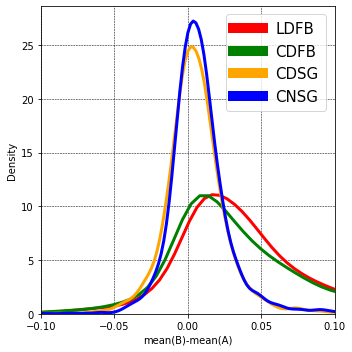

In [8]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)

colors = ["red", "green", "orange", "blue"]
dataframe_lime_copy = dataframe_lime.copy()

legends = []
for i in range(0, 2):
    max_mean = 0
    min_var = 1000
    model = None
    for name in list(set(list(dataframe_lime_copy["models"]))):
        select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean > max_mean:
            max_mean = mean
            min_var = var
            model = name
    selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
    dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

for i in range(2, 4):
    min_mean = 1000
    max_var = 0
    model = None
    for name in list(set(dataframe_lime_copy["models"])):
        select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean < min_mean:
            min_mean = mean
            max_var = var
            model = name
    selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
    dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

legends[2], legends[3] = legends[3], legends[2]
    
ax.set_xlim(-0.1, 0.1)
ax.set_xlabel("mean(B)-mean(A)")

params = {'legend.fontsize': 15,
            'axes.labelsize': 20,
            'axes.titlesize': 20,
            'xtick.labelsize': 20,
            'ytick.labelsize': 20,
            'axes.titlepad': 12,
            'axes.axisbelow': True}
plt.rcParams.update(params)
    
leg = ax.legend(legends, loc='upper center', bbox_to_anchor=(0.8, 1.0), borderpad=0.5)
for index, legobj in enumerate(leg.legendHandles):
    legobj.set_linewidth(10.0)

fig.tight_layout()
plt.savefig('analysis/CompLing_results/'+dataset+'_lime_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
plt.show()

In [9]:
# fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(5, 7))

# dataframe_lime_copy = dataframe_lime.copy()
# colors = ["red", "green", "orange", "blue"]
# legends = []
# updated_dataframe = pd.DataFrame()

# for i in range(0, 2):
#     max_mean = 0
#     min_var = 1000
#     model = None
#     diff_values = None
#     for name in list(set(list(dataframe_lime_copy["models"]))):
#         select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
#         values = np.array(list(select_dataframe["difference"]))
#         mean = np.mean(values)
#         var = np.var(values)
#         if mean > max_mean:
#             max_mean = mean
#             min_var = var
#             model = name
#             diff_values = values
#     selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
#     cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
#     dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
#     base_model = model.split("-")[0]
#     word_embeddings = model.split("-")[1]
#     fine_tuning = model.split("-")[2]
#     if fine_tuning == "NON_STATIC":
#         fine_tuning = "FINE_TUNED"
#     if "DISTILLATION" in model.split("-"):
#         distillation = "DISTILLATION"
#     else:
#         distillation = "NO_DISTILLATION"
#     label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]+"\n"+"μ: "+str(round(max_mean, 3))+"\n"+"σ2: "+str(round(min_var, 4))
#     legends.append(label)
#     dataframe = pd.DataFrame({"models":[label]*len(diff_values),
#                             "difference":diff_values})
#     updated_dataframe = updated_dataframe.append(dataframe)

# for i in range(2, 4):
#     min_mean = 1000
#     max_var = 0
#     model = None
#     diff_values = None
#     for name in list(set(dataframe_lime_copy["models"])):
#         select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
#         values = np.array(list(select_dataframe["difference"]))
#         mean = np.mean(values)
#         var = np.var(values)
#         if mean < min_mean:
#             min_mean = mean
#             max_var = var
#             model = name
#             diff_values = values
#     selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
#     cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
#     dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
#     base_model = model.split("-")[0]
#     word_embeddings = model.split("-")[1]
#     fine_tuning = model.split("-")[2]
#     if fine_tuning == "NON_STATIC":
#         fine_tuning = "FINE_TUNED"
#     if "DISTILLATION" in model.split("-"):
#         distillation = "DISTILLATION"
#     else:
#         distillation = "NO_DISTILLATION"
#     label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]+"\n"+"μ: "+str(round(min_mean, 3))+"\n"+"σ2: "+str(round(max_var, 4))
#     legends.append(label)
#     dataframe = pd.DataFrame({"models":[label]*len(diff_values),
#                             "difference":diff_values})
#     updated_dataframe = updated_dataframe.append(dataframe)
    
# legends[2], legends[3] = legends[3], legends[2]

# sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legends[0]], x="difference", lw=3, color=colors[0], ax=ax1, fill=True)
# sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legends[1]], x="difference", lw=3, color=colors[1], ax=ax2, fill=True)
# sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legends[2]], x="difference", lw=3, color=colors[2], ax=ax3, fill=True)
# sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legends[3]], x="difference", lw=3, color=colors[3], ax=ax4, fill=True)

# ax1.set_xlim(-0.1, 0.1)
# ax1.set_ylim(0, 15)
# ax1.set_xlabel("")
# ax1.set_ylabel("")
# ax1.set_yticks([])
# # ax1.set_xticks([])
# ax1.spines['top'].set_visible(False)
# # ax1.spines['left'].set_visible(False)

# ax2.set_xlim(-0.1, 0.1)
# ax2.set_ylim(0, 15)
# ax2.set_xlabel("")
# ax2.set_ylabel("")
# ax2.set_yticks([])
# # ax2.set_xticks([])
# ax2.spines['top'].set_visible(False)

# ax3.set_xlim(-0.1, 0.1)
# ax3.set_ylim(0, 30)
# ax3.set_xlabel("")
# ax3.set_ylabel("")
# ax3.set_yticks([])
# # ax3.set_xticks([])
# ax3.spines['top'].set_visible(False)

# ax4.set_xlim(-0.1, 0.1)
# ax4.set_ylim(0, 30)
# ax4.set_xlabel("mean(B)-mean(A)")
# ax4.set_ylabel("")
# ax4.set_yticks([])
# # ax4.set_xticks([])
# ax4.spines['top'].set_visible(False)

# ax1.grid(color = 'black', linestyle = '--', linewidth = 0.5)
# ax2.grid(color = 'black', linestyle = '--', linewidth = 0.5)
# ax3.grid(color = 'black', linestyle = '--', linewidth = 0.5)
# ax4.grid(color = 'black', linestyle = '--', linewidth = 0.5)

# params = {'legend.fontsize': 13,
#             'axes.labelsize': 15,
#             'axes.titlesize': 13,
#             'xtick.labelsize': 15,
#             'ytick.labelsize': 15,
#             'axes.titlepad': 12,
#             'axes.axisbelow': True}
# plt.rcParams.update(params)

# leg1 = ax1.legend([legends[0]], loc='upper center', bbox_to_anchor=(0.1, 0.6), borderpad=0, frameon=False)
# for index, legobj in enumerate(leg1.legendHandles):
#     legobj.set_linewidth(0)
# # ax1.set_title(legends[0], loc='left', pad=-120)

# leg2 = ax2.legend([legends[1]], loc='upper center', bbox_to_anchor=(0.1, 0.6), borderpad=0, frameon=False)
# for index, legobj in enumerate(leg2.legendHandles):
#     legobj.set_linewidth(0)
# # ax2.set_title(legends[1], loc='left', pad=-60)

# leg3 = ax3.legend([legends[2]], loc='upper center', bbox_to_anchor=(0.1, 0.6), borderpad=0, frameon=False)
# for index, legobj in enumerate(leg3.legendHandles):
#     legobj.set_linewidth(0)
# # ax3.set_title(legends[2], loc='left', pad=-60)

# leg4 = ax4.legend([legends[3]], loc='upper center', bbox_to_anchor=(0.1, 0.6), borderpad=0, frameon=False)
# for index, legobj in enumerate(leg4.legendHandles):
#     legobj.set_linewidth(0)
# # ax4.set_title(legends[3], loc='left', pad=-60)
    
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.0)
# plt.savefig('analysis/CompLing_results/'+dataset+'_lime_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
# plt.show()

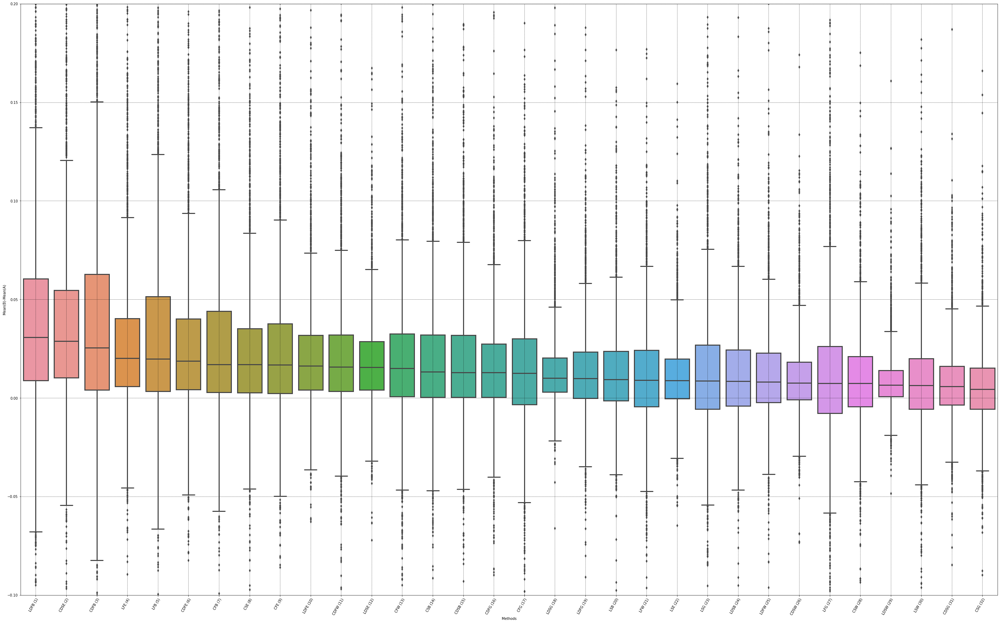

In [8]:
dataframe_lime_copy = dataframe_lime.copy()
updated_dataframe = pd.DataFrame()
legend_names = []
mean_values = []
var_values = []
legend_values = []
for i in range(0, len(set(dataframe_lime_copy["models"]))):
    max_mean = 0
    min_var = 1000
    model = None
    diff_values = None
    for name in list(set(list(dataframe_lime_copy["models"]))):
        select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.median(values)
        var = np.var(values)
        if mean > max_mean:
            max_mean = mean
            min_var = var
            model = name
            diff_values = values
    selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
    cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
    dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legend_names.append(label)
    mean_var = "μ: "+str(round(max_mean, 3))+"\n"+"σ2: "+str(round(min_var, 4))
    legend_values.append(mean_var)
    mean_values.append(max_mean)
    var_values.append(min_var)
    dataframe = pd.DataFrame({"models":[label]*len(diff_values),
                            "mean(B)-mean(A)":diff_values})
    updated_dataframe = updated_dataframe.append(dataframe)

# fig, axes = plt.subplots(32, 1, figsize=(30, 43)) # width, height
# # colors = iter(cm.winter(np.linspace(0, 1, 32)))

# pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
# colors = iter(ListedColormap(pal).colors)

# for index, ax in enumerate(axes.reshape(-1)):
#     color = next(colors)
#     sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legend_names[index]], x="mean(B)-mean(A)", lw=3, color=color, ax=ax, fill=True)

#     ax.set_xlim(-0.1, 0.1)
#     ax.set_ylim(0, 60)
#     ax.set_xlabel("")
#     ax.set_ylabel("")
#     ax.set_yticks([])
#     ax.set_xticks([])
# #     if index != len(axes.reshape(-1))-1:
#     if index == len(axes.reshape(-1))-1:
#         ax.set_xlabel("mean(B)-mean(A)")
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     ax.spines['left'].set_visible(False)
#     ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
    
#     updated_model = ""
#     if legend_names[index][0] == "C":
#         updated_model = updated_model + "C"
#     elif legend_names[index][0] == "L":
#         updated_model = updated_model + "L"

#     if legend_names[index][1] == "D":
#         updated_model = updated_model + "D"

#     if legend_names[index][2] == "S":
#         updated_model = updated_model + "S"
#     elif legend_names[index][2] == "F":
#         updated_model = updated_model + "F"

#     if legend_names[index][3] == "W":
#         updated_model = updated_model + "W"
#     elif legend_names[index][3] == "G":
#         updated_model = updated_model + "G"
#     elif legend_names[index][3] == "E":
#         updated_model = updated_model + "E"
#     elif legend_names[index][3] == "B":
#         updated_model = updated_model + "B"
    
#     props = dict(boxstyle='round', facecolor='white', alpha=0.5)
#     ax.text(0.05, 0.5, updated_model+" ("+str(index+1)+")", transform=ax.transAxes, fontsize=43, verticalalignment='top', color=color)
#     ax.text(0.90, 0.95, legend_values[index], transform=ax.transAxes, fontsize=35, verticalalignment='top', color=color)
    
#     params = {'legend.fontsize': 20,
#                 'axes.labelsize': 40,
#                 'axes.titlesize': 30,
#                 'xtick.labelsize': 30,
#                 'ytick.labelsize': 30,
#                 'axes.titlepad': 12,
#                 'axes.axisbelow': True}
#     plt.rcParams.update(params)
    
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.0)
# plt.savefig('analysis/CompLing_results/'+dataset+'_lime_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
# plt.show()

fig, ax = plt.subplots(figsize=(40, 25))
width = 0.6

sns.set_theme(style="ticks", palette="pastel")
# pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
sns.boxplot(y="mean(B)-mean(A)", x="models", data=updated_dataframe, linewidth=3.0)
ax.set_ylabel("Mean(B)-Mean(A)")
ax.set_xlabel("Methods")

updated_legend_names = []
for index in range(len(legend_names)):
    updated_model = ""
    if legend_names[index][0] == "C":
        updated_model = updated_model + "C"
    elif legend_names[index][0] == "L":
        updated_model = updated_model + "L"

    if legend_names[index][1] == "D":
        updated_model = updated_model + "D"

    if legend_names[index][2] == "S":
        updated_model = updated_model + "S"
    elif legend_names[index][2] == "F":
        updated_model = updated_model + "F"

    if legend_names[index][3] == "W":
        updated_model = updated_model + "W"
    elif legend_names[index][3] == "G":
        updated_model = updated_model + "G"
    elif legend_names[index][3] == "E":
        updated_model = updated_model + "E"
    elif legend_names[index][3] == "B":
        updated_model = updated_model + "B"
    updated_model = updated_model + " ("+str(index+1)+")"
    updated_legend_names.append(updated_model)
    
ax.set_xticklabels(updated_legend_names)
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
ax.set_ylim(-0.1, 0.2)

params = {'legend.fontsize': 30,
        'axes.labelsize': 60,
        'axes.titlesize': 60,
        'xtick.labelsize': 60,
        'ytick.labelsize': 60,
        'axes.titlepad': 12,
        'axes.axisbelow': True}
plt.rcParams.update(params)

plt.setp(ax.get_xticklabels(), rotation=60, ha="right", rotation_mode="anchor")
plt.tight_layout()
plt.savefig('analysis/CompLing_results/'+dataset+'_lime_density_box_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


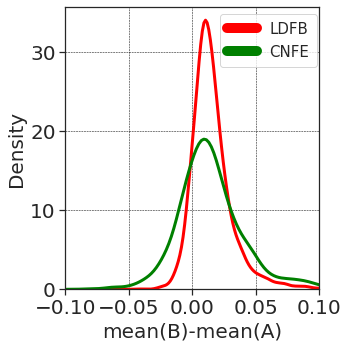

In [15]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)

colors = ["red", "green", "orange", "blue"]
dataframe_shap_copy = dataframe_shap.copy()

legends = []
for i in range(0, 2):
    max_mean = 0
    min_var = 1000
    model = None
    for name in list(set(list(dataframe_shap_copy["models"]))):
        select_dataframe = dataframe_shap_copy.loc[(dataframe_shap_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean > max_mean:
            max_mean = mean
            min_var = var
            model = name
    selected_dataframe = dataframe_shap_copy.loc[(dataframe_shap_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_shap_copy['models'].isin(selected_dataframe['models'])
    dataframe_shap_copy.drop(dataframe_shap_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

for i in range(2, 4):
    min_mean = 1000
    max_var = 0
    model = None
    for name in list(set(dataframe_shap_copy["models"])):
        select_dataframe = dataframe_shap_copy.loc[(dataframe_shap_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean < min_mean:
            min_mean = mean
            max_var = var
            model = name
    selected_dataframe = dataframe_shap_copy.loc[(dataframe_shap_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_shap_copy['models'].isin(selected_dataframe['models'])
    dataframe_shap_copy.drop(dataframe_shap_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

legends[2], legends[3] = legends[3], legends[2]

ax.set_xlim(-0.1, 0.1)
ax.set_xlabel("mean(B)-mean(A)")
# ax.set_linewidth(4)

params = {'legend.fontsize': 15,
            'axes.labelsize': 20,
            'axes.titlesize': 20,
            'xtick.labelsize': 20,
            'ytick.labelsize': 20,
            'axes.titlepad': 12,
            'axes.axisbelow': True}
plt.rcParams.update(params)

legends[0] = "LDFB"
legends[1] = "CNFE"
leg = ax.legend(legends, loc='upper center', bbox_to_anchor=(0.8, 1.0), borderpad=0.5)
# leg.get_frame().set_length(2.0)
for index, legobj in enumerate(leg.legendHandles):
    legobj.set_linewidth(10.0)

plt.savefig('analysis/CompLing_results/'+dataset+'_shap_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
fig.tight_layout()
plt.show()

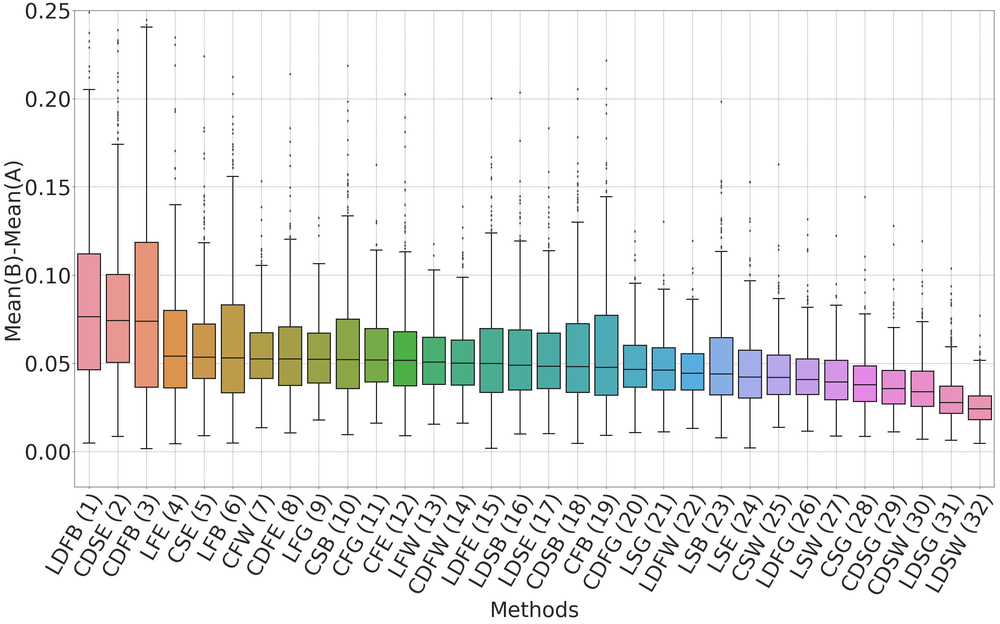

In [59]:
dataframe_lime_copy = dataframe_shap.copy()
updated_dataframe = pd.DataFrame()
legend_names = []
mean_values = []
var_values = []
legend_values = []
for i in range(0, len(set(dataframe_lime_copy["models"]))):
    max_mean = 0
    min_var = 1000
    model = None
    diff_values = None
    for name in list(set(list(dataframe_lime_copy["models"]))):
        select_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.median(values)
        var = np.var(values)
        if mean > max_mean:
            max_mean = mean
            min_var = var
            model = name
            diff_values = values
    selected_dataframe = dataframe_lime_copy.loc[(dataframe_lime_copy["models"]==model)]
    cond = dataframe_lime_copy['models'].isin(selected_dataframe['models'])
    dataframe_lime_copy.drop(dataframe_lime_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legend_names.append(label)
    mean_var = "μ: "+str(round(max_mean, 3))+"\n"+"σ2: "+str(round(min_var, 4))
    legend_values.append(mean_var)
    mean_values.append(max_mean)
    var_values.append(min_var)
    dataframe = pd.DataFrame({"models":[label]*len(diff_values),
                            "mean(B)-mean(A)":diff_values})
    updated_dataframe = updated_dataframe.append(dataframe)

# fig, axes = plt.subplots(32, 1, figsize=(30, 43)) # width, height
# # colors = iter(cm.winter(np.linspace(0, 1, 32)))

# pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
# colors = iter(ListedColormap(pal).colors)

# for index, ax in enumerate(axes.reshape(-1)):
#     color = next(colors)
#     sns.kdeplot(data=updated_dataframe.loc[updated_dataframe["models"]==legend_names[index]], x="mean(B)-mean(A)", lw=3, color=color, ax=ax, fill=True)

#     ax.set_xlim(-0.1, 0.1)
#     ax.set_ylim(0, 60)
#     ax.set_xlabel("")
#     ax.set_ylabel("")
#     ax.set_yticks([])
#     ax.set_xticks([])
# #     if index != len(axes.reshape(-1))-1:
#     if index == len(axes.reshape(-1))-1:
#         ax.set_xlabel("mean(B)-mean(A)")
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
#     ax.spines['left'].set_visible(False)
#     ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
    
#     updated_model = ""
#     if legend_names[index][0] == "C":
#         updated_model = updated_model + "C"
#     elif legend_names[index][0] == "L":
#         updated_model = updated_model + "L"

#     if legend_names[index][1] == "D":
#         updated_model = updated_model + "D"

#     if legend_names[index][2] == "S":
#         updated_model = updated_model + "S"
#     elif legend_names[index][2] == "F":
#         updated_model = updated_model + "F"

#     if legend_names[index][3] == "W":
#         updated_model = updated_model + "W"
#     elif legend_names[index][3] == "G":
#         updated_model = updated_model + "G"
#     elif legend_names[index][3] == "E":
#         updated_model = updated_model + "E"
#     elif legend_names[index][3] == "B":
#         updated_model = updated_model + "B"
    
#     props = dict(boxstyle='round', facecolor='white', alpha=0.5)
#     ax.text(0.05, 0.5, updated_model+" ("+str(index+1)+")", transform=ax.transAxes, fontsize=43, verticalalignment='top', color=color)
#     ax.text(0.90, 0.95, legend_values[index], transform=ax.transAxes, fontsize=35, verticalalignment='top', color=color)
    
#     params = {'legend.fontsize': 20,
#                 'axes.labelsize': 40,
#                 'axes.titlesize': 30,
#                 'xtick.labelsize': 30,
#                 'ytick.labelsize': 30,
#                 'axes.titlepad': 12,
#                 'axes.axisbelow': True}
#     plt.rcParams.update(params)
    
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.0)
# plt.savefig('analysis/CompLing_results/'+dataset+'_lime_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
# plt.show()

fig, ax = plt.subplots(figsize=(40, 25))
width = 0.6

sns.set_theme(style="ticks", palette="pastel")
# pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
sns.boxplot(y="mean(B)-mean(A)", x="models", data=updated_dataframe, linewidth=3.0)
ax.set_ylabel("Mean(B)-Mean(A)")
ax.set_xlabel("Methods")

ranks_qualitative_performances = []
updated_legend_names = []
for index in range(len(legend_names)):
    updated_model = ""
    if legend_names[index][0] == "C":
        updated_model = updated_model + "C"
    elif legend_names[index][0] == "L":
        updated_model = updated_model + "L"

    if legend_names[index][1] == "D":
        updated_model = updated_model + "D"

    if legend_names[index][2] == "S":
        updated_model = updated_model + "S"
    elif legend_names[index][2] == "F":
        updated_model = updated_model + "F"

    if legend_names[index][3] == "W":
        updated_model = updated_model + "W"
    elif legend_names[index][3] == "G":
        updated_model = updated_model + "G"
    elif legend_names[index][3] == "E":
        updated_model = updated_model + "E"
    elif legend_names[index][3] == "B":
        updated_model = updated_model + "B"
    updated_model = updated_model + " ("+str(index+1)+")"
    updated_legend_names.append(updated_model)
    ranks_qualitative_performances.append(index+1)
    
ax.set_xticklabels(updated_legend_names)
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
ax.set_ylim(-0.02, 0.25)

params = {'legend.fontsize': 30,
        'axes.labelsize': 60,
        'axes.titlesize': 60,
        'xtick.labelsize': 60,
        'ytick.labelsize': 60,
        'axes.titlepad': 12,
        'axes.axisbelow': True}
plt.rcParams.update(params)

plt.setp(ax.get_xticklabels(), rotation=60, ha="right", rotation_mode="anchor")
plt.setp(ax.lines, color='k')
plt.setp(ax.artists, edgecolor = 'k')
plt.tight_layout()
plt.savefig('analysis/CompLing_results/'+dataset+'_shap_density_box_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
plt.show()

In [43]:
# dataframe_SST2 = updated_dataframe
# dataframe_SENTIMENT140 = updated_dataframe

In [44]:
# # dataframe_SST2 = dataframe_SST2.drop('models', 1)
# # dataframe_SENTIMENT140 = dataframe_SENTIMENT140.drop('models', 1)
# # dataframe_SST2["dataset"] = ["SST2"]*len(dataframe_SST2)
# # dataframe_SENTIMENT140["dataset"] = ["SENTIMENT140"]*len(dataframe_SENTIMENT140)
# # dataframe_SST2 = dataframe_SST2.reset_index(drop=True)
# # dataframe_SENTIMENT140 = dataframe_SENTIMENT140.reset_index(drop=True)
# dataframe_combined = pd.concat([dataframe_SST2, dataframe_SENTIMENT140])

# fig, ax = plt.subplots(figsize=(20, 5))
# width = 0.6

# sns.set_theme(style="ticks", palette="pastel")
# # pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
# sns.boxplot(y="mean(B)-mean(A)", x="dataset", data=dataframe_combined, linewidth=3.0)
# ax.set_ylabel("Mean(B)-Mean(A)")
# ax.set_xlabel("")

# ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
# ax.set_ylim(-0.02, 0.17)

# params = {'legend.fontsize': 30,
#             'axes.labelsize': 35,
#             'axes.titlesize': 30,
#             'xtick.labelsize': 30,
#             'ytick.labelsize': 30,
#             'axes.titlepad': 12,
#             'axes.axisbelow': True}
# plt.rcParams.update(params)

# plt.setp(ax.get_xticklabels())
# plt.tight_layout()
# plt.savefig('analysis/CompLing_results/datasets_box_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
# plt.show()

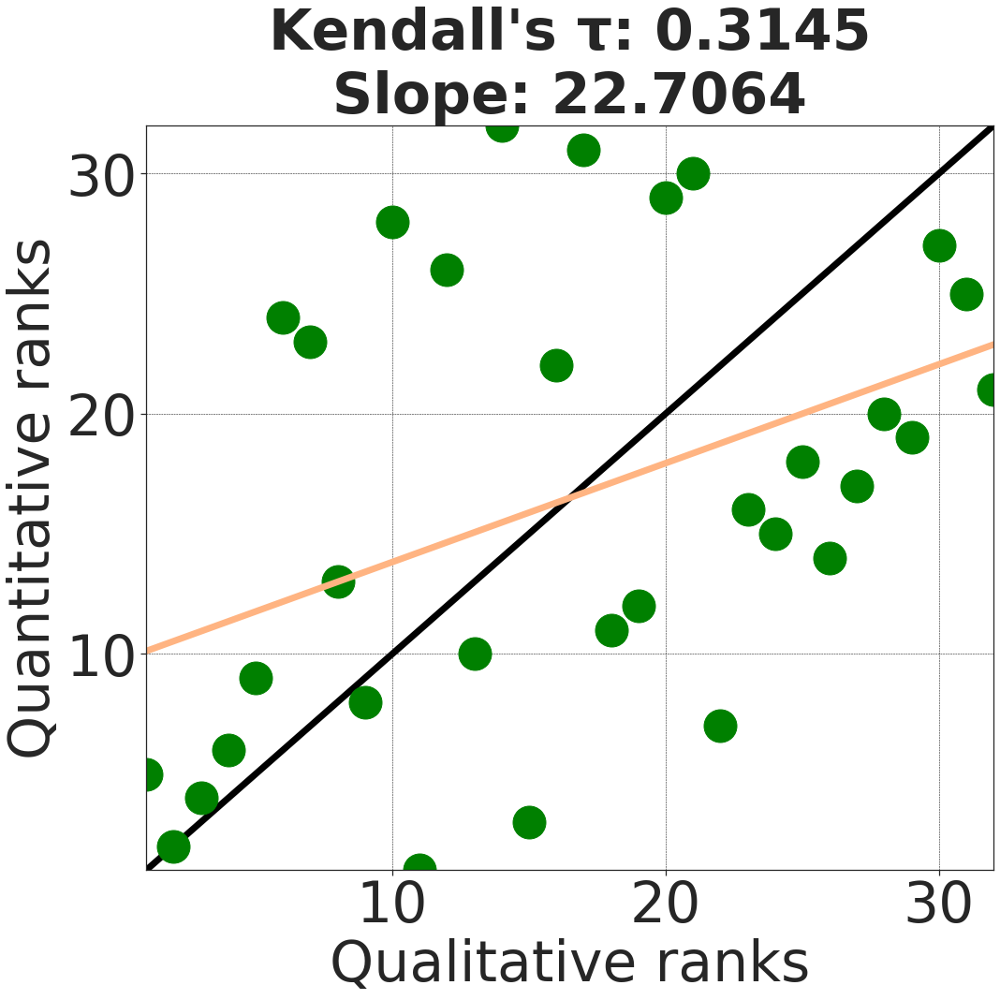

In [45]:
# Scatter plot
import matplotlib.pyplot as plt
import seaborn as sns
from numpy.polynomial.polynomial import polyfit

fig, ax = plt.subplots(figsize=(15, 15)) # width, height
plt.grid()

def slope(x1, y1, x2, y2):
    m = (y2-y1)/(x2-x1)
    return m

from math import atan
def findAngle(M1, M2):
    PI = 3.14159265
    angle = abs((M2 - M1) / (1 + M1 * M2))
    ret = atan(angle)
    val = (ret * 180) / PI
    return round(val, 4)

x = [val for val in range(1, 33)]
y = [val for val in range(1, 33)]
ax.plot(x, y)
m, b = np.polyfit(x, y, 1)
ax.plot(x, m*np.array(x)+b, color="black", linewidth=7)
percy_scores_ranks = list(len(percy_score_shap)+1-rankdata(percy_score_shap, method='ordinal').astype(int))
corresponding_quantitative_performances = []
for legend in legend_names:
    percy_score_rank = percy_scores_ranks[labels.index(legend)]
    corresponding_quantitative_performances.append(percy_score_rank)
ax.plot(ranks_qualitative_performances, corresponding_quantitative_performances, 'o', markersize=35, color="green")
m, b = np.polyfit(ranks_qualitative_performances, corresponding_quantitative_performances, 1)
points = m*np.array(ranks_qualitative_performances)+b
ax.plot(ranks_qualitative_performances, points, linewidth=7)
m1 = round(slope(x[0], y[0], x[1], y[1]), 2)
m2 = round(slope(ranks_qualitative_performances[0], points[0], ranks_qualitative_performances[1], points[1]), 2)
angle = findAngle(m1, m2)
ax.set_title("Kendall's τ: "+str(round(kendalltau(ranks_qualitative_performances, corresponding_quantitative_performances)[0], 4))+"\n"
             'Slope: '+str(angle), fontweight='bold')

ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)

ax.set_xlim(1, 32)
ax.set_ylim(1, 32)

ax.set_xlabel("Qualitative ranks")
ax.set_ylabel("Quantitative ranks")

params = {'figure.titlesize':40,
            'legend.fontsize': 30,
            'axes.labelsize': 70,
            'axes.titlesize': 65,
            'xtick.labelsize': 70,
            'ytick.labelsize': 70,
            'axes.titlepad': 20,
            'axes.axisbelow': True}
plt.rcParams.update(params)
# plt.subplots_adjust(wspace=1.0)
plt.tight_layout()
plt.savefig('analysis/CompLing_results/'+dataset+'_SHAP_box_plot_ranks_scatter_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
plt.show()

In [34]:
# print(percy_score_shap)
# print(percy_scores_ranks)
# print(labels)
# print(legend_names)
print(ranks_qualitative_performances)
print(corresponding_quantitative_performances)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]
[4, 7, 10, 21, 18, 14, 16, 25, 32, 13, 22, 28, 23, 9, 6, 2, 1, 19, 27, 15, 31, 30, 11, 8, 24, 17, 29, 26, 20, 12, 3, 5]


In [ ]:
fig, ax = plt.subplots(figsize=(40, 25))
width = 0.6

sns.set_theme(style="ticks", palette="pastel")
# pal = sns.cubehelix_palette(32, rot=-.25, light=.7)
sns.boxplot(y="mean(B)-mean(A)", x="models", data=updated_dataframe, linewidth=3.0)
ax.set_ylabel("Mean(B)-Mean(A)")
ax.set_xlabel("Methods")

updated_legend_names = []
for index in range(len(legend_names)):
    updated_model = ""
    if legend_names[index][0] == "C":
        updated_model = updated_model + "C"
    elif legend_names[index][0] == "L":
        updated_model = updated_model + "L"

    if legend_names[index][1] == "D":
        updated_model = updated_model + "D"

    if legend_names[index][2] == "S":
        updated_model = updated_model + "S"
    elif legend_names[index][2] == "F":
        updated_model = updated_model + "F"

    if legend_names[index][3] == "W":
        updated_model = updated_model + "W"
    elif legend_names[index][3] == "G":
        updated_model = updated_model + "G"
    elif legend_names[index][3] == "E":
        updated_model = updated_model + "E"
    elif legend_names[index][3] == "B":
        updated_model = updated_model + "B"
    updated_model = updated_model + " ("+str(index+1)+")"
    updated_legend_names.append(updated_model)
    
ax.set_xticklabels(updated_legend_names)
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)
ax.set_ylim(-0.1, 0.2)

params = {'legend.fontsize': 30,
        'axes.labelsize': 60,
        'axes.titlesize': 60,
        'xtick.labelsize': 60,
        'ytick.labelsize': 60,
        'axes.titlepad': 12,
        'axes.axisbelow': True}
plt.rcParams.update(params)

plt.setp(ax.get_xticklabels(), rotation=60, ha="right", rotation_mode="anchor")
plt.tight_layout()
plt.savefig('analysis/CompLing_results/'+dataset+'_shap_density_box_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


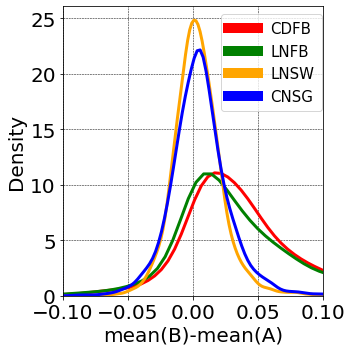

In [20]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.grid(color = 'black', linestyle = '--', linewidth = 0.5)

colors = ["red", "green", "orange", "blue"]
dataframe_int_grad_copy = dataframe_int_grad.copy()

legends = []
for i in range(0, 2):
    max_mean = 0
    min_var = 1000
    model = None
    for name in list(set(list(dataframe_int_grad_copy["models"]))):
        select_dataframe = dataframe_int_grad_copy.loc[(dataframe_int_grad_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean > max_mean:
            max_mean = mean
            min_var = var
            model = name
    selected_dataframe = dataframe_int_grad_copy.loc[(dataframe_int_grad_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_int_grad_copy['models'].isin(selected_dataframe['models'])
    dataframe_int_grad_copy.drop(dataframe_int_grad_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

for i in range(2, 4):
    min_mean = 1000
    max_var = 0
    model = None
    for name in list(set(dataframe_int_grad_copy["models"])):
        select_dataframe = dataframe_int_grad_copy.loc[(dataframe_int_grad_copy["models"]==name)]
        values = np.array(list(select_dataframe["difference"]))
        mean = np.mean(values)
        var = np.var(values)
        if mean < min_mean:
            min_mean = mean
            max_var = var
            model = name
    selected_dataframe = dataframe_int_grad_copy.loc[(dataframe_int_grad_copy["models"]==model)]
    sns.kdeplot(data=selected_dataframe, x="difference", lw=3, color=colors[i])
    cond = dataframe_int_grad_copy['models'].isin(selected_dataframe['models'])
    dataframe_int_grad_copy.drop(dataframe_int_grad_copy[cond].index, inplace = True)
    base_model = model.split("-")[0]
    word_embeddings = model.split("-")[1]
    fine_tuning = model.split("-")[2]
    if fine_tuning == "NON_STATIC":
        fine_tuning = "FINE_TUNED"
    if "DISTILLATION" in model.split("-"):
        distillation = "DISTILLATION"
    else:
        distillation = "NO_DISTILLATION"
    label = base_model[0]+distillation[0]+fine_tuning[0]+word_embeddings[0]
    legends.append(label)

legends[2], legends[3] = legends[3], legends[2]

ax.set_xlim(-0.1, 0.1)
ax.set_xlabel("mean(B)-mean(A)")

params = {'legend.fontsize': 15,
            'axes.labelsize': 20,
            'axes.titlesize': 20,
            'xtick.labelsize': 20,
            'ytick.labelsize': 20,
            'axes.titlepad': 12,
            'axes.axisbelow': True}
plt.rcParams.update(params)

legends[0] = "CDFB"
legends[1] = "LNFB"
leg = ax.legend(legends, loc='upper center', bbox_to_anchor=(0.8, 1.0), borderpad=0.5)
# leg.get_frame().set_length(2.0)
for index, legobj in enumerate(leg.legendHandles):
    legobj.set_linewidth(10.0)

plt.savefig('analysis/CompLing_results/'+dataset+'_int_grad_density_plots.eps', bbox_inches = 'tight', facecolor='white', edgecolor='none')
fig.tight_layout()
plt.show()

In [9]:
import numpy as np

def generate(text_list, feature_att_scores, A_conjunct_color, B_conjunct_color):
    assert len(text_list) == len(feature_att_scores)
    
    # Convert feature_att_scores to numbers between 100 to 0
    A_conjunct = text_list[:text_list.index("but")]
    B_conjunct = text_list[text_list.index("but")+1:]
    if len(text_list) >= 10:
        count = 0
        indices_selected = []
        for i in range(10):
            if len(indices_selected) == 0:
                selected_list = feature_att_scores
            else:
                selected_list = [score for index, score in enumerate(feature_att_scores) if index not in indices_selected]
            max_score = max(selected_list)
            max_score_index = feature_att_scores.index(max_score)
            feature_att_scores[max_score_index] = 100 - count*10
            indices_selected.append(max_score_index)
            count += 1
    elif len(text_list) < 10:
        count = 0
        indices_selected = []
        for i in range(len(text_list)):
            if len(indices_selected) == 0:
                selected_list = feature_att_scores
            else:
                selected_list = [score for index, score in enumerate(feature_att_scores) if index not in indices_selected]
            max_score = max(selected_list)
            max_score_index = feature_att_scores.index(max_score)
            feature_att_scores[max_score_index] = 100 - count*int(100/len(text_list))
            indices_selected.append(max_score_index)
            count += 1
            
#     count = 0
#     indices_selected = []
#     for i in range(len(text_list)):
#         if len(indices_selected) == 0:
#             selected_list = feature_att_scores
#         else:
#             selected_list = [score for index, score in enumerate(feature_att_scores) if index not in indices_selected]
#         max_score = max(selected_list)
#         max_score_index = feature_att_scores.index(max_score)
#         feature_att_scores[max_score_index] = 100 - count*int(100/len(text_list))
#         indices_selected.append(max_score_index)
#         count += 1
    
    # Create the string
    string = ""
    for index, word in enumerate(text_list):
        if word in A_conjunct and feature_att_scores[index] != 0.0:
            string += "\colorbox{"+A_conjunct_color+"!"+str(feature_att_scores[index])+"}{"+word+"} "
        elif word in B_conjunct and feature_att_scores[index] != 0.0:
            if word == B_conjunct[len(B_conjunct)-1]:
                string += "\colorbox{"+B_conjunct_color+"!"+str(feature_att_scores[index])+"}{"+word+"}."
            else:
                string += "\colorbox{"+B_conjunct_color+"!"+str(feature_att_scores[index])+"}{"+word+"} "
        elif word == "but":
            string += "\\textcolor{blue}{\\textbf{"+word+"}} "
        else:
            string += word+" "
        
    return string

if __name__ == '__main__':
    ## This is a demo:

    words = 'bad', 'company', 'leaves', 'a', 'bad', 'taste', ',', 'not', 'only', 'because', 'of', 'its', 'bad', 'luck', 'timing', ',', 'but', 'also', 'the', 'staleness', 'of', 'its', 'script']
    feature_att_scores = [0.23745618601310037, 0.10969570998133776, 0.0, 0.035884505692558244, 0.0, 0.10969570998133776, 0.0, 0.0, 0.03941425603877555, 0.0, 0.06013192299631977, 0.0, 0.019390147291565206, 0.04015506469594372, 0.38226416454061896, 0.00032633462932870727]
    A_conjunct_color = 'red'
    B_conjunct_color = 'red'
    tex_code = generate(words, feature_att_scores.copy(), A_conjunct_color, B_conjunct_color)
    print(tex_code)

\colorbox{red!90}{tries} \colorbox{red!80}{to} add \colorbox{red!30}{some} spice \colorbox{red!70}{to} its quirky \colorbox{red!40}{sentiments} \textcolor{blue}{\textbf{but}} \colorbox{red!60}{the} taste \colorbox{red!20}{is} \colorbox{red!50}{all} \colorbox{red!100}{too} \colorbox{red!10}{familiar}.


In [2]:
print(len(words))

21


In [ ]:
# Table 1:-

# Sentiment140

# sentence:   ellen stafford aww would love to meet  schofe but i'm very much tired and having a major headache  
# sentiment:  0
# A conjunct:  ['aww', 'love', 'to', 'would', 'schofe']
# B conjunct:  ['away', 'happen', 'too', "i'm", 'will']
# A conjunct explanations:  [0.029403882755347745, 0.02572978926975403, 0.01817714344031229, 0.01664423838014187, 0.006929970488977748]
# B conjunct explanations:  [0.09892299004027334, 0.06440500163653529, 0.04763536142106958, 0.03332065161666837, 0.024625738312124747]
# A conjunct score:  0.019377004866906737
# B conjunct score:  0.053781948605334265
# features:  ['ellen', 'stafford', 'aww', 'would', 'love', 'to', 'meet', 'schofe', 'but', "i'm", 'very', 'much', 'tired', 'and', 'having', 'a', 'major', 'headache']
# no of features:  18
# Scores:  [0.0, 0.0, 0.029403882755347745, 0.01664423838014187, 0.02572978926975403, 0.01817714344031229, 0.0, 0.006929970488977748, 0.0, 0.03332065161666837, 0.04763536142106958, 0.0, 0.09892299004027334, 0.0, 0.0, 0.024625738312124747, 0.0, 0.06440500163653529]
# no of scores:  18

# sentence:  america  i don't think i've said this  but i fucking love you   so glad to be home 
# sentiment:  1
# A conjunct:  ['i', 'said', 'america', "don't", 'think']
# B conjunct:  ['love', 'i', 'glad', 'fucking', 'you']
# A conjunct explanations:  [0.09172359492177205, 0.010924708731633894, 0.009533716654157287, 0.00950449204228991, 0.008816970344454042]
# B conjunct explanations:  [0.09597775814155099, 0.09172359492177205, 0.08304087145872015, 0.06352406192028662, 0.044050891252056905]
# A conjunct score:  0.026100696538861434
# B conjunct score:  0.07566343553887735
# features:  ['america', 'i', "don't", 'think', "i've", 'said', 'this', 'but', 'i', 'fucking', 'love', 'you', 'so', 'glad', 'to', 'be', 'home']
# no of features:  17
# Scores:  [0.009533716654157287, 0.09172359492177205, 0.00950449204228991, 0.008816970344454042, 0.0, 0.010924708731633894, 0.0, 0.0, 0.09172359492177205, 0.06352406192028662, 0.09597775814155099, 0.044050891252056905, 0.0, 0.08304087145872015, 0.0, 0.0, 0.0]
# no of scores:  17

# sentence:  maybe make some new music today but hollywood is quite uninspirational         and unwilling to innovate either 
# sentiment:  0
# A conjunct:  ['today', 'music', 'make', 'new', 'some']
# B conjunct:  ['no', 'quite', 'uninspirational', 'bumps', 'c']
# A conjunct explanations:  [0.027047260836863218, 0.017947021531945953, 0.011143512234115206, 0.005518731305606966, 0.004692001349340267]
# B conjunct explanations:  [0.1143215929410383, 0.07127071536055901, 0.07122910359945797, 0.045326395839089255, 0.040924578842662644]
# A conjunct score:  0.013269705451574323
# B conjunct score:  0.06861447731656144
# features:  ['maybe', 'make', 'some', 'new', 'music', 'today', 'but', 'hollywood', 'is', 'quite', 'uninspirational', 'and', 'unwilling', 'to', 'innovate', 'either']
# no of features:  17
# Scores:  [0.0, 0.011143512234115206, 0.004692001349340267, 0.005518731305606966, 0.017947021531945953, 0.027047260836863218, 0.0, 0.0, 0.0, 0.07127071536055901, 0.07122910359945797, 0.0, 0.1143215929410383, 0.040924578842662644, 0.045326395839089255, 0.0]
# no of scores:  17

# SST2

# sentence:  lots of effort and intelligence are on display but in execution it is all awkward , static , and lifeless rumblings
# sentiment:  0
# A conjunct:  ['intelligence', 'on', 'effort', 'lots', 'and']
# B conjunct:  ['lifeless', 'awkward', 'static', 'execution', 'rumblings']
# A conjunct explanations:  [0.01866888717239301, 0.018283950509569855, 0.006956771879959856, 0.0022017739036776897, 4.950043091754336e-07]
# B conjunct explanations:  [0.14752899978226086, 0.09500109930026497, 0.05615841465115977, 0.049747103790898584, 0.03895237083261098]
# A conjunct score:  0.009222375693981917
# B conjunct score:  0.07747759767143904
# features:  ['lots', 'of', 'effort', 'and', 'intelligence', 'are', 'on', 'display', 'but', 'in', 'execution', 'it', 'is', 'all', 'awkward', ',', 'static', ',', 'and', 'lifeless', 'rumblings']
# no of features:  21
# Scores:  [0.0022017739036776897, 0.0, 0.006956771879959856, 4.950043091754336e-07, 0.01866888717239301, 0.0, 0.018283950509569855, 0.0, 0.0, 0.0, 0.049747103790898584, 0.0, 0.0, 0.0, 0.09500109930026497, 0.0, 0.05615841465115977, 0.0, 0.0, 0.14752899978226086, 0.03895237083261098]
# no of scores:  21

# sentence:  too daft by half but supremely good natured
# sentiment:  1
# A conjunct:  ['by', 'too', 'daft', 'half']
# B conjunct:  ['good', 'supremely', 'natured']
# A conjunct explanations:  [0.006774767190066569, 0.0005031923928037207, 0.00036157283903308937, 0.00030051914870040405]
# B conjunct explanations:  [0.35571050223342743, 0.32424571274428, 0.16069754346104181]
# A conjunct score:  0.0019850128926509458
# B conjunct score:  0.2802179194795831
# features:  ['too', 'daft', 'by', 'half', 'but', 'supremely', 'good', 'natured']
# no of features:  8
# Scores:  [0.0005031923928037207, 0.00036157283903308937, 0.006774767190066569, 0.00030051914870040405, 0.0, 0.32424571274428, 0.35571050223342743, 0.16069754346104181]
# no of scores:  8

# sentence:  it 's hard to imagine anyone managing to steal a movie not only from charismatic rising star jake gyllenhaal but also from accomplished oscar winners susan sarandon , dustin hoffman and holly hunter , yet newcomer ellen pompeo pulls off the feat with aplomb
# sentiment:  1
# A conjunct:  ['charismatic', 'star', 'managing', 'rising', 'from']
# B conjunct:  ['aplomb', 'oscar', 'winners', 'pulls', 'sarandon']
# A conjunct explanations:  [0.04944607767572232, 0.04745405946792376, 0.04730066217652603, 0.02322164685938106, 0.015514218067900536]
# B conjunct explanations:  [0.23057733881425538, 0.1409475468441685, 0.09790651808571561, 0.0852499698230831, 0.08373312233695507]
# A conjunct score:  0.03658733284949074
# B conjunct score:  0.12768289918083553
# features:  ['it', "'s", 'hard', 'to', 'imagine', 'anyone', 'managing', 'to', 'steal', 'a', 'movie', 'not', 'only', 'from', 'charismatic', 'rising', 'star', 'jake', 'gyllenhaal', 'but', 'also', 'from', 'accomplished', 'oscar', 'winners', 'susan', 'sarandon', ',', 'dustin', 'hoffman', 'and', 'holly', 'hunter', ',', 'yet', 'newcomer', 'ellen', 'pompeo', 'pulls', 'off', 'the', 'feat', 'with', 'aplomb']
# no of features:  44
# Scores:  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04730066217652603, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.015514218067900536, 0.04944607767572232, 0.02322164685938106, 0.04745405946792376, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1409475468441685, 0.09790651808571561, 0.0, 0.08373312233695507, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0852499698230831, 0.0, 0.0, 0.0, 0.0, 0.23057733881425538]
# no of scores:  44

# Table 2:-

# SST2

# sentence:  `` analyze that '' is one of those crass , contrived sequels that not only fails on its own , but makes you second guess your affection for the original
# sentiment:  0
# A conjunct:  ['fails', 'crass', 'contrived', 'on', 'not']
# B conjunct:  ['guess', 'for', 'second', 'original', 'affection']
# A conjunct explanations:  [0.2136136251033408, 0.15276871677870318, 0.09564690903213924, 0.05112002540954376, 0.048581013356950864]
# B conjunct explanations:  [0.024434867667399093, 0.016129531672064785, 0.014838857861563687, 0.002248545973035719, 0.0001224473237766203]
# A conjunct score:  0.11234605793613557
# B conjunct score:  0.01155485009956798
# features:  ['``', 'analyze', 'that', "''", 'is', 'one', 'of', 'those', 'crass', ',', 'contrived', 'sequels', 'that', 'not', 'only', 'fails', 'on', 'its', 'own', ',', 'but', 'makes', 'you', 'second', 'guess', 'your', 'affection', 'for', 'the', 'original']
# no of features:  30
# Scores:  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.15276871677870318, 0.0, 0.09564690903213924, 0.0, 0.0, 0.048581013356950864, 0.0, 0.2136136251033408, 0.05112002540954376, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.014838857861563687, 0.024434867667399093, 0.0, 0.0001224473237766203, 0.016129531672064785, 0.0, 0.002248545973035719]
# no of scores:  30

# sentence:  a strong script , powerful direction and splendid production design allows us to be transported into the life of wladyslaw szpilman , who is not only a pianist , but a good human being
# sentiment:  1
# A conjunct:  ['splendid', 'powerful', 'allows', 'life', 'wladyslaw']
# B conjunct:  ['good', 'a', 'being', 'human']
# A conjunct explanations:  [0.01327536367624635, 0.012429284733566689, 0.010690432424026652, 0.010298045264799936, 0.009094524427539934]
# B conjunct explanations:  [0.01021291568848418, 0.0053397452342152174, 0.0020582830558842457, 0.0007057308535028096]
# A conjunct score:  0.011157530105235913
# B conjunct score:  0.004579168708021613
# features:  ['a', 'strong', 'script', ',', 'powerful', 'direction', 'and', 'splendid', 'production', 'design', 'allows', 'us', 'to', 'be', 'transported', 'into', 'the', 'life', 'of', 'wladyslaw', 'szpilman', ',', 'who', 'is', 'not', 'only', 'a', 'pianist', ',', 'but', 'a', 'good', 'human', 'being']
# no of features:  34
# Scores:  [0.0, 0.0, 0.0, 0.0, 0.012429284733566689, 0.0, 0.0, 0.01327536367624635, 0.0, 0.0, 0.010690432424026652, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.010298045264799936, 0.0, 0.009094524427539934, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0053397452342152174, 0.01021291568848418, 0.0007057308535028096, 0.0020582830558842457]
# no of scores:  34

# sentence:  considering the harsh locations and demanding stunts , this must have been a difficult shoot , but the movie proves rough going for the audience as well
# sentiment:  0
# A conjunct:  ['harsh', 'been', 'difficult', 'and', 'locations']
# B conjunct:  ['well', 'rough', 'movie', 'proves', 'the']
# A conjunct explanations:  [0.04069002409037685, 0.03438654395966464, 0.025674899149037207, 0.018275385697844364, 0.01398042712857987]
# B conjunct explanations:  [0.018360472745322497, 0.01428306371469317, 0.013247336186763959, 0.0067491764564241484, 0.003529330552581265]
# A conjunct score:  0.026601456005100582
# B conjunct score:  0.011233875931157006
# features:  ['considering', 'the', 'harsh', 'locations', 'and', 'demanding', 'stunts', ',', 'this', 'must', 'have', 'been', 'a', 'difficult', 'shoot', ',', 'but', 'the', 'movie', 'proves', 'rough', 'going', 'for', 'the', 'audience', 'as', 'well']
# no of features:  27
# Scores:  [0.0, 0.0, 0.04069002409037685, 0.01398042712857987, 0.018275385697844364, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03438654395966464, 0.0, 0.025674899149037207, 0.0, 0.0, 0.0, 0.003529330552581265, 0.013247336186763959, 0.0067491764564241484, 0.01428306371469317, 0.0, 0.0, 0.003529330552581265, 0.0, 0.0, 0.018360472745322497]
# no of scores:  27

# sentence:  a gorgeously strange movie , heaven is deeply concerned with morality , but it refuses to spell things out for viewers
# sentiment:  1
# A conjunct:  ['gorgeously', 'heaven', 'a', 'deeply', 'morality']
# B conjunct:  ['it', 'refuses', 'out', 'things', 'viewers']
# A conjunct explanations:  [0.27812909299873756, 0.14231864329133592, 0.08158174647018336, 0.06328634866582744, 0.06292248194323846]
# B conjunct explanations:  [0.005902609283560687, 0.004150712848244995, 0.0016837068064220059, 0.0013587252046652018, 0.0010309071753393413]
# A conjunct score:  0.12564766267386454
# B conjunct score:  0.0028253322636464457
# features:  ['a', 'gorgeously', 'strange', 'movie', ',', 'heaven', 'is', 'deeply', 'concerned', 'with', 'morality', ',', 'but', 'it', 'refuses', 'to', 'spell', 'things', 'out', 'for', 'viewers']
# no of features:  21
# Scores:  [0.08158174647018336, 0.27812909299873756, 0.0, 0.0, 0.0, 0.14231864329133592, 0.0, 0.06328634866582744, 0.0, 0.0, 0.06292248194323846, 0.0, 0.0, 0.005902609283560687, 0.004150712848244995, 0.0, 0.0, 0.0013587252046652018, 0.0016837068064220059, 0.0, 0.0010309071753393413]
# no of scores:  2

# Sentiment140




In [ ]:
#### Dividing SST-2 ####